In [1]:
import os
import gc 
import re

import numpy as np
import pandas as pd
import pickle
from scipy.stats import iqr
from scipy.ndimage import morphology
from scipy.ndimage import zoom, distance_transform_edt
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFECV, RFE
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, RandomizedSearchCV, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from datetime import datetime

import sklearn.metrics as metrics
from sklearn.metrics import f1_score,confusion_matrix, accuracy_score, confusion_matrix
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.inspection import permutation_importance
import time


from copy import deepcopy

#import globz
import file_structure, tex_wrapper, tda_wrapper, cnn_wrapper
from nilearn import datasets, image, plotting
import nibabel as nib
import matplotlib.pyplot as plt
import seaborn as sns

from dipy.align import vector_fields as vf
from dipy.viz import regtools
from dipy.align.imaffine import (AffineMap,MutualInformationMetric,AffineRegistration,transform_centers_of_mass)
from dipy.align.transforms import (TranslationTransform3D,RigidTransform3D,AffineTransform3D)
from dipy.align.reslice import reslice

from mri_reg import ms_affreg, resize_template,vox_coords

import copy
import mri_utils
(origdir,basedir,imagedir,normdir,splitdir,out_dir,model_dir) = file_structure.file_dirs('texture')

modal_list = ['FLAIR','T1', 'T1post','T2']
modal_dict = {'t1': 't1.nii.gz','t1post':'t1Gd.nii.gz','t2':'t2.nii.gz','flair': 'flair.nii.gz'}


Using TensorFlow backend.
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/nilearn/datasets/__init__.py:89: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)
/home/ncwang/.conda/envs/brain_seg/lib/python3.7/site-packages/dipy/viz/__init__.py:32: UserWarning: You do not have FURY installed. Some visualization functions might not work for you. For installation instructions, please visit: https://fury.gl/
  "You do not have FURY installed. "


In [2]:
os.chdir(imagedir)

patients = []
for root, dirs, files in os.walk('.'):
    for dn in dirs:
        patients.append(os.path.join(root,dn))
os.chdir(origdir)

# Functions

In [3]:
def random_grid():
    # Number of trees in random forest
    n_estimators = [int(x) for x in np.linspace(start = 50, stop = 500, num = 50)]
    # Number of features to consider at every split
    max_features = ['sqrt','log2']
    # Maximum number of levels in tree
    max_depth = [int(x) for x in np.linspace(3, 10, num = 1)]
    max_depth.append(None)
    # Minimum number of samples required to split a node
    min_samples_split = [2, 5, 10]
    # Minimum number of samples required at each leaf node
    min_samples_leaf = [1, 2, 4]
    # Method of selecting samples for training each tree
    bootstrap = [True, False]
    # Create the random grid
    random_grid = {'n_estimators': n_estimators,
                   'max_features': max_features,
                   'max_depth': max_depth,
                   'min_samples_split': min_samples_split,
                   'min_samples_leaf': min_samples_leaf,
                   'bootstrap': bootstrap}
    return random_grid

def Youden_Cutoff_auc_sen_spc(y_true, y_prob):
    """ Find the optimal probability cutoff point for a classification model related to event rate
    Parameters
    ----------
    y_true : Matrix with dependent or target data, where rows are observations

    y_pred : Matrix with predicted data, where rows are observations

    Returns
    -------     
    auc, youden sensitivity and youden specificity
    """

    fpr, tpr, threshold = roc_curve(y_true, y_prob)

    spc = 1-fpr;
    j_scores = tpr-fpr
    best_youden, youden_thresh, youden_sen, youden_spc = sorted(zip(j_scores, threshold, tpr, spc))[-1]

    predicted_label = copy.deepcopy(y_prob)
    predicted_label[predicted_label>youden_thresh] = 1
    predicted_label[predicted_label<=youden_thresh] = 0
    youden_accuracy = accuracy_score(y_true, predicted_label)
    
    idxs = (predicted_label == 1)
    youden_ppv = len(np.argwhere(y_true[idxs]==1))/len(idxs)
    idxs = (predicted_label == 0)
    youden_npv = len(np.argwhere(y_true[idxs]==0))/len(idxs)

    if len(np.unique(y_true)) != 2:
        auc = np.nan # error handling if not enough classes (e.g. only one class present IDHwt + GBM)
    else:
        auc = roc_auc_score(y_true, y_prob)

    return auc, youden_sen, youden_spc, youden_accuracy, fpr, tpr, threshold, youden_thresh,youden_ppv,youden_npv


def auc_95confidence(y_true,y_prob,seed = 0):

    # https://stackoverflow.com/questions/19124239/scikit-learn-roc-curve-with-confidence-intervals

    if len(np.unique(y_true)) != 2:
        return np.nan, np.nan # error handling if not enough classes (e.g. only one class present IDHwt + GBM)

    n_bootstraps = 1000
    bootstrapped_scores = []
    np.random.seed(seed)
    
    for i in range(n_bootstraps):
        indices = np.random.choice(range(0, len(y_prob)), len(y_prob), replace=True)
        if len(np.unique(y_true[indices])) < 2:
            continue
        score = roc_auc_score(y_true[indices], y_prob[indices])
        bootstrapped_scores.append(score)
    
    sorted_scores = np.array(bootstrapped_scores)
    sorted_scores.sort()

    #print(sorted_scores)
    #print(int(0.05 * len(sorted_scores)))
    confidence_lower = sorted_scores[int(0.025 * len(sorted_scores))]
    confidence_upper = sorted_scores[int(0.975 * len(sorted_scores))]
    return confidence_lower, confidence_upper

def compute_metrics(y_true, y_prob):
    """
    y_true: true label
    y_prob: probability score for class 1
    """
    y_pred = np.round(y_prob)

    #acc = get_accuracy(y_true, y_pred)
    auc, sen, spe, youden_acc, fpr, tpr, threshold, youden_thresh,youden_ppv,youden_npv = Youden_Cutoff_auc_sen_spc(y_true, y_prob)
    lower, upper = auc_95confidence(y_true, y_prob)

    return auc, sen, spe, youden_acc, lower, upper, fpr, tpr, threshold, youden_thresh,youden_ppv,youden_npv

def organize_result(result_dict, case, y_true, y_prob,case_suffix = ''):
    
    if not case in result_dict:
        result_dict[case] = {}
    
    (auc, sen, spe, youden_acc, lower, upper, fpr, tpr, 
     threshold, youden_thresh,youden_ppv,youden_npv) = compute_metrics(y_true, y_prob)
    accuracy = accuracy_score(y_true, y_prob > 0.5)
    #cv_score = np.load(os.path.join(model_dir,case_str+'_0'+'_best_cv_score.npy'))
    #pval = auc_p_val(y_true,y_prob)
    val_map = {'Youden Accuracy': youden_acc, 'Sensitivity': sen, 'Specificity': spe,
              'AUC': auc, 'AUC Upper': upper, 'AUC Lower': lower, 'fpr': fpr, 'tpr': tpr,
              'threshold': threshold, 'Youden thresh': youden_thresh,'Youden PPV':youden_ppv,
               'Youden NPV': youden_npv,'Accuracy':accuracy}#, 'CV AUC': cv_score}
    
    for key, val in val_map.items():
        #if key in result_dict[case]:
        #    result_dict[case][key] = np.append(result_dict[case][key],val)
        #else: 
        #    result_dict[case][key] = [val]
        result_dict[case][key] = val
    
    return result_dict

In [4]:
def Logreg_grid():
    # penalty type
#     penalty = ['l1','l2']
    penalty = ['l2']
    # regularization strength
    C = np.logspace(-4,4,9)
    # Create the random grid
    logreg_grid = dict(C=C, penalty = penalty)
    return logreg_grid

In [5]:
# https://gist.github.com/stuarteberg/8982d8e0419bea308326933860ecce30
import scipy

def fill_hull(image):
    """
    Compute the convex hull of the given binary image and
    return a mask of the filled hull.
    
    Adapted from:
    https://stackoverflow.com/a/46314485/162094
    This version is slightly (~40%) faster for 3D volumes,
    by being a little more stingy with RAM.
    """
    # (The variable names below assume 3D input,
    # but this would still work in 4D, etc.)
    
    assert (np.array(image.shape) <= np.iinfo(np.int16).max).all(), \
        f"This function assumes your image is smaller than {2**15} in each dimension"
    
    points = np.argwhere(image).astype(np.int16)
    hull = scipy.spatial.ConvexHull(points)
    deln = scipy.spatial.Delaunay(points[hull.vertices])

    # Instead of allocating a giant array for all indices in the volume,
    # just iterate over the slices one at a time.
    idx_2d = np.indices(image.shape[1:], np.int16)
    idx_2d = np.moveaxis(idx_2d, 0, -1)

    idx_3d = np.zeros((*image.shape[1:], image.ndim), np.int16)
    idx_3d[:, :, 1:] = idx_2d
    
    mask = np.zeros_like(image, dtype=bool)
    for z in range(len(image)):
        idx_3d[:,:,0] = z
        s = deln.find_simplex(idx_3d)
        mask[z, (s != -1)] = 1

    return mask

# Cerebellum Samples Mask

# set up LR ipsilateral

(91, 109, 91)


(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

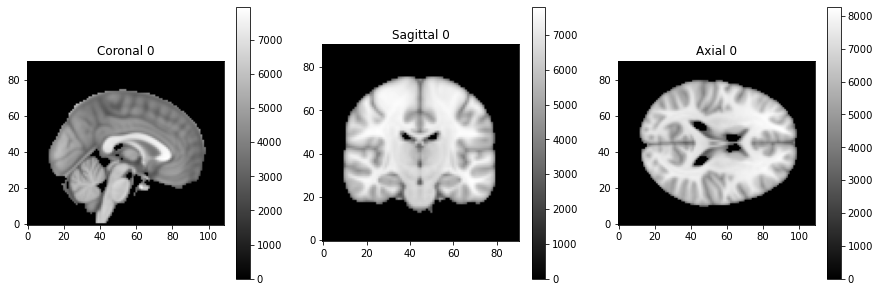

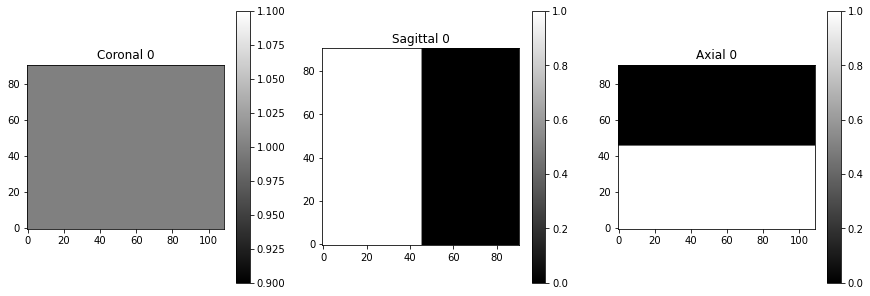

In [6]:
orig_template = datasets.load_mni152_template()
tDim = orig_template.shape
xIdxVec = np.arange(tDim[1])
yIdxVec = np.arange(tDim[0])
zIdxVec = np.arange(tDim[2])
# print(xIdxVec)
# print(yIdxVec)
# print(zIdxVec)
print(tDim)


(xM,yM,zM) = np.meshgrid(xIdxVec,yIdxVec,zIdxVec,indexing='xy')
# mri_utils.plot_img_arr(xM)
# mri_utils.plot_img_arr(yM)
# mri_utils.plot_img_arr(zM)
mri_utils.plot_img_arr(orig_template.get_fdata())
LRMask = yM < tDim[0]/2
mri_utils.plot_img_arr(LRMask)

/sw/med/lab/ukarvind/modules/lib/python3/tensorflow-gpu/2.2/lib/python3.7/site-packages/numpy/lib/npyio.py:2349: VisibleDeprecationWarning: Reading unicode strings without specifying the encoding argument is deprecated. Set the encoding, use None for the system default.
  output = genfromtxt(fname, **kwargs)
/sw/med/lab/ukarvind/modules/lib/python3/tensorflow-gpu/2.2/lib/python3.7/site-packages/numpy/ma/core.py:2832: UserWarning: Warning: converting a masked element to nan.
  order=order, subok=True, ndmin=ndmin)


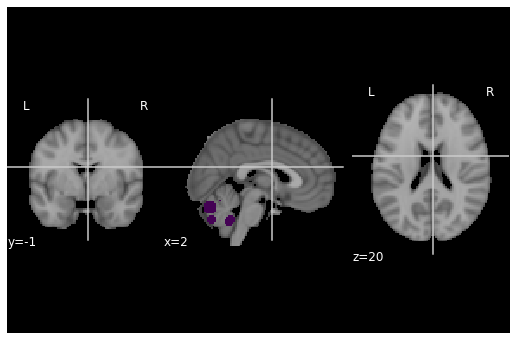

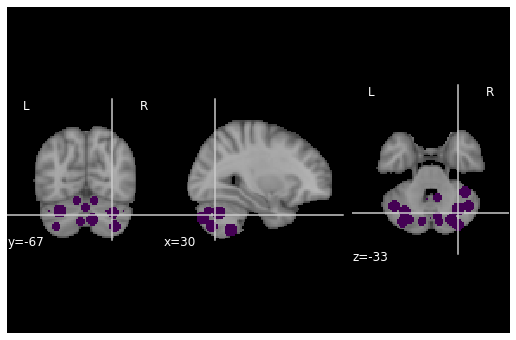

In [7]:
# print(seitzman['regions'])
seitzman = datasets.fetch_coords_seitzman_2018()
stzCoords = seitzman['rois']
stzRadii = seitzman['radius']
stzRegs = seitzman['regions']
cerInd = [reg == 'cerebellum' for reg in stzRegs]
# print([len(tup) for tup in stzCoords[cerInd]])
# print(stzCoords[cerInd])
# print([list(lst) for lst in stzCoords[cerInd]])
cerCoords = np.array([list(lst) for lst in stzCoords[cerInd]])
# cerCoords = np.array(stzCoords[cerInd],dtype=np.dtype('float,float,float'))
# print(cerCoords)

distMask = np.zeros(orig_template.shape,dtype=bool)
seedBW = np.ones(orig_template.shape)
cerIdxs = np.argwhere(cerInd)
for cIdx in cerIdxs:
    cCoord = list(stzCoords[cIdx][0])
#     print(cCoord)
    cCerInds = image.coord_transform(cCoord[0],cCoord[1],cCoord[2], np.linalg.inv(orig_template.affine))
#     print(cCerInds)
#     print(stzRadii[cIdx])
    seedBW[int(cCerInds[0]),int(cCerInds[1]),int(cCerInds[2])] = 0
    seedDist = distance_transform_edt(seedBW)
    seedMask = seedDist <= stzRadii[cIdx]
    distMask = np.logical_or(distMask,seedMask)
#     print('%i:%i' %(cIdx,np.sum(distMask)))

cerSmpMask = distMask

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(orig_template,axes=ax)
distMaskNib = nib.nifti1.Nifti1Image(distMask.astype(int),orig_template.affine,header=orig_template.header)
pl_atlas = pl_anat.add_overlay(distMaskNib)
plt.show()

cer_xyz = plotting.find_xyz_cut_coords(orig_template, mask_img=distMaskNib, activation_threshold=None)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(orig_template,axes=ax,cut_coords=cer_xyz)
distMaskNib = nib.nifti1.Nifti1Image(distMask.astype(int),orig_template.affine,header=orig_template.header)
pl_atlas = pl_anat.add_overlay(distMaskNib)
plt.show()

# set up cerebellum

In [127]:
# print(seitzman['regions'])
seitzman = datasets.fetch_coords_seitzman_2018()

stzCoords = seitzman['rois']
stzRadii = seitzman['radius']
stzRegs = seitzman['regions']
cerInd = [reg == 'cerebellum' for reg in stzRegs]
# print([len(tup) for tup in stzCoords[cerInd]])
# print(stzCoords[cerInd])
# print([list(lst) for lst in stzCoords[cerInd]])
cerCoords = np.array([list(lst) for lst in stzCoords[cerInd]])
# cerCoords = np.array(stzCoords[cerInd],dtype=np.dtype('float,float,float'))
# print(cerCoords)

distMask = np.zeros(orig_template.shape,dtype=bool)
seedBW = np.ones(orig_template.shape)
cerIdxs = np.argwhere(cerInd)
for cIdx in cerIdxs:
    cCoord = list(stzCoords[cIdx][0])
#     print(cCoord)
    for sign in [-1,1]:
        cCerInds = image.coord_transform(sign * cCoord[0],cCoord[1],cCoord[2], np.linalg.inv(orig_template.affine))
    #     print(cCerInds)
    #     print(stzRadii[cIdx])
        seedBW[int(cCerInds[0]),int(cCerInds[1]),int(cCerInds[2])] = 0
        seedDist = distance_transform_edt(seedBW)
        seedMask = seedDist <= stzRadii[cIdx]
        distMask = np.logical_or(distMask,seedMask)
#     print('%i:%i' %(cIdx,np.sum(distMask)))
cerSmpMask = distMask

# Process Contralateral

TCGA-DU-A5TT
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
./TCGA-DU-A5TT
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


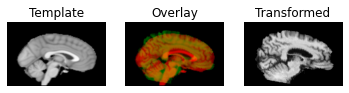

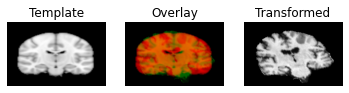

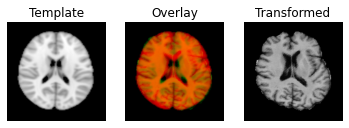

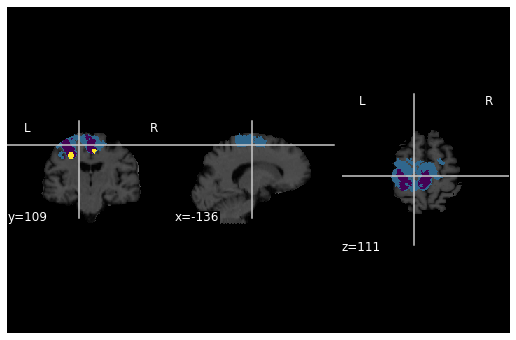

overlapping labels
5040 55175
0.09134571816946081
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/tda_feats.csv
TCGA-DU-8168
./TCGA-DU-8168
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


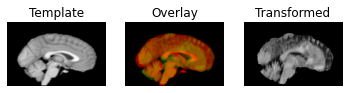

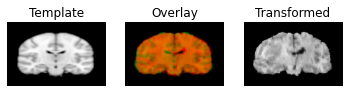

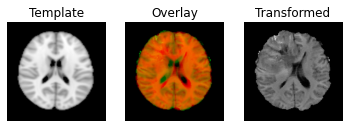

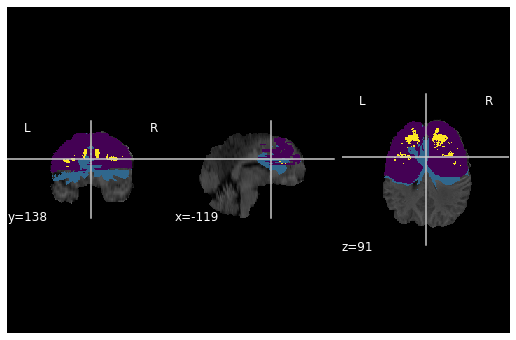

overlapping labels
18647 374841
0.049746425817880115


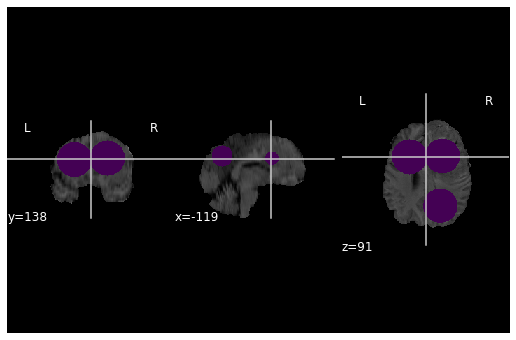

TCGA-DU-6404
./TCGA-DU-6404
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


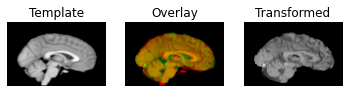

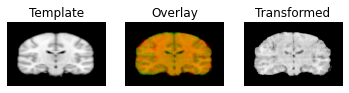

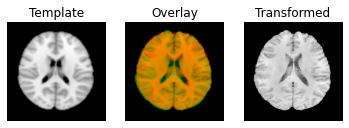

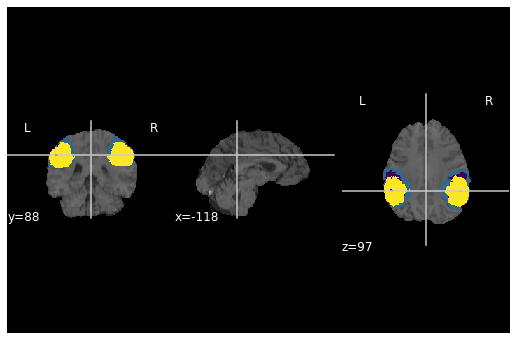

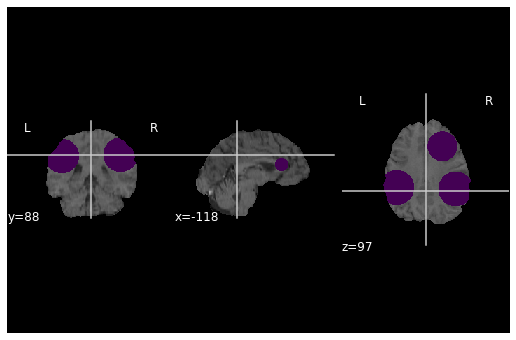

TCGA-06-0138
./TCGA-06-0138
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


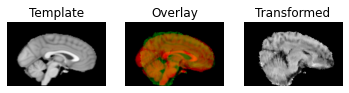

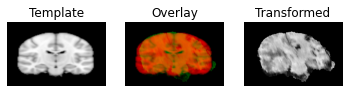

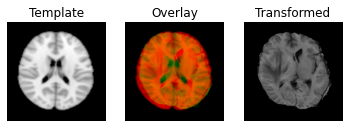

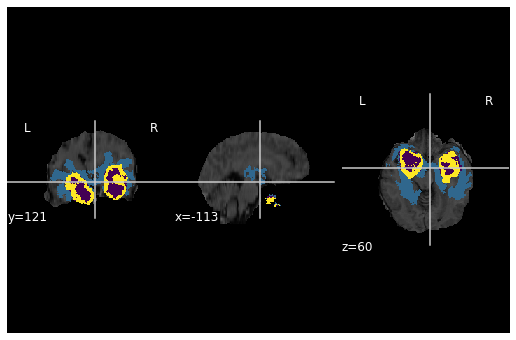

overlapping labels
691 226642
0.003048861199601133


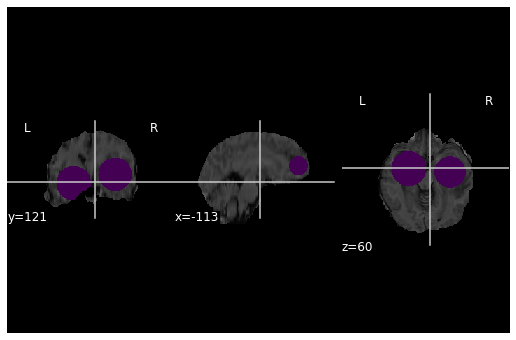

TCGA-14-3477
./TCGA-14-3477
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


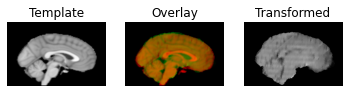

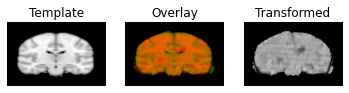

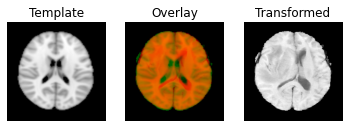

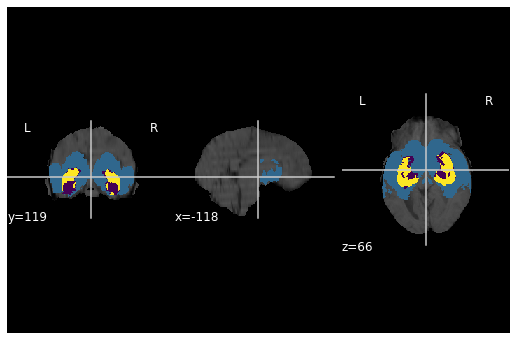

overlapping labels
6374 318293
0.020025573920884217


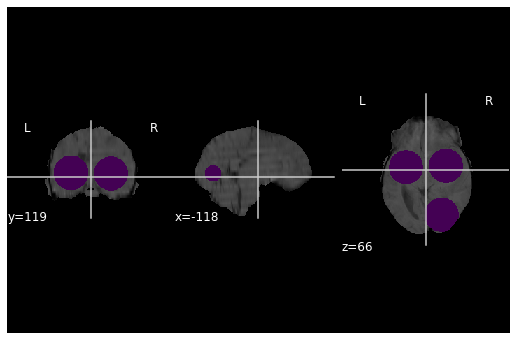

TCGA-06-0240
./TCGA-06-0240
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


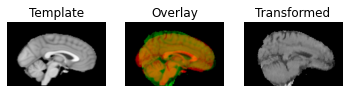

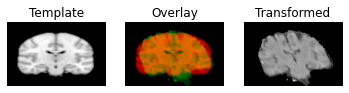

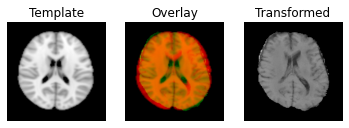

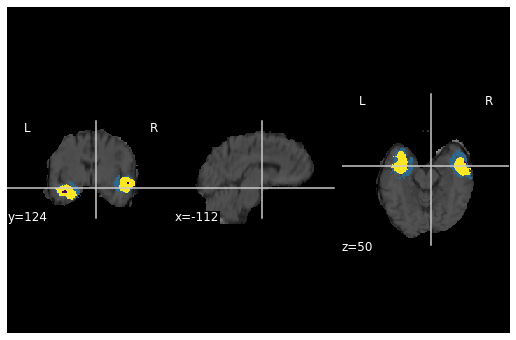

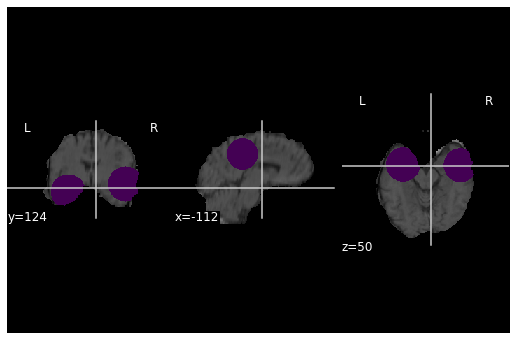

TCGA-CS-6666
./TCGA-CS-6666
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


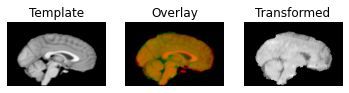

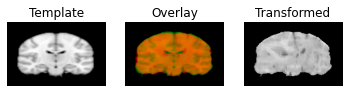

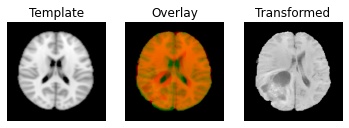

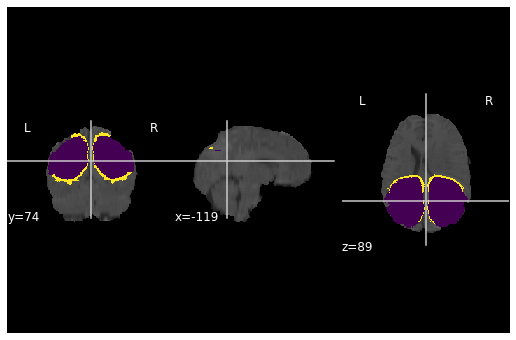

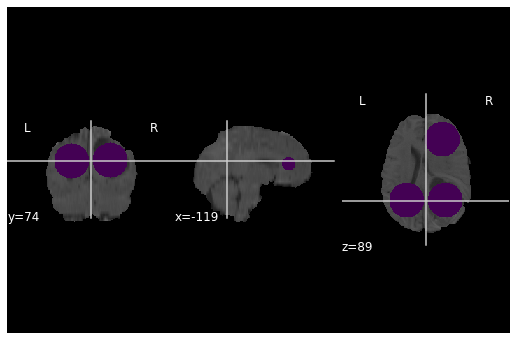

TCGA-76-6664
./TCGA-76-6664
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


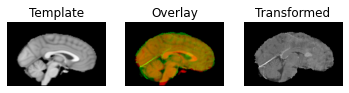

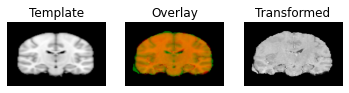

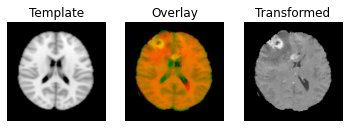

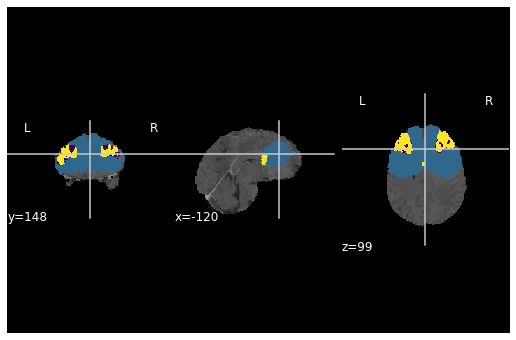

overlapping labels
4661 230221
0.02024576385299343


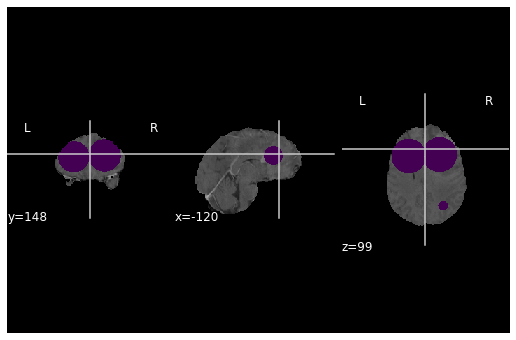

TCGA-DU-7309
./TCGA-DU-7309
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


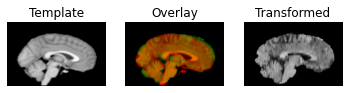

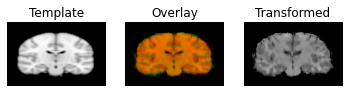

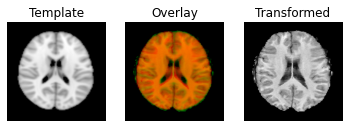

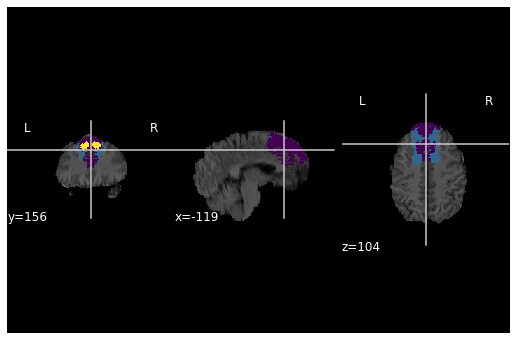

overlapping labels
5180 65719
0.07882043244723748
very overlapping labels
TCGA-12-3650
./TCGA-12-3650
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


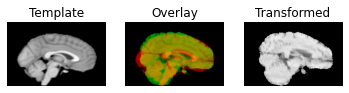

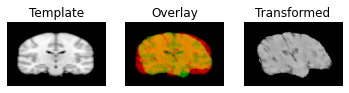

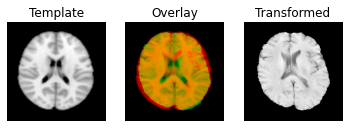

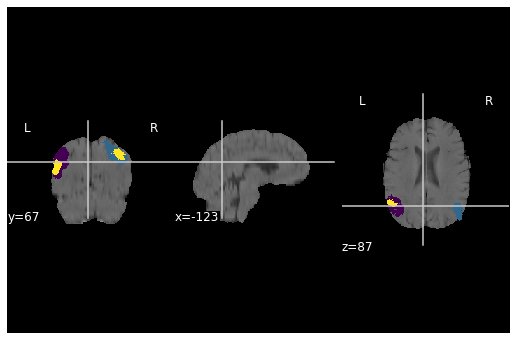

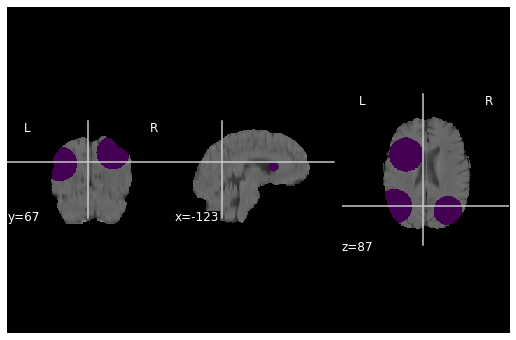

TCGA-FG-6691
./TCGA-FG-6691
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


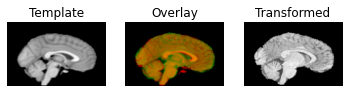

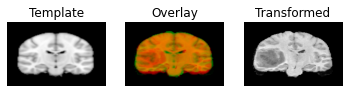

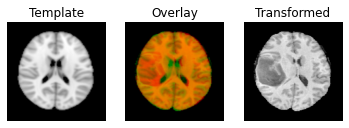

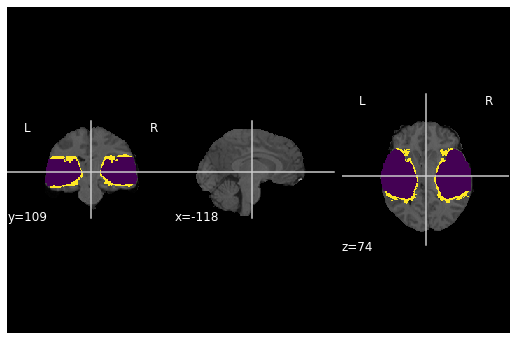

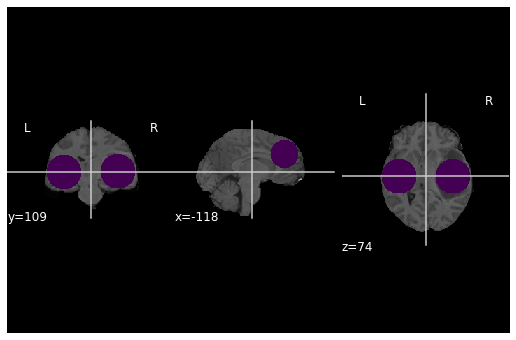

TCGA-HT-8563
./TCGA-HT-8563
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


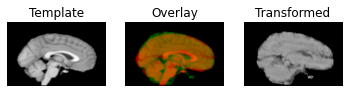

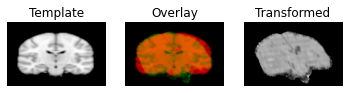

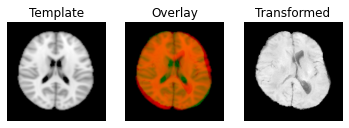

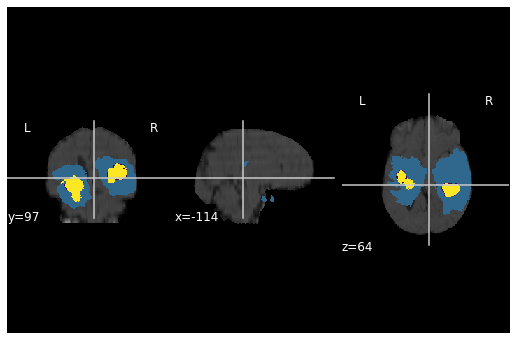

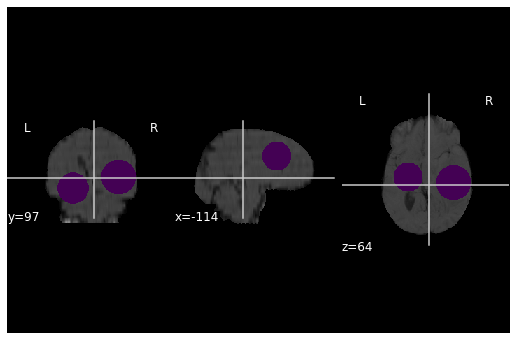

TCGA-DU-7298
./TCGA-DU-7298
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


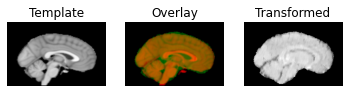

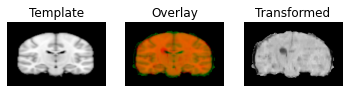

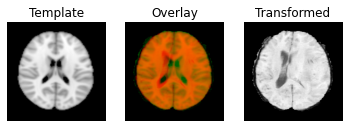

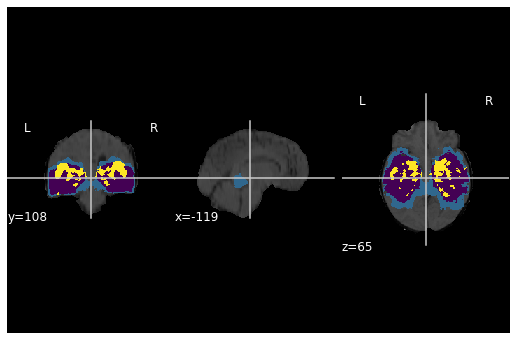

overlapping labels
1387 322701
0.004298096380240532


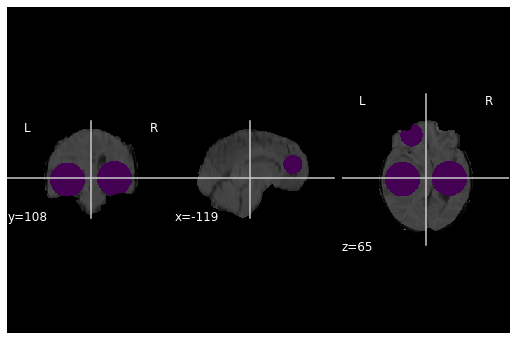

TCGA-19-5958
./TCGA-19-5958
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


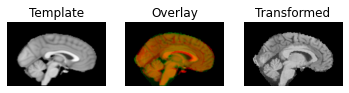

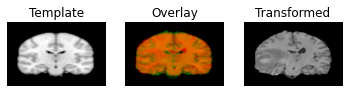

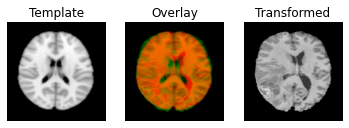

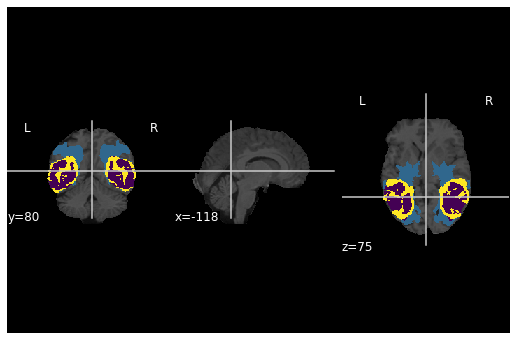

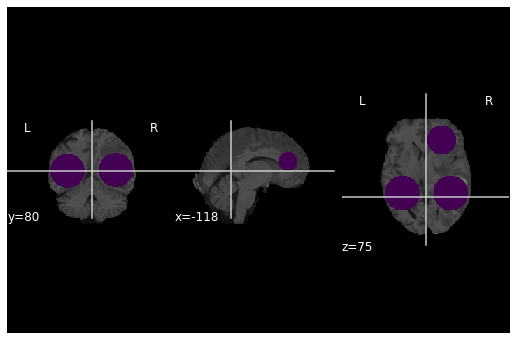

TCGA-HT-7884
./TCGA-HT-7884
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


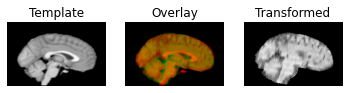

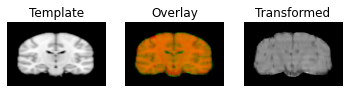

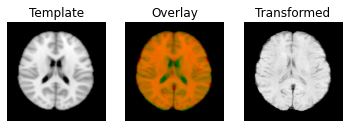

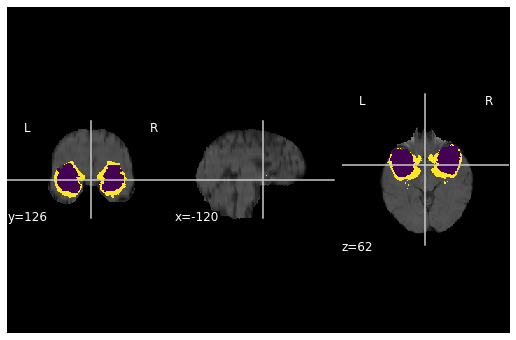

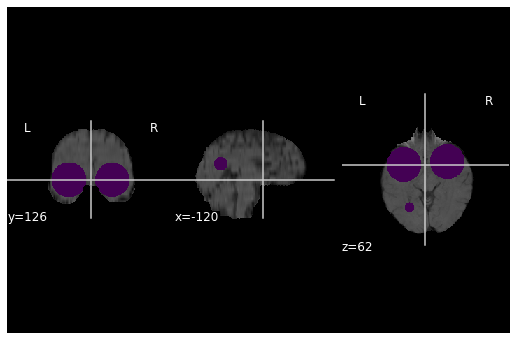

TCGA-02-0068
./TCGA-02-0068
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


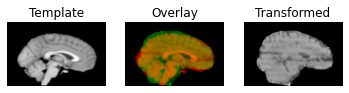

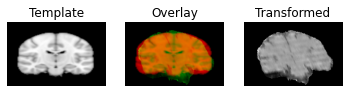

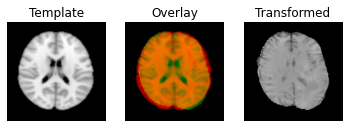

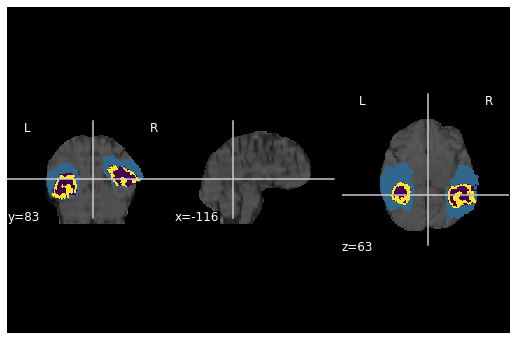

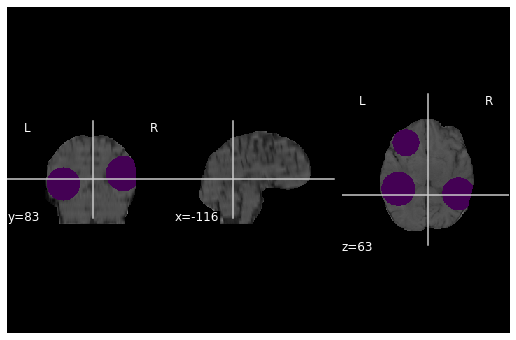

TCGA-DU-6542
./TCGA-DU-6542
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


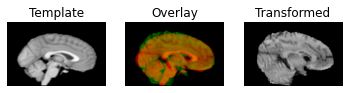

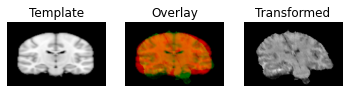

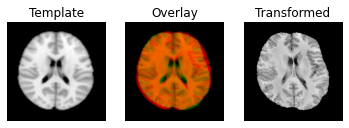

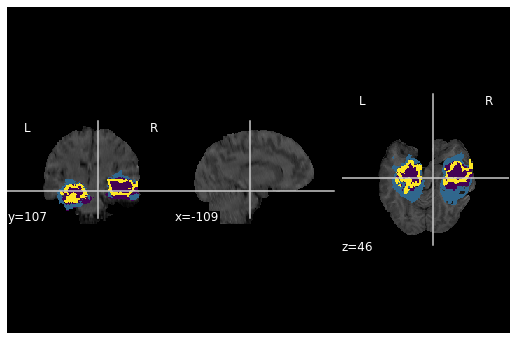

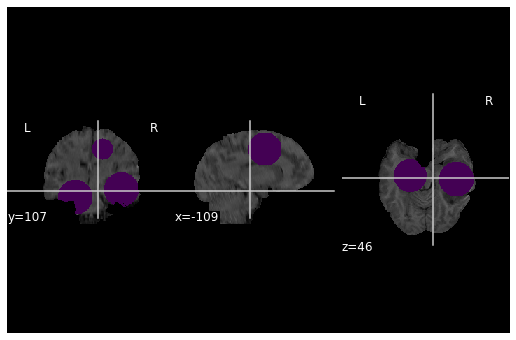

TCGA-DU-A5TW
./TCGA-DU-A5TW
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


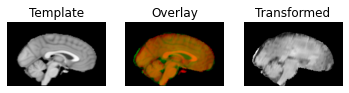

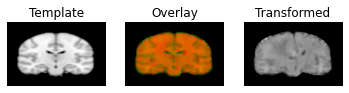

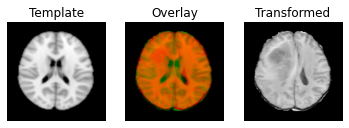

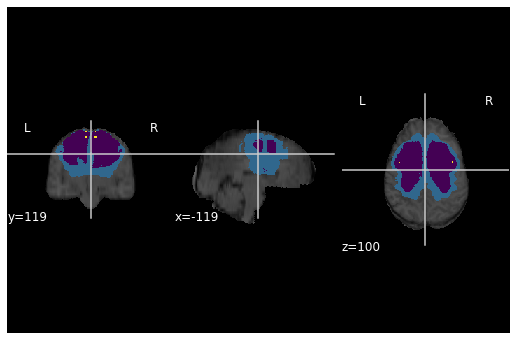

overlapping labels
23930 317824
0.07529324405960532
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TW/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TW/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TW/tda_feats.csv
TCGA-06-5413
./TCGA-06-5413
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


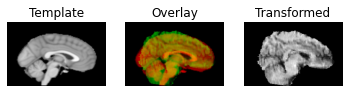

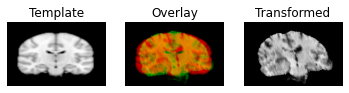

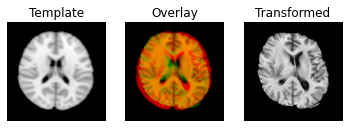

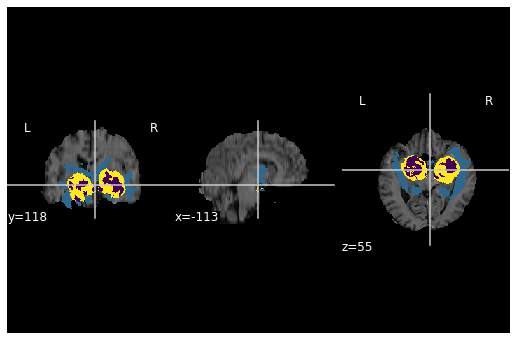

overlapping labels
726 141590
0.005127480754290557


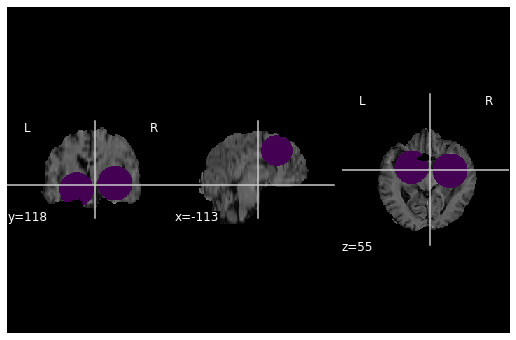

TCGA-12-0829
./TCGA-12-0829
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


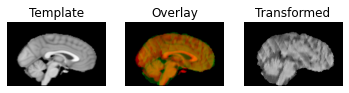

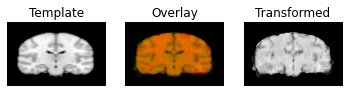

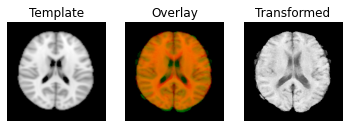

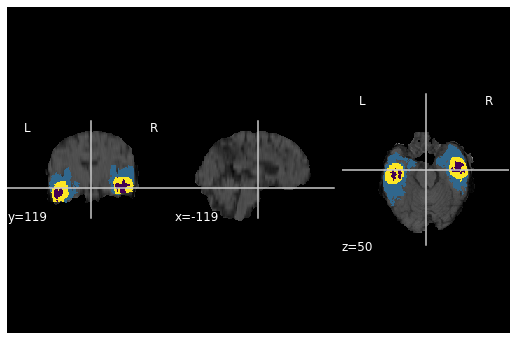

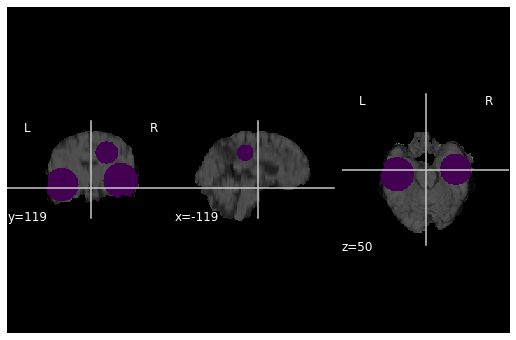

TCGA-06-6389
./TCGA-06-6389
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


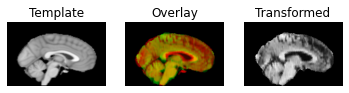

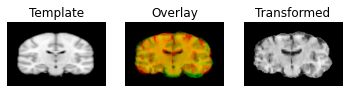

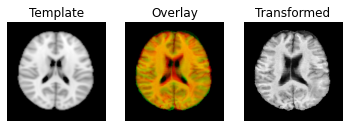

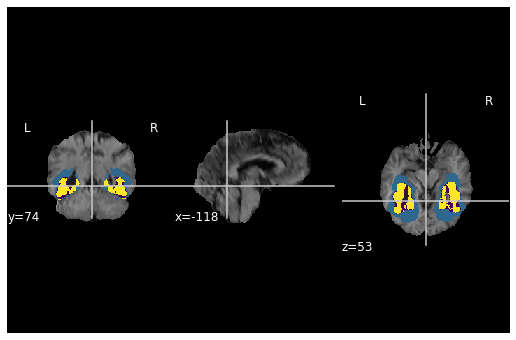

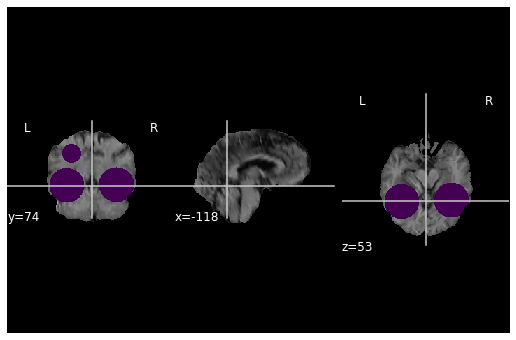

TCGA-CS-6668
./TCGA-CS-6668
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


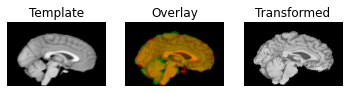

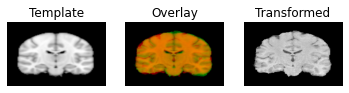

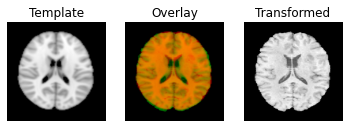

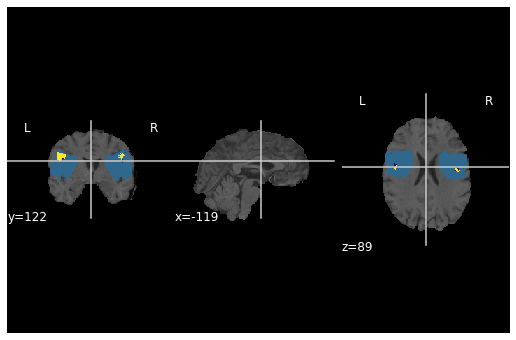

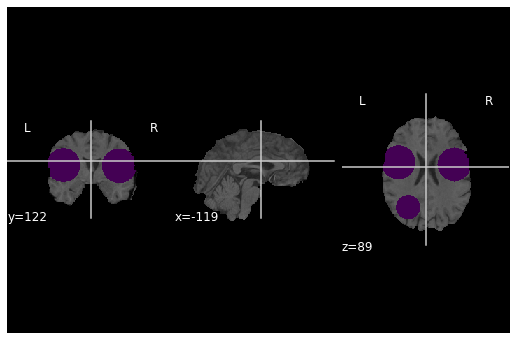

TCGA-CS-6188
./TCGA-CS-6188
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


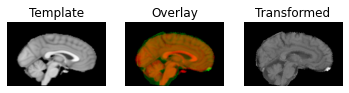

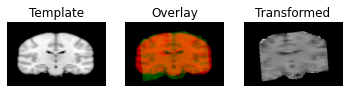

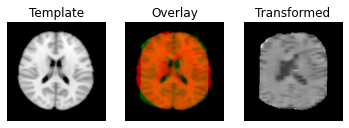

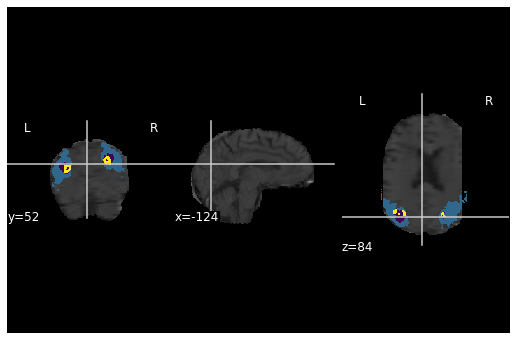

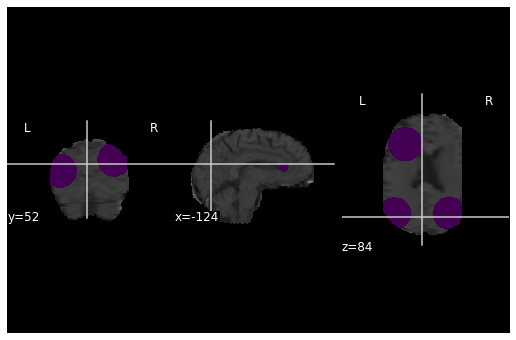

TCGA-06-0187
./TCGA-06-0187
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


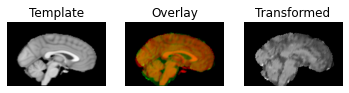

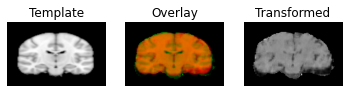

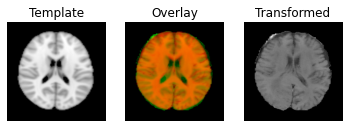

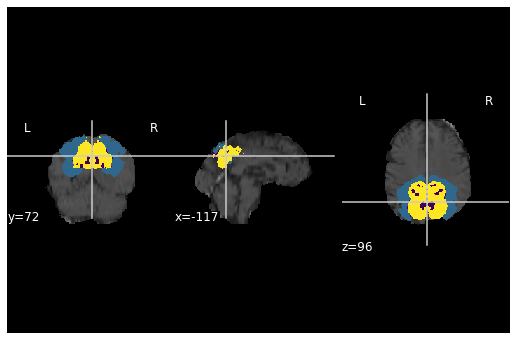

overlapping labels
227 163068
0.0013920573012485588


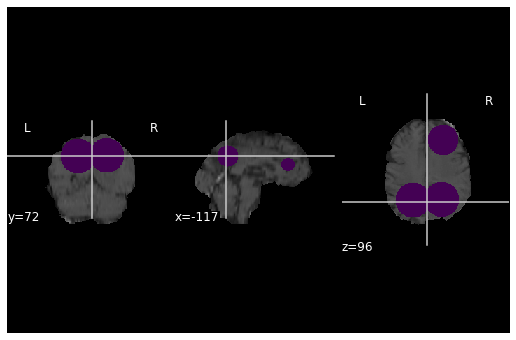

TCGA-FG-6692
./TCGA-FG-6692
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


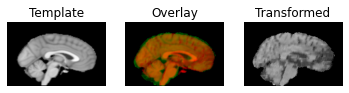

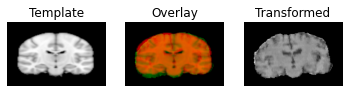

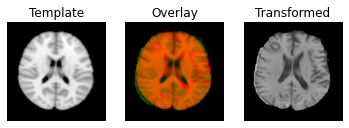

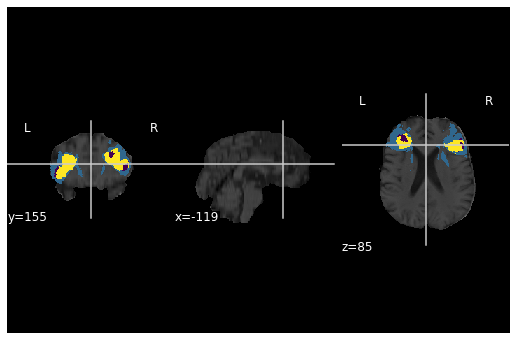

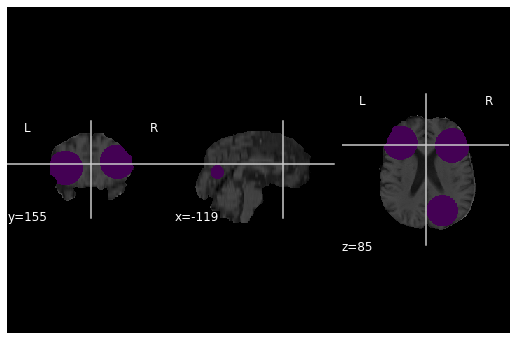

TCGA-12-0616
./TCGA-12-0616
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


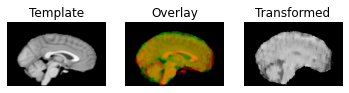

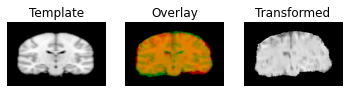

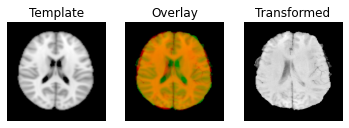

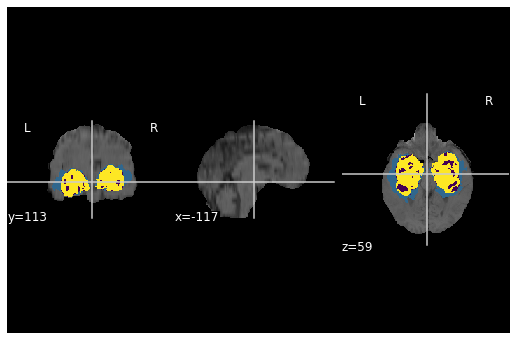

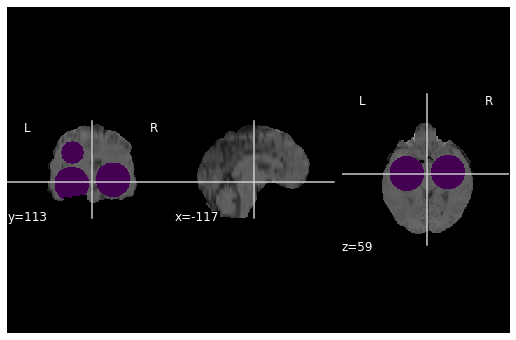

TCGA-19-2624
./TCGA-19-2624
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


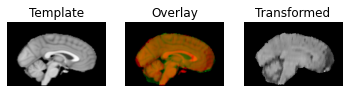

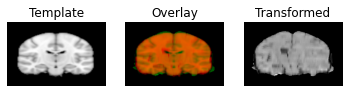

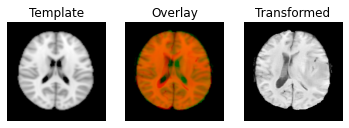

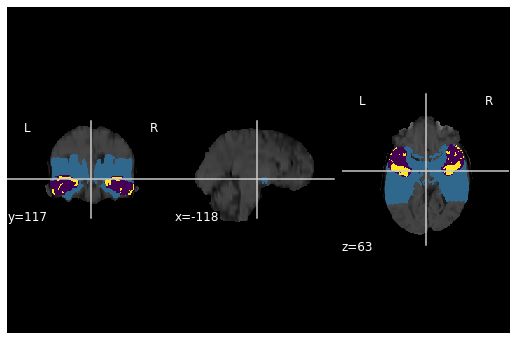

overlapping labels
351 336635
0.0010426723305657463


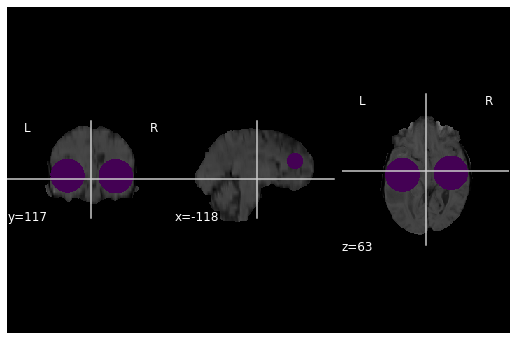

TCGA-02-0070
./TCGA-02-0070
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


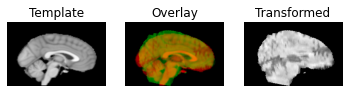

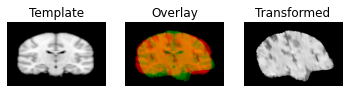

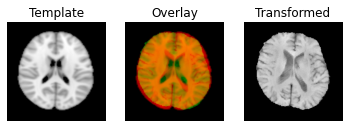

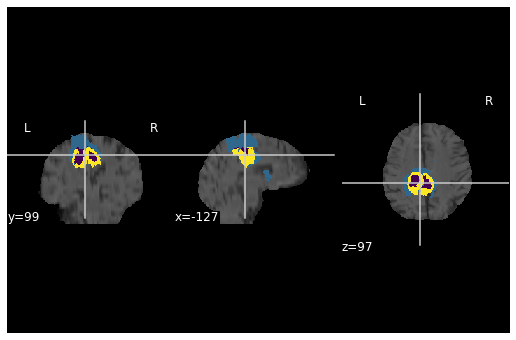

overlapping labels
13284 62020
0.21418897129958078
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-02-0070/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-02-0070/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-02-0070/tda_feats.csv
TCGA-02-0069
./TCGA-02-0069
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


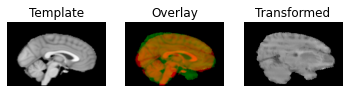

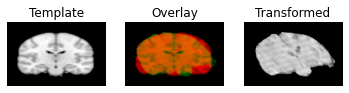

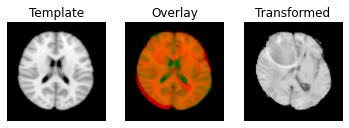

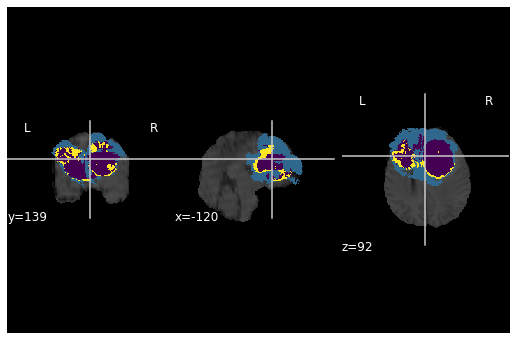

overlapping labels
42012 243605
0.1724595143777837
very overlapping labels
TCGA-02-0011
./TCGA-02-0011
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


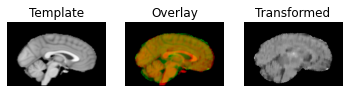

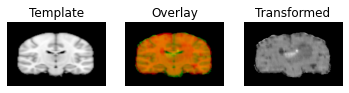

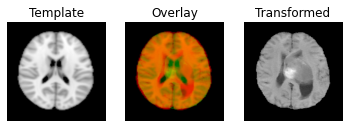

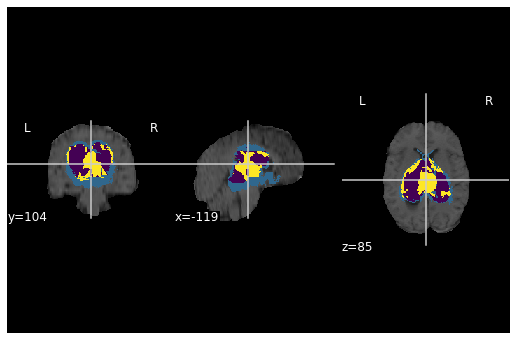

overlapping labels
60413 195191
0.3095070981756331
very overlapping labels
TCGA-02-0116
./TCGA-02-0116
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


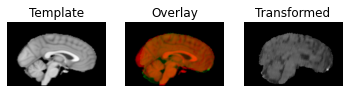

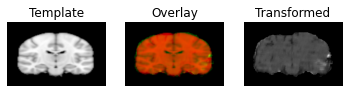

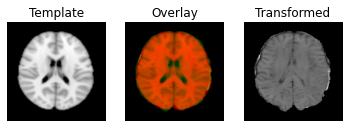

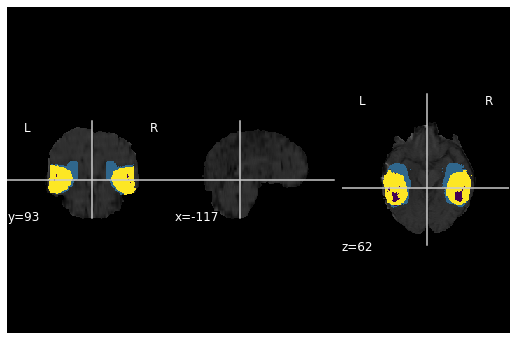

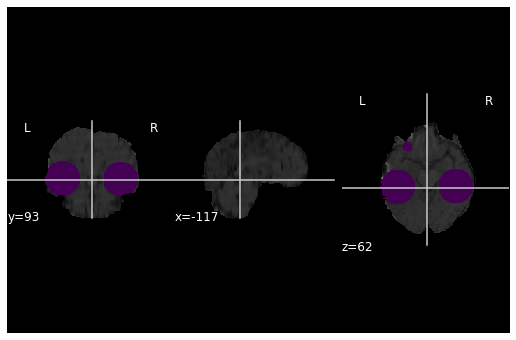

TCGA-DU-8166
./TCGA-DU-8166
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


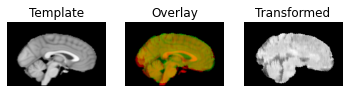

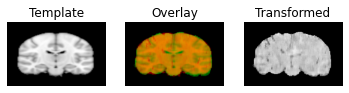

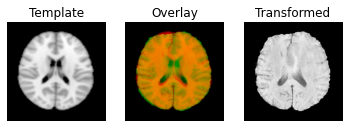

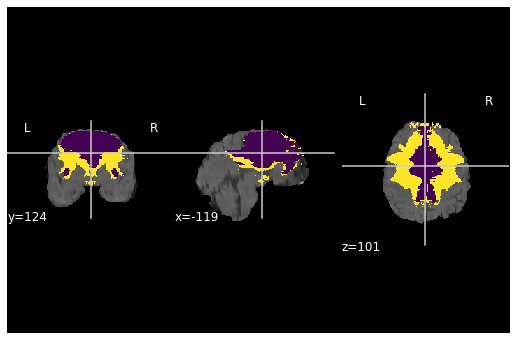

overlapping labels
46957 307602
0.15265505425842485
very overlapping labels
TCGA-76-6663
./TCGA-76-6663
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


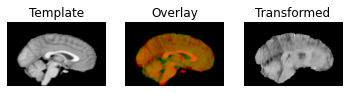

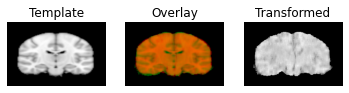

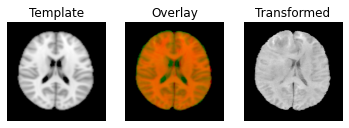

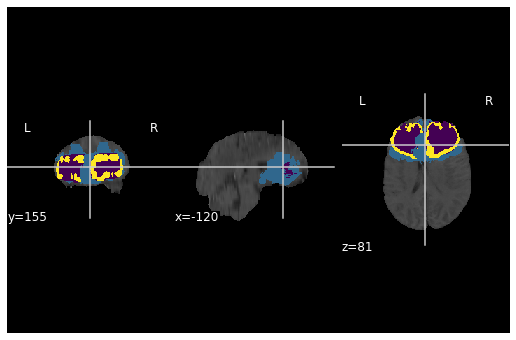

overlapping labels
33736 210726
0.16009415069806288
very overlapping labels
TCGA-06-5408
./TCGA-06-5408
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


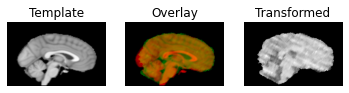

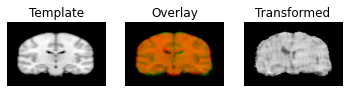

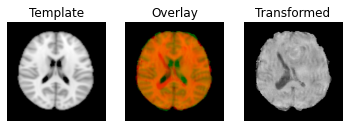

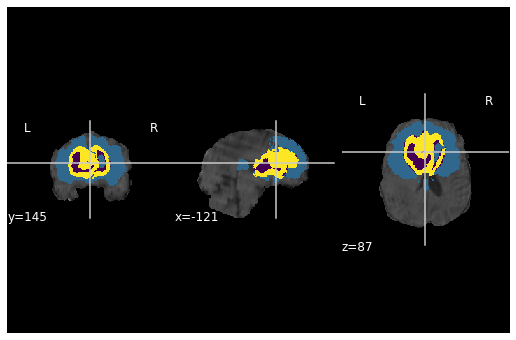

overlapping labels
49326 301789
0.1634453210686937
very overlapping labels
TCGA-02-0009
./TCGA-02-0009
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


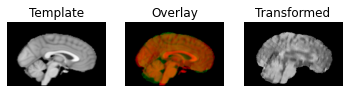

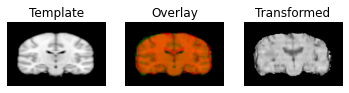

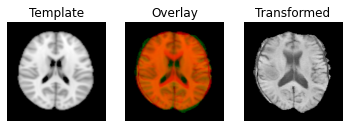

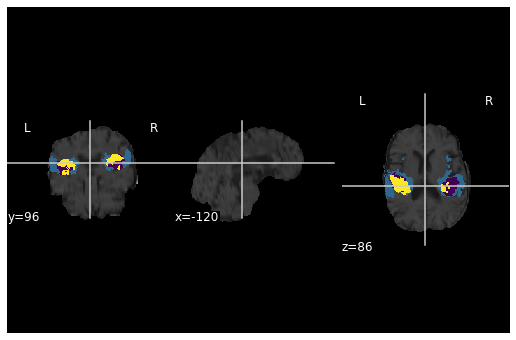

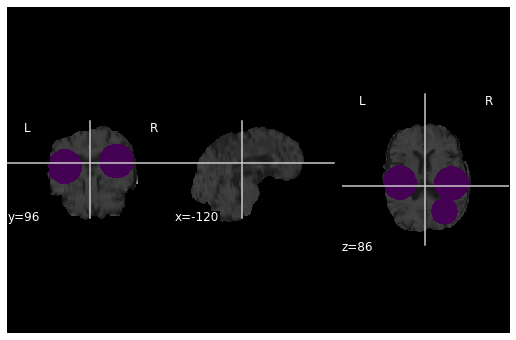

TCGA-06-0188
./TCGA-06-0188
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


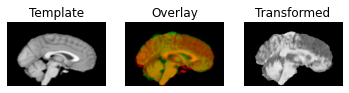

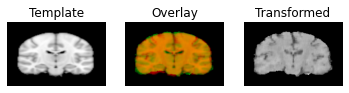

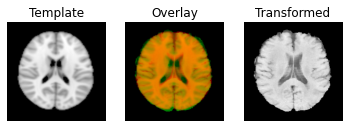

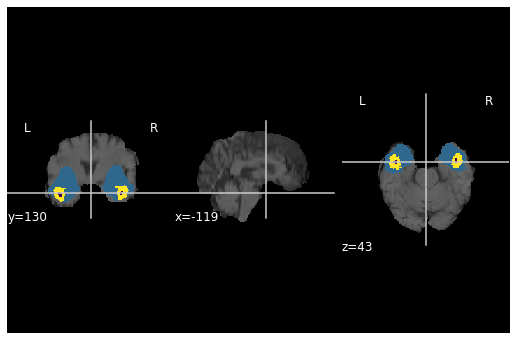

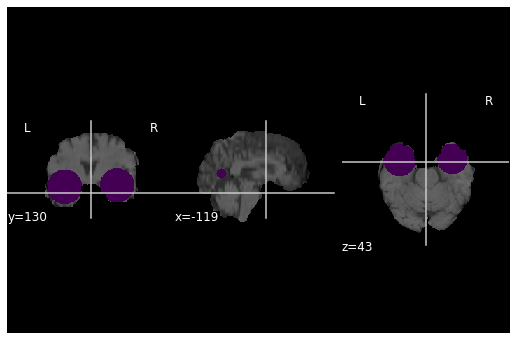

TCGA-06-0176
./TCGA-06-0176
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


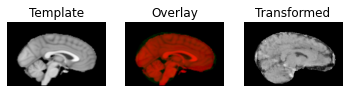

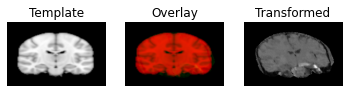

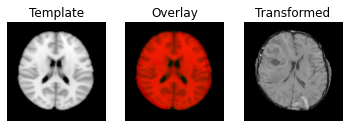

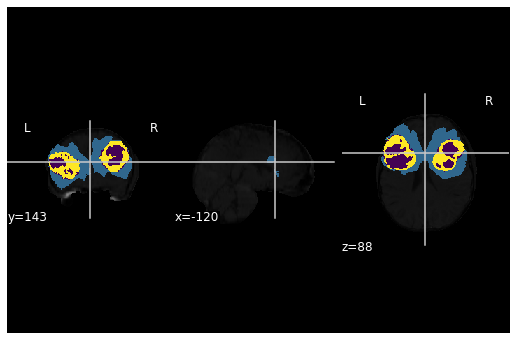

overlapping labels
20 260416
7.680019660850332e-05


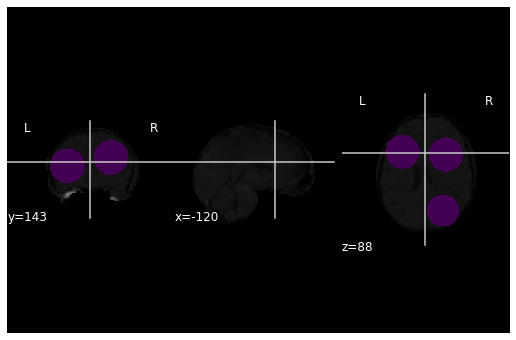

TCGA-FG-6689
./TCGA-FG-6689
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


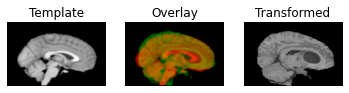

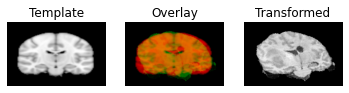

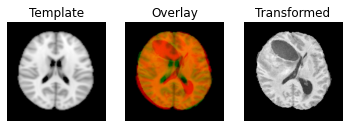

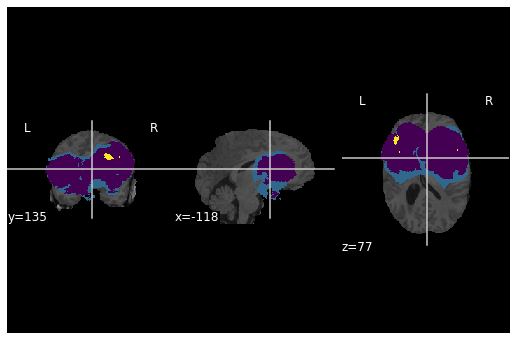

overlapping labels
24937 377196
0.06611151761948696
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-FG-6689/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-FG-6689/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-FG-6689/tda_feats.csv
TCGA-DU-A5TU
./TCGA-DU-A5TU
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


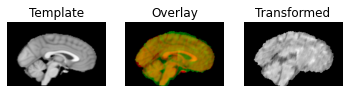

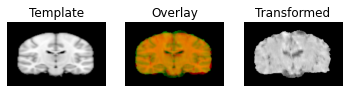

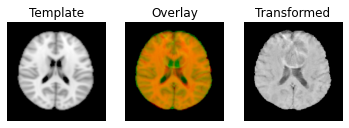

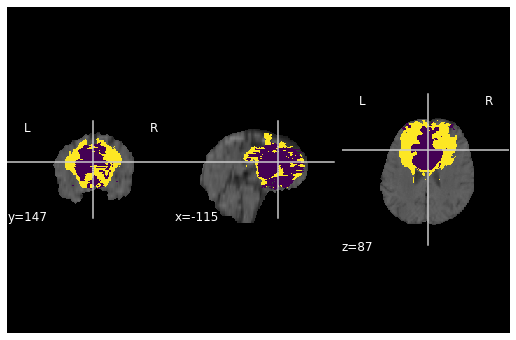

overlapping labels
79678 237332
0.33572379620110226
very overlapping labels
TCGA-06-0139
./TCGA-06-0139
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


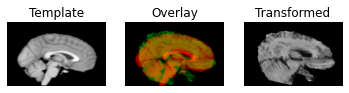

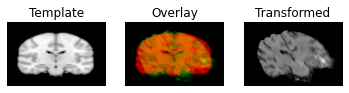

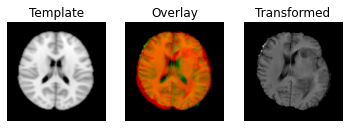

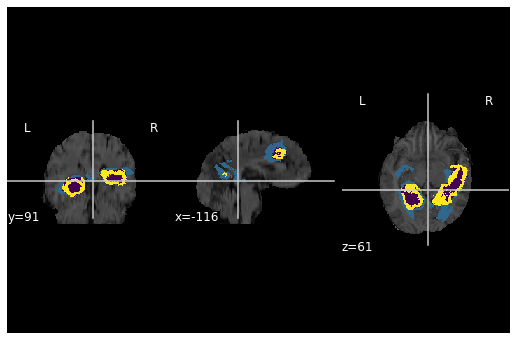

overlapping labels
712 176482
0.0040344057750932106


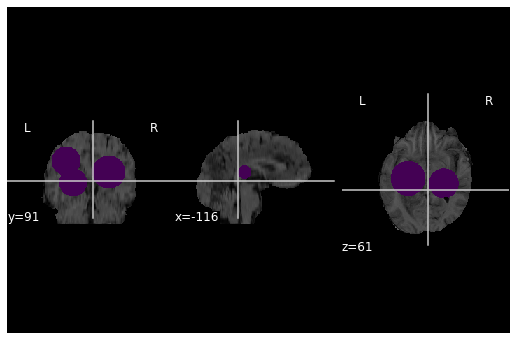

TCGA-DU-A6S7
./TCGA-DU-A6S7
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


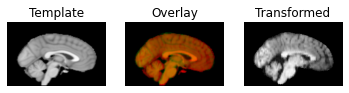

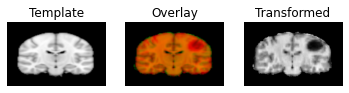

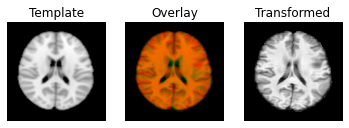

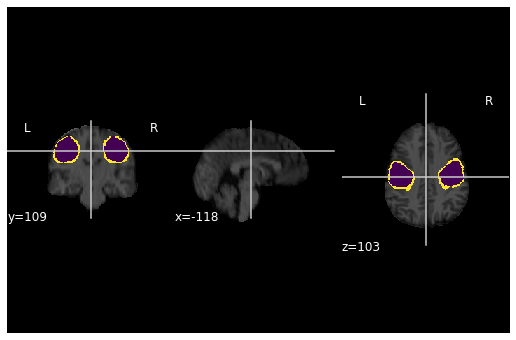

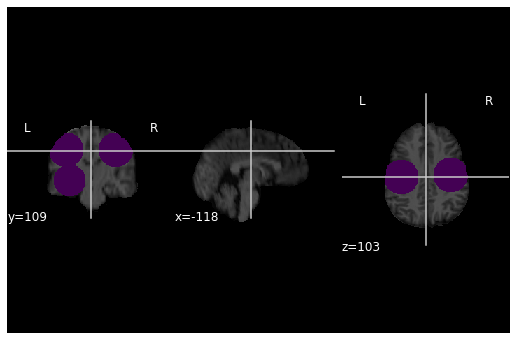

TCGA-DU-7018
./TCGA-DU-7018
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


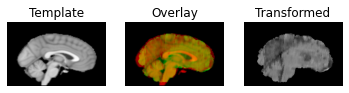

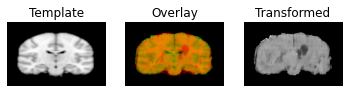

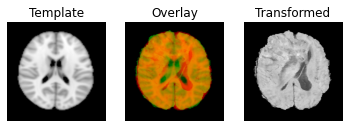

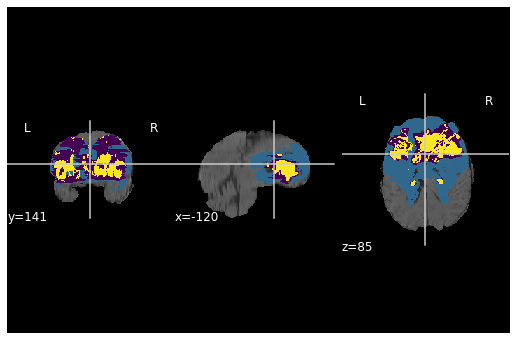

overlapping labels
75749 512567
0.14778360682603445
very overlapping labels
TCGA-76-4935
./TCGA-76-4935
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


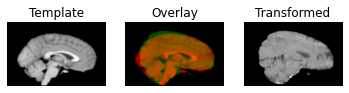

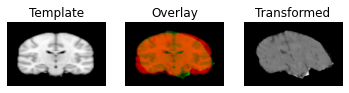

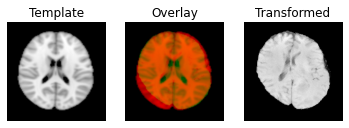

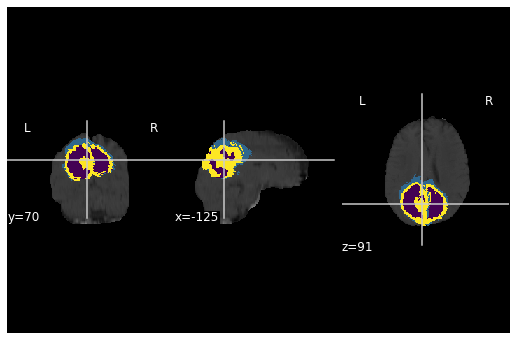

overlapping labels
36097 136417
0.2646077834873953
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-76-4935/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-76-4935/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-76-4935/tda_feats.csv
TCGA-06-2570
./TCGA-06-2570
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


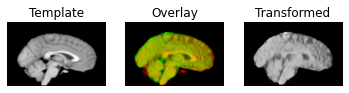

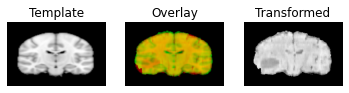

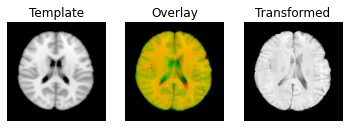

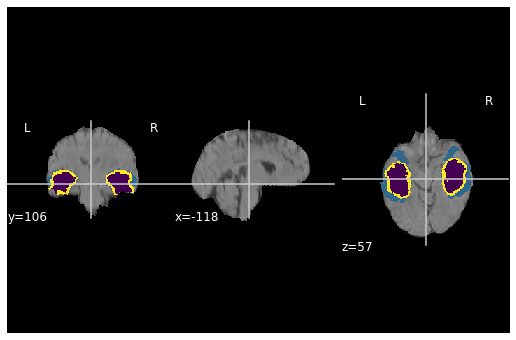

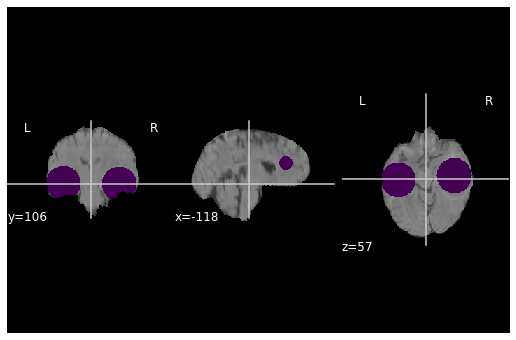

TCGA-DU-7299
./TCGA-DU-7299
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


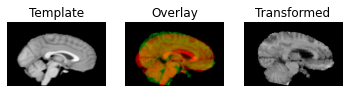

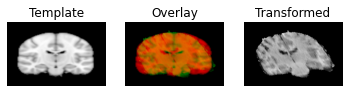

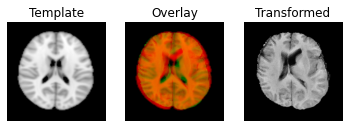

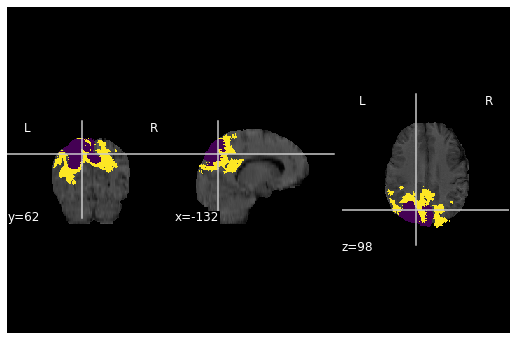

overlapping labels
26114 117441
0.22235846084416855
very overlapping labels
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7299/tex_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7299/cnn_feats.csv
deleting /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7299/tda_feats.csv
TCGA-FG-A4MT
./TCGA-FG-A4MT
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


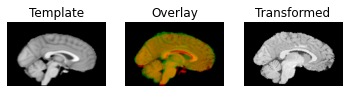

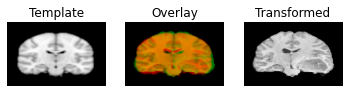

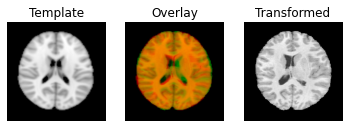

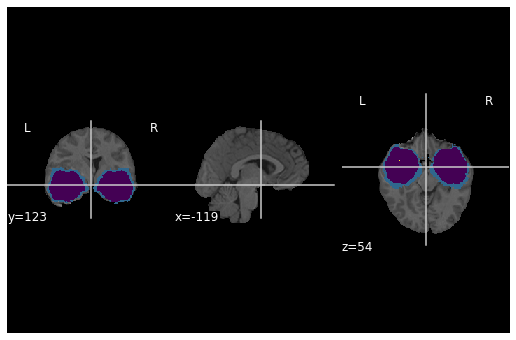

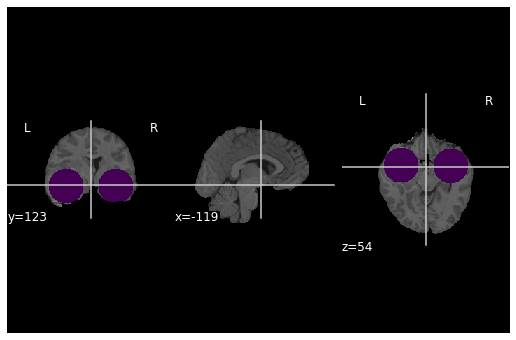

TCGA-HT-8018
./TCGA-HT-8018
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


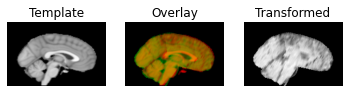

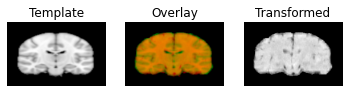

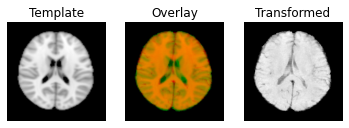

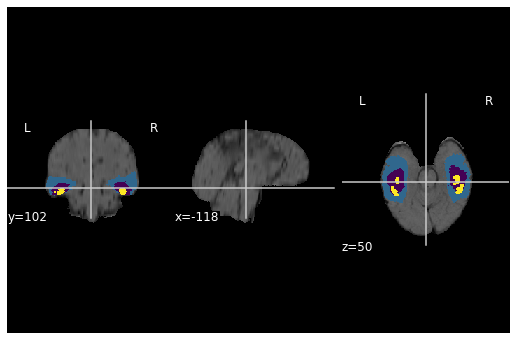

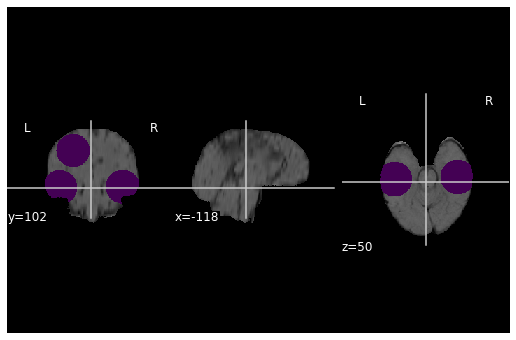

TCGA-02-0086
./TCGA-02-0086
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


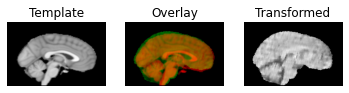

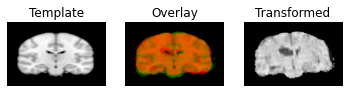

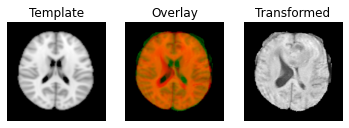

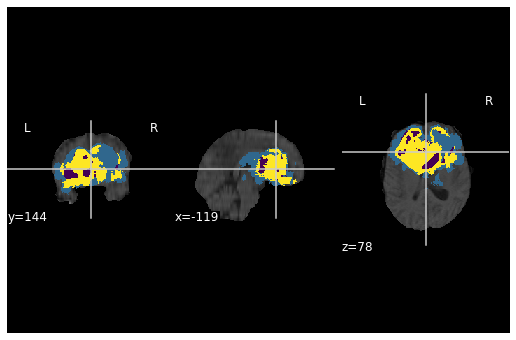

overlapping labels
118744 254248
0.467040055379
very overlapping labels
TCGA-19-1789
./TCGA-19-1789
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


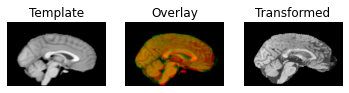

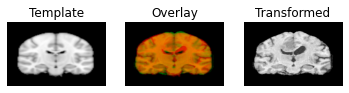

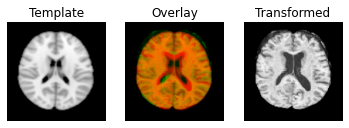

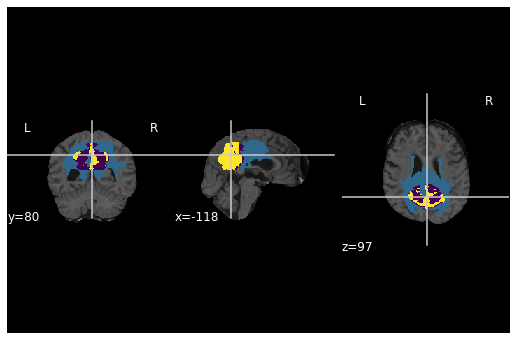

overlapping labels
13355 136926
0.0975344346581365
very overlapping labels
TCGA-DU-5874
./TCGA-DU-5874
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


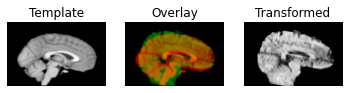

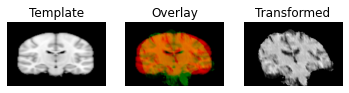

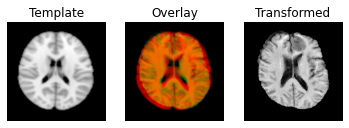

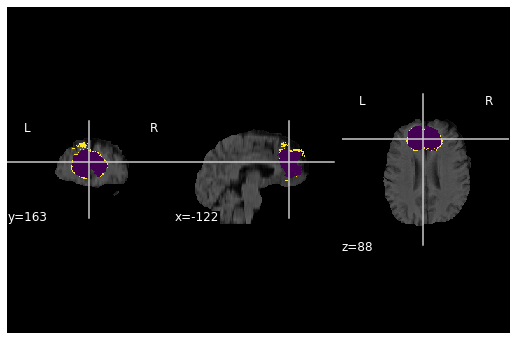

overlapping labels
4923 42708
0.1152711435796572
very overlapping labels
TCGA-06-0184
./TCGA-06-0184
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


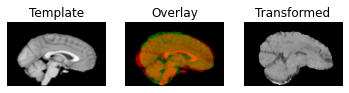

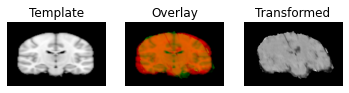

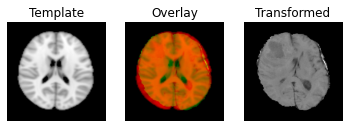

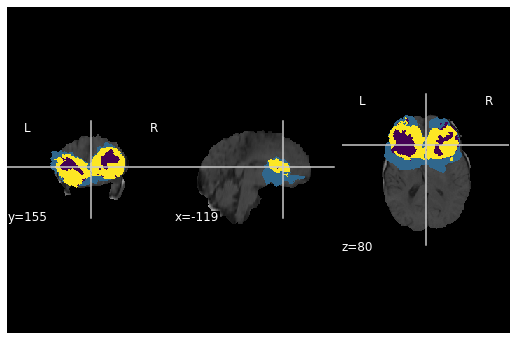

overlapping labels
6551 242062
0.027063314357478663


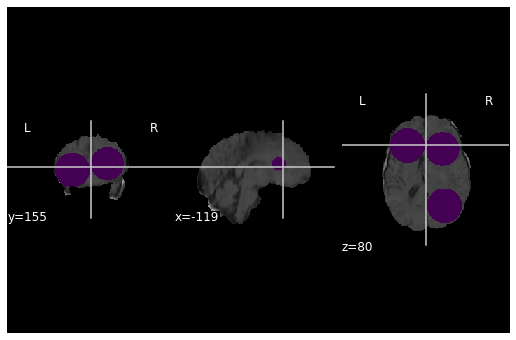

TCGA-DU-8167
./TCGA-DU-8167
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


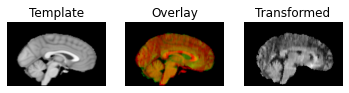

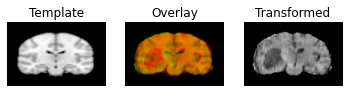

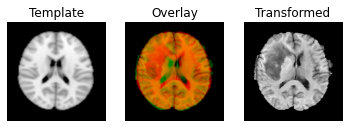

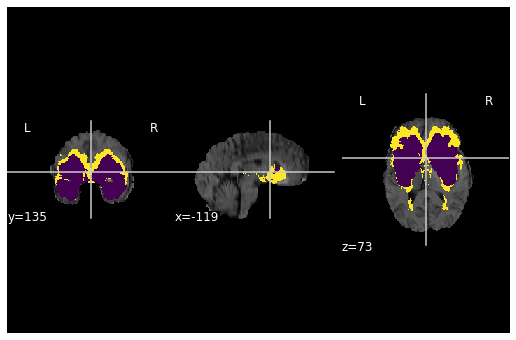

overlapping labels
4491 290681
0.015449926207767278


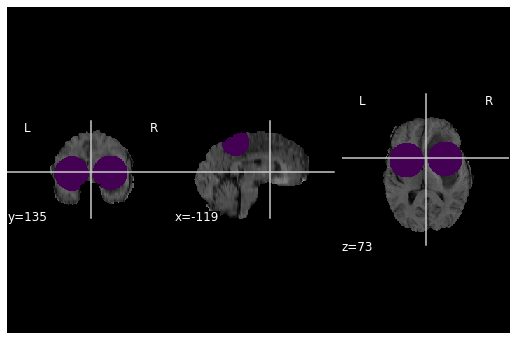

TCGA-HT-7879
./TCGA-HT-7879
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


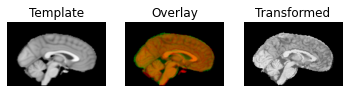

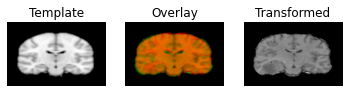

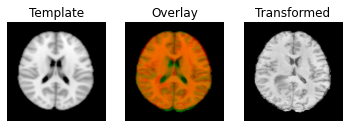

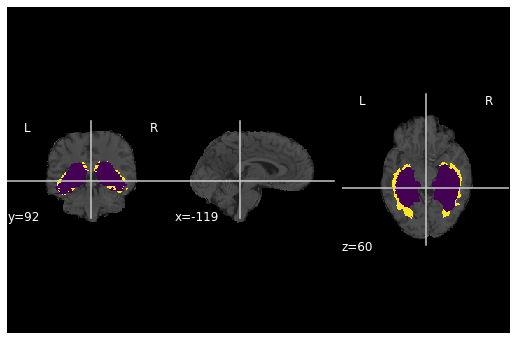

overlapping labels
8 125976
6.350415952244872e-05


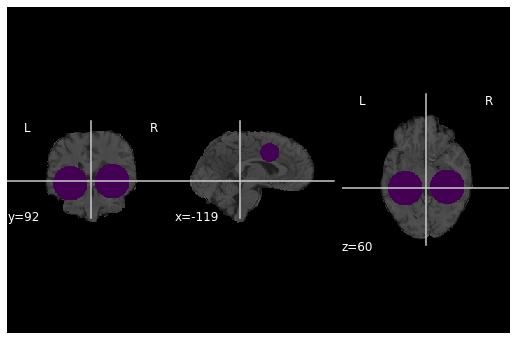

TCGA-06-0145
./TCGA-06-0145
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


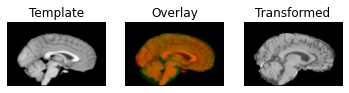

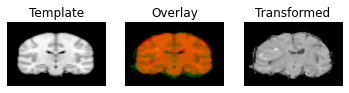

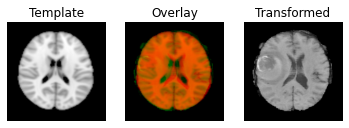

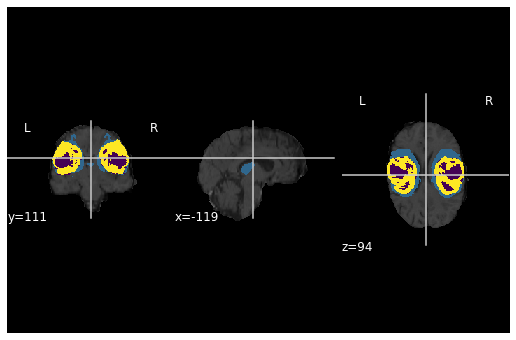

overlapping labels
980 182091
0.0053819244224041825


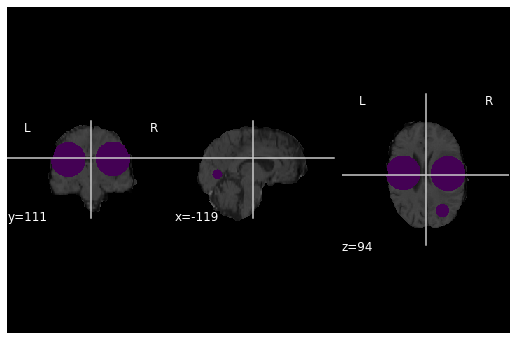

TCGA-76-6285
./TCGA-76-6285
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


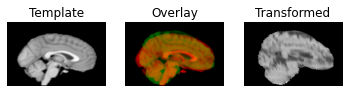

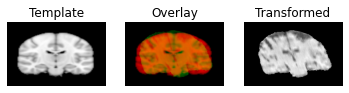

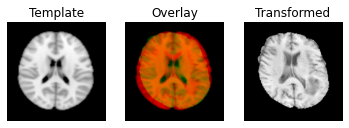

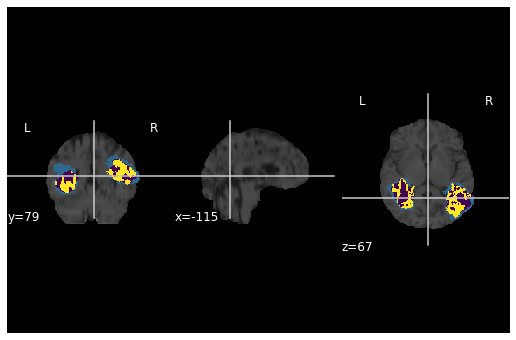

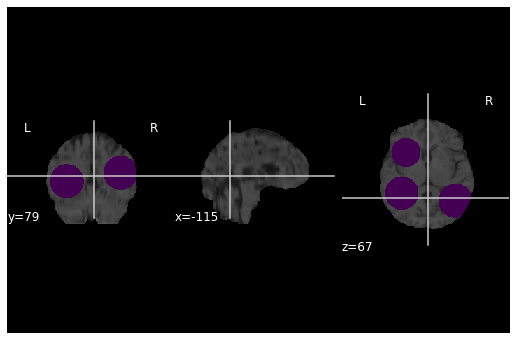

TCGA-DU-5855
./TCGA-DU-5855
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


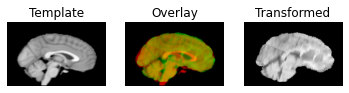

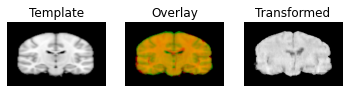

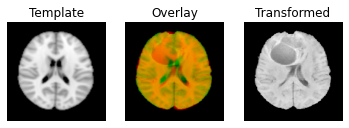

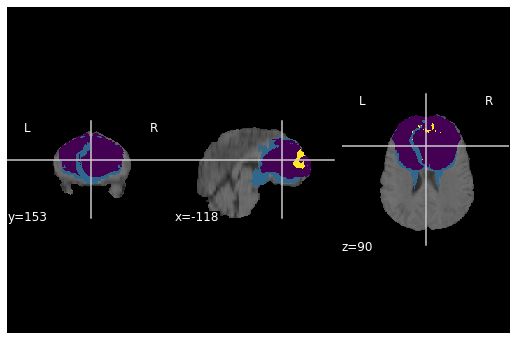

overlapping labels
85310 303955
0.28066654603477487
very overlapping labels
TCGA-76-6661
./TCGA-76-6661
Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


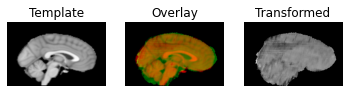

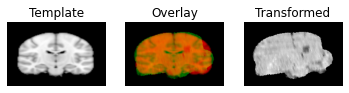

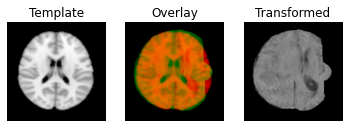

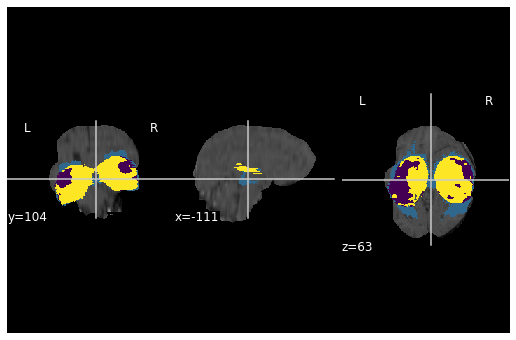

overlapping labels
211 334013
0.0006317119393556538


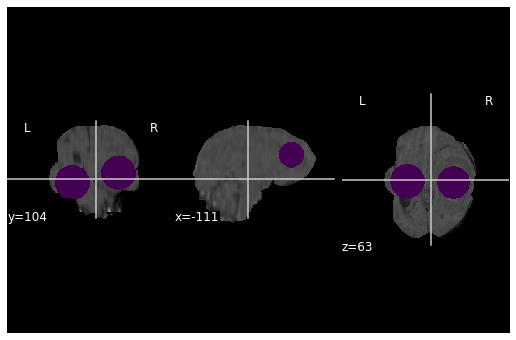

In [ ]:
outImDir = os.path.join(basedir,'data','images','atlases')
if not os.path.exists(outImDir):
    os.makedirs(outImDir)

### https://nilearn.github.io/modules/generated/nilearn.datasets.load_mni152_template.html
# template_img = datasets.load_mni152_template()
orig_template = datasets.load_mni152_template()
template_img = orig_template
# orig_zooms = orig_template.header.get_zooms()[:3]
rerunAffine = True
model_set = cnn_wrapper.load_model_set(modal_list = modal_list)

sampSz = 25

for pNo in range(len(patients)):
# for pNo in [1]:
    pDir = patients[pNo]
    cDir = os.path.join(imagedir,pDir)
    cNIIFile = os.path.join(cDir,'t1.nii.gz')
    if not os.path.exists(cNIIFile):
        continue
    TCGA_ID = os.path.basename(pDir)
    print('%s' % TCGA_ID)

    moving_img = nib.load(cNIIFile)
    if template_img.shape != moving_img.shape:
        print('Resizing template from: ', template_img.shape, ' to ', moving_img.shape)
        template_img = resize_template(orig_template,moving_img)
    print(pDir)    
    cLblFile = os.path.join(cDir,'truth.nii.gz')
    if not os.path.exists(cLblFile):
        continue
    label_img = nib.load(cLblFile)
    label_arr = label_img.get_fdata().astype(np.float64)
    moving_arr2 = deepcopy(moving_img.get_fdata())
    bMask = np.logical_and(moving_arr2 > 0,label_arr == 0)
    medianVal = np.median(moving_arr2[bMask])
    moving_arr2[np.where(label_arr>0)] = medianVal
    # run the multi-step registration (mri_reg.py)
    # (affine,_) = ms_affreg(moving_img,template_img=template_img)
#     moving_zooms = moving_img.header.get_zooms()[:3]
#     temp_rz, temp_aff_rz = reslice(orig_template.get_data(), orig_template.affine, orig_zooms, moving_zooms)
# #     header = orig_template.header
#     template_img = nib.nifti1.Nifti1Image(temp_rz,temp_aff_rz,header = orig_template.header)
#     template_img = orig_template
#     print(template_img)
#     print(template_img.shape,moving_img.shape)
#     print('MNI')
#     f, ax = plt.subplots(figsize=(15, 10))
#     plotting.plot_anat(template_img,axes=ax,cut_coords =(0,0,0))
#     plt.show()
    
    # run the multi-step registration (mri_reg.py)
    cTrMapFile = os.path.join(cDir,'affine_map_2.pkl')
    if rerunAffine or not os.path.isfile(cTrMapFile):
        (affine,_) = ms_affreg(moving_img,template_img=template_img,reg_type=3)
        f = open(cTrMapFile,"wb")
        pickle.dump(affine,f)
        f.close()
    else:
        f = open(cTrMapFile, 'rb')
        affine = pickle.load(f)
        f.close()

    
    transformed = affine.transform(moving_img.get_fdata(),interpolation = 'nearest')
    transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
#     tr_same_sz = affine.transform(moving_img.get_data(),sampling_grid_shape=moving_img.shape)
#     transf_nib = nib.nifti1.Nifti1Image(tr_same_sz,template_img.affine,header=moving_img.header)
    # show the sag,cor,axi alignment map
    regtools.overlay_slices(template_img.get_fdata(), transformed, None, 0,
                        "Template", "Transformed")
    regtools.overlay_slices(template_img.get_fdata(), transformed, None, 1,
                            "Template", "Transformed")
    regtools.overlay_slices(template_img.get_fdata(), transformed, None, 2,
                            "Template", "Transformed")
    
#     print('MNI')
#     f, ax = plt.subplots(figsize=(15, 10))
#     plotting.plot_anat(template_img,axes=ax,cut_coords =(0,0,0))
#     plt.show()
#     f, ax = plt.subplots(figsize=(9, 6))
#     plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
#     plt.savefig(os.path.join(outImDir,'affreg_%s.png' % (TCGA_ID)))
#     plt.show()
    
#     bmask_nib = nib.nifti1.Nifti1Image((transformed > 0)*1,template_img.affine,header=moving_img.header)

#     f, ax = plt.subplots(figsize=(9, 6))
#     plotting.plot_anat(bmask_nib,axes=ax,cut_coords =(0,0,0))
#     plt.savefig(os.path.join(outImDir,'affreg_%s.png' % (TCGA_ID)))
#     plt.show()
    
    
    # contralateral side of tumor

    tr_label = np.round(affine.transform(label_arr,interpolation = 'nearest'),decimals=0)
#     regtools.overlay_slices(moving_img.get_data(), label_img.get_data(), None, 2,
#                             "Orig T1", "Orig Label")
#     regtools.overlay_slices(template_img.get_data(), tr_label, None, 2,
#                             "Transformed T1", "Transformed Label")

    refl_x_aff_arr = nib.affines.from_matvec(np.diag([-1, 1, 1]), [0,0,0])
    refl_x_affine = AffineMap(refl_x_aff_arr,
                           tr_label.shape, template_img.affine,
                           tr_label.shape, template_img.affine)

    refl_label = np.round(refl_x_affine.transform(tr_label,interpolation = 'nearest'),decimals=0)
    # print(refl_label)
#     regtools.overlay_slices(template_img.get_data(), refl_label, None, 2,
#                             "Transformed T1", "Contralateral Label")
#     transf_label_nib = nib.nifti1.Nifti1Image(tr_label,template_img.affine,header=moving_img.header)
#     refl_label_nib = nib.nifti1.Nifti1Image(refl_label,template_img.affine,header=moving_img.header)

#     f, ax = plt.subplots(figsize=(9, 6))
#     pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
#     pl_anat.add_overlay(transf_label_nib)
#     plt.show()
#     f, ax = plt.subplots(figsize=(15, 10))
#     pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
#     pl_anat.add_overlay(refl_label_nib)
#     plt.show()


#     cent_coords = nib.affines.apply_affine(-np.linalg.inv(affine.affine),(0,0,0))
    contr_label = affine.transform_inverse(refl_label,image_grid2world=template_img.affine,
                                           sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                          interpolation = 'nearest')
    contr_label = contr_label.astype(int)
    contr_label_nib = nib.nifti1.Nifti1Image(contr_label,moving_img.affine,header=moving_img.header)
    contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=0)
    label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=0)
#     print(contr_xyz,label_xyz)
    cent_coords = np.add(contr_xyz,label_xyz) /2
    
    f, ax = plt.subplots(figsize=(9, 6))
    pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
    pl_anat.add_overlay(contr_label_nib)
    pl_anat.add_overlay(label_img)
    plt.show()
    
    
    tum_arr = np.logical_and(label_arr,moving_img.get_fdata() > 0) # exclude regions outside of brain mask
    cl_arr = np.logical_and(contr_label,moving_img.get_fdata() > 0) # exclude regions outside of brain mask
    
    tum_cl_iou = np.count_nonzero(np.logical_and(tum_arr,cl_arr))/np.count_nonzero(np.logical_or(tum_arr,cl_arr))

    stopRun = False
    if np.sum(np.logical_and(contr_label>=1,label_arr>=1)) > 0:
        print('overlapping labels')
        print(np.count_nonzero(np.logical_and(tum_arr,cl_arr)),np.count_nonzero(np.logical_or(tum_arr,cl_arr)))
        print(tum_cl_iou)
        if tum_cl_iou > 0.05: # 5% threshold
            print('very overlapping labels')
            stopRun = True
            for ftType in ('tex','cnn','tda'):
                save_str = ('%s_%s.csv' % (ftType,'feats'))
                save_fname = os.path.join(cDir,save_str)
                if os.path.isfile(save_fname):
                    print('deleting %s' % save_fname)
                    os.remove(save_fname)
                
                
    if stopRun:
        continue
    clnt_arr =  np.logical_and(cl_arr,np.logical_not(tum_arr)) # exclude tumor region from contralateral side
    
    bg = mri_utils.get_min_background(moving_arr2)
    fg = np.logical_not(bg)
    
    # spherical samples
    seedBW = np.ones(label_arr.shape)
    lblSubs = np.argwhere(label_arr)
    medLoc = np.median(lblSubs,axis=0)
    medLoc = [int(l) for l in medLoc]
    # lblXYZInt = [int(l) for l in label_xyz]
    seedBW[medLoc[0],medLoc[1],medLoc[2]] = 0
    tumDist = distance_transform_edt(seedBW)

    seedBW = np.ones(contr_label.shape)
    clSubs = np.argwhere(contr_label)
    medLoc = np.median(clSubs,axis=0)
    medLoc = [int(l) for l in medLoc]
    # lblXYZInt = [int(l) for l in label_xyz]
    seedBW[medLoc[0],medLoc[1],medLoc[2]] = 0
    clDist = distance_transform_edt(seedBW)

    # spherical samples with bg filtering
    tumSphLbl = np.logical_and(tumDist <= sampSz,np.logical_and(tumDist<clDist, fg)).astype(int)
    tumSphLblNib = nib.nifti1.Nifti1Image(tumSphLbl,moving_img.affine,header=moving_img.header)

    clSphLbl = np.logical_and(clDist <= sampSz,np.logical_and(tumDist>clDist, fg)).astype(int)
    clSphLblNib = nib.nifti1.Nifti1Image(clSphLbl,moving_img.affine,header=moving_img.header)

#     # version without bg filtering
#     tumSphLbl = np.logical_and(tumDist <= sampSz,tumDist<clDist).astype(int)
#     tumSphLblNib = nib.nifti1.Nifti1Image(tumSphLbl,moving_img.affine,header=moving_img.header)

#     clSphLbl = np.logical_and(clDist <= sampSz,tumDist>clDist).astype(int)
#     clSphLblNib = nib.nifti1.Nifti1Image(clSphLbl,moving_img.affine,header=moving_img.header)

### cerebellum exclusion for ipsilateral
    # bring the cerebellum mask in
    cerSmpNib = nib.nifti1.Nifti1Image(cerSmpMask.astype(int),orig_template.affine,header=orig_template.header)
    rsCerSmpNib = resize_template(cerSmpNib,moving_img)
    
    # match to the moved template
    trCerSmp = (rsCerSmpNib.get_fdata()>=0.5).astype(int)
    trCerSmpNib = nib.nifti1.Nifti1Image(trCerSmp,template_img.affine,header=moving_img.header)
    
    # match to the original orientation
    rfCerSmp = affine.transform_inverse(trCerSmp,
                                        image_grid2world=template_img.affine,
                                        sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                        interpolation = 'nearest')
    rfCerSmpNib = nib.nifti1.Nifti1Image(rfCerSmp.astype(int),moving_img.affine,header=moving_img.header)

    cer_xyz = plotting.find_xyz_cut_coords(template_img, mask_img=trCerSmpNib, activation_threshold=0)
    
    # convex hull cerebellum samples
    cerCH = fill_hull((rfCerSmp>=0.5))
    cerCHNib = nib.nifti1.Nifti1Image(cerCH,moving_img.affine,header=moving_img.header)

    # bring over the LR mask into the current orientation
    LRMaskNib = nib.nifti1.Nifti1Image(LRMask.astype(int),orig_template.affine,header=orig_template.header)
    rsLRMaskNib = resize_template(LRMaskNib,moving_img)
    rfLRMaskSmp = affine.transform_inverse((rsLRMaskNib.get_fdata()>=0.5).astype(int),
                                        image_grid2world=template_img.affine,
                                        sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                        interpolation = 'nearest')

    # find which side it's on
    counts = np.bincount(rfLRMaskSmp[label_arr>0.5])
    maxCtSide = np.argmax(counts)
    ipsiMask = np.logical_and(fg,rfLRMaskSmp == maxCtSide)
#     ipsiMaskNib = nib.nifti1.Nifti1Image(ipsiMask.astype(int),moving_img.affine,header=moving_img.header)

    # find distance from tumor
    dist2Tum = distance_transform_edt(label_arr<0.5)
#     d2TNib = nib.nifti1.Nifti1Image(dist2Tum.astype(int),moving_img.affine,header=moving_img.header)


    ipsiNCerMask = np.logical_and(ipsiMask,cerCH < 0.5)
    ipsiNCerDist = distance_transform_edt(ipsiNCerMask >0.5)
#     mLDist = distance_transform_edt((rfLRMaskSmp == maxCtSide))
#     ipsiNCDNib = nib.nifti1.Nifti1Image(ipsiNCerDist.astype(int),moving_img.affine,header=moving_img.header)

    filtDist2Tum = np.multiply(np.multiply(dist2Tum,ipsiNCerDist>=sampSz),(dist2Tum>=sampSz).astype(int))
    if np.count_nonzero(filtDist2Tum) == 0: # if there's not enough space for a full sample find as much as you can
        filtCDist = np.multiply(np.multiply(ipsiNCerDist,ipsiNCerMask),dist2Tum>=sampSz)
        filtDist2Tum = filtCDist
    
#     filtD2TumNib = nib.nifti1.Nifti1Image(filtDist2Tum.astype(int),moving_img.affine,header=moving_img.header)
#     filtCDistNib = nib.nifti1.Nifti1Image(filtCDist.astype(int),moving_img.affine,header=moving_img.header)
    
    maxDist = np.max(filtDist2Tum)
    
    seedBW = np.ones(label_arr.shape)
    clSubs = np.argwhere(filtDist2Tum >= maxDist)
    medLoc = np.median(clSubs,axis=0)
    medLoc = [int(l) for l in medLoc]
    # lblXYZInt = [int(l) for l in label_xyz]
    seedBW[medLoc[0],medLoc[1],medLoc[2]] = 0
    ilDist = distance_transform_edt(seedBW)

    ilSphLbl = np.logical_and(ilDist <= sampSz,fg).astype(int)
    ilSphNib = nib.nifti1.Nifti1Image(ilSphLbl,moving_img.affine,header=moving_img.header)


    
    f, ax = plt.subplots(figsize=(9, 6))
    pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
    pl_anat.add_overlay(tumSphLblNib)
    pl_anat.add_overlay(clSphLblNib)
    pl_anat.add_overlay(ilSphNib)
    plt.show()
    
    
    
    
#### collect features
    # Texture Features
    (tum_samples,tum_feature_names) = tex_wrapper.get_tex_feats(cDir, label_arr = tum_arr, feat_suffix='_tum')
    (cl_samples,cl_feature_names) = tex_wrapper.get_tex_feats(cDir, label_arr = clnt_arr, feat_suffix='_cl')
    
    (tumSph_samples,tumSph_feature_names) = tex_wrapper.get_tex_feats(cDir, label_arr = tumSphLbl, feat_suffix='_tumSph')
    (clSph_samples,clSph_feature_names) = tex_wrapper.get_tex_feats(cDir, label_arr = clSphLbl, feat_suffix='_clSph')
    (ilSph_samples,ilSph_feature_names) = tex_wrapper.get_tex_feats(cDir, label_arr = ilSphLbl, feat_suffix='_ilSph')

    tum_df = pd.DataFrame(data=tum_samples, columns = tum_feature_names)
    cl_df = pd.DataFrame(data=cl_samples, columns = cl_feature_names)
    tumSph_df = pd.DataFrame(data=tumSph_samples, columns = tumSph_feature_names)
    clSph_df = pd.DataFrame(data=clSph_samples, columns = clSph_feature_names)
    ilSph_df = pd.DataFrame(data=ilSph_samples, columns = ilSph_feature_names)
    
    tum_df['sliceNo'] = tum_df.index
    cl_df['sliceNo'] = cl_df.index
    tumSph_df['sliceNo'] = tumSph_df.index
    clSph_df['sliceNo'] = clSph_df.index
    ilSph_df['sliceNo'] = ilSph_df.index
    
    data_frame = pd.merge(tum_df, cl_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(tumSph_df, clSph_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(data_frame_sph, ilSph_df, on='sliceNo', how='outer')
    data_frame = pd.merge(data_frame,data_frame_sph)
    save_str = ('tex_%s.csv' % 'feats')
    save_fname = os.path.join(cDir,save_str)
    data_frame.to_csv(save_fname)
    
    # CNN Features
    (tum_samples,tum_feature_names) = cnn_wrapper.get_cnn_feats(cDir, label_arr = tum_arr, feat_suffix='_tum',model_set=model_set)
    (cl_samples,cl_feature_names) = cnn_wrapper.get_cnn_feats(cDir, label_arr = clnt_arr, feat_suffix='_cl',model_set=model_set)
    (tumSph_samples,tumSph_feature_names) = cnn_wrapper.get_cnn_feats(cDir, label_arr = tumSphLbl, feat_suffix='_tumSph',model_set=model_set)
    (clSph_samples,clSph_feature_names) = cnn_wrapper.get_cnn_feats(cDir, label_arr = clSphLbl, feat_suffix='_clSph',model_set=model_set)
    (ilSph_samples,ilSph_feature_names) = cnn_wrapper.get_cnn_feats(cDir, label_arr = ilSphLbl, feat_suffix='_ilSph',model_set=model_set)

    tum_df = pd.DataFrame(data=tum_samples, columns = tum_feature_names)
    cl_df = pd.DataFrame(data=cl_samples, columns = cl_feature_names)
    tumSph_df = pd.DataFrame(data=tumSph_samples, columns = tumSph_feature_names)
    clSph_df = pd.DataFrame(data=clSph_samples, columns = clSph_feature_names)
    ilSph_df = pd.DataFrame(data=ilSph_samples, columns = ilSph_feature_names)
    
    tum_df['sliceNo'] = tum_df.index
    cl_df['sliceNo'] = cl_df.index
    tumSph_df['sliceNo'] = tumSph_df.index
    clSph_df['sliceNo'] = clSph_df.index
    ilSph_df['sliceNo'] = ilSph_df.index
    
    data_frame = pd.merge(tum_df, cl_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(tumSph_df, clSph_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(data_frame_sph, ilSph_df, on='sliceNo', how='outer')
    data_frame = pd.merge(data_frame,data_frame_sph)
    save_str = ('cnn_%s.csv' % 'feats')
    save_fname = os.path.join(cDir,save_str)
    data_frame.to_csv(save_fname) 
    
    # TDA Features
    (tum_samples,tum_feature_names) = tda_wrapper.get_tda_feats(cDir, label_arr = tum_arr, feat_suffix='_tum')
    (cl_samples,cl_feature_names) = tda_wrapper.get_tda_feats(cDir, label_arr = clnt_arr, feat_suffix='_cl')
    (tumSph_samples,tumSph_feature_names) = tda_wrapper.get_tda_feats(cDir, label_arr = tumSphLbl, feat_suffix='_tumSph')
    (clSph_samples,clSph_feature_names) = tda_wrapper.get_tda_feats(cDir, label_arr = clSphLbl, feat_suffix='_clSph')
    (ilSph_samples,ilSph_feature_names) = tda_wrapper.get_tda_feats(cDir, label_arr = ilSphLbl, feat_suffix='_ilSph')

    tum_df = pd.DataFrame(data=tum_samples, columns = tum_feature_names)
    cl_df = pd.DataFrame(data=cl_samples, columns = cl_feature_names)
    tumSph_df = pd.DataFrame(data=tumSph_samples, columns = tumSph_feature_names)
    clSph_df = pd.DataFrame(data=clSph_samples, columns = clSph_feature_names)
    ilSph_df = pd.DataFrame(data=ilSph_samples, columns = ilSph_feature_names)
    
    tum_df['sliceNo'] = tum_df.index
    cl_df['sliceNo'] = cl_df.index
    tumSph_df['sliceNo'] = tumSph_df.index
    clSph_df['sliceNo'] = clSph_df.index
    ilSph_df['sliceNo'] = ilSph_df.index
    
    data_frame = pd.merge(tum_df, cl_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(tumSph_df, clSph_df, on='sliceNo', how='outer')
    data_frame_sph = pd.merge(data_frame_sph, ilSph_df, on='sliceNo', how='outer')
    data_frame = pd.merge(data_frame,data_frame_sph)
    save_str = ('tda_%s.csv' % 'feats')
    save_fname = os.path.join(cDir,save_str)
    data_frame.to_csv(save_fname) 
#     samples = np.concatenate((tum_samples, cl_samples), axis=1)
#     feat_names = tum_feature_names + incl_feature_names
#     data_frame.to_csv(save_fname)
    gc.collect()

    
    

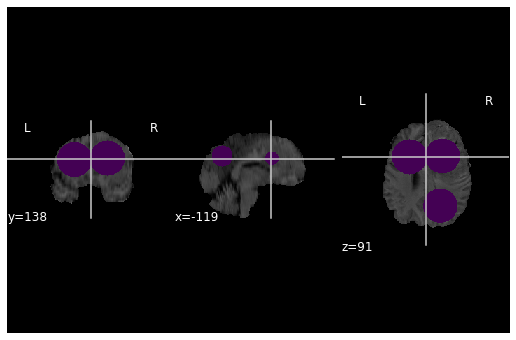

In [214]:
filtDist2Tum = np.multiply(np.multiply(dist2Tum,ipsiNCerDist>=sampSz),(dist2Tum>=sampSz).astype(int))
if np.count_nonzero(filtDist2Tum) == 0: # if there's not enough space for a full sample find as much as you can
    filtCDist = np.multiply(np.multiply(ipsiNCerDist,ipsiNCerMask),dist2Tum>=sampSz)
    filtDist2Tum = filtCDist

    filtD2TumNib = nib.nifti1.Nifti1Image(filtDist2Tum.astype(int),moving_img.affine,header=moving_img.header)
    filtCDistNib = nib.nifti1.Nifti1Image(filtCDist.astype(int),moving_img.affine,header=moving_img.header)

maxDist = np.max(filtDist2Tum)

seedBW = np.ones(label_arr.shape)
clSubs = np.argwhere(filtDist2Tum >= maxDist)
medLoc = np.median(clSubs,axis=0)
medLoc = [int(l) for l in medLoc]
# lblXYZInt = [int(l) for l in label_xyz]
seedBW[medLoc[0],medLoc[1],medLoc[2]] = 0
ilDist = distance_transform_edt(seedBW)

ilSphLbl = np.logical_and(ilDist <= sampSz,fg).astype(int)
ilSphNib = nib.nifti1.Nifti1Image(ilSphLbl,moving_img.affine,header=moving_img.header)



f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
pl_anat.add_overlay(tumSphLblNib)
pl_anat.add_overlay(clSphLblNib)
pl_anat.add_overlay(ilSphNib)
plt.show()

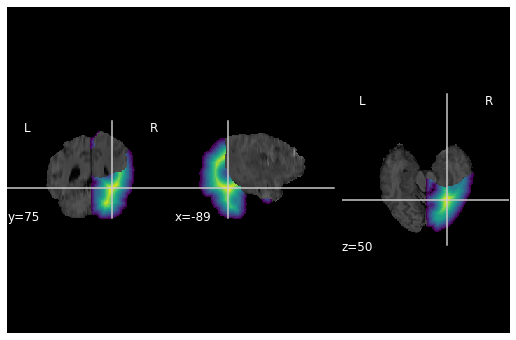

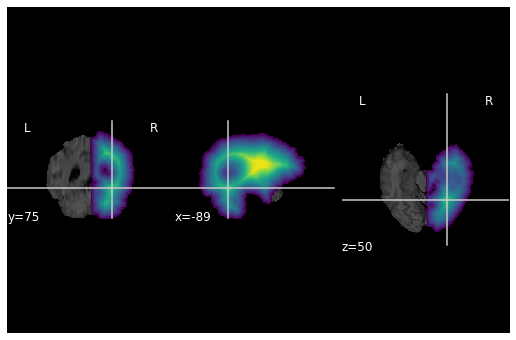

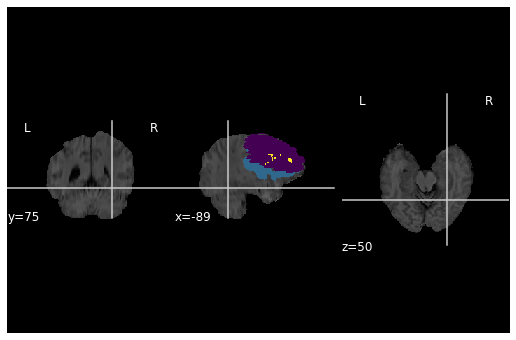

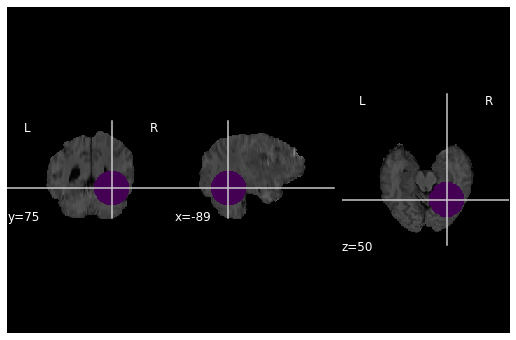

In [212]:
filtD2TumNib = nib.nifti1.Nifti1Image(filtDist2Tum.astype(int),moving_img.affine,header=moving_img.header)
filtCDistNib = nib.nifti1.Nifti1Image(filtCDist.astype(int),moving_img.affine,header=moving_img.header)
d2TNib = nib.nifti1.Nifti1Image(dist2Tum.astype(int),moving_img.affine,header=moving_img.header)
ipsiNCDNib = nib.nifti1.Nifti1Image(ipsiNCerDist.astype(int),moving_img.affine,header=moving_img.header)


mov_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=ilSphNib, activation_threshold=0)

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_anat.add_overlay(filtD2TumNib)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_anat.add_overlay(ipsiNCDNib)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_anat.add_overlay(label_img)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_anat.add_overlay(ilSphNib)

plt.show()

(<Figure size 1080x360 with 6 Axes>,
 array([[<AxesSubplot:title={'center':'Coronal 0'}>,
         <AxesSubplot:title={'center':'Sagittal 0'}>,
         <AxesSubplot:title={'center':'Axial 0'}>]], dtype=object))

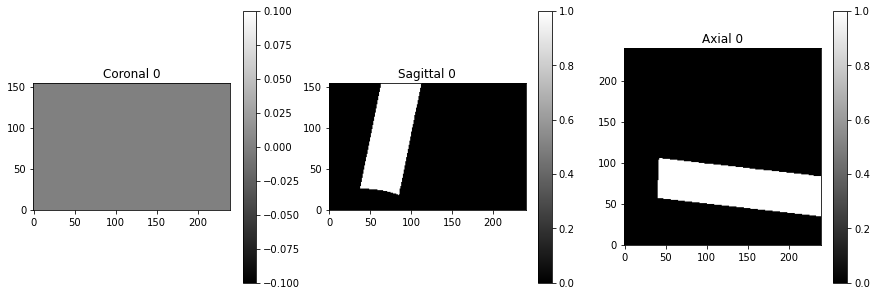

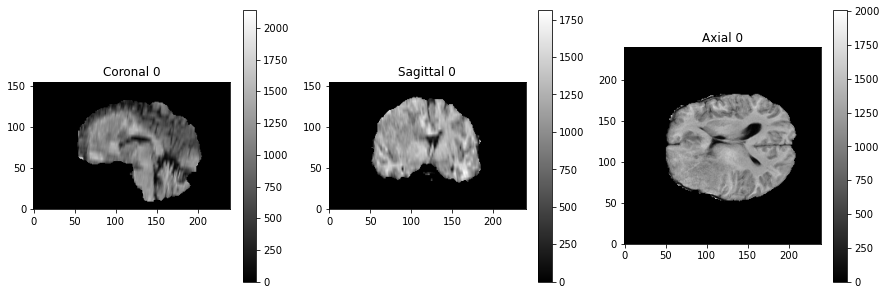

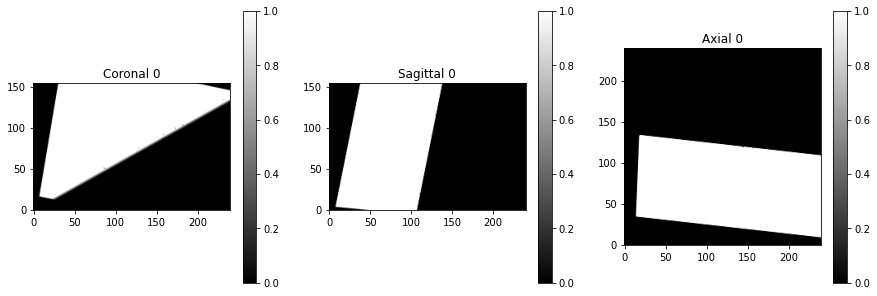

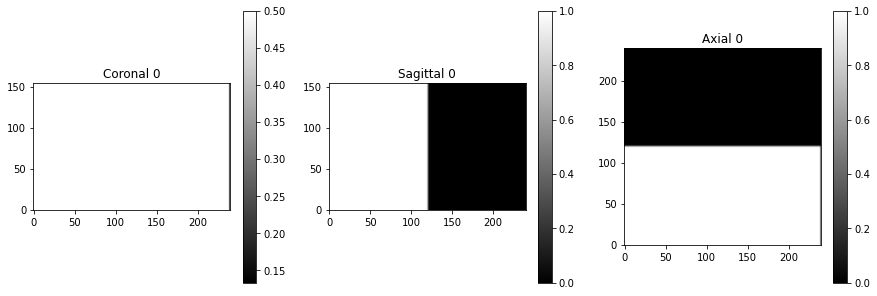

In [199]:
rfLRMaskSmp = affine.transform_inverse((rsLRMaskNib.get_fdata()>=0.5).astype(int),
                                        image_grid2world=template_img.affine,
                                        sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                        interpolation = 'nearest')
rfLRMaskSmp
mri_utils.plot_img_arr(distance_transform_edt(rfLRMaskSmp == maxCtSide) >sampSz)
mri_utils.plot_img_arr(moving_img.get_fdata())
mri_utils.plot_img_arr(rfLRMaskSmp)
mri_utils.plot_img_arr(rsLRMaskNib.get_fdata())


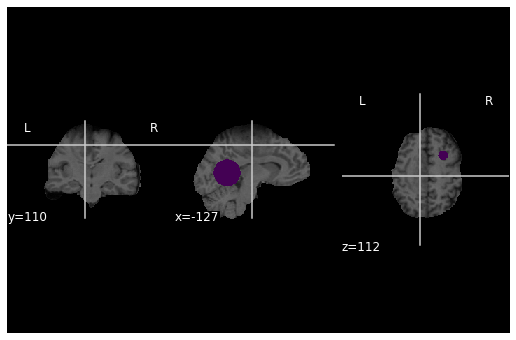

In [188]:
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
pl_anat.add_overlay(tumSphLblNib)
pl_anat.add_overlay(clSphLblNib)
pl_anat.add_overlay(ilSphNib)
plt.show()

In [70]:
seitzman = datasets.fetch_coords_seitzman_2018()
print(seitzman)

{'rois': rec.array([(-4.977e+01, -34.36,  2.574e+01),
           (-3.843e+01, -33.34,  1.698e+01),
           ( 6.543e+01, -33.2 ,  1.997e+01),
           ( 3.175e+01, -26.33,  1.291e+01),
           (-4.914e+01, -26.3 ,  5.180e+00),
           (-6.048e+01, -25.22,  1.382e+01),
           ( 4.345e+01, -22.93,  1.985e+01),
           (-5.292e+01, -21.83,  2.297e+01),
           ( 5.940e+01, -17.34,  2.869e+01),
           ( 5.788e+01, -15.62,  7.490e+00),
           (-5.522e+01,  -9.42,  1.173e+01),
           ( 5.596e+01,  -5.03,  1.325e+01),
           (-4.350e+01, -60.  , -3.000e+01),
           ( 4.350e+01, -60.  , -3.000e+01),
           (-3.400e+01, -42.  , -4.400e+01),
           (-3.012e+01, -27.02,  1.220e+01),
           (-1.539e+01, -14.24,  1.219e+01),
           ( 1.290e+01, -13.94,  1.155e+01),
           (-9.350e+00, -10.17,  2.000e-01),
           ( 9.560e+00,  -7.84,  1.760e+00),
           (-1.614e+01,  -4.82,  7.083e+01),
           (-1.048e+01,  -2.1 ,  4.202e+01),
 

/sw/med/lab/ukarvind/modules/lib/python3/tensorflow-gpu/2.2/lib/python3.7/site-packages/numpy/lib/npyio.py:2349: VisibleDeprecationWarning: Reading unicode strings without specifying the encoding argument is deprecated. Set the encoding, use None for the system default.
  output = genfromtxt(fname, **kwargs)


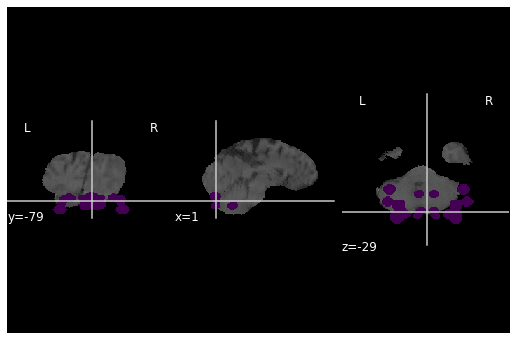

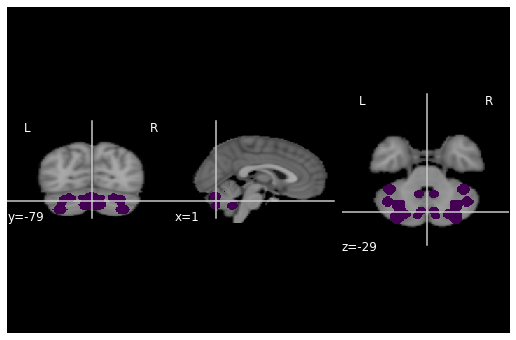

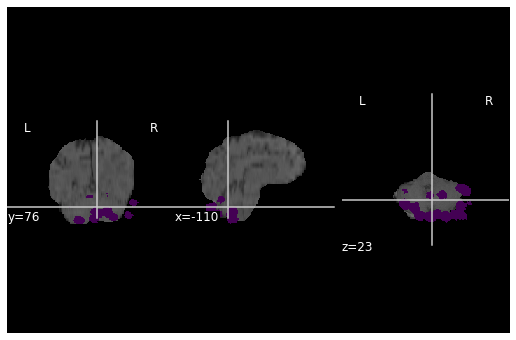

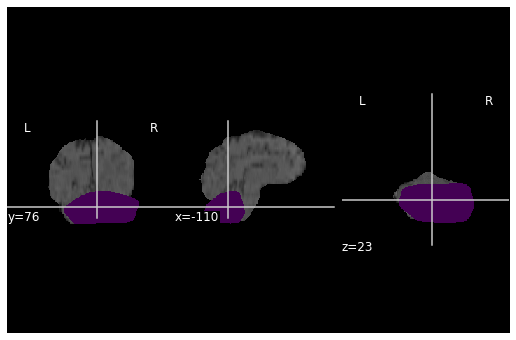

In [158]:
cerSmpNib = nib.nifti1.Nifti1Image(cerSmpMask.astype(int),orig_template.affine,header=orig_template.header)
rsCerSmpNib = resize_template(cerSmpNib,moving_img)

# trCerSmp = affine.transform((rsCerSmpNib.get_fdata()>=0.5).astype(int),interpolation = 'nearest')
trCerSmp = (rsCerSmpNib.get_fdata()>=0.5).astype(int)
trCerSmpNib = nib.nifti1.Nifti1Image(trCerSmp,template_img.affine,header=moving_img.header)

rfCerSmp = affine.transform_inverse(trCerSmp,
                                    image_grid2world=template_img.affine,
                                    sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                    interpolation = 'nearest')
rfCerSmpNib = nib.nifti1.Nifti1Image(rfCerSmp.astype(int),moving_img.affine,header=moving_img.header)

cer_xyz = plotting.find_xyz_cut_coords(template_img, mask_img=trCerSmpNib, activation_threshold=0)

cerCH = fill_hull((rfCerSmp>=0.5))
cerCHNib = nib.nifti1.Nifti1Image(cerCH,moving_img.affine,header=moving_img.header)

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords=cer_xyz)
pl_atlas = pl_anat.add_overlay(trCerSmpNib)
plt.show()
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax,cut_coords=cer_xyz)
pl_atlas = pl_anat.add_overlay(trCerSmpNib)
plt.show()

mov_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=cerCHNib, activation_threshold=0)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(rfCerSmpNib)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(cerCHNib)
plt.show()

# f, ax = plt.subplots(figsize=(9, 6))
# pl_anat = plotting.plot_anat(template_img,axes=ax,cut_coords=mov_xyz)
# pl_atlas = pl_anat.add_overlay(cerCHNib)
# plt.show()

# trCerSmpNib = nib.nifti1.Nifti1Image(trCerSmp,template_img.affine,header=moving_img.header)

# rdCerSmp  = affine.transform_inverse(trCerSmp,image_grid2world=template_img.affine,
#                                         sampling_grid2world=moving_img.affine,
#                                         sampling_grid_shape = moving_img.shape,
#                                         interpolation = 'nearest')
# rdCerSmpNib = nib.nifti1.Nifti1Image(rdCerSmp,moving_img.affine,header=moving_img.header)

# cer_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=trCerSmpNib, activation_threshold=None)
# f, ax = plt.subplots(figsize=(9, 6))
# pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cer_xyz)
# pl_atlas = pl_anat.add_overlay(trCerSmpNib)
# plt.show()

# f, ax = plt.subplots(figsize=(9, 6))
# pl_anat = plotting.plot_anat(t_img,axes=ax,cut_coords=cer_xyz)
# pl_atlas = pl_anat.add_overlay(cerSmpNib)
# plt.show()

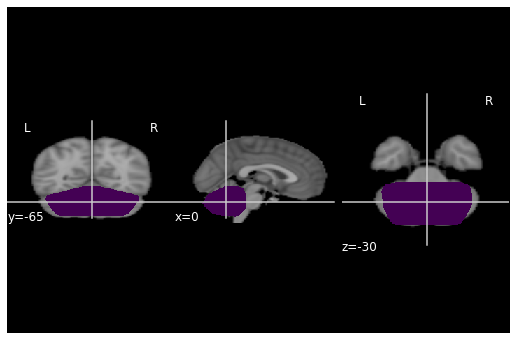

In [144]:
trCerCH = fill_hull(rsCerSmpNib.get_fdata()>=0.5).astype(int)
trCerCHNib = nib.nifti1.Nifti1Image(trCerCH,template_img.affine,header=moving_img.header)

cer_xyz = plotting.find_xyz_cut_coords(template_img, mask_img=trCerCHNib, activation_threshold=0)


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax,cut_coords=cer_xyz)
pl_atlas = pl_anat.add_overlay(trCerCHNib)
plt.show()

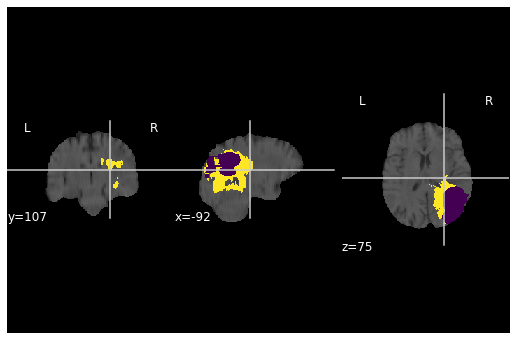

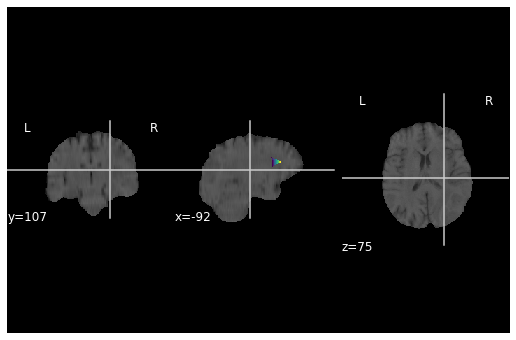

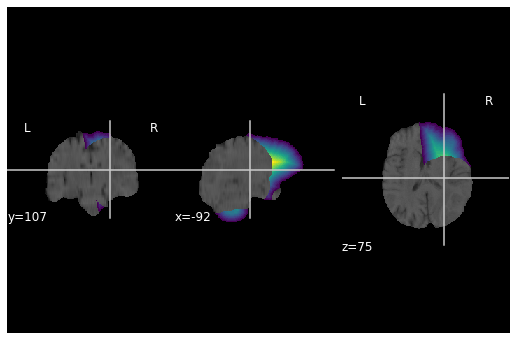

In [176]:
LRMaskNib = nib.nifti1.Nifti1Image(LRMask.astype(int),orig_template.affine,header=orig_template.header)
rsLRMaskNib = resize_template(LRMaskNib,moving_img)
rfLRMaskSmp = affine.transform_inverse((rsLRMaskNib.get_fdata()>=0.5).astype(int),
                                    image_grid2world=template_img.affine,
                                    sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                    interpolation = 'nearest')
# values, counts = np.unique(rfLRMaskSmp[label_arr>0.5], return_counts=True)
# maxCt = max
# print(values, counts)
counts = np.bincount(rfLRMaskSmp[label_arr>0.5])
maxCtSide = np.argmax(counts)
ipsiMask = np.logical_and(fg,rfLRMaskSmp == maxCtSide)
ipsiMaskNib = nib.nifti1.Nifti1Image(ipsiMask.astype(int),moving_img.affine,header=moving_img.header)

dist2Tum = distance_transform_edt(label_arr<0.5)
d2TNib = nib.nifti1.Nifti1Image(dist2Tum.astype(int),moving_img.affine,header=moving_img.header)


ipsiNCerMask = np.logical_and(ipsiMask,trCerCH < 0.5)
ipsiNCerDist = distance_transform_edt(ipsiNCerMask >0.5)
ipsiNCDNib = nib.nifti1.Nifti1Image(ipsiNCerDist.astype(int),moving_img.affine,header=moving_img.header)

filtDist2Tum = np.multiply(np.multiply(dist2Tum,ipsiNCerDist>=sampSz),(dist2Tum>=sampSz).astype(int))
filtCDist = np.multiply(np.multiply(ipsiNCerDist,ipsiNCerMask),dist2Tum>=sampSz)
filtD2TumNib = nib.nifti1.Nifti1Image(filtDist2Tum.astype(int),moving_img.affine,header=moving_img.header)
filtCDistNib = nib.nifti1.Nifti1Image(filtCDist.astype(int),moving_img.affine,header=moving_img.header)


mov_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=ipsiMaskNib, activation_threshold=0)

# f, ax = plt.subplots(figsize=(9, 6))
# pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
# pl_atlas = pl_anat.add_overlay(ipsiNCDNib)
# plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(label_img)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(filtD2TumNib)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(filtCDistNib)
plt.show()

# f, ax = plt.subplots(figsize=(9, 6))
# pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
# pl_atlas = pl_anat.add_overlay(d2TNib)
# plt.show()

42.0


/sw/med/lab/ukarvind/modules/lib/python3/tensorflow-gpu/2.2/lib/python3.7/site-packages/numpy/ma/core.py:2832: UserWarning: Warning: converting a masked element to nan.
  order=order, subok=True, ndmin=ndmin)


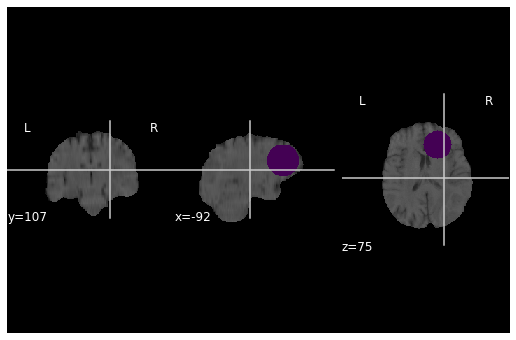

In [180]:
maxDist = np.max(filtDist2Tum)
print(maxDist)

seedBW = np.ones(label_arr.shape)
clSubs = np.argwhere(filtDist2Tum >= maxDist)
medLoc = np.median(clSubs,axis=0)
medLoc = [int(l) for l in medLoc]
# lblXYZInt = [int(l) for l in label_xyz]
seedBW[medLoc[0],medLoc[1],medLoc[2]] = 0
ilDist = distance_transform_edt(seedBW)

ilSamp = np.logical_and(ilDist <= sampSz,fg).astype(int)
ilSampNib = nib.nifti1.Nifti1Image(ilSamp,moving_img.affine,header=moving_img.header)



f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=mov_xyz)
pl_atlas = pl_anat.add_overlay(ilSampNib)
plt.show()

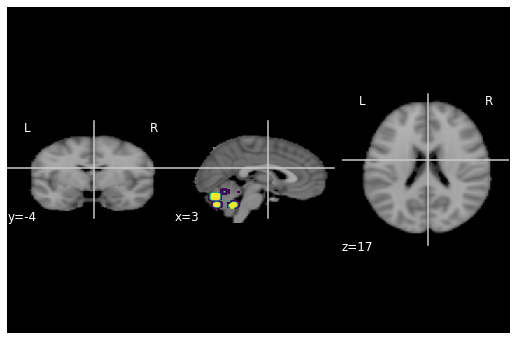

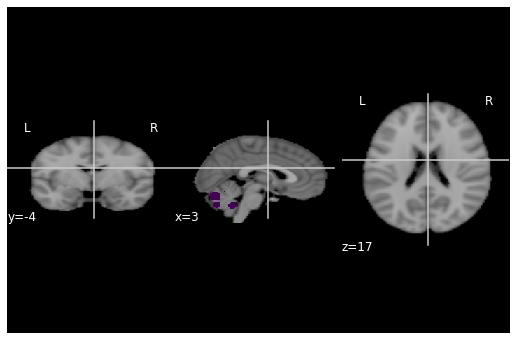

In [77]:
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax)
pl_atlas = pl_anat.add_overlay(rsCerSmpNib)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax)
pl_atlas = pl_anat.add_overlay(trCerSmpNib)
plt.show()

/sw/med/lab/ukarvind/modules/lib/python3/tensorflow-gpu/2.2/lib/python3.7/site-packages/numpy/ma/core.py:2832: UserWarning: Warning: converting a masked element to nan.
  order=order, subok=True, ndmin=ndmin)


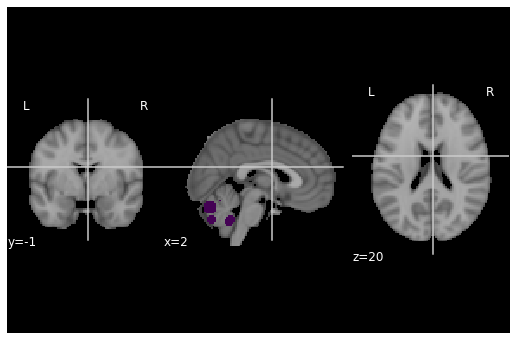

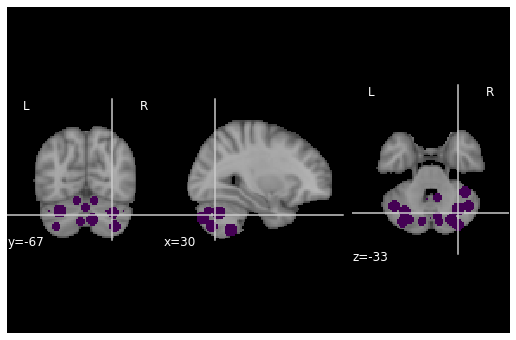

In [226]:
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(orig_template,axes=ax)
distMaskNib = nib.nifti1.Nifti1Image(distMask.astype(int),orig_template.affine,header=orig_template.header)
pl_atlas = pl_anat.add_overlay(distMaskNib)
plt.show()

cer_xyz = plotting.find_xyz_cut_coords(orig_template, mask_img=distMaskNib, activation_threshold=None)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(orig_template,axes=ax,cut_coords=cer_xyz)
distMaskNib = nib.nifti1.Nifti1Image(distMask.astype(int),orig_template.affine,header=orig_template.header)
pl_atlas = pl_anat.add_overlay(distMaskNib)
plt.show()

# Load Processed Data

In [15]:
dataFrameInitialized = False # flag for when the dataframe is initialized
dataTypes = ['tex','tda','cnn']
cNamesDict = { t :[] for t in dataTypes}
# for pDir in patients:
#for i in range(80):
for pN in range(len(patients)):
# for pN in range(1):
    pDir = patients[pN]
    cDir = os.path.join(imagedir,pDir)
    cNIIFile = os.path.join(cDir,'t1.nii.gz')
    if not os.path.exists(cNIIFile):
        continue
    TCGA_ID = os.path.basename(pDir)

    print(pDir)
    cDataList = list() 
    for cStr in dataTypes:
        fName = '%s_%s.csv' % (cStr,'feats')
        csvFile = os.path.join(cDir,fName)
        if not os.path.exists(csvFile):
            print('Couldn\'t find: %s' % csvFile)
            continue
        csv_data = pd.read_csv(csvFile)
#         csv_data = csv_data.rename(index=str, columns={'Unnamed: 0': "sliceNo"})
        csv_data = csv_data.set_index('sliceNo')
        if not cNamesDict[cStr]:
            cNames = [v for v in csv_data.columns.values if 'Unnamed' not in v]
            cNamesDict[cStr] = cNames
        cDataList.append(csv_data)
        
    if len(cDataList) == 0:
        # Couldn't find any files
        continue
        
    newData = pd.concat(cDataList, axis=1)
    newData = newData.drop('Unnamed: 0',axis=1)
#     print(newData.columns)
    newData['sliceNo'] = newData.index
    #print(csvFile)


    newData['patient'] = TCGA_ID
    newData.set_index(['patient','sliceNo'])

    cPatData = newData
    if not dataFrameInitialized: # first run through, there's no dataframe
        dataFrameInitialized = True
        patData = cPatData
    else:
        patData = pd.concat((patData,cPatData),join = 'outer')
        
patData.to_csv(os.path.join(splitdir,'tumClData.csv'))

./TCGA-DU-A5TT
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/tex_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/tda_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-A5TT/cnn_feats.csv
./TCGA-DU-8168
./TCGA-DU-6404
./TCGA-06-0138
./TCGA-14-3477
./TCGA-06-0240
./TCGA-CS-6666
./TCGA-76-6664
./TCGA-DU-7309
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7309/tex_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7309/tda_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7309/cnn_feats.csv
./TCGA-12-3650
./TCGA-FG-6691
./TCGA-HT-8563
./TCGA-DU-7298
./TCGA-19-5958
./TCGA-HT-7884
./TCGA-02-0068
./TCGA-DU-6542
./TCGA-DU-A5TW
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_d

./TCGA-CS-4944
./TCGA-DU-7302
./TCGA-19-2631
./TCGA-DU-7019
./TCGA-06-0122
./TCGA-02-0046
./TCGA-HT-7680
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-HT-7680/tex_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-HT-7680/tda_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-HT-7680/cnn_feats.csv
./TCGA-CS-6669
./TCGA-HT-7602
./TCGA-DU-8164
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-8164/tex_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-8164/tda_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-8164/cnn_feats.csv
./TCGA-08-0356
./TCGA-DU-7010
Couldn't find: /data/ncwang/Contralateral_analysis/data/N4_corrected_image_data/./TCGA-DU-7010/tex_feats.csv
Couldn't find: /data/ncwang/Contralateral_analysis/data/N

# Load up Clinical/Genetic Data

In [9]:
# xl = pd.ExcelFile(os.path.join(basedir,'data','clinical_data_v2.xls'))
# df = np.asarray(xl.parse("S1A. TCGA discovery dataset"))

xl = pd.read_excel(os.path.join(basedir,'data','clinical_data_v2.xls'),sheet_name=0)
df = np.asarray(xl)
#pIdxs =np.arange(np.asarray(df[:,0]).shape[0])[np.in1d(df[:,0],patients)]
# patIDs = [patients[i] for i in dirIdxs]
pMask = np.in1d(df[:,0],patients)
dfFilt = df[pMask,:] # filter out the rows of the excel file that don't have imaging information

mRE ='TCGA(-[a-zA-Z0-9]+)+'
mObjList = [re.match(mRE,os.path.basename(IDFN)) for IDFN in patients]
patIDs = [mO[0] if mO else '' for mO in mObjList ]
print(patIDs)
pMask = np.in1d(df[:,0],patIDs) 
arrFilt = df[pMask,:]
dfFilt = pd.DataFrame(arrFilt,columns=xl.columns)
dfFilt

['TCGA-DU-A5TT', 'TCGA-DU-8168', 'TCGA-DU-6404', 'TCGA-06-0138', 'TCGA-14-3477', 'TCGA-06-0240', 'TCGA-CS-6666', 'TCGA-76-6664', 'TCGA-DU-7309', 'TCGA-12-3650', 'TCGA-FG-6691', 'TCGA-HT-8563', 'TCGA-DU-7298', 'TCGA-19-5958', 'TCGA-HT-7884', 'TCGA-02-0068', 'TCGA-DU-6542', 'TCGA-DU-A5TW', 'TCGA-06-5413', 'TCGA-12-0829', 'TCGA-06-6389', 'TCGA-CS-6668', 'TCGA-CS-6188', 'TCGA-06-0187', 'TCGA-FG-6692', 'TCGA-12-0616', 'TCGA-19-2624', 'TCGA-02-0070', 'TCGA-02-0069', 'TCGA-02-0011', 'TCGA-02-0116', 'TCGA-DU-8166', 'TCGA-76-6663', 'TCGA-06-5408', 'TCGA-02-0009', 'TCGA-06-0188', 'TCGA-06-0176', 'TCGA-FG-6689', 'TCGA-DU-A5TU', 'TCGA-06-0139', 'TCGA-DU-A6S7', 'TCGA-DU-7018', 'TCGA-76-4935', 'TCGA-06-2570', 'TCGA-DU-7299', 'TCGA-FG-A4MT', 'TCGA-HT-8018', 'TCGA-02-0086', 'TCGA-19-1789', 'TCGA-DU-5874', 'TCGA-06-0184', 'TCGA-DU-8167', 'TCGA-HT-7879', 'TCGA-06-0145', 'TCGA-76-6285', 'TCGA-DU-5855', 'TCGA-76-6661', 'TCGA-76-6656', 'TCGA-02-0006', 'TCGA-DU-7300', 'TCGA-DU-A6S8', 'TCGA-08-0355', 'TCGA-0

,Case,Tissue source site,Study,BCR,Whole exome,Whole genome,RNAseq,SNP6,U133a,HM450,...,Transcriptome Subtype,Pan-Glioma RNA Expression Cluster,IDH-specific RNA Expression Cluster,Pan-Glioma DNA Methylation Cluster,IDH-specific DNA Methylation Cluster,Supervised DNA Methylation Cluster,Random Forest Sturm Cluster,RPPA cluster,Telomere length estimate in blood normal (Kb),Telomere length estimate in tumor (Kb)
0,TCGA-CS-4942,Thomas Jefferson University,Brain Lower Grade Glioma,IGC,Yes,No,Yes,Yes,No,Yes,...,PN,LGr3,IDHmut-R3,LGm2,IDHmut-K2,G-CIMP-high,IDH,K2,NaN,NaN
1,TCGA-CS-4944,Thomas Jefferson University,Brain Lower Grade Glioma,IGC,Yes,Yes,Yes,Yes,No,Yes,...,NaN,LGr3,IDHmut-R3,LGm2,IDHmut-K2,G-CIMP-high,IDH,K2,3.2645,1.4981
2,TCGA-CS-5393,Thomas Jefferson University,Brain Lower Grade Glioma,IGC,Yes,No,Yes,Yes,No,Yes,...,PN,LGr3,IDHmut-R3,LGm2,IDHmut-K2,G-CIMP-high,IDH,K2,NaN,NaN
3,TCGA-CS-5396,Thomas Jefferson University,Brain Lower Grade Glioma,IGC,Yes,Yes,Yes,Yes,No,Yes,...,PN,LGr1,IDHmut-R1,LGm3,IDHmut-K3,Codel,IDH,K1,2.9974,1.6563
4,TCGA-CS-5397,Thomas Jefferson University,Brain Lower Grade Glioma,IGC,Yes,No,Yes,Yes,No,Yes,...,NE,LGr4,IDHwt-R4,LGm5,IDHwt-K2,Mesenchymal-like,Mesenchymal,K2,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138,TCGA-76-6657,Thomas Jefferson University,Glioblastoma multiforme,IGC,Yes,No,No,Yes,No,Yes,...,NaN,NaN,NaN,LGm4,IDHwt-K1,Classic-like,RTK II 'Classic',K1,NaN,NaN
139,TCGA-76-6661,Thomas Jefferson University,Glioblastoma multiforme,IGC,Yes,No,No,Yes,No,Yes,...,NaN,NaN,NaN,LGm4,IDHwt-K1,Classic-like,RTK II 'Classic',K1,NaN,NaN
140,TCGA-76-6662,Thomas Jefferson University,Glioblastoma multiforme,IGC,Yes,No,No,Yes,No,Yes,...,NaN,NaN,NaN,LGm4,IDHwt-K1,Classic-like,Mesenchymal,K1,NaN,NaN
141,TCGA-76-6663,Thomas Jefferson University,Glioblastoma multiforme,IGC,Yes,No,No,Yes,No,Yes,...,NaN,NaN,NaN,LGm4,IDHwt-K1,Classic-like,Mesenchymal,K1,NaN,NaN


In [10]:
patient_age = arrFilt[:,[0,14]]
patient_IDH_raw = arrFilt[:,[0,21]]
patient_IDH = patient_IDH_raw.copy()
# handle nans, turn into pseudoboolean
patient_IDH[:,1] = np.where(patient_IDH[:,1] == 'Mutant', 1, 
                             np.where(patient_IDH[:,1] == 'WT',0,np.nan))
print('IDH Raw\n',pd.value_counts(patient_IDH_raw[:,1],dropna=False))
print('IDH\n', pd.value_counts(patient_IDH[:,1],dropna=False))

patient_1p19q = arrFilt[:,[0,22]]
print('\n1p19q\n', pd.value_counts(patient_1p19q[:,1],dropna=False))

patient_IDH1_1p19q = arrFilt[:,[0,23]]
patient_MGMT_raw = arrFilt[:,[0,24]]
patient_MGMT = patient_MGMT_raw.copy()
# handle nans, turn into pseudoboolean
patient_MGMT[:,1] = np.where(patient_MGMT[:,1] == 'Methylated', 1, 
                             np.where(patient_MGMT[:,1] == 'Unmethylated',0,np.nan))

print('\nMGMT Raw\n',pd.value_counts(patient_MGMT_raw[:,1],dropna=False))
print('MGMT\n',pd.value_counts(patient_MGMT[:,1],dropna=False))

patient_TERT_raw = arrFilt[:,[0,27]]
patient_TERT = patient_TERT_raw.copy()
patient_TERT[:,1] = np.where(patient_TERT[:,1] == 'Mutant', 1, 
                             np.where(patient_TERT[:,1] == 'WT',0,np.nan))
print('\nTERT Raw\n',pd.value_counts(patient_TERT_raw[:,1],dropna=False))
print('TERT\n',pd.value_counts(patient_TERT[:,1],dropna=False))

patient_ATRX_raw = arrFilt[:,[0,30]]
patient_ATRX = patient_ATRX_raw.copy()
patient_ATRX[:,1] = np.where(patient_ATRX[:,1] == 'Mutant', 1, 
                             np.where(patient_ATRX[:,1] == 'WT',0,np.nan))
print('\nATRX Raw\n',pd.value_counts(patient_ATRX_raw[:,1],dropna=False))
print('ATRX\n',pd.value_counts(patient_ATRX[:,1],dropna=False))

patient_OS = arrFilt[:,[0,16]]
patient_gender = arrFilt[:,[0,15]]
patient_KPS = arrFilt[:,[0,18]]
kps_mask = pd.isnull(patient_KPS[:,1])
patient_KPS[kps_mask,1] = 80 # impute KPS when nan to 80
                                 
# print(patient_1p19q[:,1])

# print(patient_MGMT)

IDH Raw
 WT        87
Mutant    56
dtype: int64
IDH
 0.0    87
1.0    56
dtype: int64

1p19q
 0.0    130
1.0     13
dtype: int64

MGMT Raw
 Methylated      75
Unmethylated    45
NaN             23
dtype: int64
MGMT
 1.0    75
0.0    45
NaN    23
dtype: int64

TERT Raw
 NaN       78
WT        41
Mutant    24
dtype: int64
TERT
 NaN    78
0.0    41
1.0    24
dtype: int64

ATRX Raw
 WT        81
NaN       32
Mutant    30
dtype: int64
ATRX
 0.0    81
NaN    32
1.0    30
dtype: int64


In [11]:
patient_GBM_raw = arrFilt[:,[0,2]]
# print(patient_grade_group_raw)
patient_GBM = patient_GBM_raw.copy()
patient_GBM[:,1] = np.where(patient_GBM[:,1] == 'Brain Lower Grade Glioma', 0, 
                             np.where(patient_GBM[:,1] == 'Glioblastoma multiforme',1,np.nan))
print('\nGrade Group Raw\n',pd.value_counts(patient_GBM_raw[:,1],dropna=False))
print('Is GBM \n',pd.value_counts(patient_GBM[:,1],dropna=False))


Grade Group Raw
 Glioblastoma multiforme     79
Brain Lower Grade Glioma    64
dtype: int64
Is GBM 
 1.0    79
0.0    64
dtype: int64


In [12]:
# patData.join(other.set_index('key'), on='key')

genArr = np.vstack((arrFilt[:,0],patient_IDH[:,1],patient_1p19q[:,1],patient_MGMT[:,1],
                   patient_TERT[:,1],patient_ATRX[:,1],patient_GBM[:,1])).T
print(genArr.shape)
genDF = pd.DataFrame(data = genArr, 
                  index = arrFilt[:,0], 
                  columns = ['patient','IDH','1p19q','MGMT','TERT','ATRX','is_GBM'])
genDF

(143, 7)


,patient,IDH,1p19q,MGMT,TERT,ATRX,is_GBM
TCGA-CS-4942,TCGA-CS-4942,1,0,0,0,1,0
TCGA-CS-4944,TCGA-CS-4944,1,0,1,1,0,0
TCGA-CS-5393,TCGA-CS-5393,1,0,1,0,0,0
TCGA-CS-5396,TCGA-CS-5396,1,1,1,1,0,0
TCGA-CS-5397,TCGA-CS-5397,0,0,0,1,0,0
...,...,...,...,...,...,...,...
TCGA-76-6657,TCGA-76-6657,0,0,1,NaN,0,1
TCGA-76-6661,TCGA-76-6661,0,0,0,NaN,0,1
TCGA-76-6662,TCGA-76-6662,0,0,0,NaN,0,1
TCGA-76-6663,TCGA-76-6663,0,0,0,NaN,0,1


In [13]:
for gen in ['IDH','1p19q','MGMT','TERT','ATRX']:
    print('\n',pd.crosstab(genDF['is_GBM'],genDF[gen].fillna(' NaN'),dropna=False,margins=True))


 IDH     0.0  1.0  All
is_GBM               
0.0      11   53   64
1.0      76    3   79
All      87   56  143

 1p19q   0.0  1.0  All
is_GBM               
0.0      51   13   64
1.0      79    0   79
All     130   13  143

 MGMT    0.0  1.0   NaN  All
is_GBM                     
0.0      13   51     0   64
1.0      32   24    23   79
All      45   75    23  143

 TERT    0.0  1.0   NaN  All
is_GBM                     
0.0      40   21     3   64
1.0       1    3    75   79
All      41   24    78  143

 ATRX    0.0  1.0   NaN  All
is_GBM                     
0.0      36   28     0   64
1.0      45    2    32   79
All      81   30    32  143


In [16]:
# rank slices based on tumor size
patData["sl_rank_tum"]=patData.groupby("patient")["shape_VoxelVolume_T1_tum"].rank("dense", ascending=False)
patData["sl_rank_cl"]=patData.groupby("patient")["shape_VoxelVolume_T1_cl"].rank("dense", ascending=False)
patData["sl_rank_tumSph"]=patData.groupby("patient")["shape_VoxelVolume_T1_tumSph"].rank("dense", ascending=False)
patData["sl_rank_clSph"]=patData.groupby("patient")["shape_VoxelVolume_T1_clSph"].rank("dense", ascending=False)
patData["sl_rank_ilSph"]=patData.groupby("patient")["shape_VoxelVolume_T1_ilSph"].rank("dense", ascending=False)
patData[patData['patient']=='TCGA-DU-8168']




,firstorder_10Percentile_FLAIR_tum,firstorder_90Percentile_FLAIR_tum,firstorder_Energy_FLAIR_tum,firstorder_Entropy_FLAIR_tum,firstorder_InterquartileRange_FLAIR_tum,firstorder_Kurtosis_FLAIR_tum,firstorder_Maximum_FLAIR_tum,firstorder_Mean_FLAIR_tum,firstorder_MeanAbsoluteDeviation_FLAIR_tum,firstorder_Median_FLAIR_tum,...,CNN_509_T2_ilSph,CNN_510_T2_ilSph,CNN_511_T2_ilSph,sliceNo,patient,sl_rank_tum,sl_rank_cl,sl_rank_tumSph,sl_rank_clSph,sl_rank_ilSph
sliceNo,,,,,,,,,,,,,,,,,,,,,
0,-0.575414,-0.118512,4.431442,1.905758,0.299595,9.402004,0.815692,-0.330037,0.206441,-0.432310,...,1.545408,0.210311,0.378145,0,TCGA-DU-8168,49.0,48.0,24.0,39.0,40.0
1,-0.491560,0.595455,18.441566,2.721490,0.660860,2.617656,1.309854,0.040324,0.353788,0.027638,...,1.530052,0.217866,0.391371,1,TCGA-DU-8168,48.0,47.0,23.0,38.0,38.0
2,-0.449203,0.906954,83.957711,2.954931,0.923925,3.626275,2.390408,0.173649,0.474975,0.113287,...,1.472970,0.405837,0.797642,2,TCGA-DU-8168,47.0,46.0,22.0,37.0,36.0
3,-0.409668,1.246117,169.423082,3.189900,1.015605,2.340722,2.092734,0.310799,0.536371,0.191003,...,1.818987,0.765879,1.920972,3,TCGA-DU-8168,46.0,45.0,21.0,35.0,34.0
4,-0.321663,1.429559,287.897449,3.352785,0.921399,2.541641,2.147712,0.418204,0.543671,0.280372,...,2.192656,0.932419,2.916202,4,TCGA-DU-8168,45.0,44.0,20.0,33.0,32.0
5,-0.286516,1.425731,408.779559,3.407840,0.877660,3.308515,2.568344,0.480606,0.537623,0.378566,...,2.142741,1.173179,3.442989,5,TCGA-DU-8168,44.0,43.0,19.0,31.0,30.0
6,-0.332599,1.415292,574.330940,3.440559,0.840329,4.055631,3.014480,0.490616,0.539969,0.376094,...,2.350432,1.302693,4.123134,6,TCGA-DU-8168,43.0,42.0,18.0,29.0,28.0
7,-0.296504,1.419101,743.936003,3.428695,0.777589,4.110618,2.943674,0.479185,0.535093,0.363407,...,2.399892,1.574931,4.763052,7,TCGA-DU-8168,42.0,41.0,17.0,27.0,26.0
8,-0.350004,1.384303,872.042588,3.418013,0.784981,4.002973,2.915253,0.427534,0.533591,0.316462,...,2.564748,1.654157,5.723226,8,TCGA-DU-8168,41.0,40.0,16.0,25.0,24.0


In [18]:
fGenDF = genDF.copy()
fGenDF = fGenDF[np.isin(fGenDF['patient'],np.unique(patData['patient']))]
print(pd.crosstab(genDF['is_GBM'],
                  np.isin(genDF['patient'],np.unique(patData['patient'])),
                  margins=True))
for gen in ['IDH','1p19q','MGMT','TERT','ATRX']:
    print('\n',pd.crosstab(fGenDF['is_GBM'],fGenDF[gen].fillna(' NaN'),dropna=False,margins=True))

col_0   False  True  All
is_GBM                  
0.0        21    43   64
1.0        16    63   79
All        37   106  143

 IDH     0.0  1.0  All
is_GBM               
0.0       9   34   43
1.0      61    2   63
All      70   36  106

 1p19q   0.0  1.0  All
is_GBM               
0.0      36    7   43
1.0      63    0   63
All      99    7  106

 MGMT    0.0  1.0   NaN  All
is_GBM                     
0.0      12   31     0   43
1.0      25   17    21   63
All      37   48    21  106

 TERT    0.0  1.0   NaN  All
is_GBM                     
0.0      27   15     1   43
1.0       1    2    60   63
All      28   17    61  106

 ATRX    0.0  1.0   NaN  All
is_GBM                     
0.0      24   19     0   43
1.0      38    1    24   63
All      62   20    24  106


In [19]:
fullData = patData.join(genDF,on='patient',rsuffix='_gen')
cData = fullData[np.logical_and(fullData['patient']=='TCGA-DU-8168',fullData['sl_rank_tum'] <=10)]
cData

,firstorder_10Percentile_FLAIR_tum,firstorder_90Percentile_FLAIR_tum,firstorder_Energy_FLAIR_tum,firstorder_Entropy_FLAIR_tum,firstorder_InterquartileRange_FLAIR_tum,firstorder_Kurtosis_FLAIR_tum,firstorder_Maximum_FLAIR_tum,firstorder_Mean_FLAIR_tum,firstorder_MeanAbsoluteDeviation_FLAIR_tum,firstorder_Median_FLAIR_tum,...,sl_rank_tumSph,sl_rank_clSph,sl_rank_ilSph,patient_gen,IDH,1p19q,MGMT,TERT,ATRX,is_GBM
sliceNo,,,,,,,,,,,,,,,,,,,,,
24,-0.825714,1.120969,3433.994666,3.714468,1.087180,5.700180,5.111663,0.116946,0.645410,0.051968,...,1.0,1.0,1.0,TCGA-DU-8168,1,1,1,1,0,0
25,-0.888305,1.234381,3642.945240,3.804540,1.133857,3.669521,3.999292,0.142992,0.676275,0.080723,...,2.0,2.0,2.0,TCGA-DU-8168,1,1,1,1,0,0
26,-0.913731,1.274196,3670.694090,3.817459,1.167255,3.341045,3.364600,0.150564,0.681956,0.097858,...,2.0,2.0,2.0,TCGA-DU-8168,1,1,1,1,0,0
27,-0.911342,1.281893,3770.816891,3.820328,1.171494,3.406032,3.942555,0.157527,0.687304,0.092071,...,3.0,3.0,3.0,TCGA-DU-8168,1,1,1,1,0,0
28,-0.952588,1.302578,3944.380992,3.852000,1.199517,3.346214,4.191841,0.144817,0.701694,0.082368,...,4.0,4.0,4.0,TCGA-DU-8168,1,1,1,1,0,0
29,-0.955733,1.244014,3954.099377,3.847954,1.208770,3.562232,5.029255,0.120346,0.699261,0.056684,...,5.0,5.0,5.0,TCGA-DU-8168,1,1,1,1,0,0
30,-0.980150,1.176429,3797.990827,3.825179,1.173052,3.682426,5.225450,0.088448,0.687847,0.009701,...,6.0,6.0,6.0,TCGA-DU-8168,1,1,1,1,0,0
31,-0.979200,1.104373,3468.528201,3.774724,1.140649,3.318256,3.155164,0.070455,0.664706,0.010249,...,7.0,8.0,7.0,TCGA-DU-8168,1,1,1,1,0,0
32,-0.939787,1.074190,3229.746331,3.742100,1.077452,3.313426,3.126350,0.067106,0.645757,0.020151,...,8.0,10.0,9.0,TCGA-DU-8168,1,1,1,1,0,0


# Start Training models

In [20]:
from sklearn.model_selection import train_test_split
random_seed = 42
# ss = ShuffleSplit(n_splits =1, test_size = 0.2, random_state = random_seed)
# ptIDs = np.array(pd.unique(fullData['patient'])).reshape(-1,1)
ttDF = fullData[['patient','1p19q']].copy()
ttDF = ttDF.drop_duplicates(keep='first')
ptIDs = np.array(ttDF['patient']).reshape(-1,1)
pt1p19q = np.array(ttDF['1p19q']).reshape(-1,1)
# print(pt_IDs)
(trainIDs,testIDs) = train_test_split(ptIDs,test_size = 0.3, random_state = random_seed,stratify=pt1p19q)
print(trainIDs,testIDs)
print(trainIDs.shape)
ttDF

[['TCGA-02-0037']
 ['TCGA-DU-7294']
 ['TCGA-08-0355']
 ['TCGA-76-6657']
 ['TCGA-DU-6542']
 ['TCGA-CS-6666']
 ['TCGA-02-0027']
 ['TCGA-06-0119']
 ['TCGA-02-0068']
 ['TCGA-06-0240']
 ['TCGA-02-0046']
 ['TCGA-76-6285']
 ['TCGA-19-5951']
 ['TCGA-FG-5964']
 ['TCGA-CS-6665']
 ['TCGA-02-0116']
 ['TCGA-06-0188']
 ['TCGA-19-5960']
 ['TCGA-06-0184']
 ['TCGA-76-4934']
 ['TCGA-CS-6668']
 ['TCGA-02-0102']
 ['TCGA-06-0122']
 ['TCGA-19-5954']
 ['TCGA-DU-6404']
 ['TCGA-06-0137']
 ['TCGA-CS-4942']
 ['TCGA-14-1825']
 ['TCGA-FG-6692']
 ['TCGA-DU-7302']
 ['TCGA-DU-A5TR']
 ['TCGA-HT-8563']
 ['TCGA-HT-7884']
 ['TCGA-FG-6691']
 ['TCGA-CS-4944']
 ['TCGA-DU-5854']
 ['TCGA-06-0187']
 ['TCGA-HT-A61A']
 ['TCGA-HT-8018']
 ['TCGA-19-2631']
 ['TCGA-02-0064']
 ['TCGA-08-0389']
 ['TCGA-CS-5397']
 ['TCGA-19-5958']
 ['TCGA-76-6661']
 ['TCGA-06-6389']
 ['TCGA-CS-6188']
 ['TCGA-HT-7879']
 ['TCGA-FG-7634']
 ['TCGA-12-3650']
 ['TCGA-06-0238']
 ['TCGA-06-0139']
 ['TCGA-06-0176']
 ['TCGA-06-0154']
 ['TCGA-HT-7473']
 ['TCGA-08

,patient,1p19q
sliceNo,,
0,TCGA-DU-8168,1
0,TCGA-DU-6404,0
0,TCGA-06-0138,0
0,TCGA-14-3477,0
0,TCGA-06-0240,0
...,...,...
0,TCGA-06-0238,0
0,TCGA-19-5951,0
0,TCGA-DU-7301,0


rf_IDH_tum_tex: 2022-10-12T16:33
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_cl_tex: 2022-10-12T16:33
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_tumSph_tex: 2022-10-12T16:34
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_clSph_tex: 2022-10-12T16:34
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_ilSph_tex: 2022-10-12T16:35
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


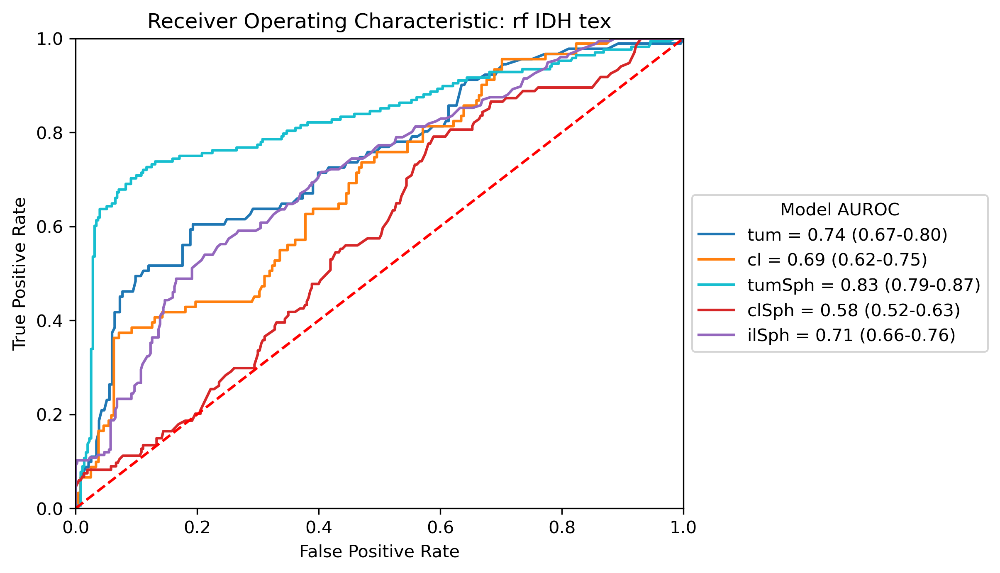

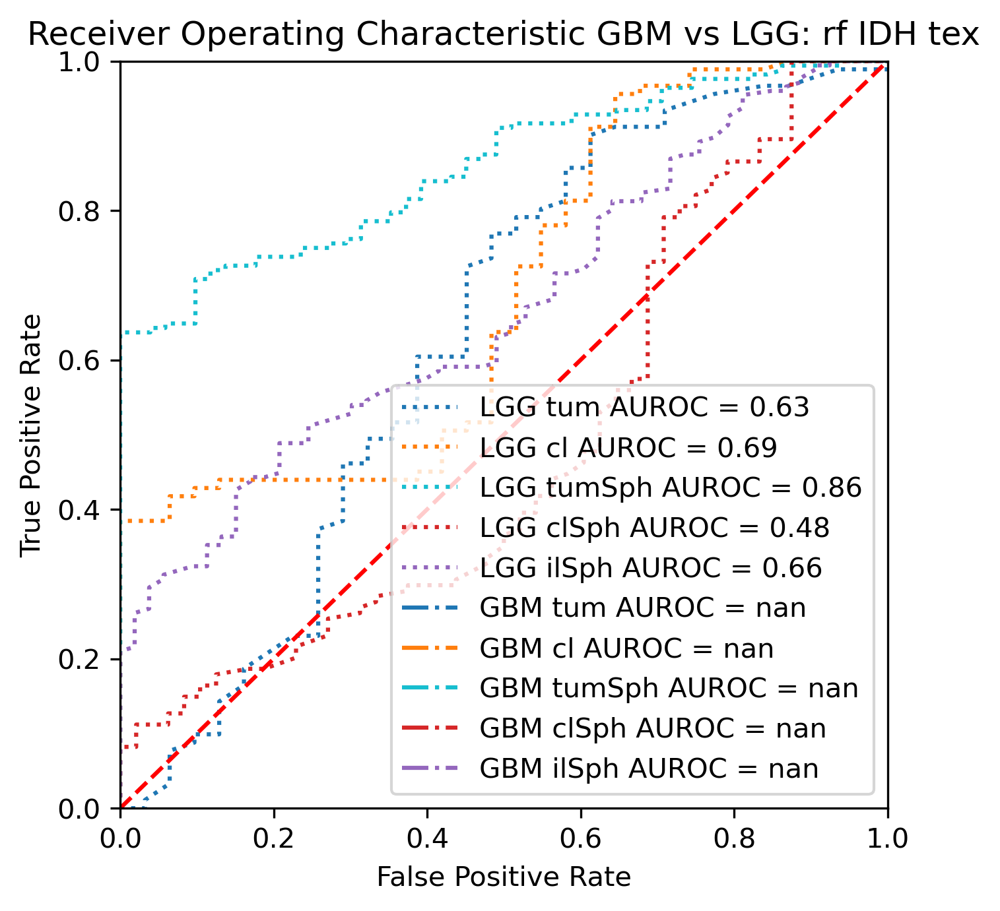

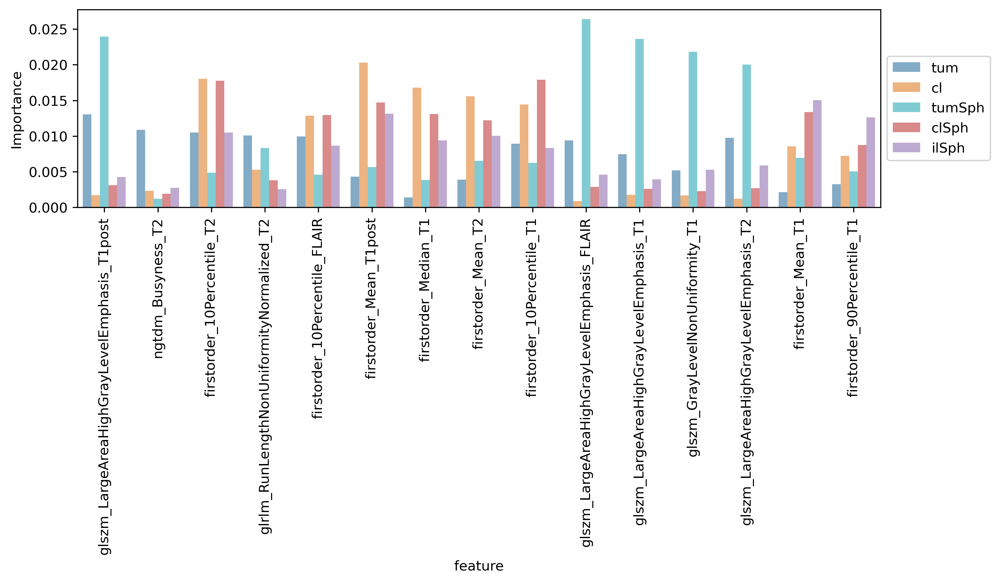

rf_1p19q_tum_tex: 2022-10-12T16:36
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_cl_tex: 2022-10-12T16:36
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_tumSph_tex: 2022-10-12T16:36
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_clSph_tex: 2022-10-12T16:37
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_ilSph_tex: 2022-10-12T16:37
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


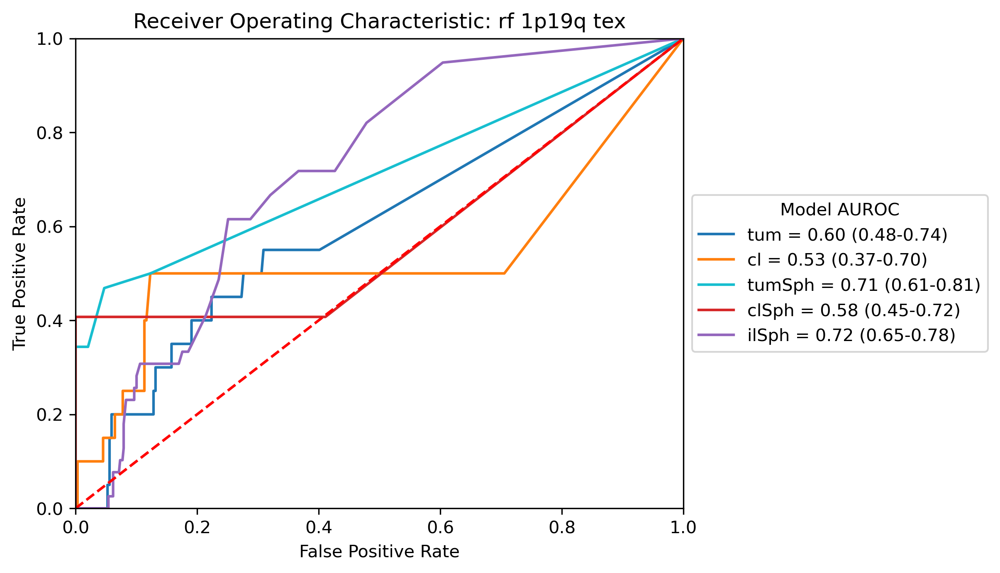

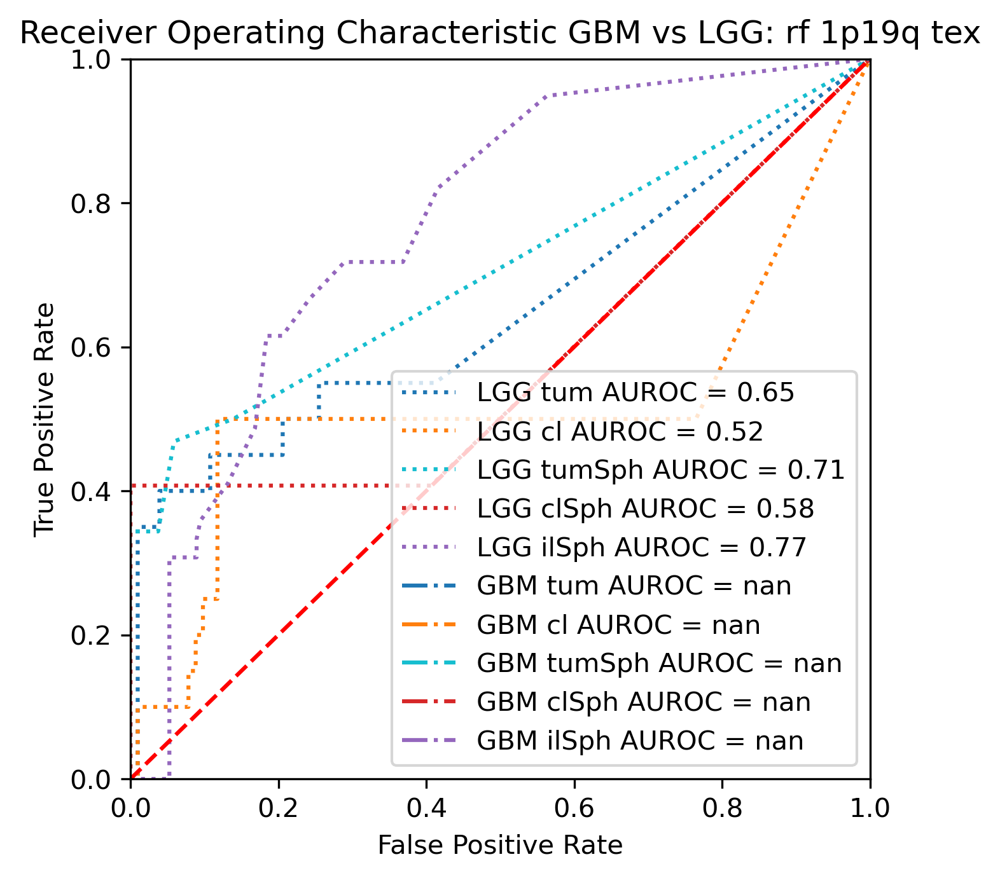

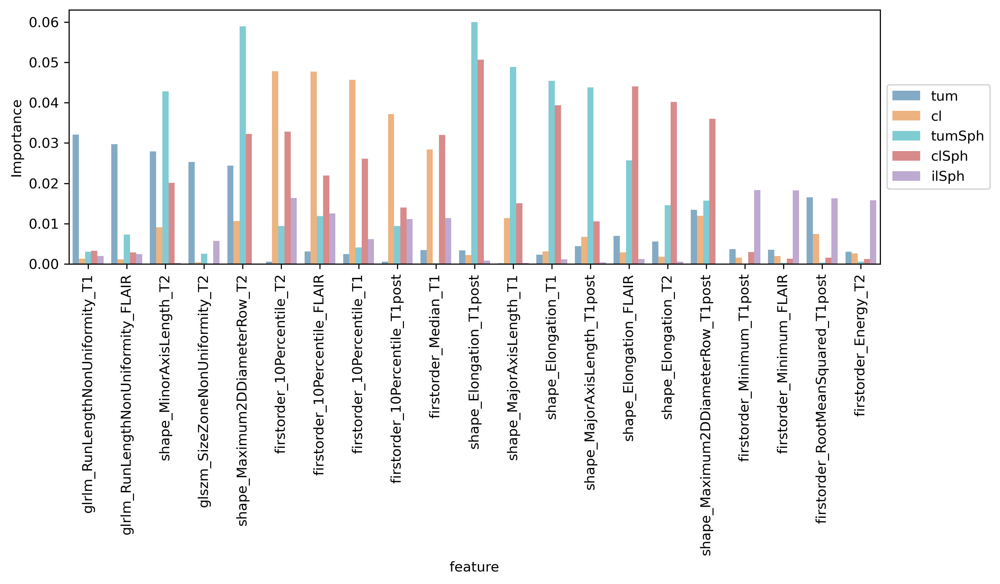

rf_MGMT_tum_tex: 2022-10-12T16:38
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_cl_tex: 2022-10-12T16:38
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_tumSph_tex: 2022-10-12T16:39
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_clSph_tex: 2022-10-12T16:39
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_ilSph_tex: 2022-10-12T16:40
Fitting 5 folds for each of 100 candidates, totalling 500 fits


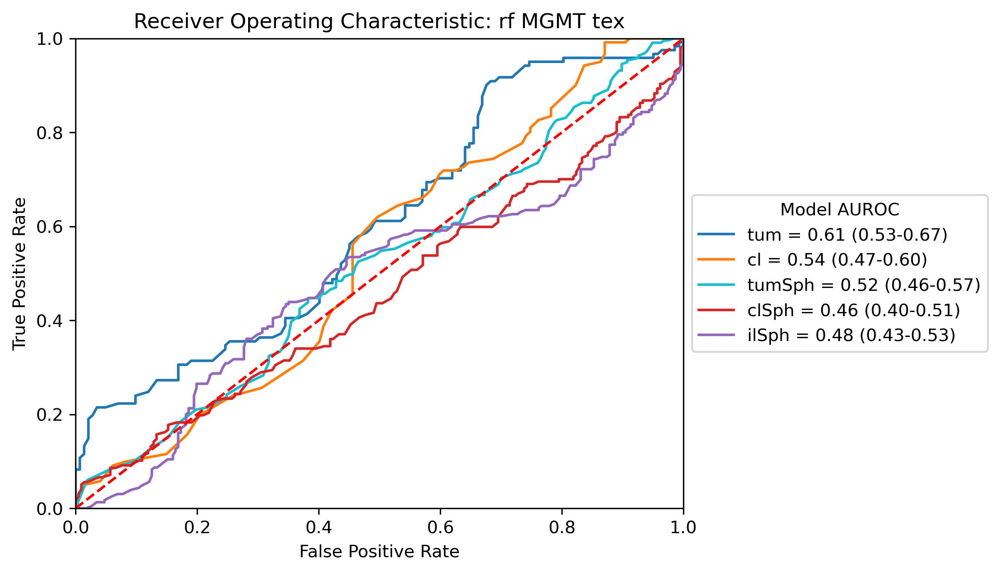

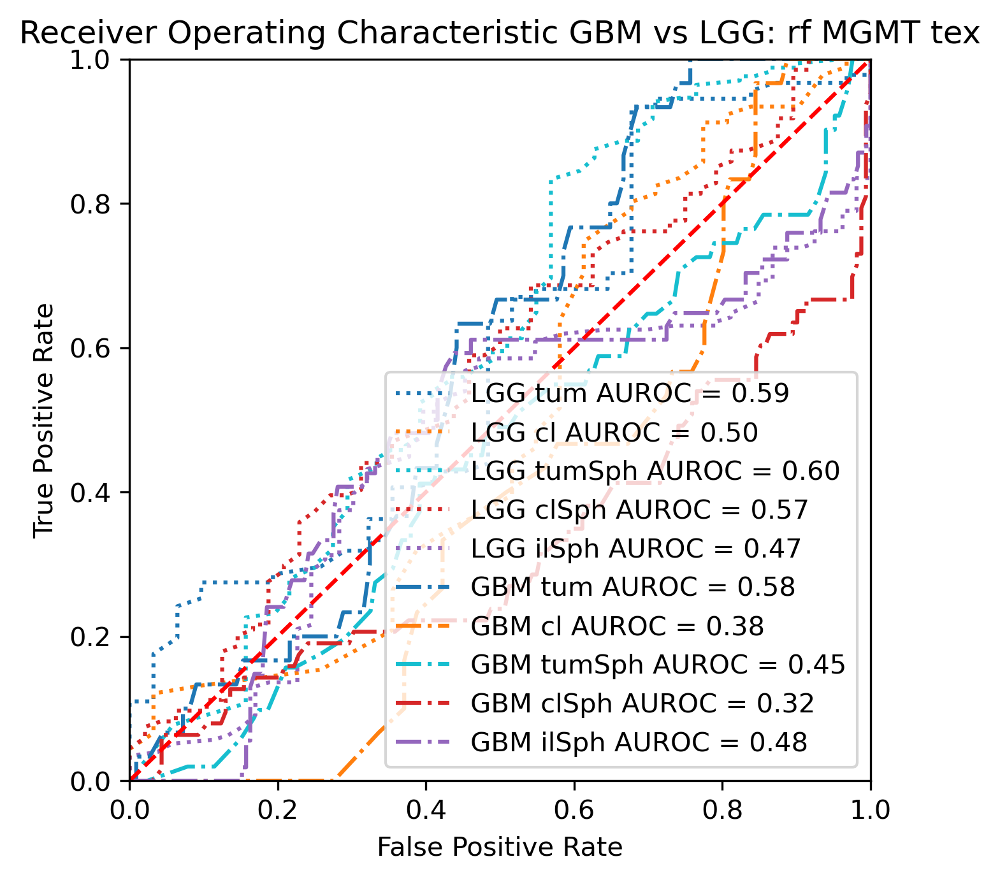

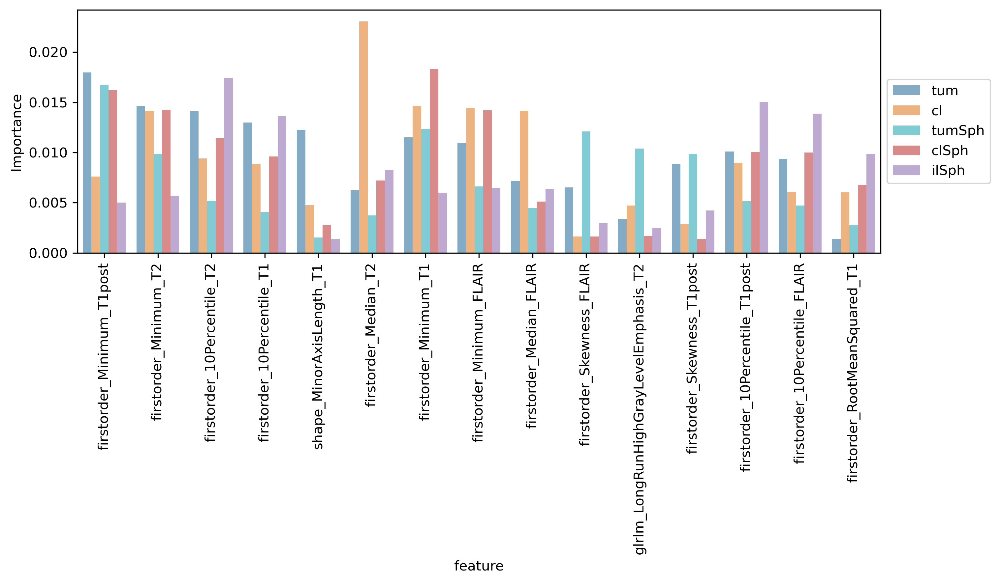

rf_TERT_tum_tex: 2022-10-12T16:40
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_cl_tex: 2022-10-12T16:40
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_tumSph_tex: 2022-10-12T16:41
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_clSph_tex: 2022-10-12T16:41
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_ilSph_tex: 2022-10-12T16:41
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


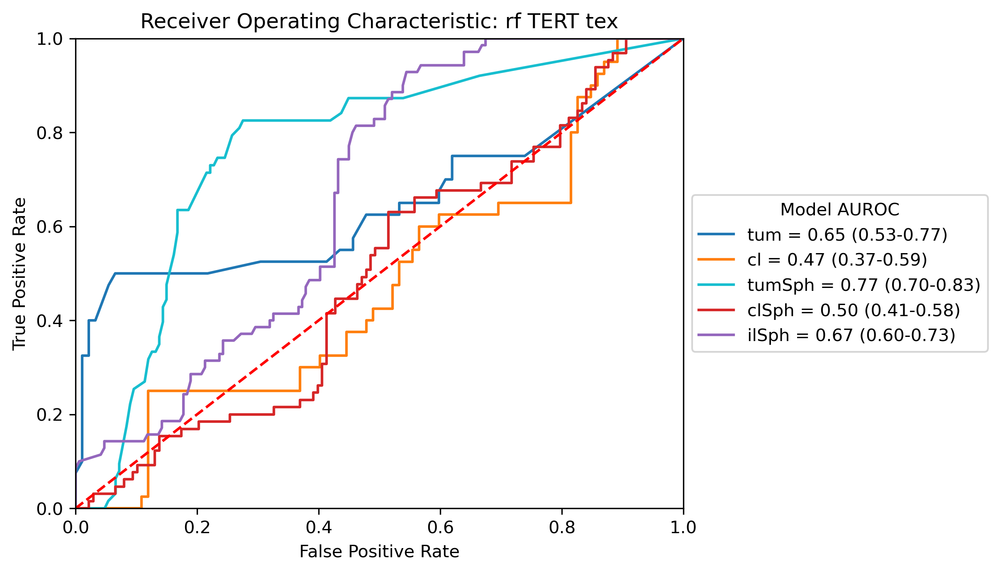

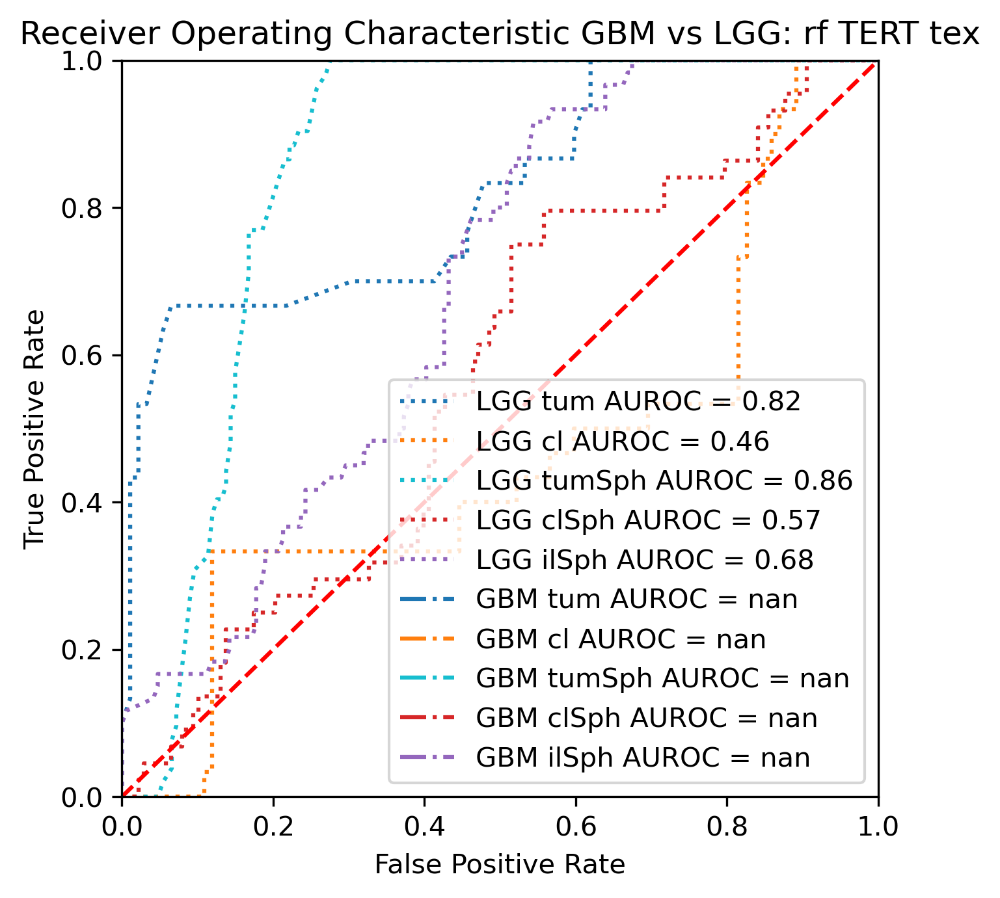

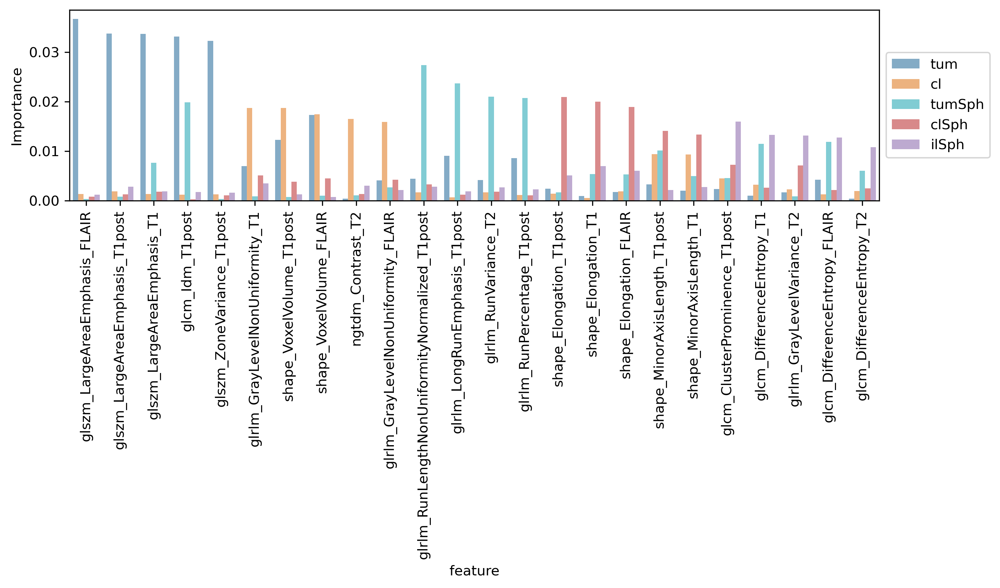

rf_ATRX_tum_tex: 2022-10-12T16:42
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_cl_tex: 2022-10-12T16:42
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_tumSph_tex: 2022-10-12T16:42
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_clSph_tex: 2022-10-12T16:43
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_ilSph_tex: 2022-10-12T16:43
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


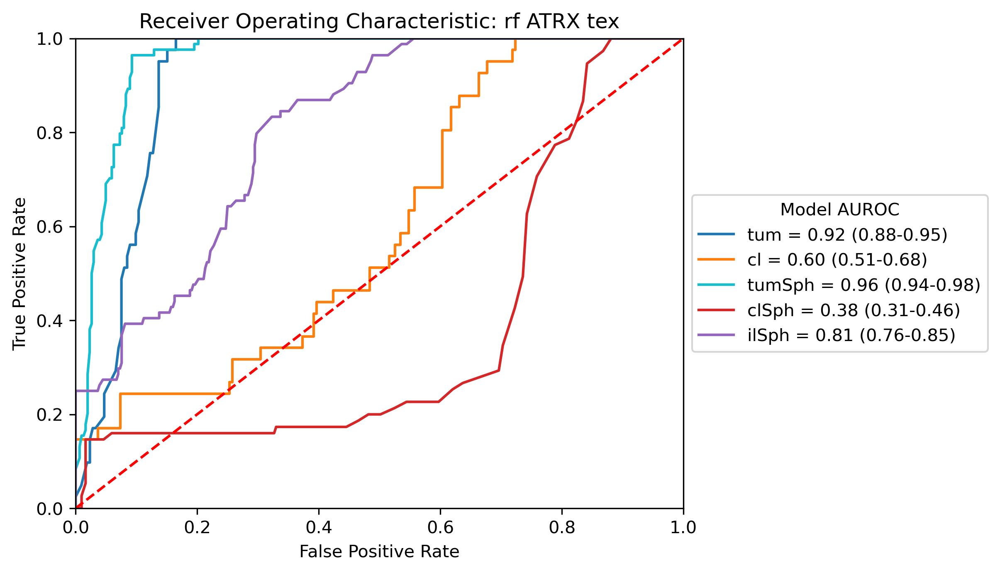

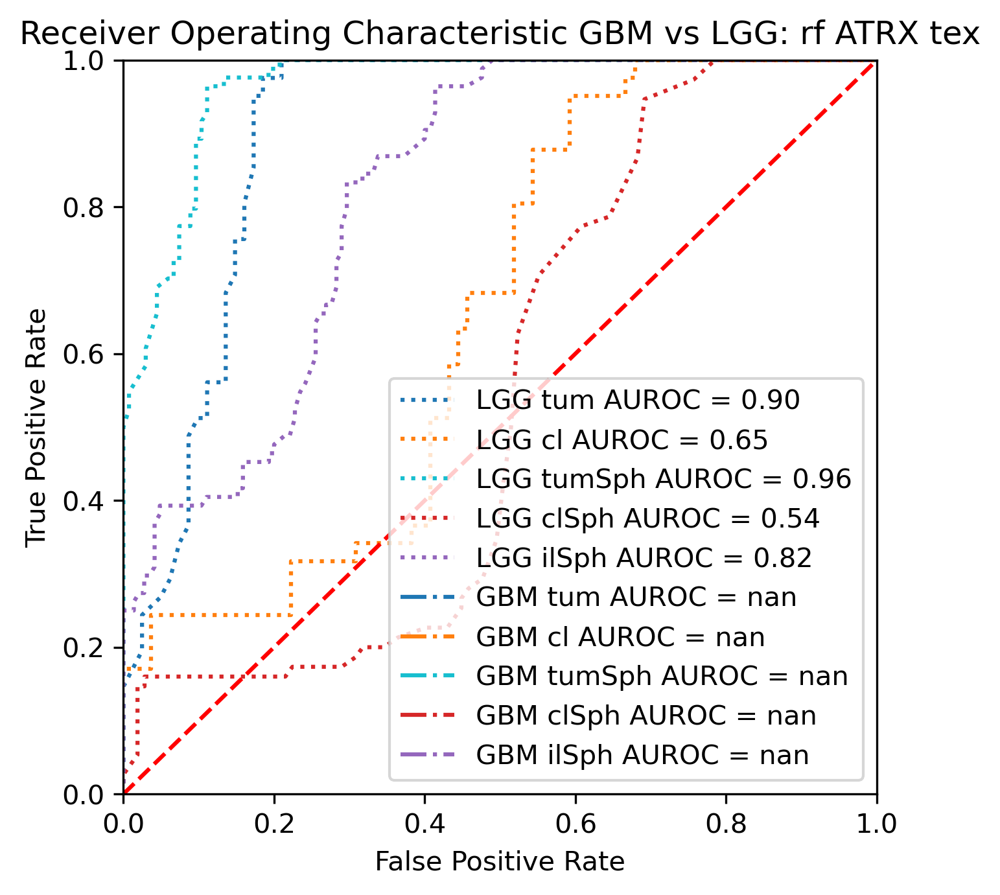

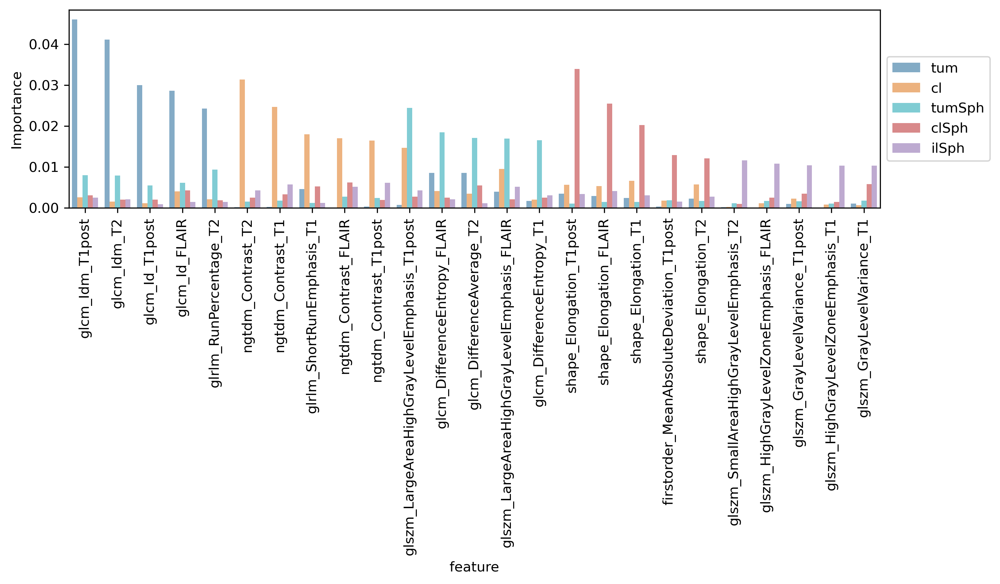

rf_is_GBM_tum_tex: 2022-10-12T16:44
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_cl_tex: 2022-10-12T16:44
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_tumSph_tex: 2022-10-12T16:45
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_clSph_tex: 2022-10-12T16:45
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_ilSph_tex: 2022-10-12T16:46
Fitting 5 folds for each of 100 candidates, totalling 500 fits


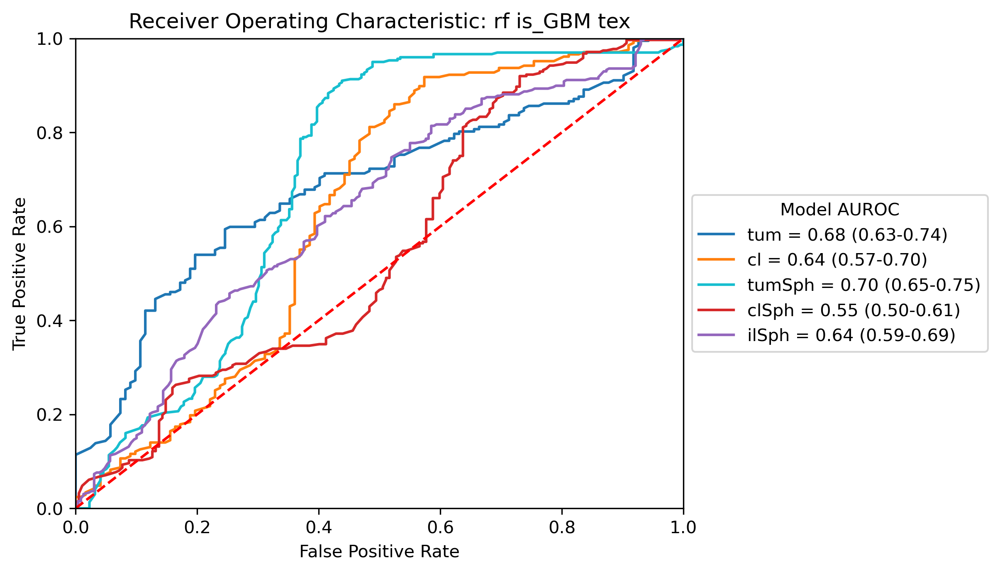

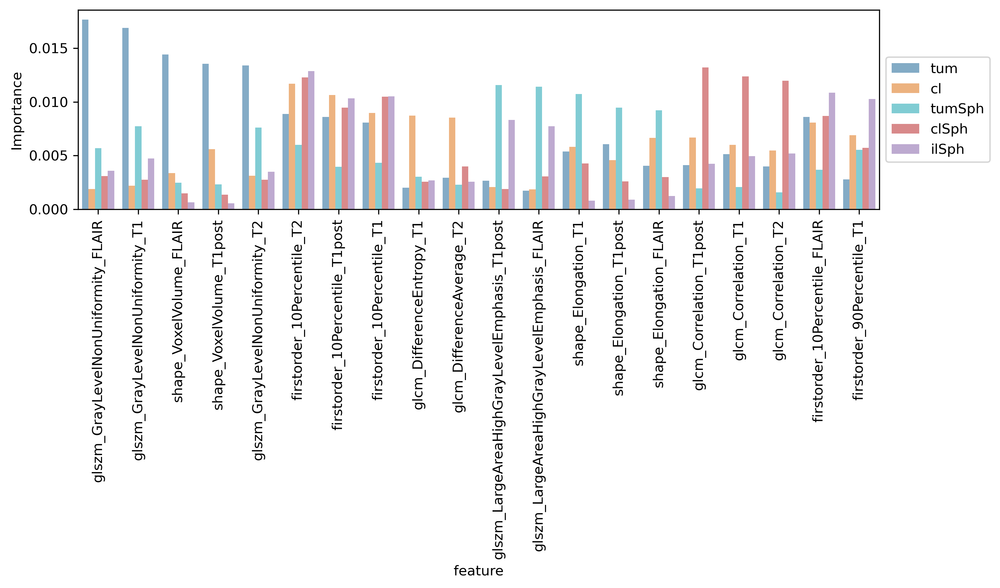

In [21]:

from sklearn.model_selection import GridSearchCV
outImDir = os.path.join(basedir,'data','images','graphs')
if not os.path.exists(outImDir):
    os.makedirs(outImDir)

# expTypes = ['cmb','tex','tda','cnn']
expTypes = ['tex']
fTypes = ['tum','cl','tumSph','clSph','ilSph']
nFts = 5
pMode = 'tum'
trRes = {}
tsRes = {}
storeImpDict = {}
storeImpResDict = {}
# yCol = 'IDH'
colDict = {'tum':'tab:blue','cl':'tab:orange','tumSph':'tab:cyan','clSph':'tab:red','ilSph':'tab:purple'}

for yCol in ['IDH','1p19q','MGMT','TERT','ATRX','is_GBM']:
# for yCol in ['IDH']:
#     for classifier in {'logreg','rf'}:
    for classifier in {'rf'}:
        for expT in expTypes:
            aucDict = {}
            tprDict = {}
            fprDict = {}
            impDict = {}
            impResDict = {}
            fprGGDict = {}
            tprGGDict = {}
            aucGGDict = {}
            for pMode in fTypes:
                expLbl = '%s_%s_%s_%s' % (classifier,yCol,pMode,expT)
                print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
                cData = fullData[fullData['sl_rank_%s' % pMode] <=10].copy()
                fCols = fullData.columns
                REPat = '_%s$' % pMode 
                cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
                if expT != 'cmb': # pick only feature columns of a specific type
                    cCols = [col for col in cCols if col in cNamesDict[expT]]
                filtData = cData[cCols]
                # filtData

                # rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


                rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
                trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

                # train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
                dataTrain = filtData.loc[trMask].copy()

                trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
                trainY = cData.loc[trMask][yCol] == 1
                # print(trainY.shape)

                # dataFiltered = dataTrain.filter(items=(features_selected))
                dataFiltered = dataTrain
                dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
                dataFiltered = dataFiltered.fillna(0)
                # print(dataFiltered.shape)
                if classifier == 'rf':
                    # define the grid to search
                    estimator_grid = random_grid()

                    # k-fold split
                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)
                    estimator = RandomizedSearchCV(estimator = rfc,
                                               param_distributions = estimator_grid, scoring = 'roc_auc',
                                               n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)
                elif classifier == 'logreg':
                    estimator_instance = LogisticRegression(random_state = random_seed*2, 
                                                            max_iter = 500,# increased max iter count
                                                            solver='liblinear') 
                    estimator_grid = Logreg_grid()

                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)

                    estimator = GridSearchCV(
                        estimator = estimator_instance, 
                        param_grid = estimator_grid,
                        scoring = 'roc_auc',
                        #cv = logo.split(train_val_features_df, train_val_1p19q, groups = train_val_id),
                        cv = kfSp,
                        verbose=2,
                        refit = True,
                        n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)

                bestEst = estimator.best_estimator_
                predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)
                yTrue = trainY.values.reshape([-1,1])
                organize_result(trRes, expLbl, yTrue, predProbs)

                ## Test Dataset
                #     tsMask = (np.isin(cData['patient'],testIDs))
                fprGGDict[pMode] = {}
                tprGGDict[pMode] = {}
                aucGGDict[pMode] = {}
                for gbmMode in [0,1,-1]:
                    
                    if gbmMode != -1:
                        if yCol == 'is_GBM':
                            continue
                        gbmMask = np.isin(cData['patient'],patient_GBM[patient_GBM[:,1]==gbmMode,0])
                #         print(pd.value_counts(gbmMask,dropna=False))

                        tsMask = np.logical_and(np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1])),
                                                gbmMask)
                    else:
                        tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
                    dataTest = filtData.loc[tsMask].copy()

                    testY = cData.loc[tsMask][yCol] == 1
                    # data_filtered = dataTest.filter(items=(features_selected))
                    dataFiltered = dataTest
                    predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

                    fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
                    roc_auc = metrics.auc(fpr, tpr)
                    yTrue = testY.values.reshape([-1,1])

                    if gbmMode != -1:
                        fprGGDict[pMode][gbmMode] = fpr
                        tprGGDict[pMode][gbmMode] = tpr
                        aucGGDict[pMode][gbmMode] = roc_auc
                        organize_result(tsRes, '%s_%s' % (gbmMode,expLbl), yTrue, predProbs)
                    else:
                        organize_result(tsRes, expLbl, yTrue, predProbs)

                # save for combined plot
                fprDict[pMode] = fpr
                tprDict[pMode] = tpr
                aucDict[pMode] = roc_auc

                if classifier == 'rf':
                    importances = pd.Series(bestEst.feature_importances_, index=cCols)
#                     start_time = time.time()

#                     result = permutation_importance(
#                         bestEst, dataFiltered, yTrue, n_repeats=10, random_state=random_seed, n_jobs=2
#                     )
#                     elapsed_time = time.time() - start_time
#                     print(f"Elapsed time to compute the importances: {elapsed_time:.3f} seconds")
#                     importances = pd.Series(result.importances_mean,index=cCols)
#                     importancesDF = pd.DataFrame({'Importance':result.importances_mean,
#                                                   'Importance std':result.importances_std,'ftName':cCols})
#                     impResDict[pMode] = importancesDF.copy()
                else:
                    importances = pd.Series(bestEst.coef_.flatten(), index=cCols)
                importances = importances.sort_values(ascending=False)
                impDict[pMode] = importances.copy()

                organize_result(tsRes, expLbl, yTrue, predProbs)

            # plotting AUROC
            f, ax = plt.subplots(figsize=(7, 5),dpi=300)
            plt.title('Receiver Operating Characteristic: %s %s %s' % (classifier,yCol,expT))
            for key in fprDict.keys():
            #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
                cLbl = '%s_%s_%s_%s' % (classifier,yCol,key,expT)
                plt.plot(fprDict[key], tprDict[key],colDict[key], label = '%s = %0.2f (%0.2f-%0.2f)' % 
                         (key,aucDict[key],tsRes[cLbl]['AUC Lower'],tsRes[cLbl]['AUC Upper']))
            
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])

            # Put a legend to the right of the current axis
            ax.legend(title='Model AUROC',loc='center left', bbox_to_anchor=(1, 0.5))
            plt.plot([0, 1], [0, 1],'r--')
            plt.xlim([0, 1])
            plt.ylim([0, 1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')
            plt.savefig(os.path.join(outImDir,'AUROC_%s_%s_%s.png' % (classifier,yCol,expT)))
            plt.show()

            
            if yCol != 'is_GBM':
                f, ax = plt.subplots(figsize=(5, 5),dpi=300)
                plt.title('Receiver Operating Characteristic GBM vs LGG: %s %s %s' % (classifier,yCol,expT))
                for gbmMode in [0,1]:
                    for key in fprDict.keys():
                #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)

                        if gbmMode == 1:
                            gbmStr = 'GBM'
                            lStyle = '-.'
                        else:
                            gbmStr = 'LGG'
                            lStyle = ':'
                        plt.plot(fprGGDict[key][gbmMode], tprGGDict[key][gbmMode],colDict[key],
                                label = '%s %s AUROC = %0.2f' % (gbmStr,key,aucGGDict[key][gbmMode]),
                                linestyle =lStyle)
                plt.legend(loc = 'lower right')
                plt.plot([0, 1], [0, 1],'r--')
                plt.xlim([0, 1])
                plt.ylim([0, 1])
                plt.ylabel('True Positive Rate')
                plt.xlabel('False Positive Rate')
                plt.savefig(os.path.join(outImDir,'AUROC_LGGvGBM_%s_%s_%s.png' % (classifier,yCol,expT)))
                plt.show()



            # feature importance graphs
            topFeats = []
            storeImpDict['%s_%s_%s' % (classifier,yCol,expT)] = impDict
#             storeImpResDict['%s_%s_%s' % (classifier,yCol,expT)] = impResDict
            for key in fTypes:
                topFtList = impDict[key][:nFts].keys()
                regExPat = '_%s$' % key
                topFtList = [re.sub(regExPat,'',ft) for ft in topFtList]
                topFeats.extend([ft for ft in topFtList if ft not in topFeats])

            fig = plt.figure(figsize=[10,6],dpi=300)
            impDFList = []
            for key in fTypes:
                cKeys = ['%s_%s'% (ft,key) for ft in topFeats]
                cFDict = {ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}
                impDF = pd.DataFrame({'feature':cFDict.keys(),'Importance':cFDict.values()},index=cKeys)
                impDF['Feature Class'] = key
                impDFList.append(impDF)
            impDF = pd.concat(impDFList,axis=0)

            g = sns.barplot(
                data=impDF,
                x="feature", y="Importance", hue="Feature Class",palette=colDict.values(), alpha=.6
            )
            locs, labels = plt.xticks()
            plt.setp(labels, rotation=90)
            fig.tight_layout()
            ax = plt.gca()
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])

            # Put a legend to the right of the current axis
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
            plt.savefig(os.path.join(outImDir,'Importance_%s_%s_%s.png' % (classifier,yCol,expT)))
            plt.show()

In [64]:
yCol = 'IDH'
expLbl = '%s_%s_%s_%s' % (classifier,yCol,pMode,expT)
print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
cData = fullData[fullData['sl_rank_%s' % pMode] <=10].copy()
fCols = fullData.columns
REPat = '_%s$' % pMode 
cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
if expT != 'cmb': # pick only feature columns of a specific type
    cCols = [col for col in cCols if col in cNamesDict[expT]]
filtData = cData[cCols]
# filtData

# rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

# train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
dataTrain = filtData.loc[trMask].copy()

trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
trainY = cData.loc[trMask][yCol] == 1
# print(trainY.shape)

# dataFiltered = dataTrain.filter(items=(features_selected))
dataFiltered = dataTrain
dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
dataFiltered = dataFiltered.fillna(0)
# print(dataFiltered.shape)
if classifier == 'rf':
    # define the grid to search
    estimator_grid = random_grid()

    # k-fold split
    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
    kfSp = kf.split(dataFiltered,trainY, groups = trainID)
    estimator = RandomizedSearchCV(estimator = rfc,
                               param_distributions = estimator_grid, scoring = 'roc_auc',
                               n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

    estimator.fit(dataFiltered,trainY)
elif classifier == 'logreg':
    estimator_instance = LogisticRegression(random_state = random_seed*2, 
                                            max_iter = 500,# increased max iter count
                                            solver='liblinear') 
    estimator_grid = Logreg_grid()

    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
    kfSp = kf.split(dataFiltered,trainY, groups = trainID)

    estimator = GridSearchCV(
        estimator = estimator_instance, 
        param_grid = estimator_grid,
        scoring = 'roc_auc',
        #cv = logo.split(train_val_features_df, train_val_1p19q, groups = train_val_id),
        cv = kfSp,
        verbose=2,
        refit = True,
        n_jobs = -1)

    estimator.fit(dataFiltered,trainY)

bestEst = estimator.best_estimator_
predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)
yTrue = trainY.values.reshape([-1,1])
organize_result(trRes, expLbl, yTrue, predProbs)

## Test Dataset
#     tsMask = (np.isin(cData['patient'],testIDs))
fprGGDict[pMode] = {}
tprGGDict[pMode] = {}
aucGGDict[pMode] = {}
tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
dataTest = filtData.loc[tsMask].copy()

testY = cData.loc[tsMask][yCol] == 1
# data_filtered = dataTest.filter(items=(features_selected))
dataFiltered = dataTest
predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
roc_auc = metrics.auc(fpr, tpr)
yTrue = testY.values.reshape([-1,1])

rf_IDH_ilSph_tex: 2022-10-25T12:55
Fitting 5 folds for each of 100 candidates, totalling 500 fits


In [63]:
tsTCGAIDs = cData.loc[tsMask]['patient']
df = pd.DataFrame(data = {'prob':predProbs.flatten(),'label':cData.loc[tsMask][yCol],'ID':tsTCGAIDs})

# def auc_group(df):
#     prob = df.prob
#     y = df.label.astype(bool)
#     return roc_auc_score(y,prob)

def prob_var(df):
    prob = df.prob
    
    return np.var(prob)
print(np.var(df.prob))
# print(np.mean(df.groupby(["ID"]).apply(prob_var)))
df.groupby(["ID"]).apply(prob_var)


0.023108738829827117


ID
TCGA-02-0006    0.000000
TCGA-02-0009    0.000000
TCGA-02-0047    0.000000
TCGA-02-0085    0.000000
TCGA-06-0130    0.000000
TCGA-06-0138    0.000010
TCGA-06-0142    0.000000
TCGA-06-0158    0.000000
TCGA-06-0644    0.000000
TCGA-06-0646    0.000000
TCGA-06-5413    0.000000
TCGA-08-0359    0.000000
TCGA-12-0616    0.000000
TCGA-12-1598    0.000000
TCGA-14-3477    0.000000
TCGA-19-2624    0.000000
TCGA-76-6191    0.000000
TCGA-76-6193    0.000000
TCGA-76-6280    0.000000
TCGA-76-6662    0.000000
TCGA-CS-6186    0.000000
TCGA-CS-6669    0.000000
TCGA-DU-7019    0.000000
TCGA-DU-7300    0.000000
TCGA-DU-8162    0.000000
TCGA-DU-8167    0.001065
TCGA-DU-8168    0.000000
TCGA-FG-A4MT    0.000000
TCGA-HT-7602    0.000000
TCGA-HT-7686    0.000000
TCGA-HT-7690    0.000000
TCGA-HT-8114    0.000000
dtype: float64

# Single slice per pt

rf_IDH_tum_tex: 2022-10-25T12:24
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_cl_tex: 2022-10-25T12:24
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_tumSph_tex: 2022-10-25T12:24
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_clSph_tex: 2022-10-25T12:24
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_ilSph_tex: 2022-10-25T12:24
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


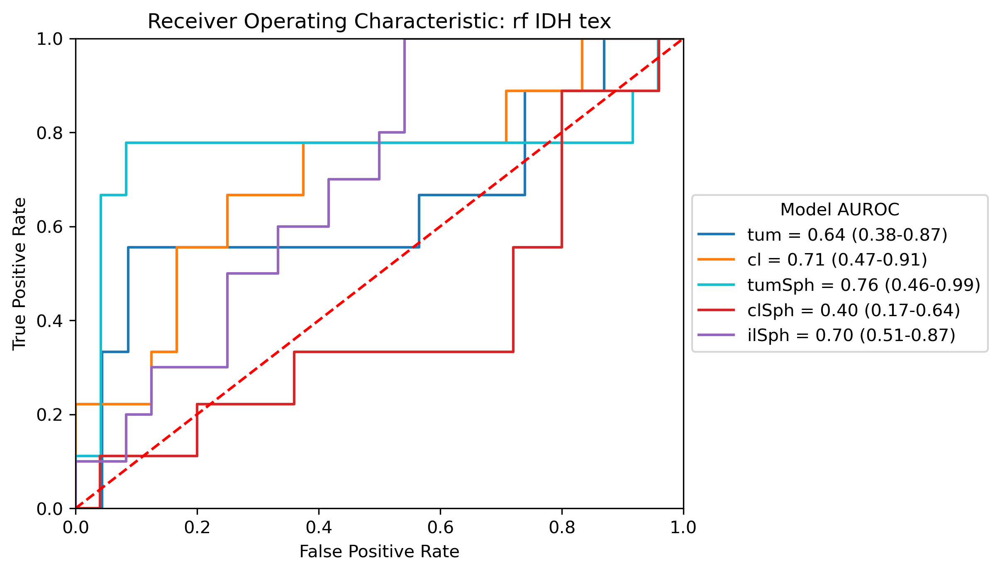

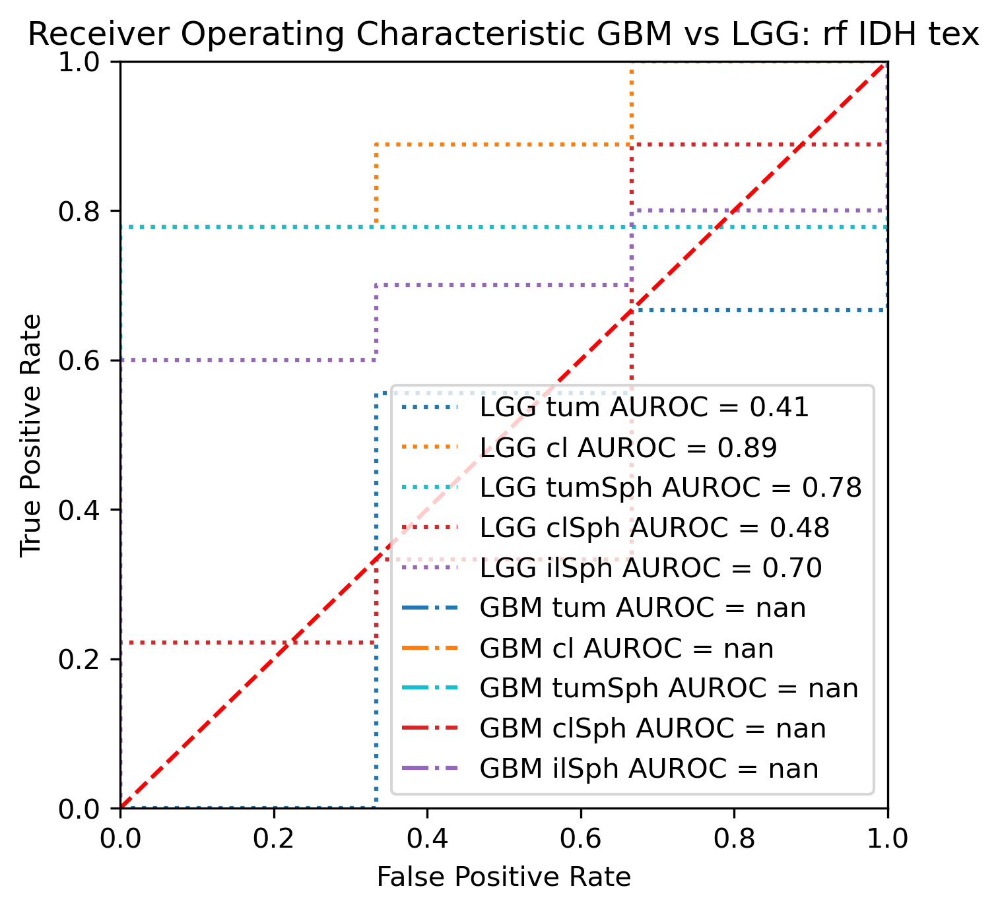

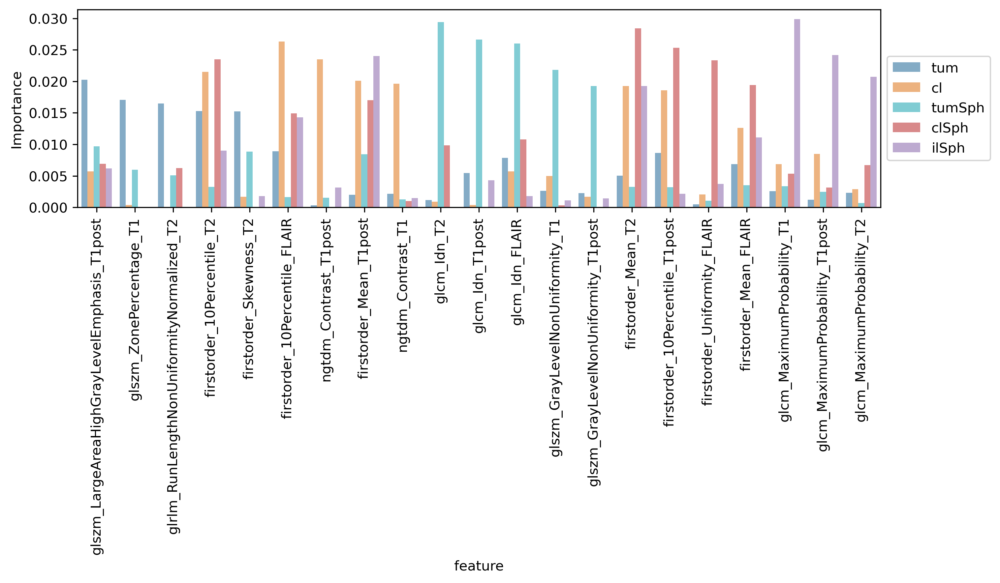

rf_1p19q_tum_tex: 2022-10-25T12:25
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_cl_tex: 2022-10-25T12:25
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_tumSph_tex: 2022-10-25T12:25
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_clSph_tex: 2022-10-25T12:25
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_1p19q_ilSph_tex: 2022-10-25T12:25
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


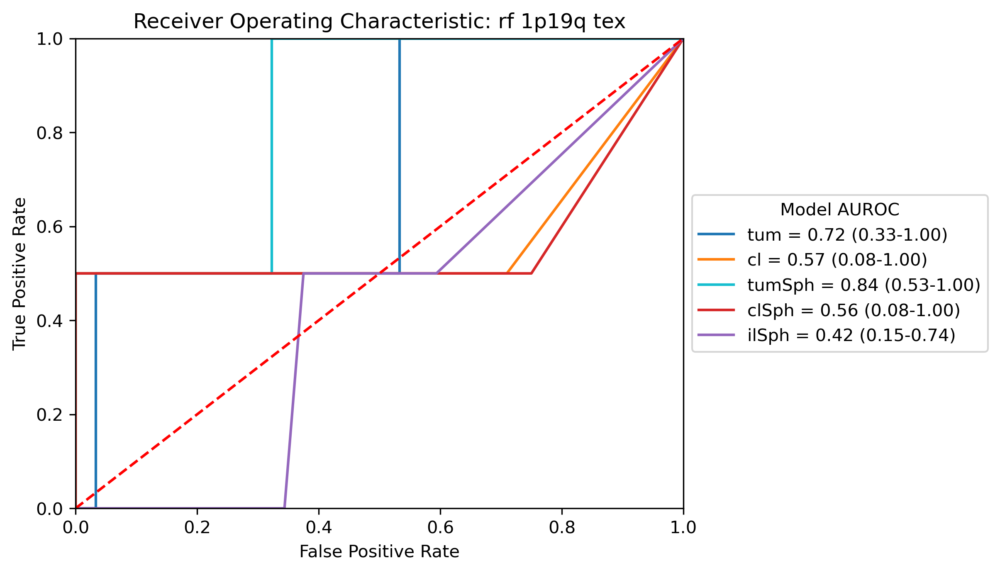

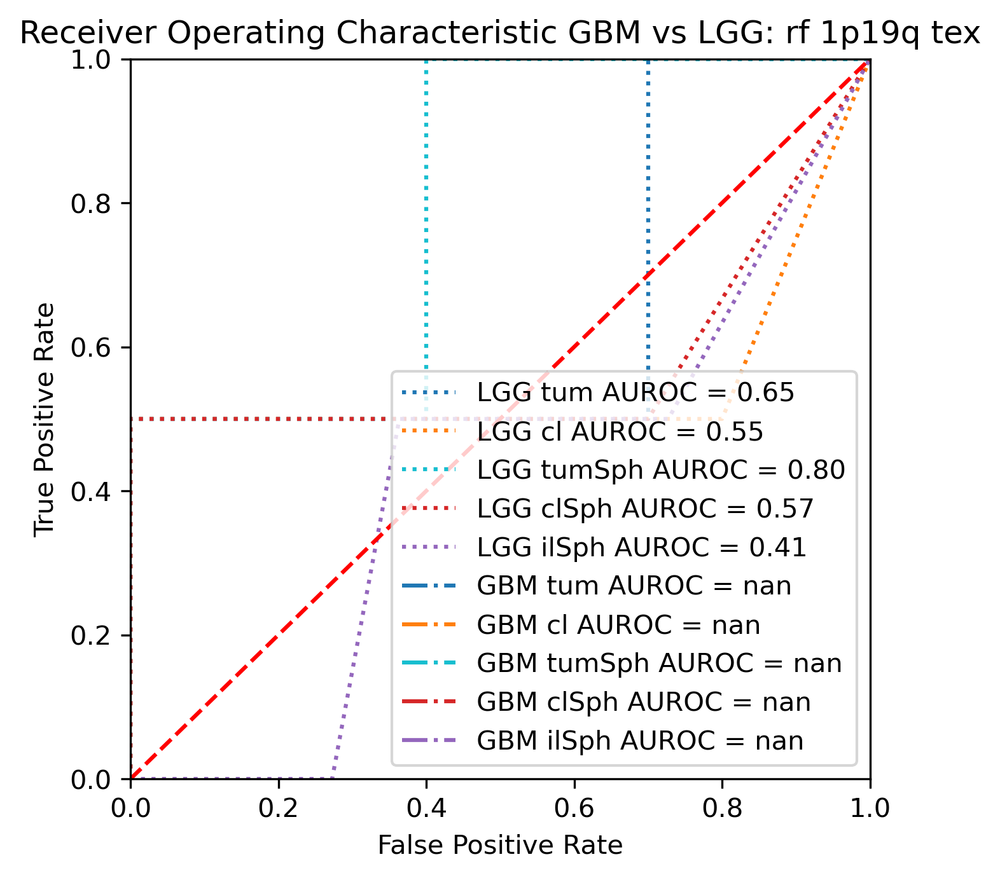

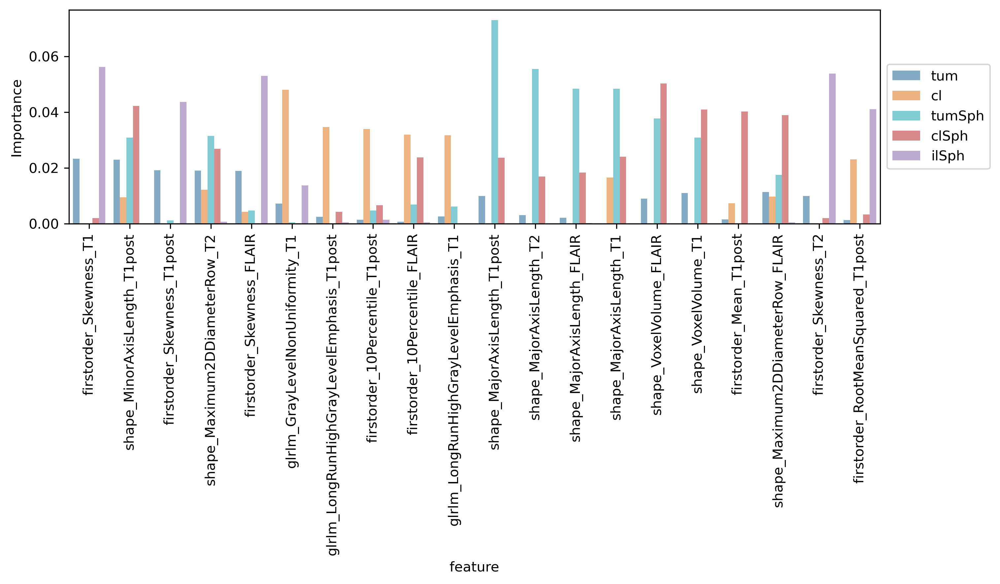

rf_MGMT_tum_tex: 2022-10-25T12:26
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_cl_tex: 2022-10-25T12:26
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_tumSph_tex: 2022-10-25T12:26
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_clSph_tex: 2022-10-25T12:26
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_MGMT_ilSph_tex: 2022-10-25T12:26
Fitting 5 folds for each of 100 candidates, totalling 500 fits


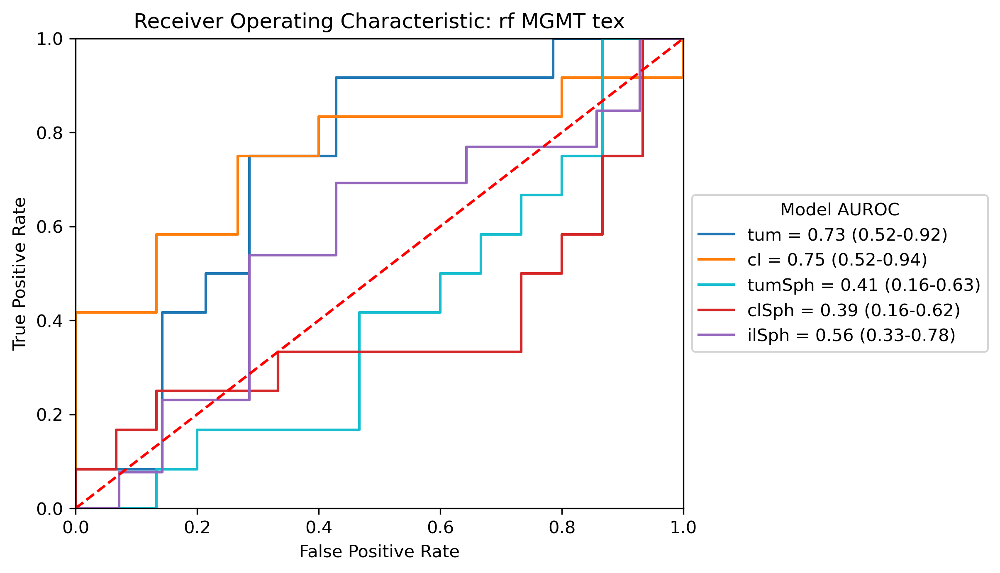

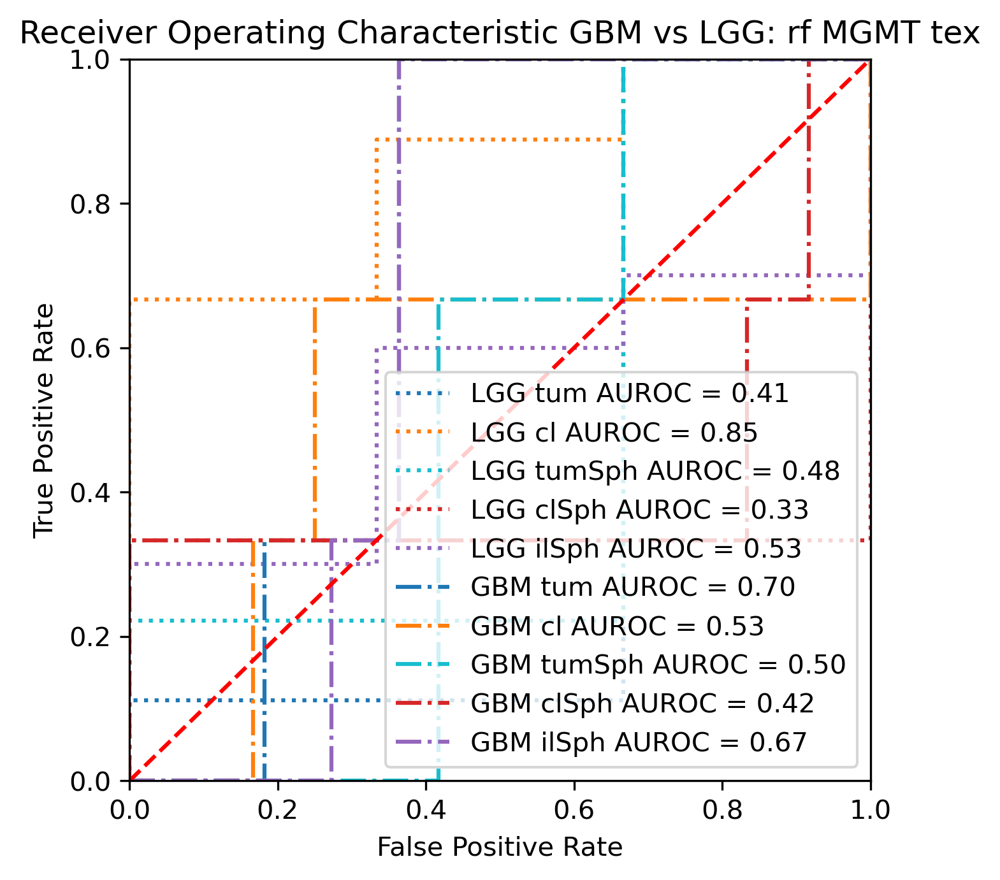

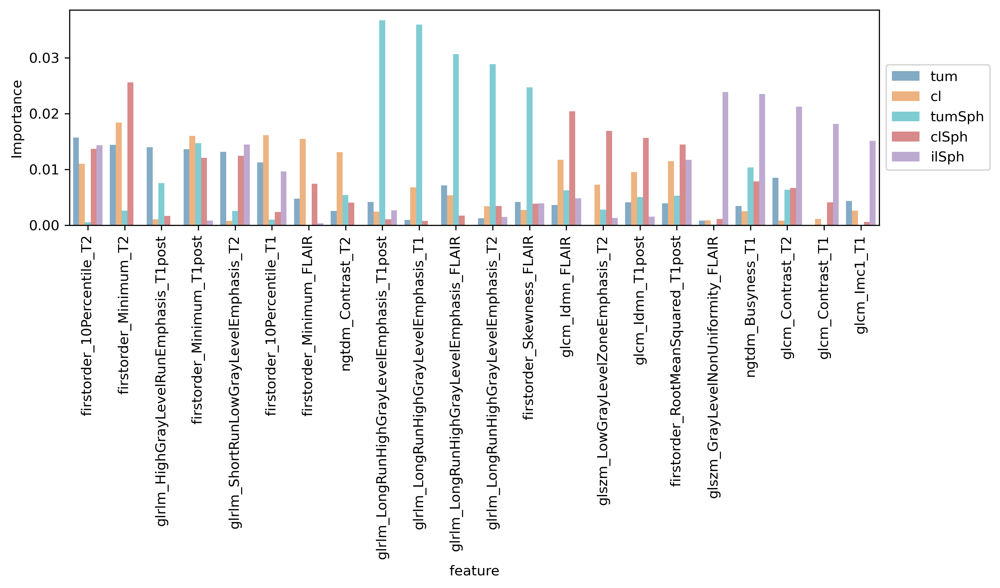

rf_TERT_tum_tex: 2022-10-25T12:27
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_cl_tex: 2022-10-25T12:27
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_tumSph_tex: 2022-10-25T12:27
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_clSph_tex: 2022-10-25T12:27
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


rf_TERT_ilSph_tex: 2022-10-25T12:27
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:943: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  UndefinedMetricWarning)


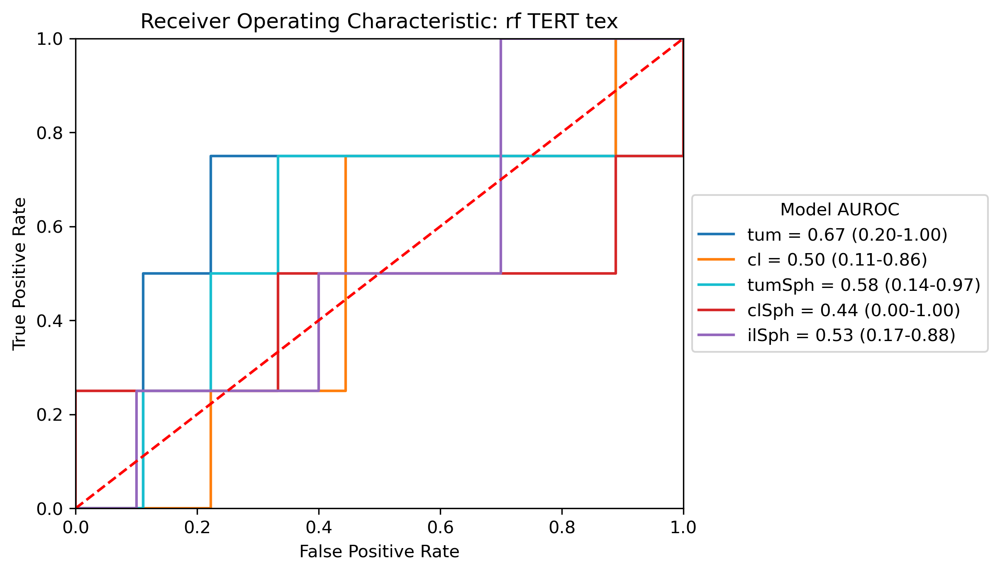

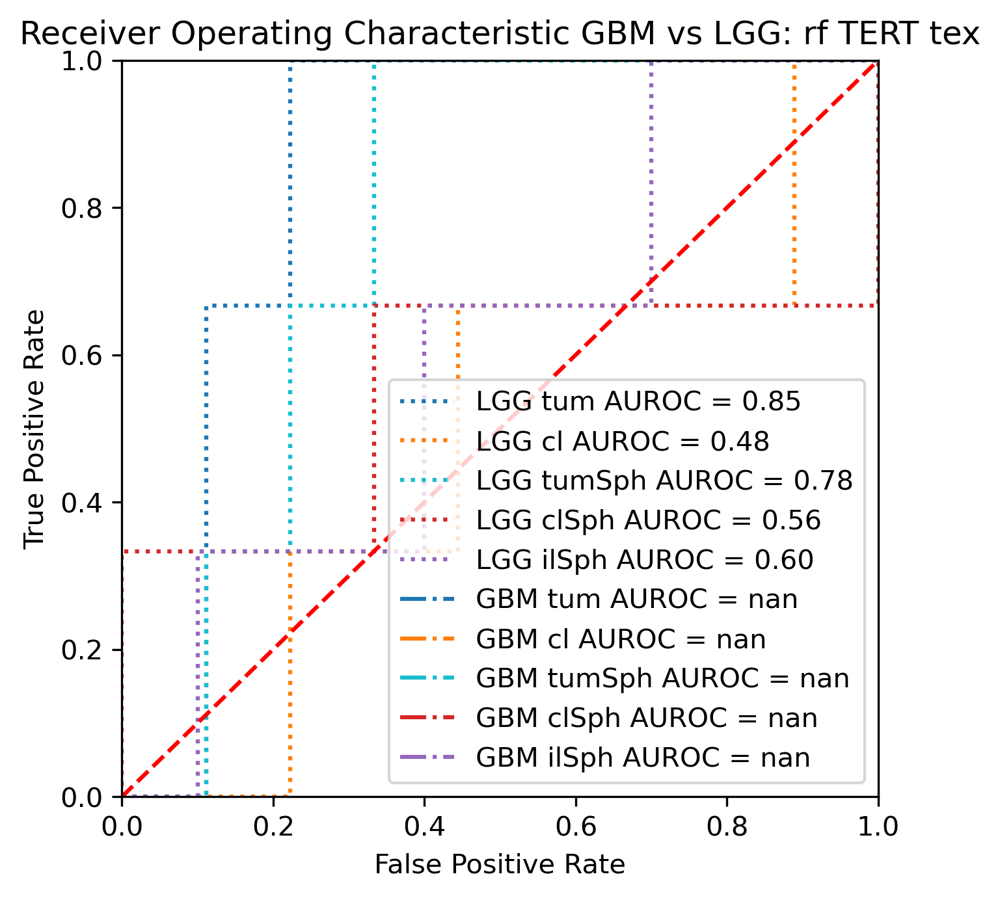

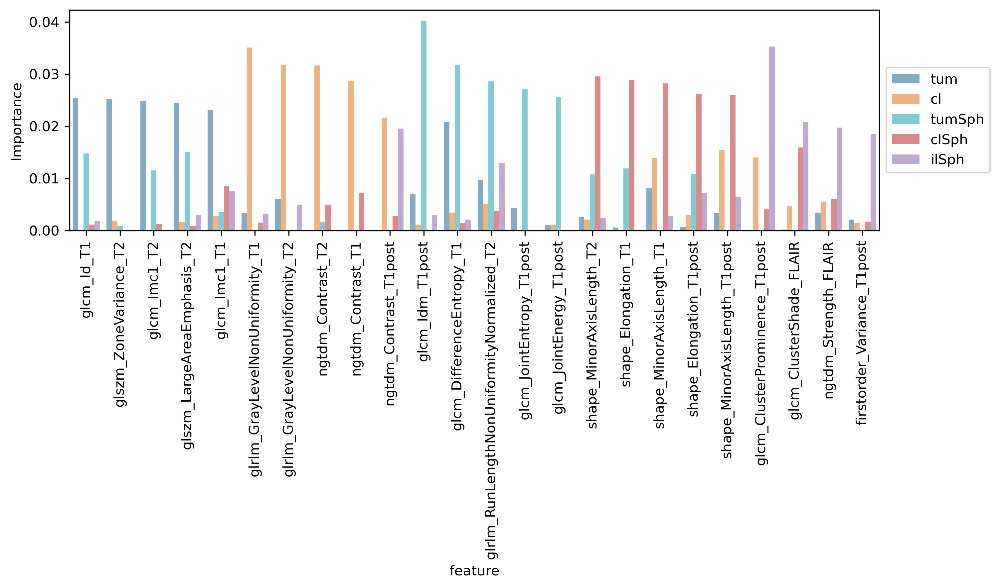

rf_ATRX_tum_tex: 2022-10-25T12:28
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_cl_tex: 2022-10-25T12:28
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_tumSph_tex: 2022-10-25T12:28
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_clSph_tex: 2022-10-25T12:28
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_ATRX_ilSph_tex: 2022-10-25T12:28
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


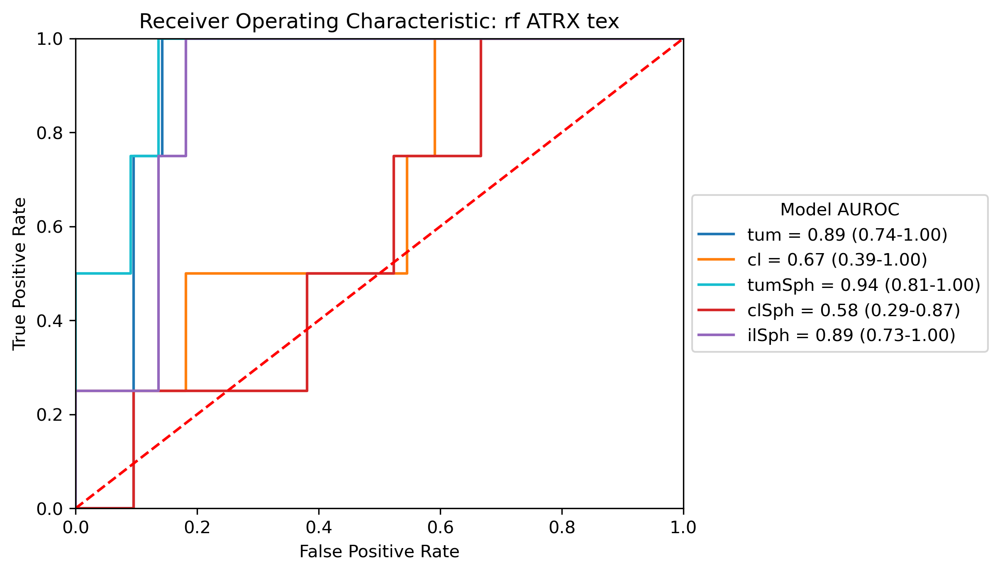

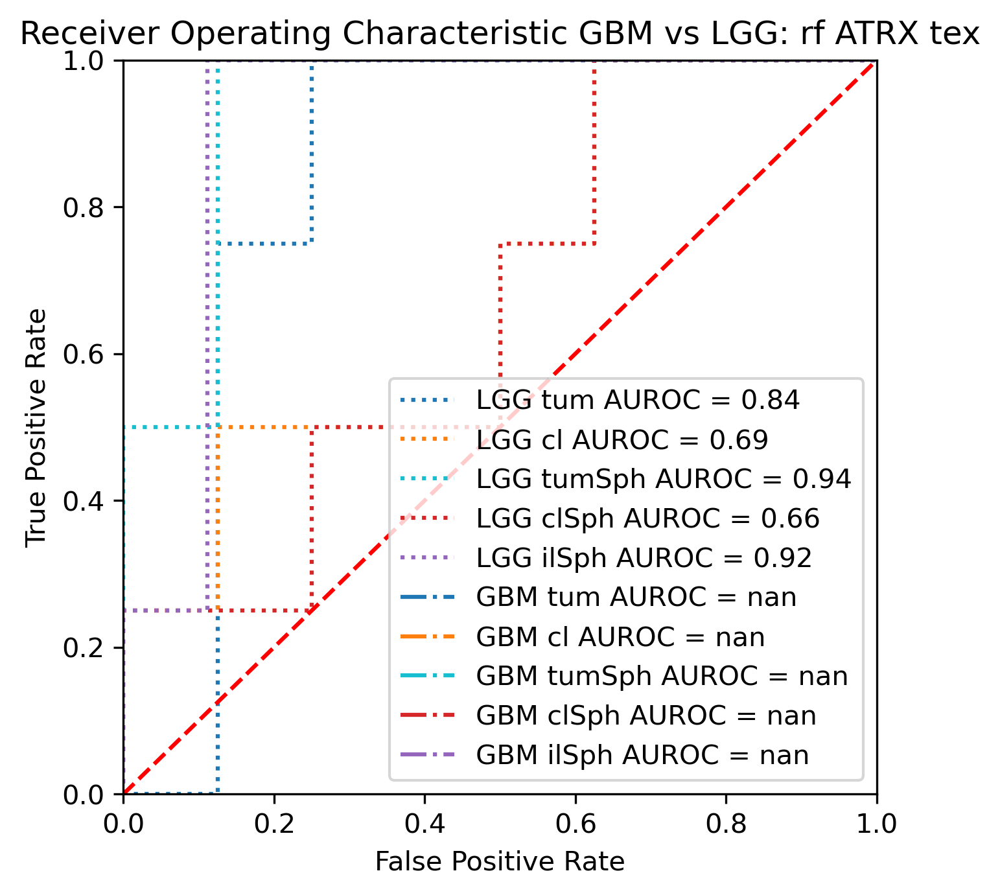

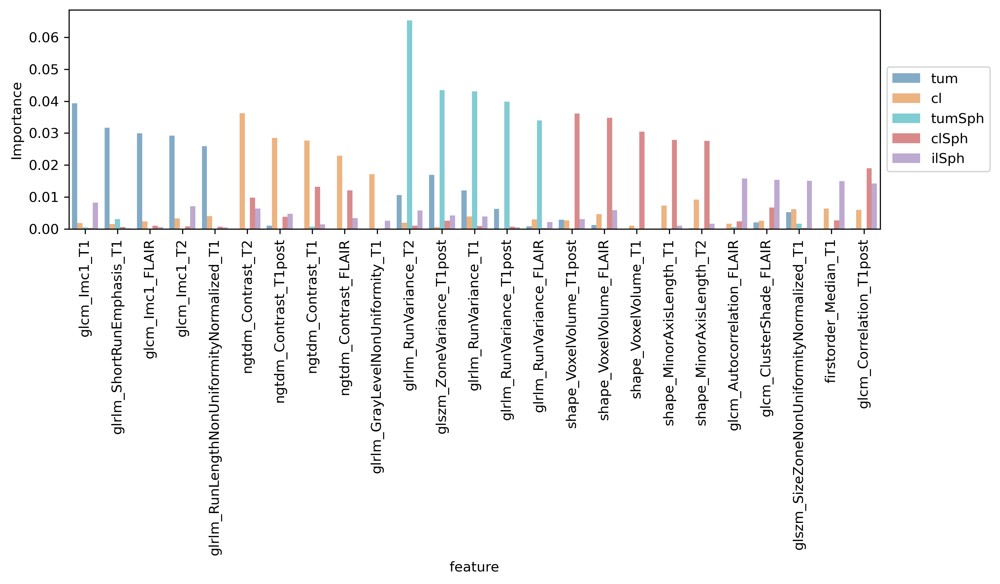

rf_is_GBM_tum_tex: 2022-10-25T12:29
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_cl_tex: 2022-10-25T12:29
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_tumSph_tex: 2022-10-25T12:29
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_clSph_tex: 2022-10-25T12:29
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_is_GBM_ilSph_tex: 2022-10-25T12:29
Fitting 5 folds for each of 100 candidates, totalling 500 fits


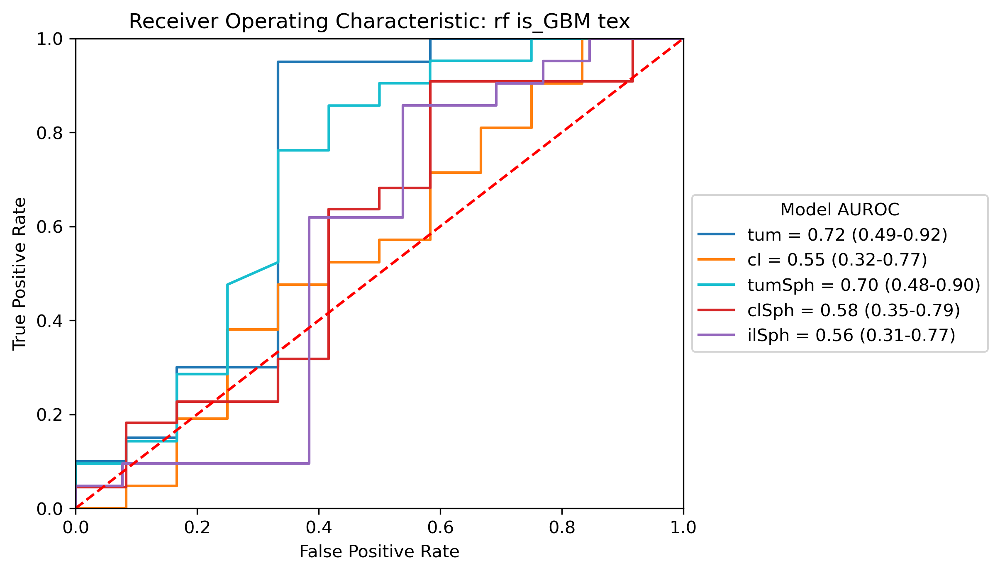

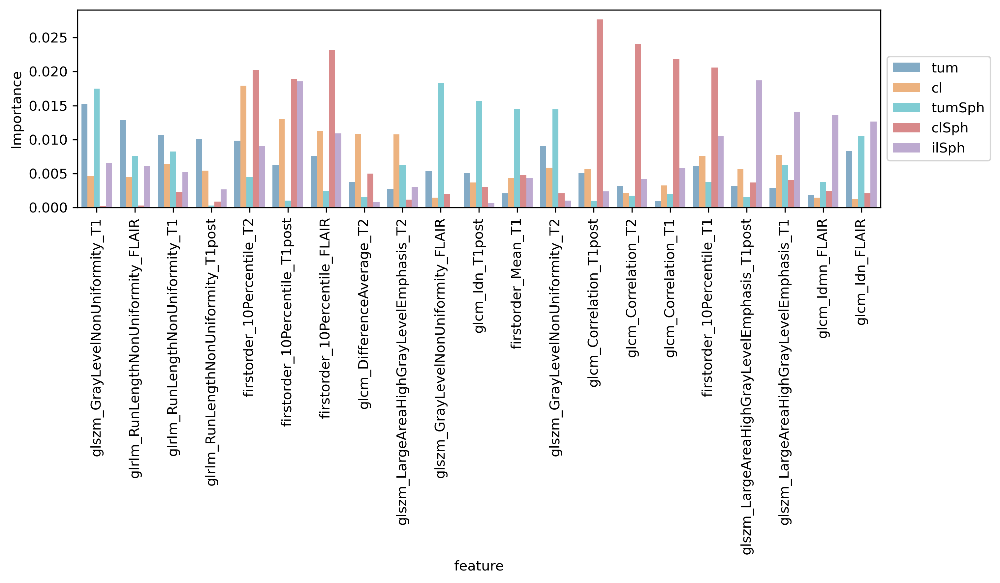

In [61]:

from sklearn.model_selection import GridSearchCV
outImDir = os.path.join(basedir,'data','images','graphs')
if not os.path.exists(outImDir):
    os.makedirs(outImDir)

# expTypes = ['cmb','tex','tda','cnn']
expTypes = ['tex']
fTypes = ['tum','cl','tumSph','clSph','ilSph']
nFts = 5
pMode = 'tum'
trRes = {}
tsRes = {}
storeImpDict = {}
storeImpResDict = {}
# yCol = 'IDH'
colDict = {'tum':'tab:blue','cl':'tab:orange','tumSph':'tab:cyan','clSph':'tab:red','ilSph':'tab:purple'}

for yCol in ['IDH','1p19q','MGMT','TERT','ATRX','is_GBM']:
# for yCol in ['IDH']:
#     for classifier in {'logreg','rf'}:
    for classifier in {'rf'}:
        for expT in expTypes:
            aucDict = {}
            tprDict = {}
            fprDict = {}
            impDict = {}
            impResDict = {}
            fprGGDict = {}
            tprGGDict = {}
            aucGGDict = {}
            for pMode in fTypes:
                expLbl = '%s_%s_%s_%s' % (classifier,yCol,pMode,expT)
                print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
                cData = fullData[fullData['sl_rank_%s' % pMode] <=1].copy()
                fCols = fullData.columns
                REPat = '_%s$' % pMode 
                cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
                if expT != 'cmb': # pick only feature columns of a specific type
                    cCols = [col for col in cCols if col in cNamesDict[expT]]
                filtData = cData[cCols]
                # filtData

                # rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


                rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
                trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

                # train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
                dataTrain = filtData.loc[trMask].copy()

                trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
                trainY = cData.loc[trMask][yCol] == 1
                # print(trainY.shape)

                # dataFiltered = dataTrain.filter(items=(features_selected))
                dataFiltered = dataTrain
                dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
                dataFiltered = dataFiltered.fillna(0)
                # print(dataFiltered.shape)
                if classifier == 'rf':
                    # define the grid to search
                    estimator_grid = random_grid()

                    # k-fold split
                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)
                    estimator = RandomizedSearchCV(estimator = rfc,
                                               param_distributions = estimator_grid, scoring = 'roc_auc',
                                               n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)
                elif classifier == 'logreg':
                    estimator_instance = LogisticRegression(random_state = random_seed*2, 
                                                            max_iter = 500,# increased max iter count
                                                            solver='liblinear') 
                    estimator_grid = Logreg_grid()

                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)

                    estimator = GridSearchCV(
                        estimator = estimator_instance, 
                        param_grid = estimator_grid,
                        scoring = 'roc_auc',
                        #cv = logo.split(train_val_features_df, train_val_1p19q, groups = train_val_id),
                        cv = kfSp,
                        verbose=2,
                        refit = True,
                        n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)

                bestEst = estimator.best_estimator_
                predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)
                yTrue = trainY.values.reshape([-1,1])
                organize_result(trRes, expLbl, yTrue, predProbs)

                ## Test Dataset
                #     tsMask = (np.isin(cData['patient'],testIDs))
                fprGGDict[pMode] = {}
                tprGGDict[pMode] = {}
                aucGGDict[pMode] = {}
                for gbmMode in [0,1,-1]:
                    
                    if gbmMode != -1:
                        if yCol == 'is_GBM':
                            continue
                        gbmMask = np.isin(cData['patient'],patient_GBM[patient_GBM[:,1]==gbmMode,0])
                #         print(pd.value_counts(gbmMask,dropna=False))

                        tsMask = np.logical_and(np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1])),
                                                gbmMask)
                    else:
                        tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
                    dataTest = filtData.loc[tsMask].copy()

                    testY = cData.loc[tsMask][yCol] == 1
                    # data_filtered = dataTest.filter(items=(features_selected))
                    dataFiltered = dataTest
                    predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

                    fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
                    roc_auc = metrics.auc(fpr, tpr)
                    yTrue = testY.values.reshape([-1,1])

                    if gbmMode != -1:
                        fprGGDict[pMode][gbmMode] = fpr
                        tprGGDict[pMode][gbmMode] = tpr
                        aucGGDict[pMode][gbmMode] = roc_auc
                        organize_result(tsRes, '%s_%s' % (gbmMode,expLbl), yTrue, predProbs)
                    else:
                        organize_result(tsRes, expLbl, yTrue, predProbs)

                # save for combined plot
                fprDict[pMode] = fpr
                tprDict[pMode] = tpr
                aucDict[pMode] = roc_auc

                if classifier == 'rf':
                    importances = pd.Series(bestEst.feature_importances_, index=cCols)
#                     start_time = time.time()

#                     result = permutation_importance(
#                         bestEst, dataFiltered, yTrue, n_repeats=10, random_state=random_seed, n_jobs=2
#                     )
#                     elapsed_time = time.time() - start_time
#                     print(f"Elapsed time to compute the importances: {elapsed_time:.3f} seconds")
#                     importances = pd.Series(result.importances_mean,index=cCols)
#                     importancesDF = pd.DataFrame({'Importance':result.importances_mean,
#                                                   'Importance std':result.importances_std,'ftName':cCols})
#                     impResDict[pMode] = importancesDF.copy()
                else:
                    importances = pd.Series(bestEst.coef_.flatten(), index=cCols)
                importances = importances.sort_values(ascending=False)
                impDict[pMode] = importances.copy()

                organize_result(tsRes, expLbl, yTrue, predProbs)

            # plotting AUROC
            f, ax = plt.subplots(figsize=(7, 5),dpi=300)
            plt.title('Receiver Operating Characteristic: %s %s %s' % (classifier,yCol,expT))
            for key in fprDict.keys():
            #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
                cLbl = '%s_%s_%s_%s' % (classifier,yCol,key,expT)
                plt.plot(fprDict[key], tprDict[key],colDict[key], label = '%s = %0.2f (%0.2f-%0.2f)' % 
                         (key,aucDict[key],tsRes[cLbl]['AUC Lower'],tsRes[cLbl]['AUC Upper']))
            
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])

            # Put a legend to the right of the current axis
            ax.legend(title='Model AUROC',loc='center left', bbox_to_anchor=(1, 0.5))
            plt.plot([0, 1], [0, 1],'r--')
            plt.xlim([0, 1])
            plt.ylim([0, 1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')
            plt.savefig(os.path.join(outImDir,'AUROC_%s_%s_%s.png' % (classifier,yCol,expT)))
            plt.show()

            
            if yCol != 'is_GBM':
                f, ax = plt.subplots(figsize=(5, 5),dpi=300)
                plt.title('Receiver Operating Characteristic GBM vs LGG: %s %s %s' % (classifier,yCol,expT))
                for gbmMode in [0,1]:
                    for key in fprDict.keys():
                #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)

                        if gbmMode == 1:
                            gbmStr = 'GBM'
                            lStyle = '-.'
                        else:
                            gbmStr = 'LGG'
                            lStyle = ':'
                        plt.plot(fprGGDict[key][gbmMode], tprGGDict[key][gbmMode],colDict[key],
                                label = '%s %s AUROC = %0.2f' % (gbmStr,key,aucGGDict[key][gbmMode]),
                                linestyle =lStyle)
                plt.legend(loc = 'lower right')
                plt.plot([0, 1], [0, 1],'r--')
                plt.xlim([0, 1])
                plt.ylim([0, 1])
                plt.ylabel('True Positive Rate')
                plt.xlabel('False Positive Rate')
                plt.savefig(os.path.join(outImDir,'AUROC_LGGvGBM_%s_%s_%s.png' % (classifier,yCol,expT)))
                plt.show()



            # feature importance graphs
            topFeats = []
            storeImpDict['%s_%s_%s' % (classifier,yCol,expT)] = impDict
#             storeImpResDict['%s_%s_%s' % (classifier,yCol,expT)] = impResDict
            for key in fTypes:
                topFtList = impDict[key][:nFts].keys()
                regExPat = '_%s$' % key
                topFtList = [re.sub(regExPat,'',ft) for ft in topFtList]
                topFeats.extend([ft for ft in topFtList if ft not in topFeats])

            fig = plt.figure(figsize=[10,6],dpi=300)
            impDFList = []
            for key in fTypes:
                cKeys = ['%s_%s'% (ft,key) for ft in topFeats]
                cFDict = {ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}
                impDF = pd.DataFrame({'feature':cFDict.keys(),'Importance':cFDict.values()},index=cKeys)
                impDF['Feature Class'] = key
                impDFList.append(impDF)
            impDF = pd.concat(impDFList,axis=0)

            g = sns.barplot(
                data=impDF,
                x="feature", y="Importance", hue="Feature Class",palette=colDict.values(), alpha=.6
            )
            locs, labels = plt.xticks()
            plt.setp(labels, rotation=90)
            fig.tight_layout()
            ax = plt.gca()
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.9, box.height])

            # Put a legend to the right of the current axis
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
            plt.savefig(os.path.join(outImDir,'Importance_%s_%s_%s.png' % (classifier,yCol,expT)))
            plt.show()

In [22]:
 
tsRes

{'0_rf_IDH_tum_tex': {'Youden Accuracy': 0.7540983606557377,
  'Sensitivity': 0.9010989010989011,
  'Specificity': 0.3870967741935484,
  'AUC': 0.6279688053881602,
  'AUC Upper': 0.7593622543566927,
  'AUC Lower': 0.5030048076923077,
  'fpr': array([0.        , 0.03225806, 0.03225806, 0.06451613, 0.06451613,
         0.06451613, 0.06451613, 0.09677419, 0.09677419, 0.12903226,
         0.12903226, 0.12903226, 0.16129032, 0.16129032, 0.22580645,
         0.25806452, 0.25806452, 0.25806452, 0.25806452, 0.29032258,
         0.29032258, 0.29032258, 0.32258065, 0.32258065, 0.32258065,
         0.35483871, 0.35483871, 0.38709677, 0.38709677, 0.38709677,
         0.4516129 , 0.4516129 , 0.48387097, 0.48387097, 0.51612903,
         0.51612903, 0.5483871 , 0.5483871 , 0.58064516, 0.58064516,
         0.58064516, 0.61290323, 0.61290323, 0.64516129, 0.70967742,
         0.70967742, 0.77419355, 0.83870968, 0.87096774, 0.93548387,
         1.        , 1.        ]),
  'tpr': array([0.        , 0.    

# Just ROC plotting

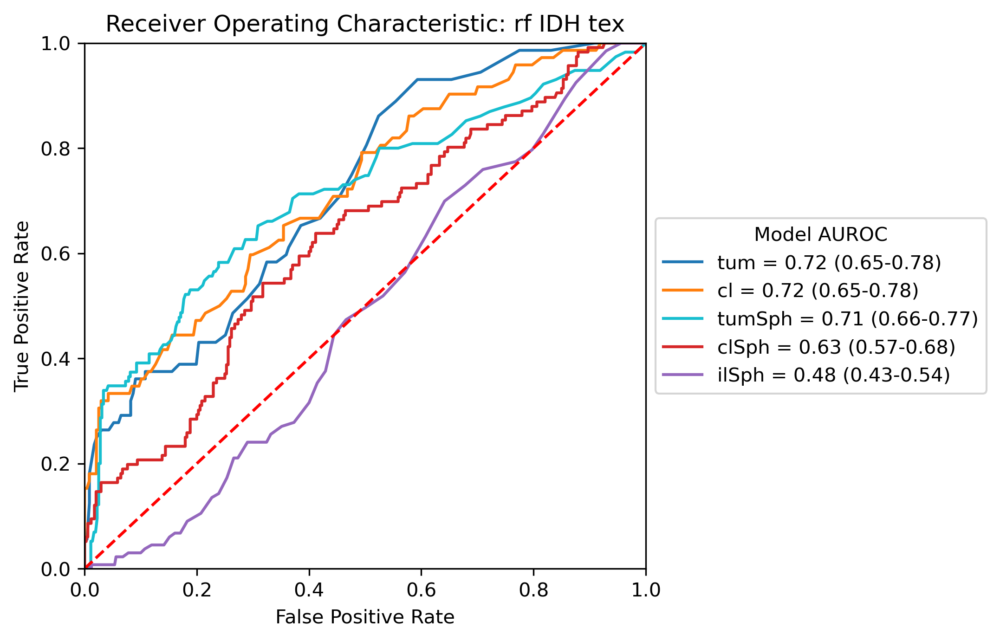

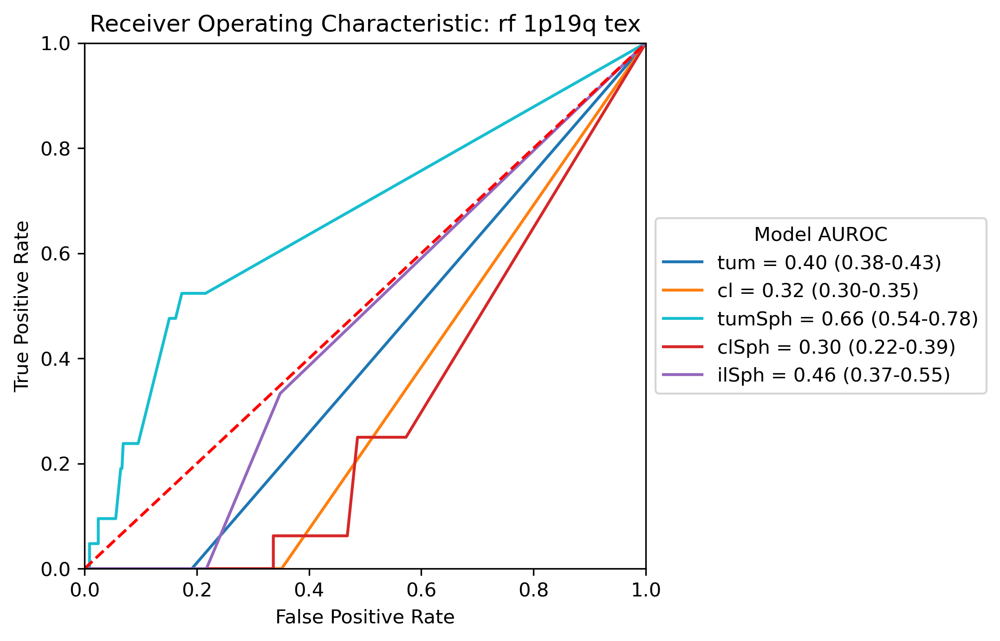

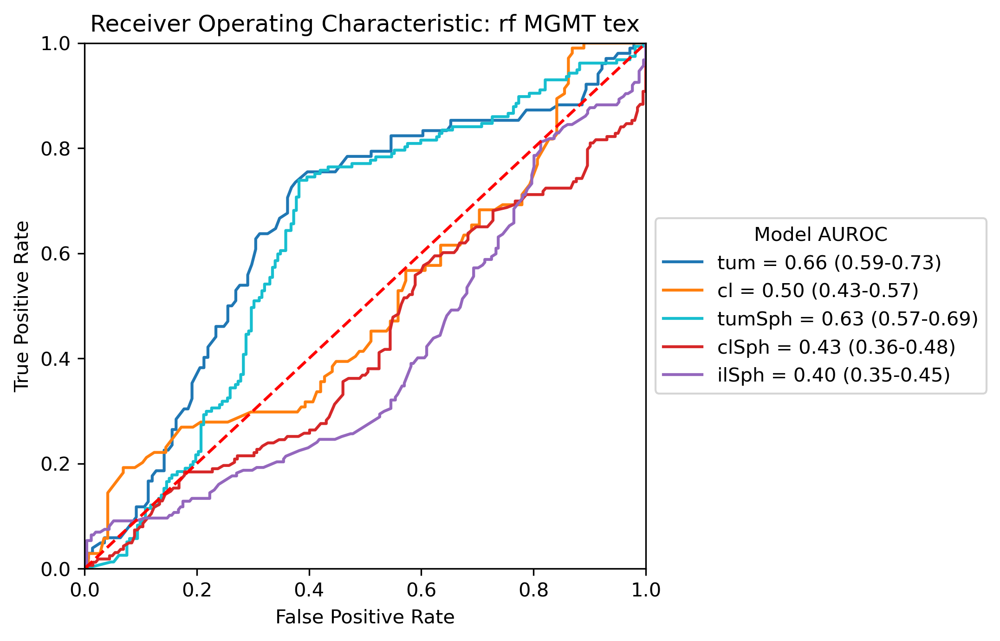

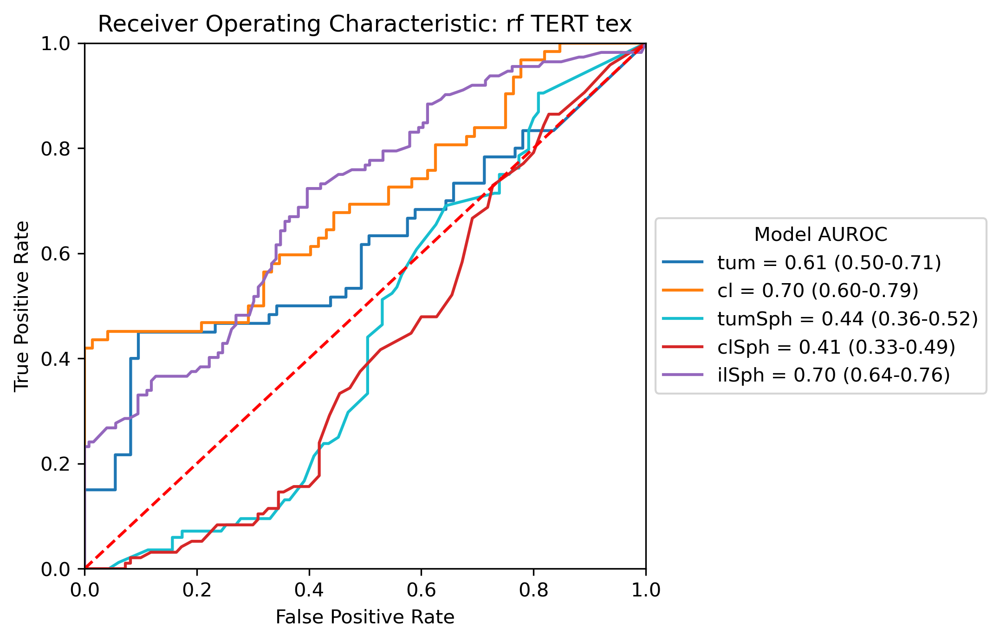

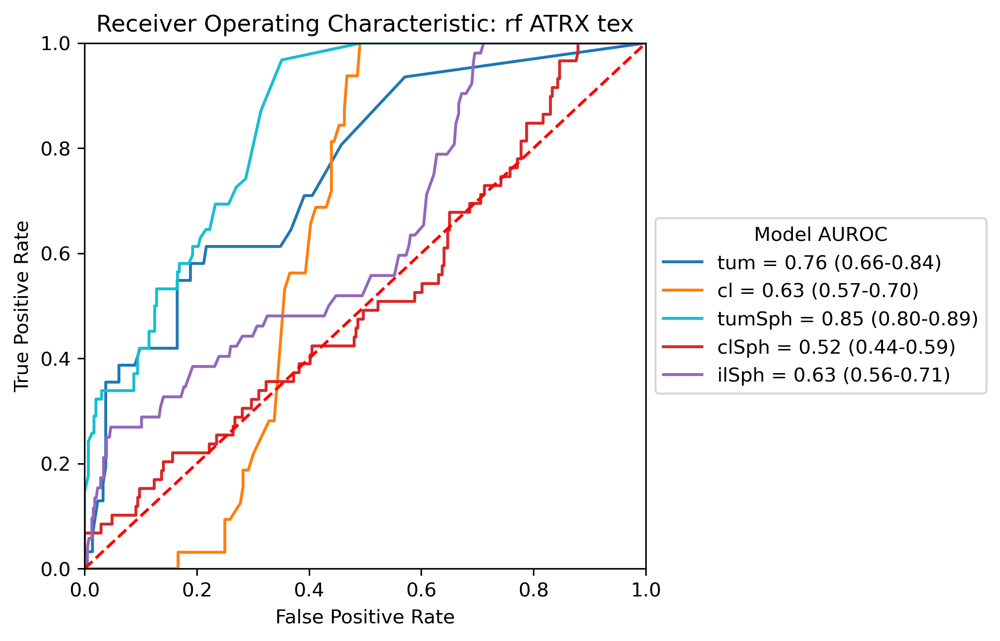

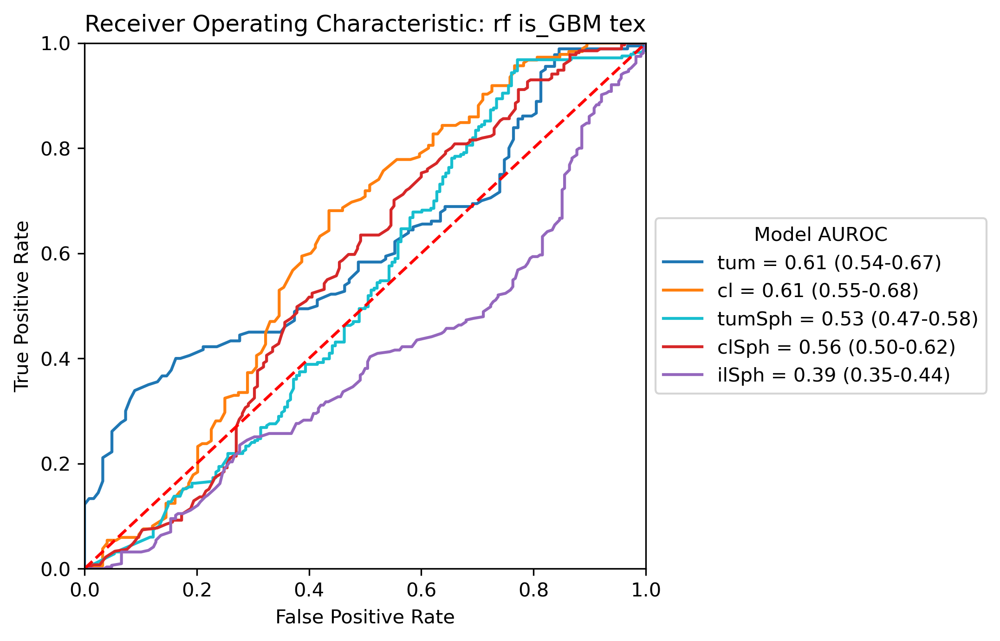

In [331]:
classifier = 'rf'
expType = 'tex'
for yCol in ['IDH','1p19q','MGMT','TERT','ATRX','is_GBM']:
    f, ax = plt.subplots(figsize=(8, 5),dpi=300)
    plt.title('Receiver Operating Characteristic: %s %s %s' % (classifier,yCol,expT))
    for key in fTypes:
    #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
        cLbl = '%s_%s_%s_%s' % (classifier,yCol,key,expT)
        plt.plot(tsRes[cLbl]['fpr'], tsRes[cLbl]['tpr'],colDict[key], label = '%s = %0.2f (%0.2f-%0.2f)' % 
                 (key,tsRes[cLbl]['AUC'],tsRes[cLbl]['AUC Lower'],tsRes[cLbl]['AUC Upper']))

    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.65, box.height])

    # Put a legend to the right of the current axis
    ax.legend(title='Model AUROC',loc='center left', bbox_to_anchor=(1, 0.5))
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.savefig(os.path.join(outImDir,'AUROC_%s_%s_%s.png' % (classifier,yCol,expT)))
    plt.show()

In [313]:
metList = ['Accuracy','Sensitivity','Specificity','AUC','AUC Upper','AUC Lower'] 
tsDict = {k: {sk:sv for sk,sv in v.items() if sk in metList} for k,v in tsRes.items() }

pd.set_option('display.max_rows', 100)
tsStDF = pd.DataFrame(data=tsDict).T
tsStDF['smp_type'] = [re.split('_',sT)[-2] for sT in tsStDF.index]
match = [re.search('(IDH|1p19q|MGMT|TERT|ATRX|is_GBM)',sT) for sT in tsStDF.index]
tsStDF['marker'] = [m[0] if m else '' for m in match]

tsStDF

,Sensitivity,Specificity,AUC,AUC Upper,AUC Lower,Accuracy,smp_type,marker
0_rf_IDH_tum_tex,0.888889,0.666667,0.840142,0.899855,0.760563,0.626016,tum,IDH
1_rf_IDH_tum_tex,NaN,0.000000,NaN,NaN,NaN,0.872222,tum,IDH
rf_IDH_tum_tex,0.930556,0.406926,0.719096,0.782389,0.652447,0.772277,tum,IDH
0_rf_IDH_cl_tex,0.708333,0.980769,0.903579,0.948547,0.848287,0.596774,cl,IDH
1_rf_IDH_cl_tex,NaN,0.000000,NaN,NaN,NaN,0.962162,cl,IDH
rf_IDH_cl_tex,0.597222,0.704641,0.719849,0.783085,0.650978,0.815534,cl,IDH
0_rf_IDH_tumSph_tex,0.800000,0.780822,0.837820,0.890741,0.781364,0.595745,tumSph,IDH
1_rf_IDH_tumSph_tex,NaN,0.000000,NaN,NaN,NaN,0.918728,tumSph,IDH
rf_IDH_tumSph_tex,0.582609,0.761236,0.711273,0.766862,0.656408,0.789809,tumSph,IDH
0_rf_IDH_clSph_tex,0.801724,0.536232,0.648738,0.740385,0.556410,0.448649,clSph,IDH


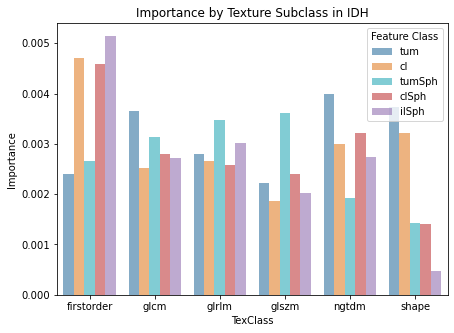

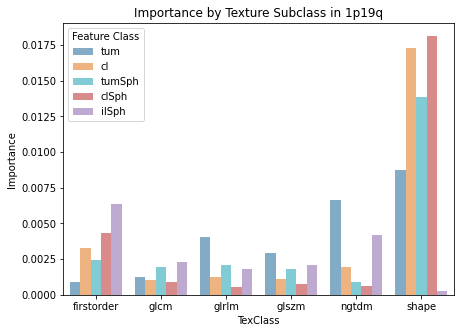

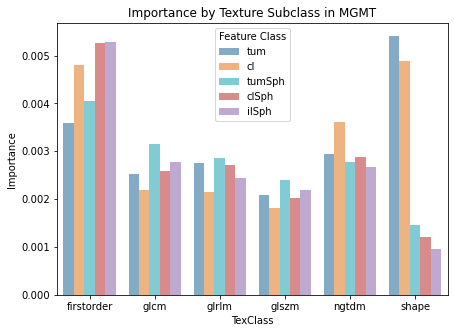

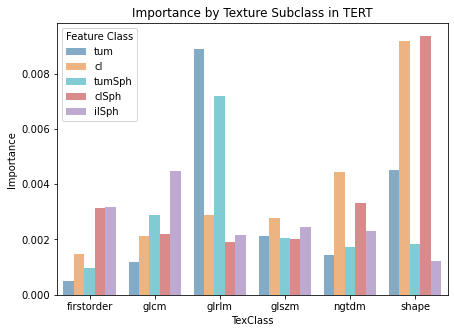

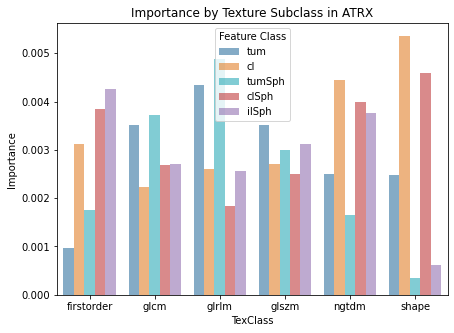

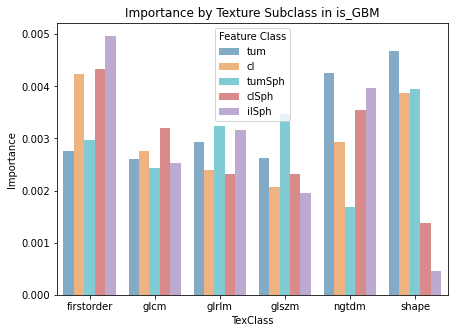

In [312]:
for yCol in ['IDH','1p19q','MGMT','TERT','ATRX','is_GBM']:
    cImpDict = storeImpDict['rf_%s_tex' % yCol]
    cMode = 'tum'

    impDFList = []
    for cMode in fTypes:
        cImp = cImpDict[cMode]
        impMatch = [re.search('^[A-Za-z]+',ft) for ft in cImp.keys()]
        impType =  [m[0] if m else '' for m in impMatch]
    #     # print(impType)

        cImpDF = pd.DataFrame(cImp,columns={'Importance'})
        cImpDF['TexClass'] = impType
        cImpDF['typeRank'] = cImpDF.groupby("TexClass")["Importance"].rank("dense", ascending=False)
        # impDF
#         meanImpDF = cImpDF[cImpDF['typeRank'] <=2].groupby("TexClass").mean()
        meanImpDF = cImpDF.groupby("TexClass").mean()

        meanImpDF["Feature Class"] = cMode
        impDFList.append(meanImpDF)
    impDF = pd.concat(impDFList,axis=0)
    impDF["TexClass"] = impDF.index

    f, ax = plt.subplots(figsize=(7, 5))
    plt.title('Importance by Texture Subclass in %s' % (yCol))
    g = sns.barplot(
        data=impDF,
        x="TexClass", y="Importance", hue="Feature Class",
        ci = 'Importance std',palette=colDict.values(), alpha=.6
    )
    plt.show()

In [ ]:
cImpDict = storeImpDict['rf_IDH_tex']
cMode = 'tum'
impDFList = []
for cMode in fTypes:
    cImp = cImpDict[cMode]
    impMatch = [re.search('^[A-Za-z]+',ft) for ft in cImp['ftName']]
    impType =  [m[0] if m else '' for m in impMatch]
#     # print(impType)

    cImpDF = pd.DataFrame(cImp,columns={'Importance'})
    cImpDF['TexClass'] = impType
    cImpDF['typeRank'] = cImpDF.groupby("TexClass")["Importance"].rank("dense", ascending=False)
    # impDF
    meanImpDF = cImpDF[cImpDF['typeRank'] <=2].groupby("TexClass").mean()
    meanImpDF["Feature Class"] = cMode
    impDFList.append(meanImpDF)
impDF = pd.concat(impDFList,axis=0)
impDF["TexClass"] = impDF.index
g = sns.barplot(
    data=impDF,
    x="TexClass", y="Importance", hue="Feature Class",
    ci = 'Importance std',palette=colDict.values(), alpha=.6
)

In [303]:
cImpDict['cl']

,Importance,Importance std,ftName
0,-0.001942,0.001585,firstorder_10Percentile_FLAIR_cl
1,-0.001942,0.001585,firstorder_90Percentile_FLAIR_cl
2,0.000000,0.000000,firstorder_Energy_FLAIR_cl
3,-0.000971,0.001483,firstorder_Entropy_FLAIR_cl
4,0.000000,0.000000,firstorder_InterquartileRange_FLAIR_cl
...,...,...,...
331,-0.001618,0.001618,shape_Maximum2DDiameterColumn_T2_cl
332,0.000000,0.000000,shape_Maximum2DDiameterRow_T2_cl
333,0.000000,0.000000,shape_Maximum2DDiameterSlice_T2_cl
334,0.000000,0.000000,shape_MinorAxisLength_T2_cl


# Fit all the experiments

rf_IDH_tum_cmb: 2022-07-28T14:01
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_cl_cmb: 2022-07-28T14:02
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_tumSph_cmb: 2022-07-28T14:03
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_clSph_cmb: 2022-07-28T14:04
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_ilSph_cmb: 2022-07-28T14:05
Fitting 5 folds for each of 100 candidates, totalling 500 fits


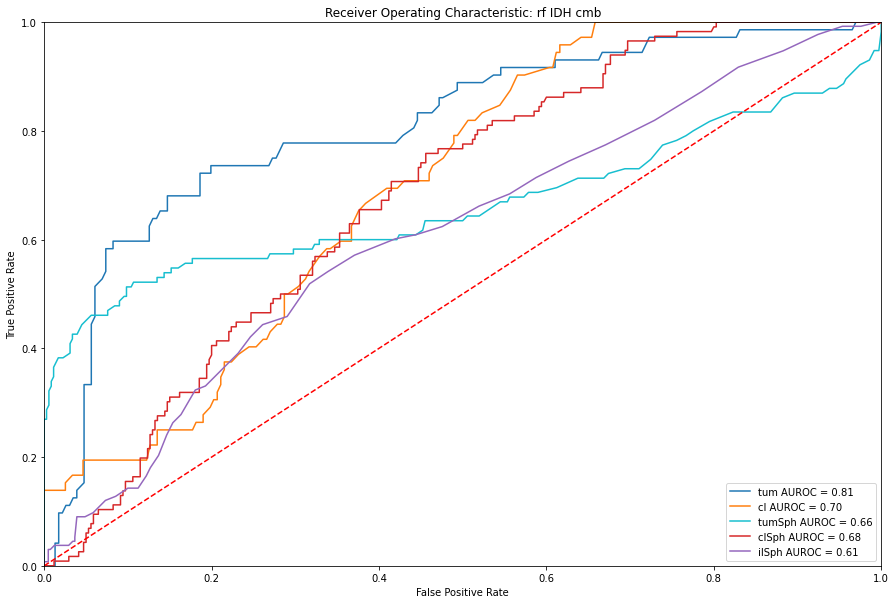

<Figure size 432x288 with 0 Axes>

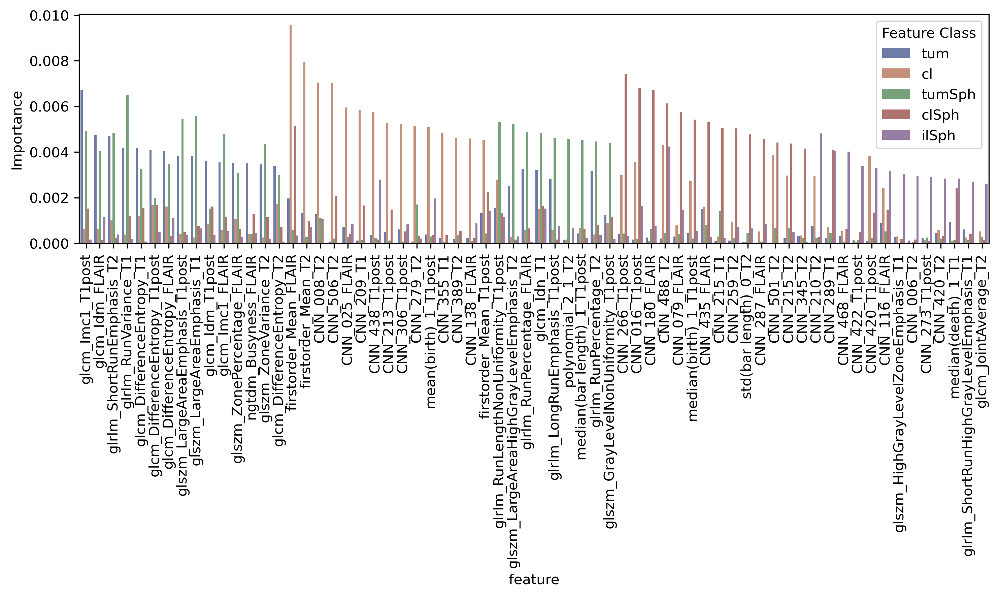

rf_IDH_tum_tex: 2022-07-28T14:07
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_cl_tex: 2022-07-28T14:07
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_tumSph_tex: 2022-07-28T14:07
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_clSph_tex: 2022-07-28T14:08
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_ilSph_tex: 2022-07-28T14:09
Fitting 5 folds for each of 100 candidates, totalling 500 fits


<Figure size 432x288 with 0 Axes>

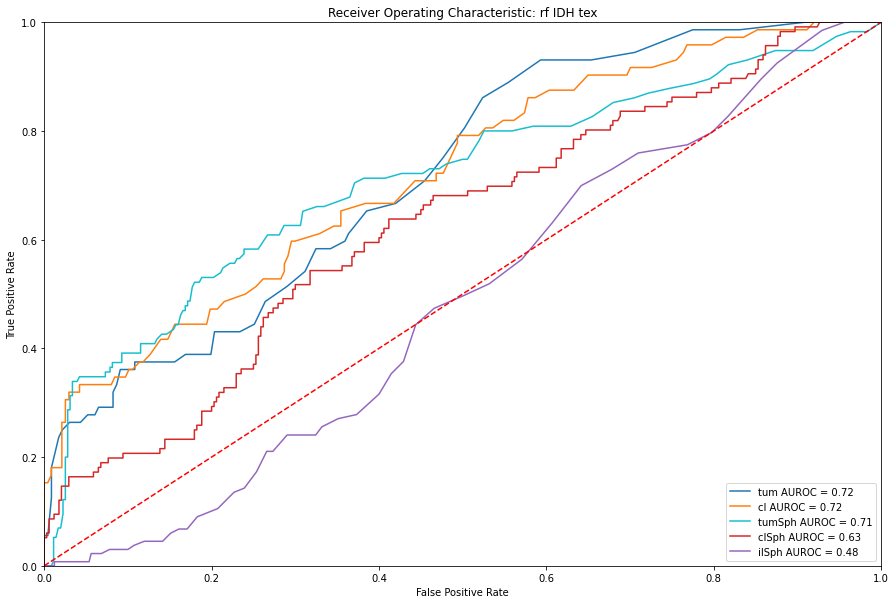

<Figure size 432x288 with 0 Axes>

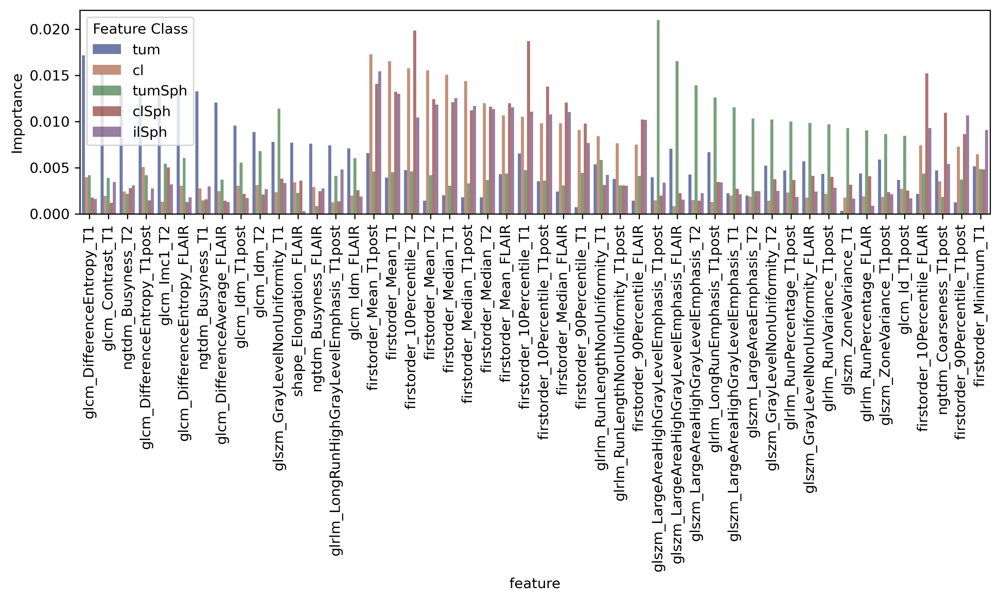

rf_IDH_tum_tda: 2022-07-28T14:09
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_cl_tda: 2022-07-28T14:10
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_tumSph_tda: 2022-07-28T14:10
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_clSph_tda: 2022-07-28T14:10
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_ilSph_tda: 2022-07-28T14:11
Fitting 5 folds for each of 100 candidates, totalling 500 fits


<Figure size 432x288 with 0 Axes>

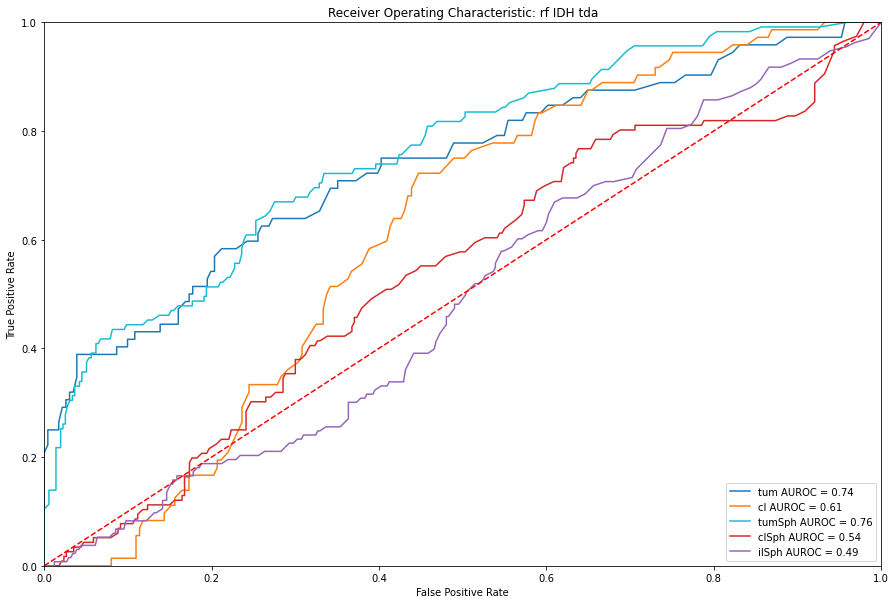

<Figure size 432x288 with 0 Axes>

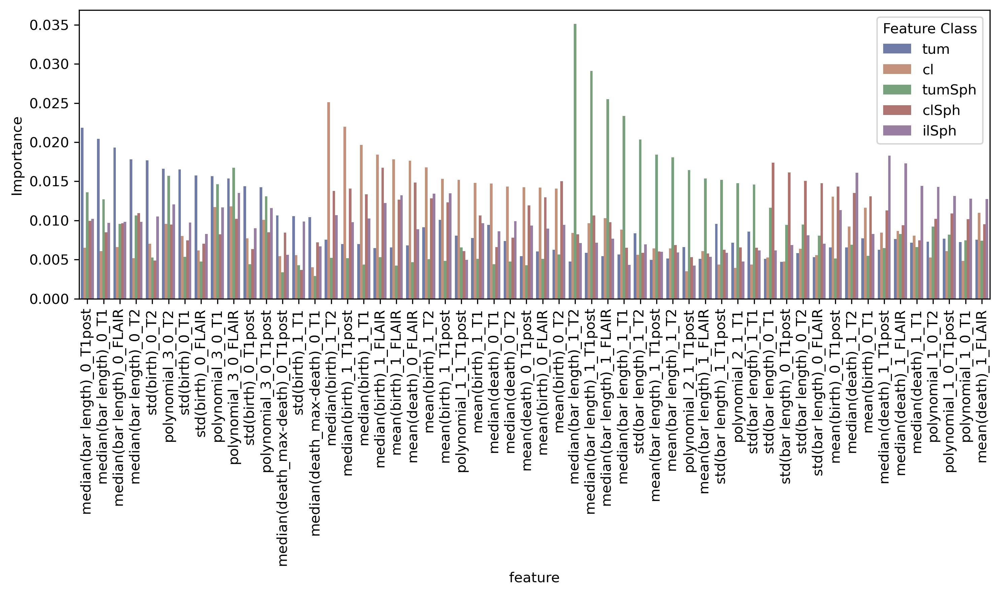

rf_IDH_tum_cnn: 2022-07-28T14:11
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_cl_cnn: 2022-07-28T14:12
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_tumSph_cnn: 2022-07-28T14:13
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_clSph_cnn: 2022-07-28T14:14
Fitting 5 folds for each of 100 candidates, totalling 500 fits
rf_IDH_ilSph_cnn: 2022-07-28T14:15
Fitting 5 folds for each of 100 candidates, totalling 500 fits


<Figure size 432x288 with 0 Axes>

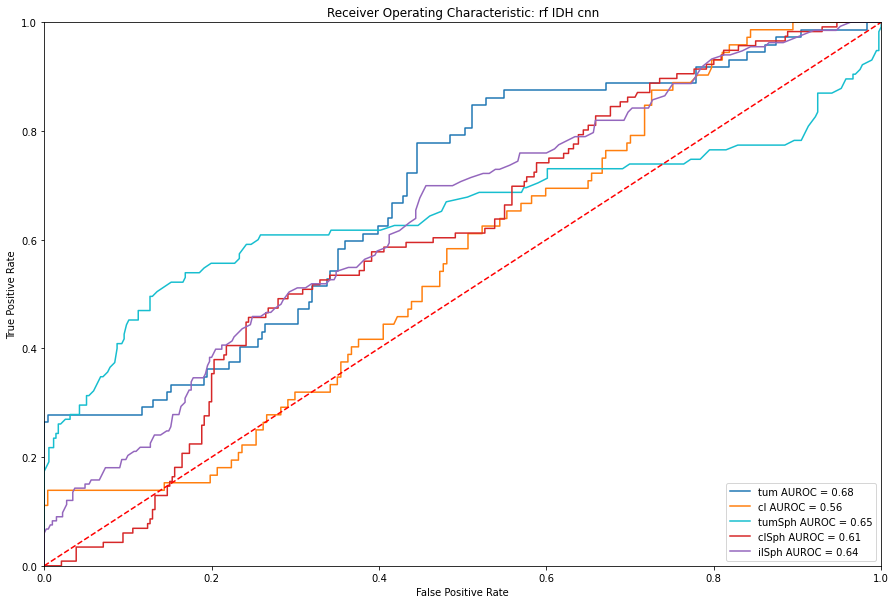

<Figure size 432x288 with 0 Axes>

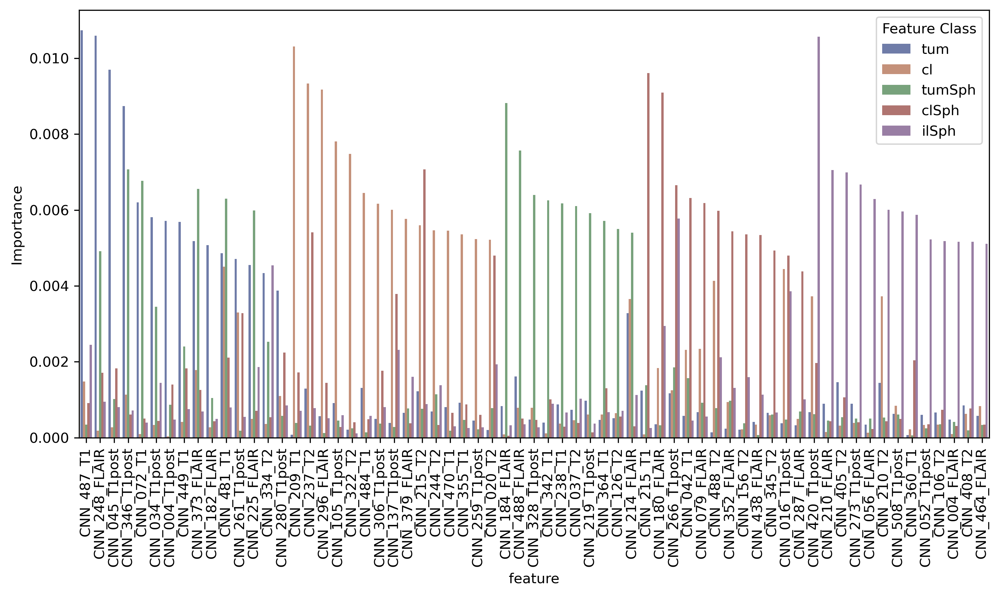

logreg_IDH_tum_cmb: 2022-07-28T14:17
Fitting 5 folds for each of 9 candidates, totalling 45 fits
logreg_IDH_cl_cmb: 2022-07-28T14:17
Fitting 5 folds for each of 9 candidates, totalling 45 fits
logreg_IDH_tumSph_cmb: 2022-07-28T14:18
Fitting 5 folds for each of 9 candidates, totalling 45 fits
logreg_IDH_clSph_cmb: 2022-07-28T14:18
Fitting 5 folds for each of 9 candidates, totalling 45 fits


KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [230]:

from sklearn.model_selection import GridSearchCV
outImDir = os.path.join(basedir,'data','images','graphs')
if not os.path.exists(outImDir):
    os.makedirs(outImDir)

expTypes = ['cmb','tex','tda','cnn']
# expTypes = ['tex']
fTypes = ['tum','cl','tumSph','clSph','ilSph']
nFts = 15
pMode = 'tum'
trRes = {}
tsRes = {}
# yCol = 'IDH'
colDict = {'tum':'tab:blue','cl':'tab:orange','tumSph':'tab:cyan','clSph':'tab:red','ilSph':'tab:purple'}

for yCol in ['IDH','1p19q','MGMT','TERT','ATRX']:
# for yCol in ['IDH']:
    for classifier in {'logreg','rf'}:
        for expT in expTypes:
            aucDict = {}
            tprDict = {}
            fprDict = {}
            impDict = {}
            for pMode in fTypes:

                expLbl = '%s_%s_%s_%s' % (classifier,yCol,pMode,expT)
                print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
                cData = fullData[fullData['sl_rank_%s' % pMode] <=10].copy()
                fCols = fullData.columns
                REPat = '_%s$' % pMode 
                cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
                if expT != 'cmb': # pick only feature columns of a specific type
                    cCols = [col for col in cCols if col in cNamesDict[expT]]
                filtData = cData[cCols]
                # filtData

                # rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


                rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
                trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

                # train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
                dataTrain = filtData.loc[trMask].copy()

                trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
                trainY = cData.loc[trMask][yCol] == 1
                # print(trainY.shape)

                # dataFiltered = dataTrain.filter(items=(features_selected))
                dataFiltered = dataTrain
                dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
                dataFiltered = dataFiltered.fillna(0)
                # print(dataFiltered.shape)
                if classifier == 'rf':
                    # define the grid to search
                    estimator_grid = random_grid()

                    # k-fold split
                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)
                    estimator = RandomizedSearchCV(estimator = rfc,
                                               param_distributions = estimator_grid, scoring = 'roc_auc',
                                               n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)
                elif classifier == 'logreg':
                    estimator_instance = LogisticRegression(random_state = random_seed*2, 
                                                            max_iter = 500,# increased max iter count
                                                            solver='liblinear') 
                    estimator_grid = Logreg_grid()

                    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
                    kfSp = kf.split(dataFiltered,trainY, groups = trainID)

                    estimator = GridSearchCV(
                        estimator = estimator_instance, 
                        param_grid = estimator_grid,
                        scoring = 'roc_auc',
                        #cv = logo.split(train_val_features_df, train_val_1p19q, groups = train_val_id),
                        cv = kfSp,
                        verbose=2,
                        refit = True,
                        n_jobs = -1)

                    estimator.fit(dataFiltered,trainY)

                bestEst = estimator.best_estimator_
                predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)
                yTrue = trainY.values.reshape([-1,1])
                organize_result(trRes, expLbl, yTrue, predProbs)

                ## Test Dataset
                #     tsMask = (np.isin(cData['patient'],testIDs))
                tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
                dataTest = filtData.loc[tsMask].copy()

                testY = cData.loc[tsMask][yCol] == 1
                # data_filtered = dataTest.filter(items=(features_selected))
                dataFiltered = dataTest
                predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

                fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
                roc_auc = metrics.auc(fpr, tpr)
                yTrue = testY.values.reshape([-1,1])
                # save for combined plot
                fprDict[pMode] = fpr
                tprDict[pMode] = tpr
                aucDict[pMode] = roc_auc
                
                if classifier == 'rf':
                    importances = pd.Series(bestEst.feature_importances_, index=cCols)
                else:
                    importances = pd.Series(bestEst.coef_.flatten(), index=cCols)
                importances = importances.sort_values(ascending=False)
                impDict[pMode] = importances.copy()

                organize_result(tsRes, expLbl, yTrue, predProbs)

            # plotting AUROC
            f, ax = plt.subplots(figsize=(15, 10))
            plt.title('Receiver Operating Characteristic: %s %s %s' % (classifier,yCol,expT))
            for key in fprDict.keys():
    #         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
                plt.plot(fprDict[key], tprDict[key],colDict[key], label = '%s AUROC = %0.2f' % (key,aucDict[key]))
            plt.legend(loc = 'lower right')
            plt.plot([0, 1], [0, 1],'r--')
            plt.xlim([0, 1])
            plt.ylim([0, 1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')
            plt.show()

            plt.savefig(os.path.join(outImDir,'AUROC_%s_%s_%s.png' % (classifier,yCol,expT)))


            # feature importance graphs
            topFeats = []
            for key in fTypes:
                topFtList = impDict[key][:nFts].keys()
                regExPat = '_%s$' % key
                topFtList = [re.sub(regExPat,'',ft) for ft in topFtList]
                topFeats.extend([ft for ft in topFtList if ft not in topFeats])

            fig = plt.figure(figsize=[10,6],dpi=300)
            impDFList = []
            for key in fTypes:
                cKeys = ['%s_%s'% (ft,key) for ft in topFeats]
                cFDict = {ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}
                impDF = pd.DataFrame({'feature':cFDict.keys(),'Importance':cFDict.values()},index=cKeys)
                impDF['Feature Class'] = key
                impDFList.append(impDF)
            impDF = pd.concat(impDFList,axis=0)

            g = sns.barplot(
                data=impDF,
                x="feature", y="Importance", hue="Feature Class",palette="dark", alpha=.6
            )
            locs, labels = plt.xticks()
            plt.setp(labels, rotation=90)
            fig.tight_layout()
            plt.show()
            plt.savefig(os.path.join(outImDir,'Importance_%s_%s_%s.png' % (classifier,yCol,expT)))

In [59]:
importances = pd.Series(bestEst.coef_.flatten(), index=cCols)
importances

firstorder_10Percentile_FLAIR_tum         -0.000002
firstorder_90Percentile_FLAIR_tum         -0.000003
firstorder_Energy_FLAIR_tum                0.000061
firstorder_Entropy_FLAIR_tum              -0.000008
firstorder_InterquartileRange_FLAIR_tum   -0.000004
                                             ...   
CNN_507_T2_tum                             0.000056
CNN_508_T2_tum                             0.000004
CNN_509_T2_tum                             0.000017
CNN_510_T2_tum                             0.000025
CNN_511_T2_tum                             0.000083
Length: 2504, dtype: float64

In [55]:
np.array(bestEst.coef_).flatten().shape

(2504,)

In [20]:
import seaborn as sns
topFeats = []
for key in fTypes:
    topFtList = impDict[key][:nFts].keys()
    regExPat = '_%s$' % key
    topFtList = [re.sub(regExPat,'',ft) for ft in topFtList]
    topFeats.extend([ft for ft in topFtList if ft not in topFeats])

plt.figure(figsize=[10,6],dpi=300)
impDFList = []
for key in fTypes:
    cKeys = ['%s_%s'% (ft,key) for ft in topFeats]
    cFDict = {ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}
    impDF = pd.DataFrame({'feature':cFDict.keys(),'Importance':cFDict.values()},index=cKeys)
    impDF['Feature Class'] = key
    impDFList.append(impDF)
impDF = pd.concat(impDFList,axis=0)
plt.show()

<Figure size 3000x1800 with 0 Axes>

In [272]:
yCol = 'IDH'
expT = 'cmb'
impDict = {}
for pMode in ['tum','cl']:

    expLbl = '%s_%s_%s' % (yCol,pMode,expT)
    print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
    cData = fullData[fullData['sl_rank_%s' % pMode] <=10].copy()
    fCols = fullData.columns
    REPat = '_%s$' % pMode 
    cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
    if expT != 'cmb': # pick only feature columns of a specific type
        cCols = [col for col in cCols if col in cNamesDict[expT]]
    filtData = cData[cCols]
    # filtData

    # rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


    rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
    trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

    # train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
    dataTrain = filtData.loc[trMask].copy()

    trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
    trainY = cData.loc[trMask][yCol] == 1
    # print(trainY.shape)

    # dataFiltered = dataTrain.filter(items=(features_selected))
    dataFiltered = dataTrain
    dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
    dataFiltered = dataFiltered.fillna(0)
    # print(dataFiltered.shape)

    # define the grid to search
    grid1 = random_grid()

    # k-fold split
#         kf = KFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
#         kfSp = kf.split(dataFiltered,trainY, groups = trainID)
    kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
    kfSp = kf.split(dataFiltered,trainY, groups = trainID)
    rfRes = RandomizedSearchCV(estimator = rfc,
                               param_distributions = grid1, scoring = 'roc_auc',
                               n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

    rfRes.fit(dataFiltered,trainY)


    bestRF = rfRes.best_estimator_
    predProbs = bestRF.predict_proba(dataFiltered)[:,1].reshape(-1,1)
    yTrue = trainY.values.reshape([-1,1])
    organize_result(trRes, expLbl, yTrue, predProbs)

    ## Test Dataset
    #     tsMask = (np.isin(cData['patient'],testIDs))
    tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
    dataTest = filtData.loc[tsMask].copy()

    testY = cData.loc[tsMask][yCol] == 1
    # data_filtered = dataTest.filter(items=(features_selected))
    dataFiltered = dataTest
    predProbs = bestRF.predict_proba(dataFiltered)[:,1].reshape(-1,1)

    fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
    roc_auc = metrics.auc(fpr, tpr)
    yTrue = testY.values.reshape([-1,1])
    # save for combined plot
    fprDict[pMode] = fpr
    tprDict[pMode] = tpr
    aucDict[pMode] = roc_auc
    importances = pd.Series(bestRF.feature_importances_, index=cCols)
    importances = importances.sort_values(ascending=False)
    impDict[pMode] = importances.copy()
#     print(importances[:10])

IDH_tum_cmb: 2022-03-24T15:49
Fitting 5 folds for each of 100 candidates, totalling 500 fits
glcm_Imc1_T1post_tum                 0.006935
glcm_Imc1_FLAIR_tum                  0.005316
glrlm_ShortRunEmphasis_T2_tum        0.004659
glszm_LargeAreaEmphasis_T1_tum       0.004370
glcm_Imc1_T1_tum                     0.004293
glrlm_RunVariance_T1_tum             0.004155
glcm_DifferenceEntropy_T2_tum        0.004078
glcm_DifferenceAverage_FLAIR_tum     0.003869
glcm_DifferenceAverage_T1post_tum    0.003823
glcm_DifferenceEntropy_FLAIR_tum     0.003617
dtype: float64
IDH_cl_cmb: 2022-03-24T15:50
Fitting 5 folds for each of 100 candidates, totalling 500 fits
CNN_025_FLAIR_cl                          0.009272
CNN_105_T1post_cl                         0.007016
CNN_399_FLAIR_cl                          0.006974
CNN_322_T2_cl                             0.006490
CNN_431_FLAIR_cl                          0.005800
CNN_050_FLAIR_cl                          0.005719
CNN_430_T2_cl                     

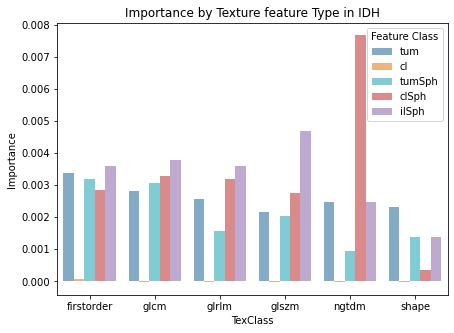

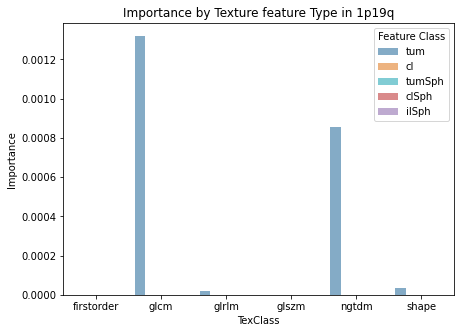

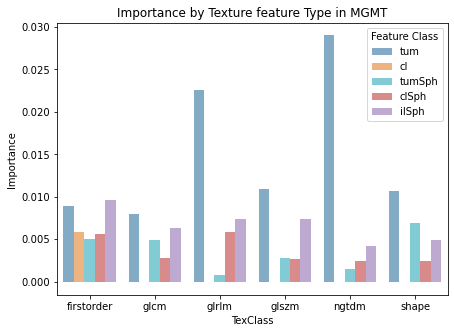

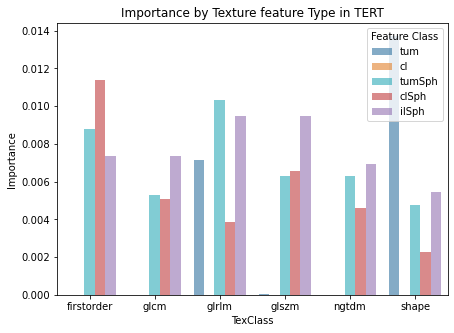

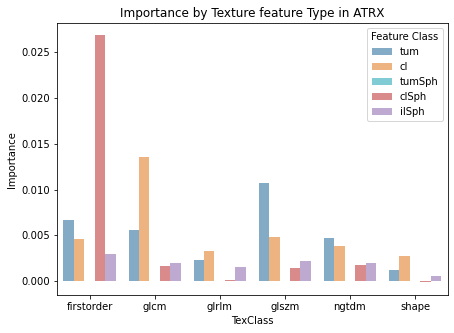

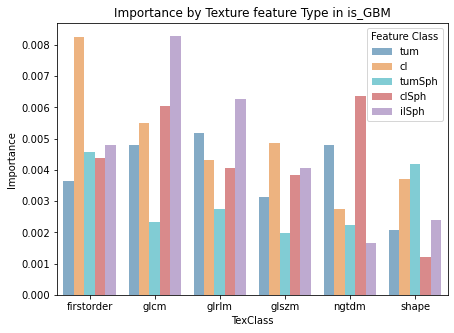

In [305]:
for yCol in ['IDH','1p19q','MGMT','TERT','ATRX','is_GBM']:
    cImpDict = storeImpResDict['rf_%s_tex' % yCol]
    cMode = 'tum'

    impDFList = []
    for cMode in fTypes:
        cImp = cImpDict[cMode]
        impMatch = [re.search('^[A-Za-z]+',ft) for ft in cImp['ftName']]
        impType =  [m[0] if m else '' for m in impMatch]
    #     # print(impType)

        cImpDF = pd.DataFrame(cImp,columns={'Importance'})
        cImpDF['TexClass'] = impType
        cImpDF['typeRank'] = cImpDF.groupby("TexClass")["Importance"].rank("dense", ascending=False)
        # impDF
        meanImpDF = cImpDF[cImpDF['typeRank'] <=2].groupby("TexClass").mean()
        meanImpDF["Feature Class"] = cMode
        impDFList.append(meanImpDF)
    impDF = pd.concat(impDFList,axis=0)
    impDF["TexClass"] = impDF.index

    f, ax = plt.subplots(figsize=(7, 5))
    plt.title('Importance by Texture feature Type in %s' % (yCol))
    g = sns.barplot(
        data=impDF,
        x="TexClass", y="Importance", hue="Feature Class",
        ci = 'Importance std',palette=colDict.values(), alpha=.6
    )
    plt.show()

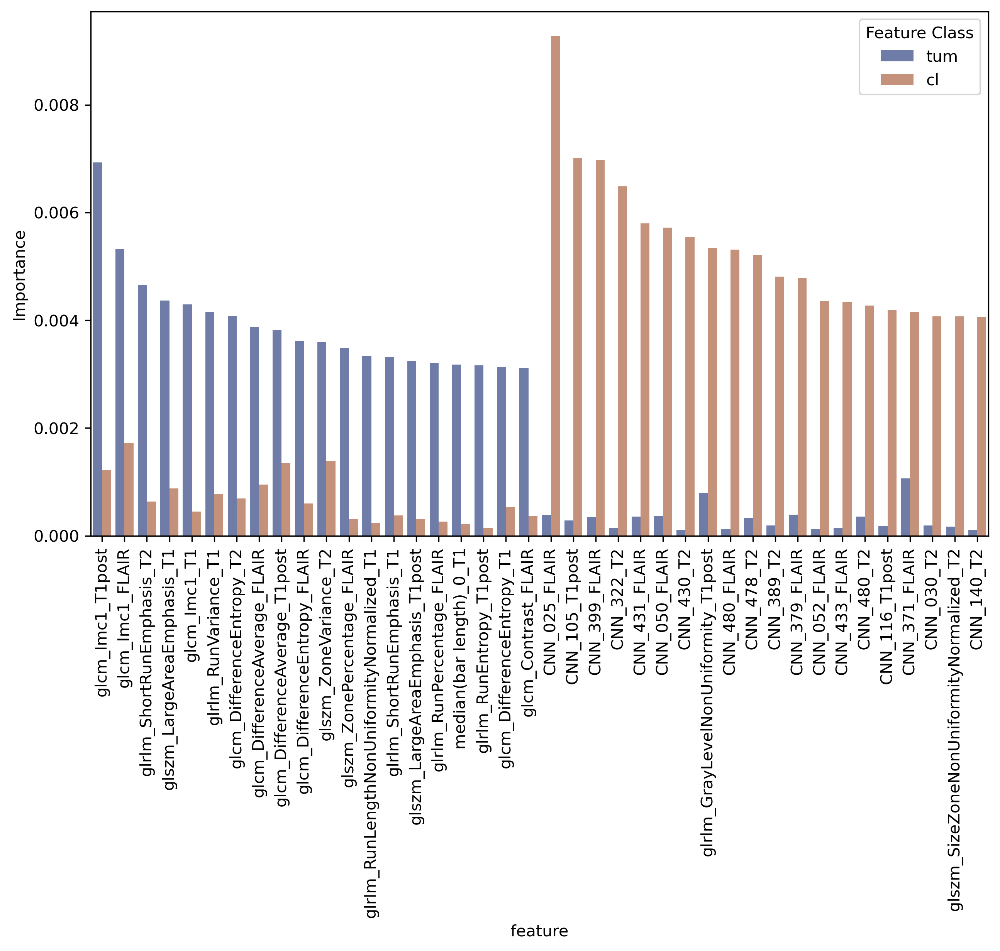

,feature,Importance,Feature Class
glcm_Imc1_T1post_tum,glcm_Imc1_T1post,0.006935,tum
glcm_Imc1_FLAIR_tum,glcm_Imc1_FLAIR,0.005316,tum
glrlm_ShortRunEmphasis_T2_tum,glrlm_ShortRunEmphasis_T2,0.004659,tum
glszm_LargeAreaEmphasis_T1_tum,glszm_LargeAreaEmphasis_T1,0.004370,tum
glcm_Imc1_T1_tum,glcm_Imc1_T1,0.004293,tum
...,...,...,...
CNN_116_T1post_cl,CNN_116_T1post,0.004195,cl
CNN_371_FLAIR_cl,CNN_371_FLAIR,0.004159,cl
CNN_030_T2_cl,CNN_030_T2,0.004073,cl
glszm_SizeZoneNonUniformityNormalized_T2_cl,glszm_SizeZoneNonUniformityNormalized_T2,0.004072,cl


In [319]:
import seaborn as sns

# impDict = {}
topFeats = []
for key in ['tum','cl']:
#     importances = pd.Series(rfDict[key].feature_importances_, index=cCols)
#     importances = importances.sort_values(ascending=False)
#     impDict[key] = importances
    topFtList = impDict[key][:20].keys()
    regExPat = '_%s$' % key
    topFtList = [re.sub(regExPat,'',ft) for ft in topFtList]
#     print(regExPat,topFtList)
    topFeats.extend([ft for ft in topFtList if ft not in topFeats])
# print(topFeats)

plt.figure(figsize=[10,6],dpi=300)
impDFList = []
for key in ['tum','cl']:
    cKeys = ['%s_%s'% (ft,key) for ft in topFeats]
#     print(impDict[key][cKeys])
    cFDict = {ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}
    impDF = pd.DataFrame({'feature':cFDict.keys(),'Importance':cFDict.values()},index=cKeys)
    impDF['Feature Class'] = key
    impDFList.append(impDF)
# print(impDFList)
impDF = pd.concat(impDFList,axis=0)

g = sns.barplot(
    data=impDF,
    x="feature", y="Importance", hue="Feature Class",palette="dark", alpha=.6
)
# g.set_axis_labels("", "Mean decrease in impurity")
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)
fig.tight_layout()
plt.show()

impDF

In [290]:
{ft:impDict[key]['%s_%s'% (ft,key)] for ft in topFeats}

{'glcm_Imc1_T1post': 0.0012153247596396102,
 'glcm_Imc1_FLAIR': 0.0017154376870389988,
 'glrlm_ShortRunEmphasis_T2': 0.0006334979651856118,
 'glszm_LargeAreaEmphasis_T1': 0.0008772998068024201,
 'glcm_Imc1_T1': 0.00044993910876212144,
 'glrlm_RunVariance_T1': 0.0007730193376930892,
 'glcm_DifferenceEntropy_T2': 0.0006881452130382867,
 'glcm_DifferenceAverage_FLAIR': 0.0009495601058162179,
 'glcm_DifferenceAverage_T1post': 0.001350166712841158,
 'glcm_DifferenceEntropy_FLAIR': 0.000596050605622995,
 'glszm_ZoneVariance_T2': 0.0013847771219065344,
 'glszm_ZonePercentage_FLAIR': 0.00031524790309705477,
 'glrlm_RunLengthNonUniformityNormalized_T1': 0.00023202723753763541,
 'glrlm_ShortRunEmphasis_T1': 0.0003750223993892291,
 'glszm_LargeAreaEmphasis_T1post': 0.000315397820530827,
 'glrlm_RunPercentage_FLAIR': 0.0002622663971827625,
 'median(bar length)_0_T1': 0.0002118360535260796,
 'glrlm_RunEntropy_T1post': 0.0001413843189220285,
 'glcm_DifferenceEntropy_T1': 0.0005341287462989653,
 'glc

In [279]:
impDict[key][cKeys]

glcm_Imc1_T1post_cl                             0.001215
glcm_Imc1_FLAIR_cl                              0.001715
glrlm_ShortRunEmphasis_T2_cl                    0.000633
glszm_LargeAreaEmphasis_T1_cl                   0.000877
glcm_Imc1_T1_cl                                 0.000450
glrlm_RunVariance_T1_cl                         0.000773
glcm_DifferenceEntropy_T2_cl                    0.000688
glcm_DifferenceAverage_FLAIR_cl                 0.000950
glcm_DifferenceAverage_T1post_cl                0.001350
glcm_DifferenceEntropy_FLAIR_cl                 0.000596
glszm_ZoneVariance_T2_cl                        0.001385
glszm_ZonePercentage_FLAIR_cl                   0.000315
glrlm_RunLengthNonUniformityNormalized_T1_cl    0.000232
glrlm_ShortRunEmphasis_T1_cl                    0.000375
glszm_LargeAreaEmphasis_T1post_cl               0.000315
glrlm_RunPercentage_FLAIR_cl                    0.000262
median(bar length)_0_T1_cl                      0.000212
glrlm_RunEntropy_T1post_cl     

In [232]:
print(topFeats)

['glcm_DifferenceEntropy_FLAIR_cl', 'CNN_025_FLAIR_cl', 'glszm_ZoneVariance_T2_cl', 'CNN_322_T2_cl', 'glszm_LargeAreaEmphasis_T1post_cl', 'CNN_389_T2_cl', 'CNN_140_T2_cl', 'CNN_430_T2_cl', 'CNN_478_T2_cl', 'CNN_379_FLAIR_cl', 'glrlm_ShortRunEmphasis_T2_cl', 'glcm_Imc1_T1post_cl', 'glrlm_RunPercentage_FLAIR_cl', 'CNN_431_FLAIR_cl', 'glcm_DifferenceAverage_FLAIR_cl', 'CNN_371_FLAIR_cl', 'CNN_480_FLAIR_cl', 'glszm_LargeAreaEmphasis_T1_cl', 'median(bar length)_0_T1_cl', 'glrlm_RunVariance_T1_cl', 'CNN_052_FLAIR_cl', 'CNN_050_FLAIR_cl', 'glcm_Imc1_T1_cl', 'glrlm_ShortRunEmphasis_T1_cl', 'glrlm_RunLengthNonUniformityNormalized_T1_cl', 'glcm_DifferenceAverage_T1post_cl', 'glcm_Imc1_FLAIR_cl', 'glcm_DifferenceEntropy_T2_cl', 'glrlm_RunEntropy_T1post_cl', 'CNN_480_T2_cl', 'glszm_SizeZoneNonUniformityNormalized_T2_cl', 'CNN_433_FLAIR_cl', 'CNN_030_T2_cl', 'glszm_ZonePercentage_FLAIR_cl', 'glcm_DifferenceEntropy_T1_cl', 'CNN_399_FLAIR_cl', 'CNN_105_T1post_cl', 'glrlm_GrayLevelNonUniformity_T1post

In [229]:
impDict[key].keys()[:20]

Index(['glcm_Imc1_T1post_cl', 'glcm_Imc1_FLAIR_cl',
       'glrlm_ShortRunEmphasis_T2_cl', 'glszm_LargeAreaEmphasis_T1_cl',
       'glcm_Imc1_T1_cl', 'glrlm_RunVariance_T1_cl',
       'glcm_DifferenceEntropy_T2_cl', 'glcm_DifferenceAverage_FLAIR_cl',
       'glcm_DifferenceAverage_T1post_cl', 'glcm_DifferenceEntropy_FLAIR_cl',
       'glszm_ZoneVariance_T2_cl', 'glszm_ZonePercentage_FLAIR_cl',
       'glrlm_RunLengthNonUniformityNormalized_T1_cl',
       'glrlm_ShortRunEmphasis_T1_cl', 'glszm_LargeAreaEmphasis_T1post_cl',
       'glrlm_RunPercentage_FLAIR_cl', 'median(bar length)_0_T1_cl',
       'glrlm_RunEntropy_T1post_cl', 'glcm_DifferenceEntropy_T1_cl',
       'glcm_Contrast_FLAIR_cl'],
      dtype='object')

In [151]:
bestRF.get_params()

{'bootstrap': False,
 'ccp_alpha': 0.0,
 'class_weight': 'balanced',
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 307,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 42,
 'verbose': 0,
 'warm_start': False}

# Old In Dev work

In [5]:
pDir = patients[0]
cDir = os.path.join(imagedir,pDir)
(tum_tex_samples,tum_tex_feature_names) = tex_wrapper.get_tex_feats(cDir, feat_suffix='_tum')
tum_tex_df = pd.DataFrame(data=tum_tex_samples, columns = tum_tex_feature_names)
tum_tex_df

,firstorder_10Percentile_FLAIR_tum,firstorder_90Percentile_FLAIR_tum,firstorder_Energy_FLAIR_tum,firstorder_Entropy_FLAIR_tum,firstorder_InterquartileRange_FLAIR_tum,firstorder_Kurtosis_FLAIR_tum,firstorder_Maximum_FLAIR_tum,firstorder_Mean_FLAIR_tum,firstorder_MeanAbsoluteDeviation_FLAIR_tum,firstorder_Median_FLAIR_tum,...,ngtdm_Complexity_T2_tum,ngtdm_Contrast_T2_tum,ngtdm_Strength_T2_tum,shape_Elongation_T2_tum,shape_MajorAxisLength_T2_tum,shape_Maximum2DDiameterColumn_T2_tum,shape_Maximum2DDiameterRow_T2_tum,shape_Maximum2DDiameterSlice_T2_tum,shape_MinorAxisLength_T2_tum,shape_VoxelVolume_T2_tum
0,0.240492,1.295172,21.732593,2.727885,0.786465,2.541692,1.458028,0.761339,0.405381,0.802497,...,17.546631,0.093998,7.962652,0.580616,18.289112,6.0,7.0,19.924859,10.618953,27.0
1,-0.096883,1.503480,72.088492,3.239393,0.839631,2.355690,2.045403,0.617030,0.502385,0.558177,...,40.603442,0.104695,4.291386,0.609170,33.454348,18.0,28.0,34.928498,20.379371,96.0
2,-0.116473,1.426062,131.527654,3.137464,0.751815,3.655032,2.649052,0.498676,0.479669,0.351888,...,72.230332,0.056292,4.074545,0.711059,34.096734,21.0,30.0,38.626416,24.244790,210.0
3,-0.270368,1.234497,157.250769,3.146925,0.735638,3.069047,2.190985,0.389714,0.469997,0.250479,...,53.274671,0.056704,2.152656,0.804766,32.712932,26.0,31.0,38.626416,26.326244,317.0
4,-0.435929,1.172239,192.573765,3.229288,0.828843,2.801276,1.899814,0.249066,0.493012,0.118919,...,48.821887,0.058910,1.572285,0.857353,32.563056,27.0,31.0,38.910153,27.918023,441.0
5,-0.576187,1.131015,258.216015,3.359319,0.877031,2.861072,1.905616,0.144634,0.527622,0.029297,...,55.655908,0.057553,1.539069,0.858568,34.398435,34.0,34.0,39.217343,29.533396,570.0
6,-0.746220,1.152489,413.061335,3.529860,0.965295,3.070293,2.328528,0.090719,0.591058,-0.031608,...,91.401831,0.052132,1.992051,0.905793,36.146778,37.0,35.0,41.868843,32.741497,735.0
7,-0.834218,1.171848,563.889229,3.552479,0.882681,3.358824,2.391446,0.014882,0.591139,-0.101143,...,108.057700,0.051989,1.684198,0.856847,40.253201,38.0,38.0,46.097722,34.490839,956.0
8,-0.812649,1.015231,608.972148,3.455985,0.790679,3.929431,2.655623,-0.015982,0.556922,-0.145178,...,101.512580,0.043447,1.757214,0.788560,43.644192,39.0,39.0,53.413481,34.416049,1104.0
9,-0.832431,0.941409,604.322023,3.429013,0.806431,3.733278,2.374329,-0.029434,0.542231,-0.146866,...,80.263255,0.039960,1.463026,0.739087,46.987066,40.0,39.0,58.830264,34.727513,1205.0


In [4]:
pDir = patients[0]
cDir = os.path.join(imagedir,pDir)
# (tum_tex_samples,tum_tex_feature_names) = tex_wrapper.get_tex_feats(cDir, feat_suffix='_tum')
# diag_dict = tda_wrapper.get_diag_dict(cDir)
# print(diag_dict)
(tum_tda_samples,tum_tda_feature_names) = tda_wrapper.get_tda_feats(cDir, feat_suffix='_tum')
tum_tda_df = pd.DataFrame(data=tum_tda_samples, columns = tum_tda_feature_names)
# tum_tda_df.to_csv('temp.csv')
tum_tda_df

,polynomial_1_0_FLAIR_tum,polynomial_2_0_FLAIR_tum,polynomial_3_0_FLAIR_tum,polynomial_4_0_FLAIR_tum,mean(birth)_0_FLAIR_tum,mean(death)_0_FLAIR_tum,mean(death_max-death)_0_FLAIR_tum,mean(bar length)_0_FLAIR_tum,median(birth)_0_FLAIR_tum,median(death)_0_FLAIR_tum,...,mean(death)_1_T2_tum,mean(death_max-death)_1_T2_tum,mean(bar length)_1_T2_tum,median(birth)_1_T2_tum,median(death)_1_T2_tum,median(death_max-death)_1_T2_tum,median(bar length)_1_T2_tum,std(birth)_1_T2_tum,std(death)_1_T2_tum,std(bar length)_1_T2_tum
0,0.026056,0.143498,0.292922,0.056268,0.207307,1.038032,0.259316,0.830725,0.366974,1.122399,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-0.160037,0.232241,0.818737,0.342074,0.302643,0.931695,0.815939,0.629052,0.516728,0.810097,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,-0.092275,0.652175,1.373115,1.467330,0.123314,0.846658,1.425872,0.723344,0.083823,0.539628,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,-0.138311,0.393227,0.363799,0.222964,-0.074189,0.503376,1.023040,0.577565,-0.135124,0.351968,...,1.396893,0.794092,0.207360,1.575658,1.703759,0.487226,0.212744,0.633170,0.695120,0.119098
4,-0.199112,0.378533,0.943629,0.166635,-0.227237,0.248484,1.183264,0.475721,-0.294229,0.160846,...,1.247688,0.611274,0.355806,0.872138,1.478743,0.380219,0.248432,0.530939,0.532118,0.353880
5,-0.231196,0.340133,0.968834,0.095007,-0.397994,-0.057096,1.157096,0.340898,-0.465616,-0.174162,...,0.645352,1.211886,0.185041,0.482698,0.623914,1.233324,0.099483,0.642748,0.688800,0.196181
6,-0.315585,0.563886,2.846646,0.689145,-0.543919,-0.181797,1.785263,0.362122,-0.637571,-0.346395,...,0.797732,1.195415,0.176458,0.540539,0.619819,1.373328,0.113136,0.729875,0.732748,0.167575
7,-0.326079,0.598570,2.379638,0.450967,-0.637764,-0.223498,1.730051,0.414266,-0.667415,-0.322843,...,0.610064,1.781383,0.226020,0.252383,0.444637,1.946809,0.156552,0.776056,0.842114,0.224526
8,-0.237497,0.532581,1.292038,0.349572,-0.603864,-0.287341,1.930818,0.316523,-0.672260,-0.343116,...,0.656948,1.853273,0.279527,0.063240,0.445229,2.064992,0.186668,0.793200,0.861219,0.282363
9,-0.263011,0.612256,1.166423,0.541321,-0.602470,-0.206026,1.909157,0.396444,-0.557851,-0.231902,...,0.783272,1.591057,0.281724,0.344584,0.714678,1.659651,0.166121,0.775507,0.891701,0.278144


In [3]:
pDir = patients[0]
cDir = os.path.join(imagedir,pDir)

model_set = cnn_wrapper.load_model_set()
(tum_cnn_samples,tum_cnn_feature_names) = cnn_wrapper.get_cnn_feats(cDir, feat_suffix='_tum', model_set = model_set)
tum_cnn_df = pd.DataFrame(data=tum_cnn_samples, columns = tum_cnn_feature_names)
tum_cnn_df

C:\Users\ncwang\AppData\Local\Continuum\anaconda3\lib\site-packages\keras\engine\saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


,CNN_000_FLAIR_tum,CNN_001_FLAIR_tum,CNN_002_FLAIR_tum,CNN_003_FLAIR_tum,CNN_004_FLAIR_tum,CNN_005_FLAIR_tum,CNN_006_FLAIR_tum,CNN_007_FLAIR_tum,CNN_008_FLAIR_tum,CNN_009_FLAIR_tum,...,CNN_502_T2_tum,CNN_503_T2_tum,CNN_504_T2_tum,CNN_505_T2_tum,CNN_506_T2_tum,CNN_507_T2_tum,CNN_508_T2_tum,CNN_509_T2_tum,CNN_510_T2_tum,CNN_511_T2_tum
0,0.702656,0.495740,1.659230,-0.261445,1.229162,0.031163,-0.908710,-0.031513,-0.066431,0.919158,...,0.056585,0.047802,1.494709,0.073630,0.441635,0.094708,0.005920,1.545409,0.210314,0.378143
1,0.819734,0.641842,1.569452,-0.297360,1.121911,0.194240,-0.759470,-0.013713,-0.076387,0.732077,...,0.483270,0.421939,1.083250,-0.020286,0.901164,0.402161,0.214839,1.349764,0.343667,0.622126
2,0.847679,0.678061,1.503818,-0.184773,1.124734,0.293954,-0.650068,0.040850,0.001686,0.736102,...,0.466717,0.636898,1.019184,0.119436,1.159128,0.507770,0.496045,1.379846,0.591594,0.921375
3,0.902308,0.779200,1.541584,-0.121598,1.195100,0.361255,-0.548701,0.120404,0.153322,0.697842,...,0.501481,0.749782,1.077936,0.262695,1.080031,0.591803,0.554696,1.447587,0.814737,1.178524
4,1.061686,1.207805,1.741063,0.310622,1.229720,0.741578,-0.065853,0.324397,0.661117,0.742967,...,0.802750,1.299725,1.265905,0.367087,1.095912,0.893987,0.679384,1.640339,0.964982,1.714015
5,1.026695,0.900350,1.508987,0.108144,1.077173,0.511535,-0.400251,0.207514,0.388605,0.683058,...,0.794434,1.108735,1.157753,0.526891,1.226237,0.896575,0.777181,1.570129,1.072328,1.612491
6,1.401466,1.862283,1.894337,0.758893,1.210436,1.051320,0.670777,0.385271,1.629039,0.573485,...,1.458503,2.171265,1.527993,0.779051,1.242702,1.680935,0.975524,1.677084,1.761759,2.855846
7,1.665104,2.312337,1.782707,1.059095,1.161414,1.244511,0.855809,0.491596,1.659188,0.712391,...,2.346149,3.279392,1.789780,0.750775,1.352564,2.097119,1.254726,2.407806,2.136114,4.006946
8,2.113157,2.899382,2.097453,1.534692,1.135864,1.388012,1.580912,0.787277,2.100761,0.712183,...,3.524539,4.394691,2.080534,1.162517,1.452724,2.824379,1.284330,2.687160,2.389184,5.145817
9,2.171575,3.337634,2.328246,1.848623,1.419845,1.852358,1.974594,1.033169,2.693093,0.706779,...,3.439340,5.236136,1.827076,1.698852,1.894285,3.067565,1.658738,2.783702,2.990310,6.500972


In [ ]:
# cImpDict = storeImpDict['rf_IDH_tex']
# cMode = 'tum'
# impDFList = []
# for cMode in fTypes:
#     cImp = cImpDict[cMode]
#     impMatch = [re.search('^[A-Za-z]+',ft) for ft in cImp.keys()]
#     impType =  [m[0] if m else '' for m in impMatch]
# #     # print(impType)

#     cImpDF = pd.DataFrame(cImp,columns={'Importance'})
#     cImpDF['TexClass'] = impType
#     cImpDF['typeRank'] = cImpDF.groupby("TexClass")["Importance"].rank("dense", ascending=False)
#     # impDF
#     meanImpDF = cImpDF[cImpDF['typeRank'] <=2].groupby("TexClass").mean()
#     meanImpDF["Feature Class"] = cMode
#     impDFList.append(meanImpDF)
# impDF = pd.concat(impDFList,axis=0)
# impDF["TexClass"] = impDF.index
# g = sns.barplot(
#     data=impDF,
#     x="TexClass", y="Importance", hue="Feature Class",palette=colDict.values(), alpha=.6
# )

In [10]:
contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=None)
label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
print(contr_xyz,label_xyz)
cent_coords = np.add(contr_xyz,label_xyz) /2
print(cent_coords)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=contr_xyz)
pl_anat.add_overlay(contr_label_nib)
# pl_anat.add_overlay(label_img)
plt.show()


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=label_xyz)
# pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

NameError: name 'moving_img' is not defined

rf_IDH_tum_tex: 2022-06-01T15:49
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_cl_tex: 2022-06-01T15:50
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_tumSph_tex: 2022-06-01T15:50
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


rf_IDH_clSph_tex: 2022-06-01T15:51
Fitting 5 folds for each of 100 candidates, totalling 500 fits


/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)
/home/ncwang/.local/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:951: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  UndefinedMetricWarning)


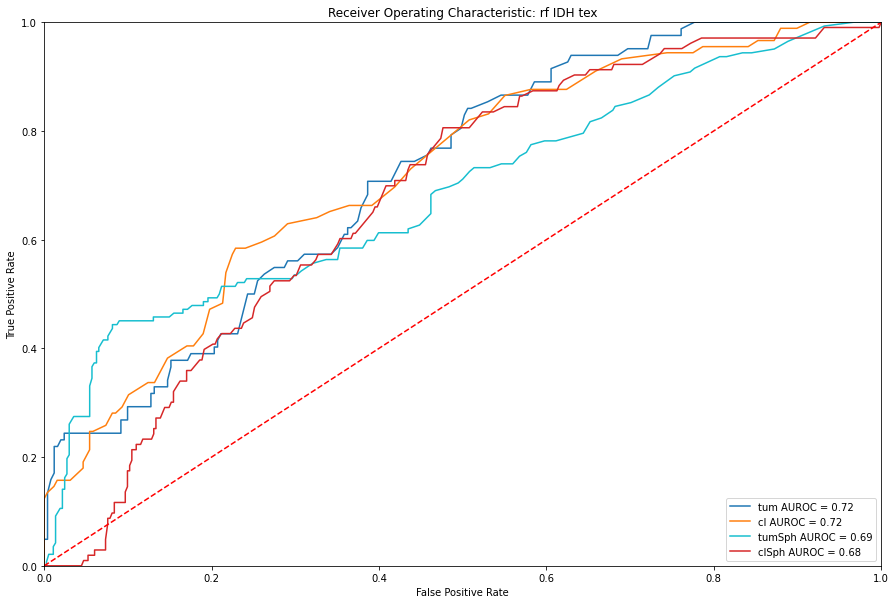

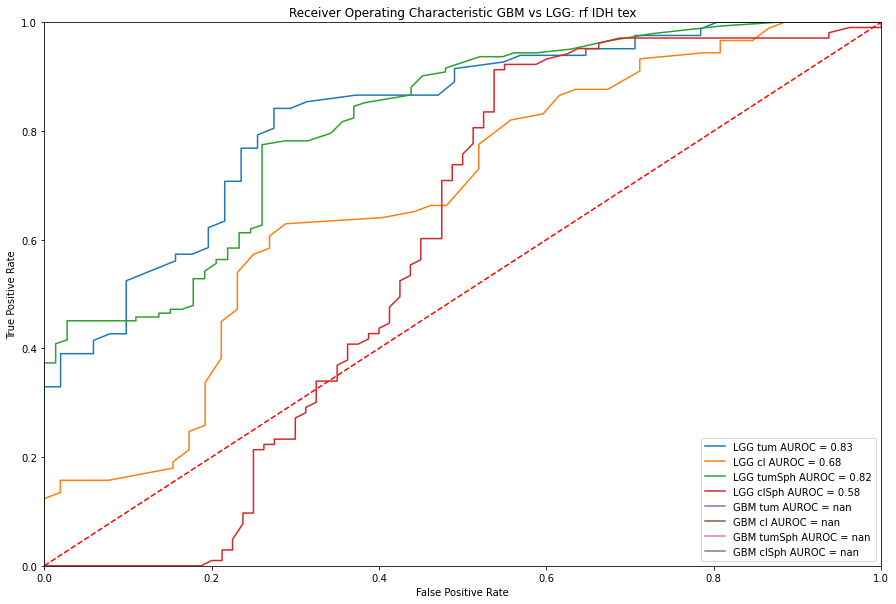

In [121]:
fprGGDict = {}
tprGGDict = {}
aucGGDict = {}
for pMode in fTypes:
    expLbl = '%s_%s_%s_%s' % (classifier,yCol,pMode,expT)
    print('%s: %s' %(expLbl, datetime.now().isoformat(timespec='minutes')))
    cData = fullData[fullData['sl_rank_%s' % pMode] <=10].copy()
    fCols = fullData.columns
    REPat = '_%s$' % pMode 
    cCols = [col for col in fCols if bool(re.search(REPat,col)) and col != 'sl_rank_%s' % pMode]
    if expT != 'cmb': # pick only feature columns of a specific type
        cCols = [col for col in cCols if col in cNamesDict[expT]]
    filtData = cData[cCols]
    # filtData

    # rfeMod = RandomForestClassifier(n_jobs=-1, class_weight='balanced', max_depth=5,random_state=random_seed)


    rfc = RandomForestClassifier(random_state=random_seed, class_weight='balanced')
    trMask = np.logical_and(np.isin(cData['patient'],trainIDs),np.isin(cData[yCol],[0,1]))

    # train_id =  pd.to_numeric(data_train['patient'], errors='coerce')
    dataTrain = filtData.loc[trMask].copy()

    trainID,cPIDs =  pd.factorize(cData['patient'].loc[trMask])
    trainY = cData.loc[trMask][yCol] == 1
    # print(trainY.shape)

    # dataFiltered = dataTrain.filter(items=(features_selected))
    dataFiltered = dataTrain
    dataFiltered = dataFiltered.dropna(axis = 0,how = 'all',subset=cCols) # filter nans
    dataFiltered = dataFiltered.fillna(0)
    # print(dataFiltered.shape)
    if classifier == 'rf':
        # define the grid to search
        estimator_grid = random_grid()

        # k-fold split
        kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
        kfSp = kf.split(dataFiltered,trainY, groups = trainID)
        estimator = RandomizedSearchCV(estimator = rfc,
                                   param_distributions = estimator_grid, scoring = 'roc_auc',
                                   n_iter = 100, cv = kfSp, verbose=2, random_state=random_seed, n_jobs = -1)

        estimator.fit(dataFiltered,trainY)
    elif classifier == 'logreg':
        estimator_instance = LogisticRegression(random_state = random_seed*2, 
                                                max_iter = 500,# increased max iter count
                                                solver='liblinear') 
        estimator_grid = Logreg_grid()

        kf = StratifiedKFold(n_splits=5,random_state = random_seed,shuffle = True) #5-fold cross-validation
        kfSp = kf.split(dataFiltered,trainY, groups = trainID)

        estimator = GridSearchCV(
            estimator = estimator_instance, 
            param_grid = estimator_grid,
            scoring = 'roc_auc',
            #cv = logo.split(train_val_features_df, train_val_1p19q, groups = train_val_id),
            cv = kfSp,
            verbose=2,
            refit = True,
            n_jobs = -1)

        estimator.fit(dataFiltered,trainY)

    bestEst = estimator.best_estimator_
    predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)
    yTrue = trainY.values.reshape([-1,1])
    organize_result(trRes, expLbl, yTrue, predProbs)

    ## Test Dataset
    #     tsMask = (np.isin(cData['patient'],testIDs))
    fprGGDict[pMode] = {}
    tprGGDict[pMode] = {}
    aucGGDict[pMode] = {}
    for gbmMode in [0,1,-1]:
        if gbmMode != -1:
            gbmMask = np.isin(cData['patient'],patient_GBM[patient_GBM[:,1]==gbmMode,0])
    #         print(pd.value_counts(gbmMask,dropna=False))

            tsMask = np.logical_and(np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1])),
                                    gbmMask)
        else:
            tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]))
        dataTest = filtData.loc[tsMask].copy()

        testY = cData.loc[tsMask][yCol] == 1
        # data_filtered = dataTest.filter(items=(features_selected))
        dataFiltered = dataTest
        predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

        fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
        roc_auc = metrics.auc(fpr, tpr)
        yTrue = testY.values.reshape([-1,1])
        
        if gbmMode != -1:
            fprGGDict[pMode][gbmMode] = fpr
            tprGGDict[pMode][gbmMode] = tpr
            aucGGDict[pMode][gbmMode] = roc_auc
            organize_result(tsRes, '%s_%s' % (gbmMode,expLbl), yTrue, predProbs)
        else:
            organize_result(tsRes, expLbl, yTrue, predProbs)
    
    # save for combined plot
    fprDict[pMode] = fpr
    tprDict[pMode] = tpr
    aucDict[pMode] = roc_auc

    if classifier == 'rf':
        importances = pd.Series(bestEst.feature_importances_, index=cCols)
    else:
        importances = pd.Series(bestEst.coef_.flatten(), index=cCols)
    importances = importances.sort_values(ascending=False)
    impDict[pMode] = importances.copy()

    organize_result(tsRes, expLbl, yTrue, predProbs)

# plotting AUROC
f, ax = plt.subplots(figsize=(15, 10))
plt.title('Receiver Operating Characteristic: %s %s %s' % (classifier,yCol,expT))
for key in fprDict.keys():
#         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.plot(fprDict[key], tprDict[key],colDict[key], label = '%s AUROC = %0.2f' % (key,aucDict[key]))
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()
plt.savefig(os.path.join(outImDir,'AUROC_%s_%s_%s.png' % (classifier,yCol,expT)))


f, ax = plt.subplots(figsize=(15, 10))
plt.title('Receiver Operating Characteristic GBM vs LGG: %s %s %s' % (classifier,yCol,expT))
for gbmMode in [0,1]:
    for key in fprDict.keys():
#         plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    
        if gbmMode == 1:
            gbmStr = 'GBM'
        else:
            gbmStr = 'LGG'
        plt.plot(fprGGDict[key][gbmMode], tprGGDict[key][gbmMode], label = '%s %s AUROC = %0.2f' % 
                 (gbmStr,key,aucGGDict[key][gbmMode]))
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()
plt.savefig(os.path.join(outImDir,'AUROC_LGGvGBM_%s_%s_%s.png' % (classifier,yCol,expT)))

    

# gbmMask = np.logical_and(np.isin(cData['patient'],patient_GBM[patient_GBM[:,1]==1,0]))
# print(pd.value_counts(gbmMask,dropna=False))

# tsMask = np.logical_and(np.isin(cData['patient'],testIDs),np.isin(cData[yCol],[0,1]),gbmMask)
# dataTest = filtData.loc[tsMask].copy()

# testY = cData.loc[tsMask][yCol] == 1
# # data_filtered = dataTest.filter(items=(features_selected))
# dataFiltered = dataTest
# predProbs = bestEst.predict_proba(dataFiltered)[:,1].reshape(-1,1)

# fpr, tpr, threshold = metrics.roc_curve(testY, predProbs)
# roc_auc = metrics.auc(fpr, tpr)

# yTrue = testY.values.reshape([-1,1])

TCGA-02-0009
Resizing template from:  (91, 109, 91)  to  (240, 240, 155)
.\TCGA-02-0009


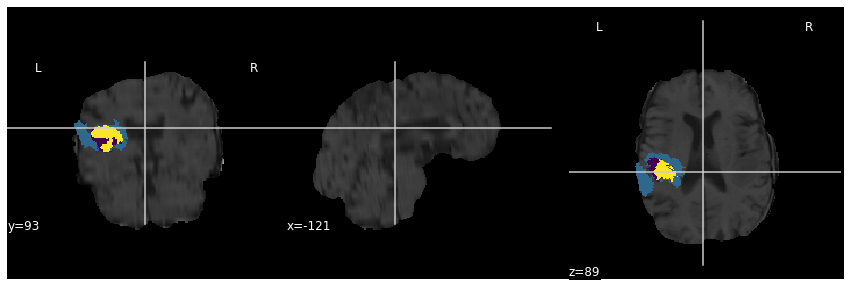

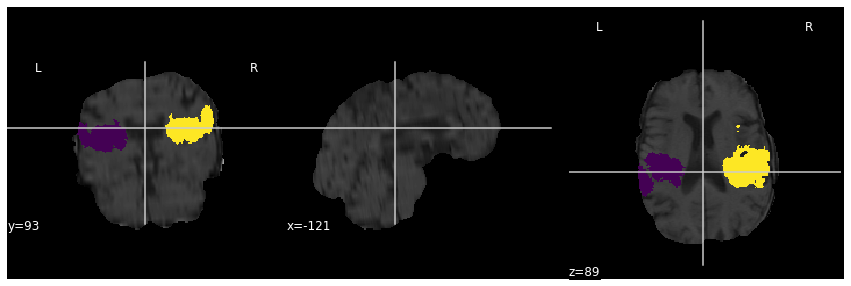

TCGA-06-0184
.\TCGA-06-0184


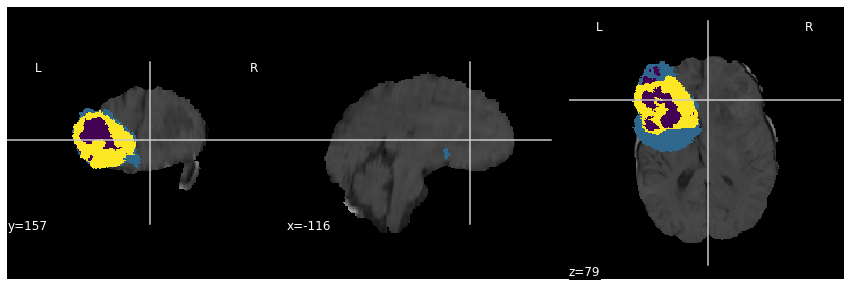

overlapping labels
980 235280
0.0041652499149948995


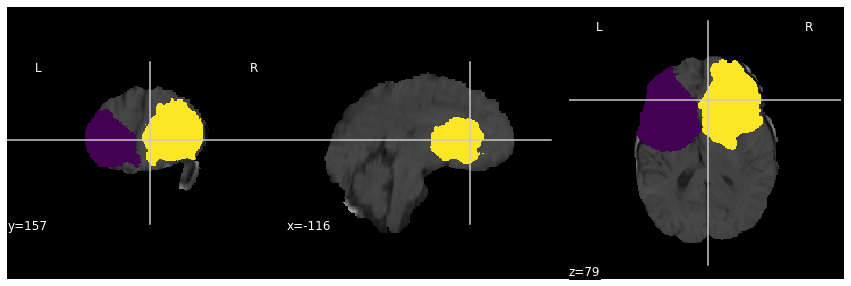

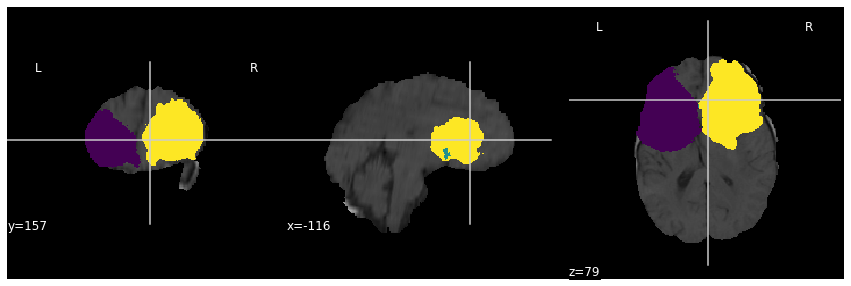

TCGA-02-0047
.\TCGA-02-0047


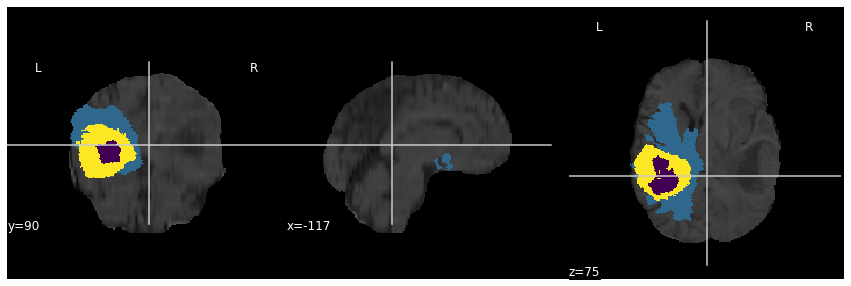

overlapping labels
460 439360
0.001046977421704297


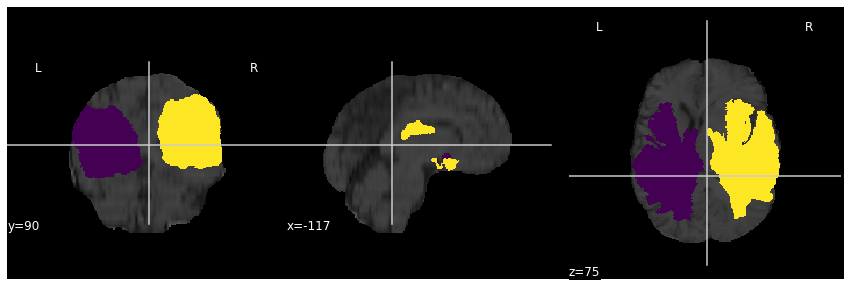

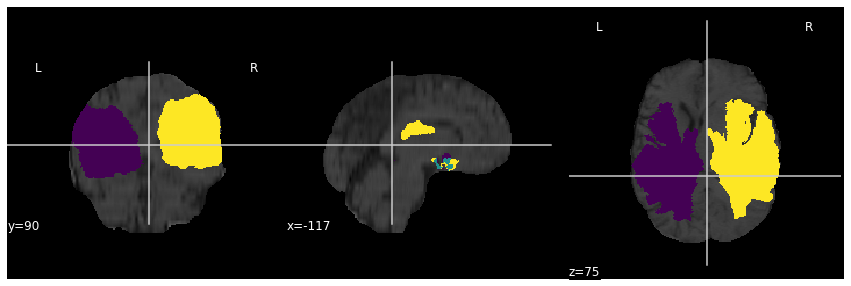

TCGA-DU-7008
.\TCGA-DU-7008


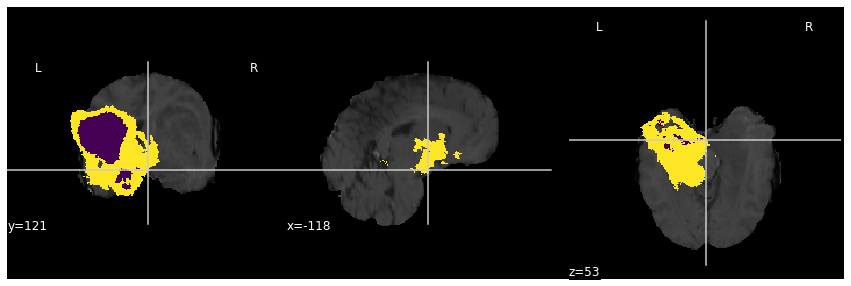

overlapping labels
8099 363259
0.02229538703789858


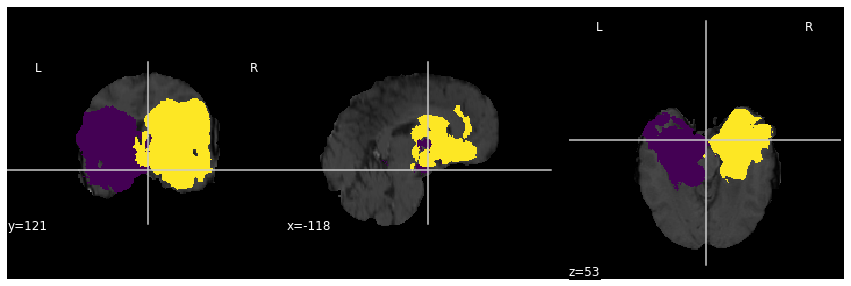

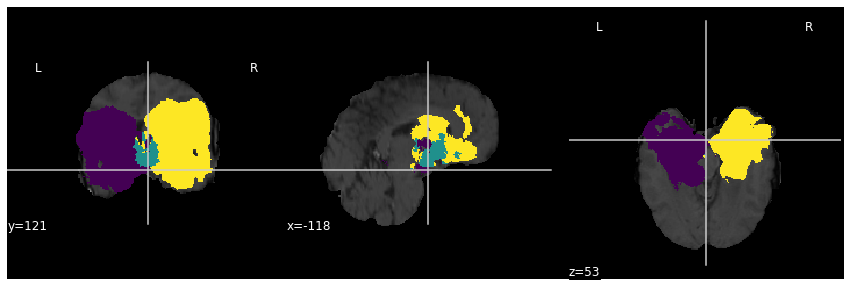

In [51]:
orig_template = datasets.load_mni152_template()
template_img = orig_template
# orig_zooms = orig_template.header.get_zooms()[:3]
rerunAffine = False
for pNo in [1,30, 8, 97]:
    pDir = patients[pNo]
    cDir = os.path.join(imagedir,pDir)
    cNIIFile = os.path.join(cDir,'t1.nii.gz')
    if not os.path.exists(cNIIFile):
        continue
    TCGA_ID = os.path.basename(pDir)
    print('%s' % TCGA_ID)

    moving_img = nib.load(cNIIFile)
    if template_img.shape != moving_img.shape:
        print('Resizing template from: ', template_img.shape, ' to ', moving_img.shape)
        template_img = resize_template(orig_template,moving_img)
    print(pDir)    
    cLblFile = os.path.join(cDir,'truth.nii.gz')
    if not os.path.exists(cLblFile):
        continue
    label_img = nib.load(cLblFile)
    label_arr = label_img.get_fdata().astype(np.float64)
    moving_arr2 = deepcopy(moving_img.get_fdata())
    bMask = np.logical_and(moving_arr2 > 0,label_arr == 0)
    medianVal = np.median(moving_arr2[bMask])
    moving_arr2[np.where(label_arr>0)] = medianVal

    
    # run the multi-step registration (mri_reg.py)
    cTrMapFile = os.path.join(cDir,'affine_map_2.pkl')
    if rerunAffine or not os.path.isfile(cTrMapFile):
        (affine,_) = ms_affreg(moving_img2,template_img=template_img,reg_type=3)
        f = open(cTrMapFile,"wb")
        pickle.dump(affine,f)
        f.close()
    else:
        f = open(cTrMapFile, 'rb')
        affine = pickle.load(f)
        f.close()

    
    transformed = affine.transform(moving_img.get_fdata(),interp = 'nearest')
    transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
    
    
    # contralateral side of tumor

    tr_label = np.round(affine.transform(label_arr,interp = 'nearest'),decimals=0)


    refl_x_aff_arr = nib.affines.from_matvec(np.diag([-1, 1, 1]), [0,0,0])
    refl_x_affine = AffineMap(refl_x_aff_arr,
                           tr_label.shape, template_img.affine,
                           tr_label.shape, template_img.affine)

    refl_label = np.round(refl_x_affine.transform(tr_label,interp = 'nearest'),decimals=0)


#     cent_coords = nib.affines.apply_affine(-np.linalg.inv(affine.affine),(0,0,0))
    contr_label = affine.transform_inverse(refl_label,image_grid2world=template_img.affine,
                                           sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape,
                                          interp = 'nearest')
    contr_label = contr_label.astype(int)
    contr_label_nib = nib.nifti1.Nifti1Image(contr_label,moving_img.affine,header=moving_img.header)
    label_nib = nib.nifti1.Nifti1Image(label_arr.copy() ,moving_img.affine,header=moving_img.header)
    contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=None)
    label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
#     print(contr_xyz,label_xyz)
    cent_coords = np.add(contr_xyz,label_xyz) /2
    f, ax = plt.subplots(figsize=(15, 5))
    pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
    pl_anat.add_overlay(contr_label_nib)
#     pl_anat.add_overlay(label_nib)
    plt.show()
        
    tum_arr = np.logical_and(label_arr,moving_img.get_fdata() > 0) # exclude regions outside of brain mask
    cl_arr = np.logical_and(contr_label,moving_img.get_fdata() > 0) # exclude regions outside of brain mask
    
    tum_cl_iou = np.count_nonzero(np.logical_and(tum_arr,cl_arr))/np.count_nonzero(np.logical_or(tum_arr,cl_arr))

    stopRun = False
    if np.sum(np.logical_and(contr_label>=1,label_arr>=1)) > 0:
        print('overlapping labels')
        print(np.count_nonzero(np.logical_and(tum_arr,cl_arr)),np.count_nonzero(np.logical_or(tum_arr,cl_arr)))
        print(tum_cl_iou)
        if tum_cl_iou > 0.05: # 5% threshold
            print('very overlapping labels')
            stopRun = True
            for ftType in ('tex','cnn','tda'):
                save_str = ('%s_%s.csv' % (ftType,'feats'))
                save_fname = os.path.join(cDir,save_str)
                if os.path.isfile(save_fname):
                    print('deleting %s' % save_fname)
                    os.remove(save_fname)
                
                
    if stopRun:
        continue
    clnt_arr =  np.logical_and(cl_arr,np.logical_not(tum_arr)) # exclude tumor region from contralateral side
    
    contr_label_nib = nib.nifti1.Nifti1Image(clnt_arr + tum_arr*3,moving_img.affine,header=moving_img.header)
#     label_nib = nib.nifti1.Nifti1Image(tum_arr ,moving_img.affine,header=moving_img.header)
    f, ax = plt.subplots(figsize=(15, 5))
    pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
    pl_anat.add_overlay(contr_label_nib)
#     pl_anat.add_overlay(label_nib)
    plt.show()
    if tum_cl_iou > 0:
        ov_arr =  np.logical_and(cl_arr,tum_arr)
        tumnt_arr =  np.logical_and(np.logical_not(cl_arr),tum_arr)
        contr_label_nib = nib.nifti1.Nifti1Image(clnt_arr + tumnt_arr*3 + ov_arr * 2,moving_img.affine,header=moving_img.header)
    #     label_nib = nib.nifti1.Nifti1Image(tum_arr ,moving_img.affine,header=moving_img.header)
        f, ax = plt.subplots(figsize=(15, 5))
        pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
        pl_anat.add_overlay(contr_label_nib)
    #     pl_anat.add_overlay(label_nib)
        plt.show()

In [36]:
[i  for i in range(len(patients)) if ('TCGA-DU-7008' in patients[i])]

[97]

135746 187841
7938 315649
0.025148186751740065


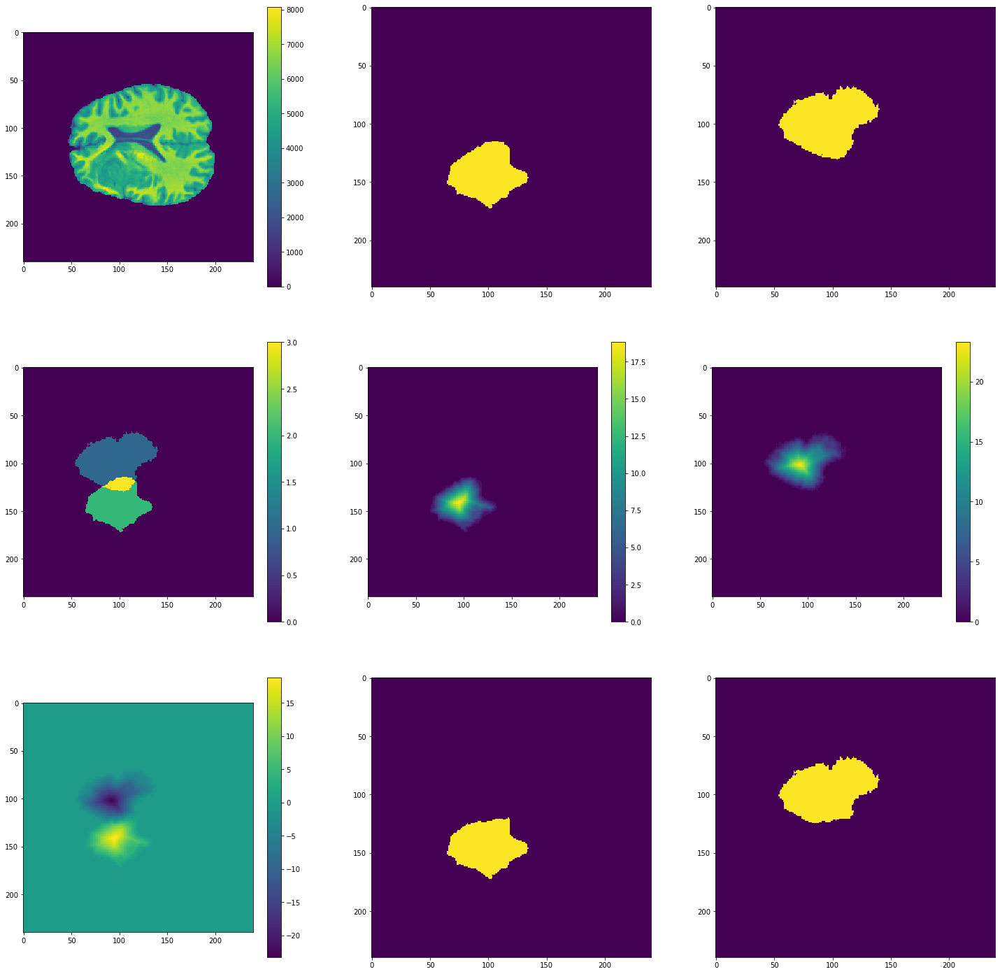

In [48]:
from scipy.ndimage import morphology

cl_arr = np.logical_and(contr_label > 0,moving_img.get_data() > 0) # exclude regions outside of brain mask
cl_dist = morphology.distance_transform_edt(cl_arr)
tum_arr = np.logical_and(label_arr > 0,moving_img.get_data() > 0) # exclude regions outside of brain mask
tum_dist = morphology.distance_transform_edt(tum_arr)

d_dist = tum_dist- cl_dist
print(np.count_nonzero(tum_arr), np.count_nonzero(cl_arr))
print(np.count_nonzero(np.logical_and(tum_arr,cl_arr)),np.count_nonzero(np.logical_or(tum_arr,cl_arr)))
print(np.count_nonzero(np.logical_and(tum_arr,cl_arr))/np.count_nonzero(np.logical_or(tum_arr,cl_arr)))

zi = 87
fig2 = plt.figure(figsize=(25,25))
ax2 = fig2.add_subplot(331)
plt.imshow(moving_img.get_data()[:,:,zi])
plt.colorbar()
ax2 = fig2.add_subplot(332)
plt.imshow(tum_arr[:,:,zi])
# plt.colorbar()
ax2 = fig2.add_subplot(333)
plt.imshow(cl_arr[:,:,zi])
# plt.colorbar()
ax2 = fig2.add_subplot(334)
plt.imshow(tum_arr[:,:,zi] * 2 + cl_arr[:,:,zi])
plt.colorbar()

ax2 = fig2.add_subplot(335)
plt.imshow(tum_dist[:,:,zi])
plt.colorbar()
ax2 = fig2.add_subplot(336)
plt.imshow(cl_dist[:,:,zi])
plt.colorbar()
ax2 = fig2.add_subplot(337)
plt.imshow(d_dist[:,:,zi])
plt.colorbar()
ax2 = fig2.add_subplot(338)
plt.imshow(np.logical_and(tum_arr[:,:,zi],d_dist[:,:,zi]> 0))
# plt.colorbar()
ax2 = fig2.add_subplot(339)
plt.imshow(np.logical_and(cl_arr[:,:,zi],d_dist[:,:,zi]< 0))
# plt.colorbar()

plt.show()

[-91.88929945736373, 118.10080957126698, 82.13698513609936] [-137.2025855065365, 146.44679576900563, 93.50766547028651]
[-114.54594248  132.27380267   87.8223253 ]


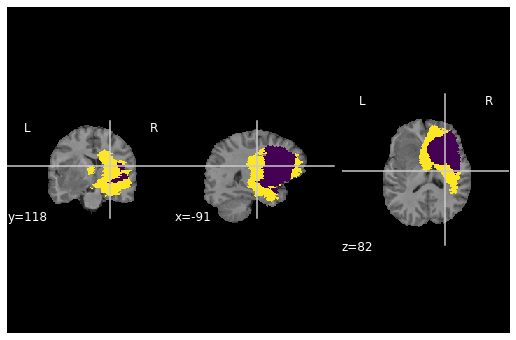

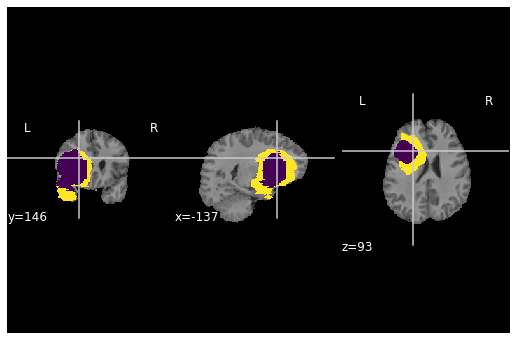

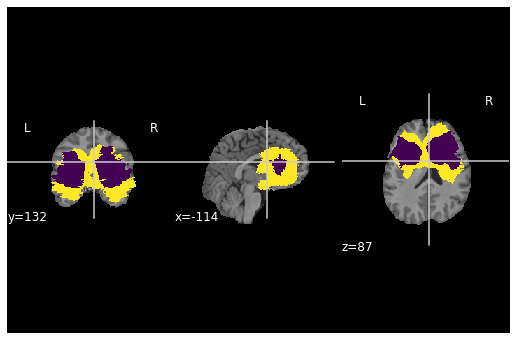

In [23]:
contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=None)
label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
print(contr_xyz,label_xyz)
cent_coords = np.add(contr_xyz,label_xyz) /2
print(cent_coords)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=contr_xyz)
pl_anat.add_overlay(contr_label_nib)
# pl_anat.add_overlay(label_img)
plt.show()


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=label_xyz)
# pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=cent_coords)
pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

In [12]:
# pDir = ".\TCGA-HT-8111"
cDir = os.path.join(imagedir,pDir)
cNIIFile = os.path.join(cDir,'t1.nii.gz')
TCGA_ID = os.path.basename(pDir)
print('%s' % TCGA_ID)

moving_img = nib.load(cNIIFile)
if template_img.shape != moving_img.shape:
    print('Resizing template from: ', template_img.shape, ' to ', moving_img.shape)
    template_img = resize_template(orig_template,moving_img)
print(pDir)

cLblFile = os.path.join(cDir,'truth.nii.gz')
label_img = nib.load(cLblFile)
label_arr = label_img.get_data().astype(np.float64)
moving_arr2 = moving_img.get_data()
label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
bMask = np.logical_and(moving_arr2 > 0,label_arr == 0)
medianVal = np.median(moving_arr2[bMask])
moving_arr2[np.where(label_arr>0)] = medianVal
# run the multi-step registration (mri_reg.py)
# (affine,_) = ms_affreg(moving_img,template_img=template_img)
moving_img2 = nib.nifti1.Nifti1Image(moving_arr2,moving_img.affine,header=moving_img.header)
(rigid,_) = ms_affreg(moving_img2,template_img=template_img,reg_type=2)


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=label_xyz)
pl_anat.add_overlay(label_img)
plt.show()


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img2,axes=ax,cut_coords=label_xyz)
# pl_anat.add_overlay(label_img)
plt.show()




transformed = rigid.transform(moving_img.get_data(),interp = 'nearest')
transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)

tr_label = np.round(rigid.transform(label_arr,interp = 'nearest'),decimals=0)

refl_x_aff_arr = nib.affines.from_matvec(np.diag([-1, 1, 1]), [0,0,0])
refl_x_affine = AffineMap(refl_x_aff_arr,
                       tr_label.shape, template_img.affine,
                       tr_label.shape, template_img.affine)

refl_label = np.round(refl_x_affine.transform(tr_label,interp = 'nearest'),decimals=0)
# print(refl_label)
#     regtools.overlay_slices(template_img.get_data(), refl_label, None, 2,
#                             "Transformed T1", "Contralateral Label")
transf_label_nib = nib.nifti1.Nifti1Image(tr_label,template_img.affine,header=moving_img.header)
refl_label_nib = nib.nifti1.Nifti1Image(refl_label,template_img.affine,header=moving_img.header)

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
pl_anat.add_overlay(transf_label_nib)
plt.show()

TCGA-02-0006
.\TCGA-02-0006
Translation Registration (1/2)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]
Rigid Registration (2/2)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 75]


KeyboardInterrupt: 

In [2]:
mov_arr = np.float32(moving_img.get_data()) 
modal = 'T1'
img = {}
img[modal] = mov_arr
# print(mov_arr.shape)
brain_mask = img[modal] > 0
brain_mask_nt = np.logical_and(brain_mask, np.logical_not(np.logical_or(label_arr,contr_label )))
brain_mask_nib = nib.nifti1.Nifti1Image(brain_mask_nt*1,moving_img.affine,header=moving_img.header)

contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=None)
label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
# print(contr_xyz,label_xyz)
cent_coords = np.add(contr_xyz,label_xyz) /2


f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(brain_mask_nib,axes=ax,cut_coords=cent_coords)
# pl_anat.add_overlay(contr_label_nib)
# pl_anat.add_overlay(label_img)
plt.show()


NameError: name 'np' is not defined

In [3]:
from radiomics import featureextractor
import SimpleITK as sitk


#load the parameters for extractor
param_path = os.path.join(origdir,'texture_settings.yaml')
import pkg_resources
pyrad_ver = pkg_resources.parse_version(pkg_resources.get_distribution("pyradiomics").version)
# print(pyrad_ver > pkg_resources.parse_version("2.1.2"))
if pyrad_ver >= pkg_resources.parse_version("2.1.2"):
    # changed the name of the feature extractor some time between 2.1.0 and 2.1.2
    extractor = featureextractor.RadiomicsFeatureExtractor(param_path)
else:
    extractor = featureextractor.RadiomicsFeaturesExtractor(param_path)
#     extractor.loadParams(param_path)


NameError: name 'os' is not defined

In [4]:
img = {modal:[] for modal in modal_list} 
min_size = 10

for modal in modal_list:
    ml = modal.lower()
    cNIIFile = os.path.join(cDir,modal_dict[ml])
    #load image
    if not os.path.exists(cNIIFile):
        img[modal] = []
        continue
    cImg = nib.load(cNIIFile)
    # put array into single precision, or else the downstream pyradiomics freaks out
    cArr = np.float32(cImg.get_data())

    brain_mask = cArr > 0
    brain_mask_nt = np.logical_and(brain_mask, np.logical_not(np.logical_or(label_arr,contr_label )))
    median = np.median(cArr[brain_mask_nt])
    curr_iqr = iqr(cArr[brain_mask_nt])
    cArrNorm = deepcopy(cArr)
    cArrNorm =  (cArrNorm-median)/curr_iqr

    img[modal] = cArrNorm


#         cArrNorm_nib = nib.nifti1.Nifti1Image(img[modal],moving_img.affine,header=moving_img.header)

#         f, ax = plt.subplots(figsize=(9, 6))
#         pl_anat = plotting.plot_anat(cArrNorm_nib,axes=ax,cut_coords=cent_coords)
#         plt.show()


feat_suffix = '_' + label_type
data_spacing = label_img.header['pixdim'][1:4]
mask = (label_arr >= 1) * 1

# TLijk = np.argwhere(mask == 1)
# if TLijk.shape[1] == 2: # in case the mask array is a slice instead of a proper volume
#     TLijk = np.pad(TLijk,(0,1),'constant', constant_values=(0)) 
# print(np.unique(TLijk[:,2]))
# slice_vec = np.unique(TLijk[:,2])
mask_ct = np.sum(mask,axis=(0,1))
slice_vec = np.argwhere(mask_ct >= min_size).flatten()
n_slices = len(slice_vec)



features = {}
for modal in modal_list:
    features[modal] = {}
    if len(img[modal]) == 0:
        continue
    # [n_slices, x_dim, y_dim, views]
    dim = img[modal].shape
    if len(dim)>=3:
        n_slices = len(slice_vec)
    else:
        n_slices = 1

    for slI in range(n_slices):
        slice_ind = slice_vec[slI]
        features[modal][slI] = {}

        # for view_ind in range(len(views)):
            # pick slice and view
        mask_orig = mask[:,:,slice_ind] == 1
        if np.sum(mask_orig,axis=(0,1)) < min_size:
            features[modal][slI]['z']=[] # should be caught earlier
            continue
        # crop the image
        B = np.argwhere(mask_orig)
        (xstart_x, ystart_x), (xstop_x, ystop_x) = B.min(0), B.max(0) + 1  

        if (xstop_x-xstart_x <= 1) or (ystop_x-ystart_x <= 1):
            features[modal][slI]['z']=[]
            continue 
        #convert numpy array into sitk
        img_slice = img[modal][xstart_x:xstop_x, ystart_x:ystop_x,slice_ind]
        mask_slice = mask[xstart_x:xstop_x, ystart_x:ystop_x,slice_ind]

        sitk_img = sitk.GetImageFromArray(img_slice) 
        sitk_img.SetSpacing((float(data_spacing[0]), float(data_spacing[1]), float(data_spacing[2]) ))
        sitk_img = sitk.JoinSeries(sitk_img)

        sitk_mask = sitk.GetImageFromArray(mask_slice)
        sitk_mask.SetSpacing((float(data_spacing[0]), float(data_spacing[1]), float(data_spacing[2]) ))
        sitk_mask = sitk.JoinSeries(sitk_mask)
        sitk_mask = sitk.Cast(sitk_mask, sitk.sitkInt32)

        features[modal][slI]['z']=extractor.execute(sitk_img, sitk_mask)
    
    # obtain feature names
    for i in range(len( features[modal_list[0]])):
        featList =  features[modal_list[0]][i]['z']
        if len(featList)>0:
            break
    feature_names = list(sorted(filter ( lambda k: k.startswith("original_"),featList)))

    feature_names_all = []

for modal in modal_list:
    feature_names_all.append([elemt + '_'+ modal + feat_suffix for elemt in feature_names])

feature_names_all_flattened = [val for sublist in feature_names_all for val in sublist]

# remove "original_"
feature_names_all_flattened = [elmt[9:] for elmt in feature_names_all_flattened]

print('number of %s features = %i' % (modal, len(feature_names_all_flattened)))

#Make a numpy array of all the values
samples = np.zeros( (n_slices, len(feature_names)*len(modal_list) ) )
for slI in range(n_slices):
    a = np.array([])

    for modal in modal_list:

        for feature_name in feature_names:
            try:
                if features[modal][slI]['z']:
                    newFeat = features[modal][slI]['z'][feature_name]
                else:
                    newFeat = np.nan
            except KeyError:
                #print ('I got a KeyError - %s' % str(feature_name))
                newFeat = np.nan
            a = np.append(a, newFeat) 
        samples[slI,:] = a

NameError: name 'os' is not defined

[-153.42504090832955, 92.0261474890045, 87.46157346379366] [-87.07232821104802, 94.98072204751645, 92.92982458749555]


C:\Users\ncwang\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\ma\core.py:2784: UserWarning: Warning: converting a masked element to nan.
  order=order, subok=True, ndmin=ndmin)


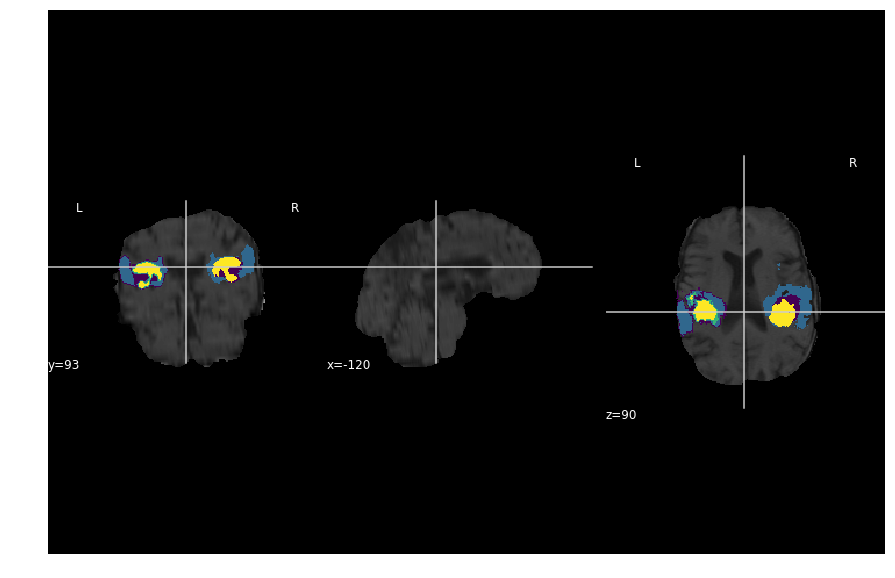

In [28]:
# comb_label = np.add(contr_label_nib.get_data().astype(int),label_img.get_data().astype(int))
# comb_label_nib = nib.nifti1.Nifti1Image(comb_label,moving_img.affine,header=moving_img.header)
# f, ax = plt.subplots(figsize=(15, 10))
# pl_anat = plotting.plot_anat(comb_label_nib,axes=ax,cut_coords=xyz)
# plt.show()
contr_label = contr_label.astype(int)
contr_label_nib = nib.nifti1.Nifti1Image(contr_label,moving_img.affine,header=moving_img.header)
    
contr_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=contr_label_nib, activation_threshold=None)
label_xyz = plotting.find_xyz_cut_coords(moving_img, mask_img=label_img, activation_threshold=None)
print(contr_xyz,label_xyz)
xyz = np.add(contr_xyz,label_xyz) /2

f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords=xyz)
pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

In [8]:
cAffFile = os.path.join(cDir,'affine_map.pkl')
f = open(cAffFile,"wb")
pickle.dump(affine,f)
f.close()
f = open(cAffFile,"rb")
temp = pickle.load(f)
f.close()
print(affine,temp)
print(type(affine),type(temp))
# np.save(affine,cAffFile)

[[ 7.53614909e-01 -1.85701194e-03 -5.52044214e-02 -1.19005857e+02]
 [-1.33795126e-02  8.04148752e-01 -1.88608361e-01  1.26313406e+02]
 [ 8.34814690e-02  1.68946615e-01  9.54444203e-01  6.89814616e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]] [[ 7.53614909e-01 -1.85701194e-03 -5.52044214e-02 -1.19005857e+02]
 [-1.33795126e-02  8.04148752e-01 -1.88608361e-01  1.26313406e+02]
 [ 8.34814690e-02  1.68946615e-01  9.54444203e-01  6.89814616e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
<class 'dipy.align.imaffine.AffineMap'> <class 'dipy.align.imaffine.AffineMap'>


In [111]:
(affine,template_img_out) = ms_affreg(moving_img,template_img=template_img)
print(affine,template_img_out)

Translation Registration (1/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 100]
Rigid Registration (2/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 100]
Affine Registration (3/3)
Optimizing level 2 [max iter: 250]
Optimizing level 1 [max iter: 150]
Optimizing level 0 [max iter: 100]
[[   1.            0.            0.         -709.35803832]
 [   0.            1.            0.          818.39285058]
 [   0.            0.            1.          606.2855933 ]
 [   0.            0.            0.            1.        ]] <class 'nibabel.nifti1.Nifti1Image'>
data shape (182, 218, 182)
affine: 
[[  -1.    0.    0.   90.]
 [   0.    1.    0. -126.]
 [   0.    0.    1.  -72.]
 [   0.    0.    0.    1.]]
metadata:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular    

In [12]:
orig_template.shape != moving_img.shape

True

In [118]:
print(template_img.get_data().max(),orig_template.get_data().max())

8339 8339


TCGA-02-0006


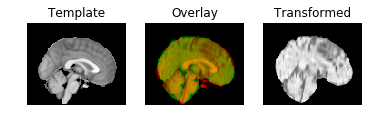

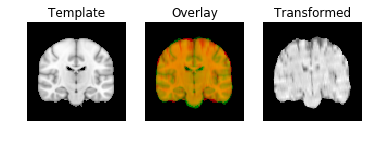

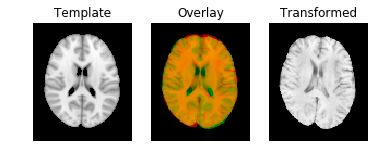

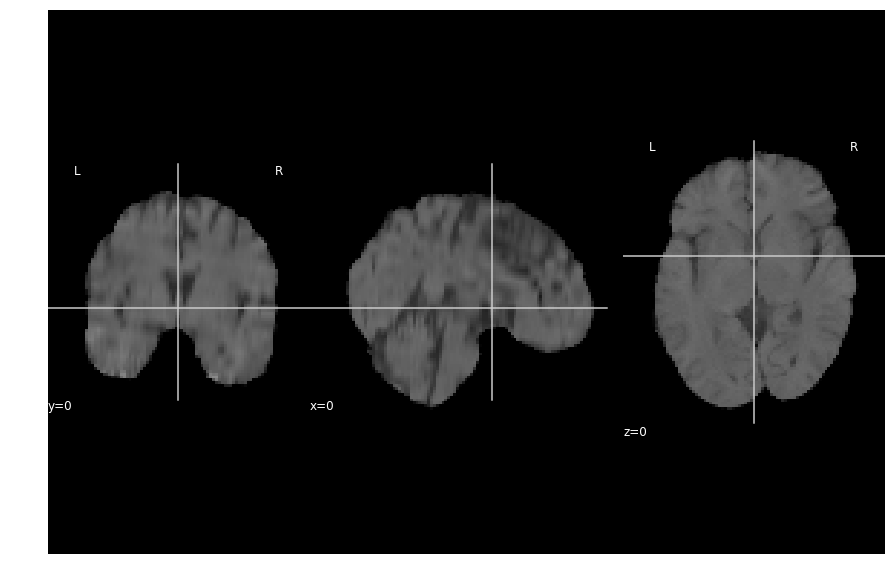

C:\Users\ncwang\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\ma\core.py:2784: UserWarning: Warning: converting a masked element to nan.
  order=order, subok=True, ndmin=ndmin)


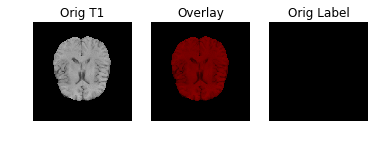

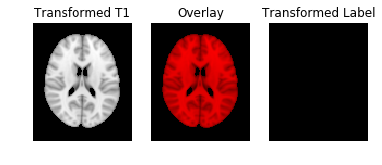

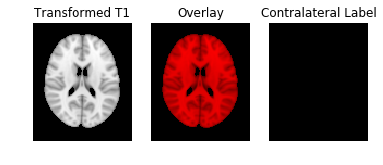

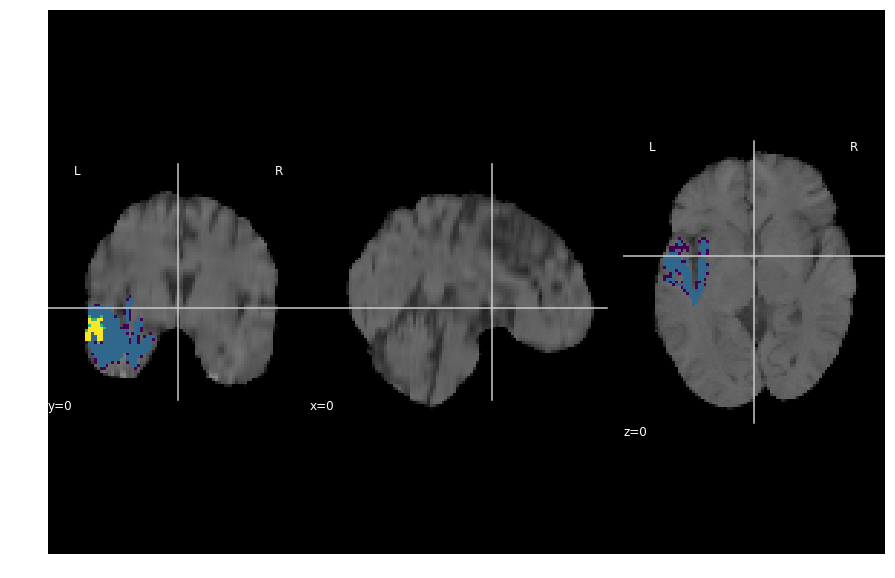

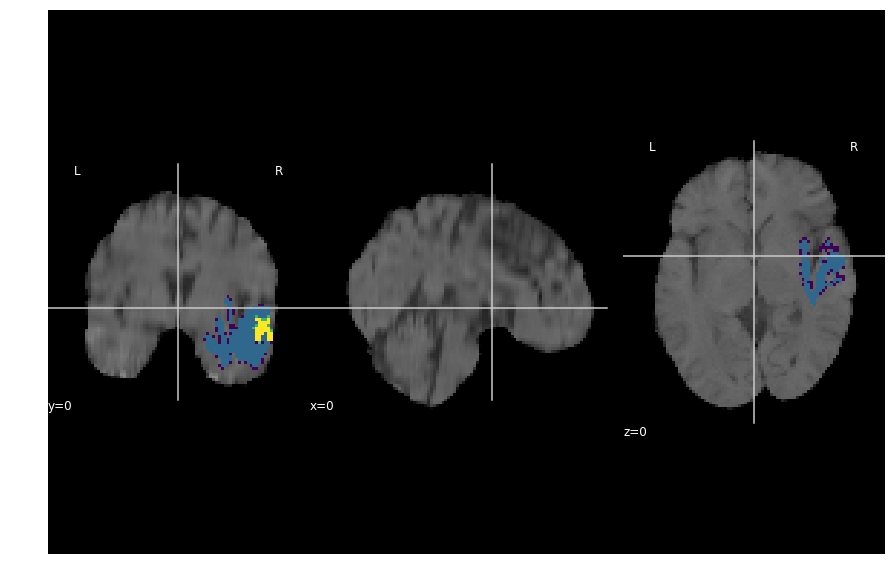

[-118.52027175  133.45164711   58.48263682]


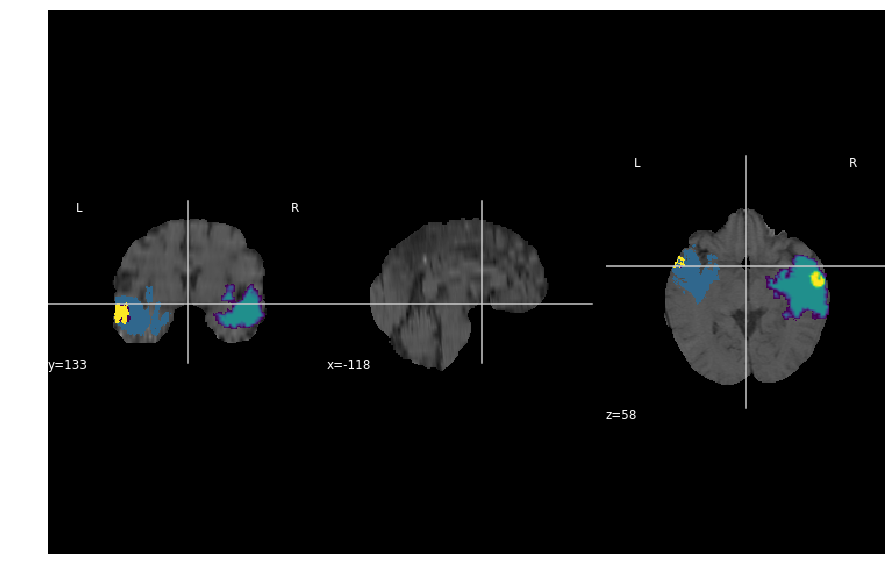

In [144]:
# tr_same_sz = affine.transform(moving_img.get_data(),sampling_grid_shape=moving_img.shape)
# transf_nib = nib.nifti1.Nifti1Image(tr_same_sz,template_img.affine,header=moving_img.header)
transformed = affine.transform(moving_img.get_data())
transf_nib = nib.nifti1.Nifti1Image(transformed,template_img.affine,header=moving_img.header)
# show the sag,cor,axi alignment map
regtools.overlay_slices(template_img.get_data(), transformed, None, 0,
                    "Template", "Transformed")
regtools.overlay_slices(template_img.get_data(), transformed, None, 1,
                        "Template", "Transformed")
regtools.overlay_slices(template_img.get_data(), transformed, None, 2,
                        "Template", "Transformed")

#     print('MNI')
#     f, ax = plt.subplots(figsize=(15, 10))
#     plotting.plot_anat(template_img,axes=ax,cut_coords =(0,0,0))
#     plt.show()
print('%s' % TCGA_ID)
f, ax = plt.subplots(figsize=(15, 10))
plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
plt.savefig(os.path.join(outImDir,'affreg_%s.png' % (TCGA_ID)))
plt.show()

# contralateral side of tumor
cLblFile = os.path.join(cDir,'truth.nii.gz')
label_img = nib.load(cLblFile)
tr_label = np.round(affine.transform(label_img.get_data(),interp='nearest'),decimals=0)
regtools.overlay_slices(moving_img.get_data(), label_img.get_data(), None, 2,
                        "Orig T1", "Orig Label")
regtools.overlay_slices(template_img.get_data(), tr_label, None, 2,
                        "Transformed T1", "Transformed Label")

refl_x_aff_arr = nib.affines.from_matvec(np.diag([-1, 1, 1]), [0,0,0])
refl_x_affine = AffineMap(refl_x_aff_arr,
                       tr_label.shape, template_img.affine,
                       tr_label.shape, template_img.affine)

refl_label = np.round(refl_x_affine.transform(tr_label),decimals=0)
# print(refl_label)
# refl_label = nib.affines.apply_affine(refl_x_affine,tr_label)
regtools.overlay_slices(template_img.get_data(), refl_label, None, 2,
                        "Transformed T1", "Contralateral Label")
transf_label_nib = nib.nifti1.Nifti1Image(tr_label,template_img.affine,header=moving_img.header)
refl_label_nib = nib.nifti1.Nifti1Image(refl_label,template_img.affine,header=moving_img.header)

f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
pl_anat.add_overlay(transf_label_nib)
plt.show()
f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
pl_anat.add_overlay(refl_label_nib)
plt.show()

cent_coords = nib.affines.apply_affine(-np.linalg.inv(affine.affine),(0,0,0))
contr_label = affine.transform_inverse(refl_label,image_grid2world=template_img.affine,
                                       sampling_grid2world=moving_img.affine,sampling_grid_shape = moving_img.shape)
contr_label_nib = nib.nifti1.Nifti1Image(contr_label,moving_img.affine,header=moving_img.header)
print(cent_coords)
f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords =cent_coords)
pl_anat.add_overlay(contr_label_nib)
pl_anat.add_overlay(label_img)
plt.show()

[[   1.01    0.04   -0.06 -117.62]
 [  -0.12    0.9    -0.14  126.31]
 [   0.08    0.21    0.84   68.1 ]
 [   0.      0.      0.      1.  ]]
[[   0.98   -0.06    0.07  118.52]
 [   0.11    1.06    0.19 -133.45]
 [  -0.12   -0.26    1.14  -58.48]
 [   0.      0.      0.      1.  ]]


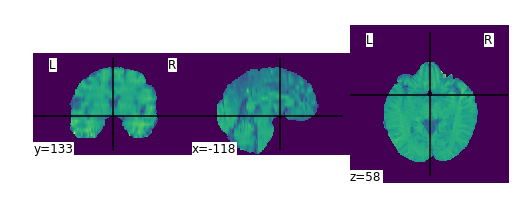

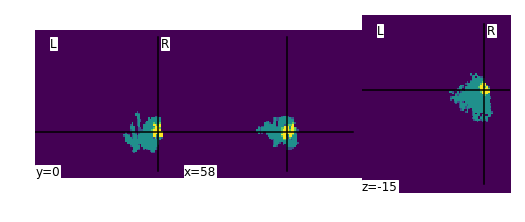

In [142]:
f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords =cent_coords)
pl_anat.add_overlay(contr_label_nib)
plt.show()

In [74]:
def vox_coords(aff_in, i, j, k):
    M = aff_in[:3, :3]
    abc = aff_in[:3, 3]
    """ Return X, Y, Z coordinates for i, j, k """
    return M.dot([i, j, k]) + abc

In [76]:
cent_mov = np.round(np.array(moving_img.shape)/2)
cent_mov_xyz = vox_coords(moving_img.affine,cent_mov[0],cent_mov[1],cent_mov[2])
print(cent_mov,cent_mov_xyz)
temp_mov = np.round(np.array(template_img.shape)/2)
temp_mov_xyz = vox_coords(template_img.affine,temp_mov[0],temp_mov[1],temp_mov[2])
print(temp_mov,temp_mov_xyz)

[120. 120.  78.] [-120.  119.   78.]
[46. 54. 46.] [ -2. -18.  20.]


In [ ]:
from dipy.align.imaffine import (AffineMap,MutualInformationMetric,AffineRegistration,
                                 transform_centers_of_mass,transform_geometric_centers)

transform_geometric_centers(static, static_grid2world, moving, moving_grid2world)

In [128]:
print(affine.codomain_grid2world,affine.codomain_shape)
print(affine.domain_grid2world,affine.domain_shape)

[[ -1.   0.   0.  -0.]
 [  0.  -1.   0. 239.]
 [  0.   0.   1.   0.]
 [  0.   0.   0.   1.]] (240, 240, 155)
[[  -2.    0.    0.   90.]
 [   0.    2.    0. -126.]
 [   0.    0.    2.  -72.]
 [   0.    0.    0.    1.]] (91, 109, 91)


[[ 1.00508761e+00  3.94914285e-02 -6.44006455e-02 -1.17619380e+02]
 [-1.18878739e-01  9.04297667e-01 -1.44601429e-01  1.26312881e+02]
 [ 7.60034797e-02  2.09540801e-01  8.40281807e-01  6.80975077e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[1.00508761 0.90429767 0.84028181]
[1.01494324 0.92909698 0.85506171]
[1. 1. 1.] [2. 2. 2.]
[  90. -126.  -72.] [ 0.5 -0.5  0.5] [2.63736264 2.20183486 1.7032967 ]
[[ -1   0   0 118]
 [  0   1   0 138]
 [  0   0   1 -61]
 [  0   0   0   1]]
[[ -1.   0.   0.  -0.]
 [  0.  -1.   0. 239.]
 [  0.   0.   1.   0.]
 [  0.   0.   0.   1.]]
[[  -2.    0.    0.   90.]
 [   0.    2.    0. -126.]
 [   0.    0.    2.  -72.]
 [   0.    0.    0.    1.]]
[[ 1.00000000e+00  4.36708287e-02 -7.66417231e-02 -1.17619380e+02]
 [-1.18276992e-01  1.00000000e+00 -1.72086826e-01  1.26312881e+02]
 [ 7.56187611e-02  2.31716623e-01  1.00000000e+00  6.80975077e+01]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[0.99493814 0.    

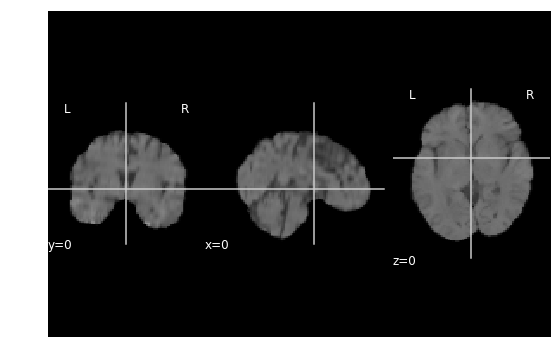

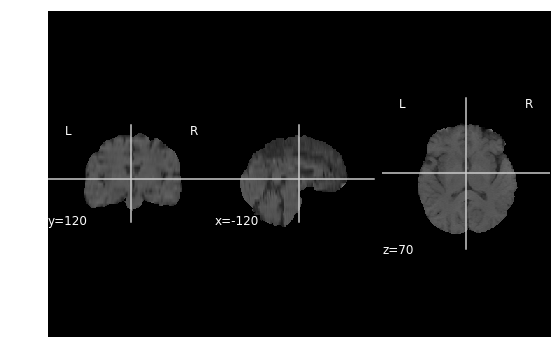

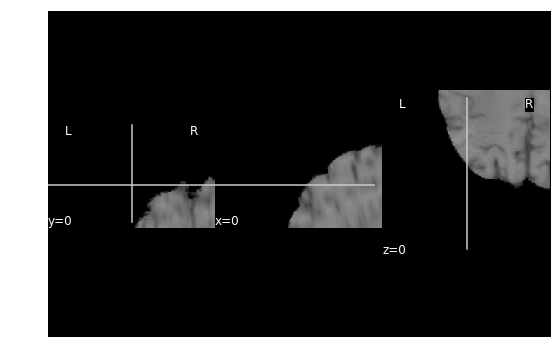

In [148]:
print(affine)
print(np.diag(affine.affine)[0:3])
# print(moving_img.affine,template_img.affine)
print(nib.affines.voxel_sizes(affine.affine))
print(nib.affines.voxel_sizes(moving_img.affine),nib.affines.voxel_sizes(template_img.affine))
scal_mat = nib.affines.from_matvec(np.diag(np.reciprocal(np.diag(affine.affine)[0:3])), [0,0,0])
scal_aff = np.matmul(template_img.affine,scal_mat)
temp_aff = template_img.affine
temp_aff_shift = temp_aff.dot([0, 0, 0, 1])[0:3]
scale_diff = np.divide(np.diag(moving_img.affine)[0:3],np.diag(template_img.affine)[0:3])
size_diff = np.divide(moving_img.shape,template_img.shape)
out_aff_shift = np.multiply(np.multiply(temp_aff_shift,size_diff),scale_diff)
# out_aff_shift = [120,-140,-60]
M = template_img.affine[0:3,0:3]
M = np.diag([-1,1,1])
output_aff = nib.affines.from_matvec(M ,out_aff_shift)
print(temp_aff_shift,scale_diff,size_diff)
print(output_aff)
print(moving_img.affine)
print(template_img.affine)
scal_inv = np.linalg.inv(nib.affines.from_matvec(np.diag(np.diag(affine.affine)[0:3]), [0,0,0]))
out_aff = np.matmul(affine.affine,scal_inv)
print(out_aff)
print(scal_mat)
ss_affine = AffineMap(scal_mat,
                       template_img.shape, template_img.affine,
                       moving_img.shape, template_img.affine)
out_affine = AffineMap(affine.affine,
                       moving_img.shape, moving_img.affine,
                       moving_img.shape, template_img.affine)
transformed = affine.transform(moving_img.get_data())
tr_ss = ss_affine.transform(transformed)
print(tr_ss.shape)
tr_ss_nib = nib.nifti1.Nifti1Image(tr_ss,template_img.affine,header=moving_img.header)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(tr_ss_nib,axes=ax,cut_coords =(0,0,0))
plt.show()

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(moving_img,axes=ax,cut_coords =(-120,120,70))
plt.show()


out_tr = out_affine.transform(moving_img.get_data())
out_tr_nib = nib.nifti1.Nifti1Image(out_tr,output_aff,header=moving_img.header)
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(out_tr_nib,axes=ax,cut_coords =(0,0,0))
plt.show()

[45. 63. 36.] [ 118.68131868 -138.71559633  -61.31868132]
[0.37916667 0.45416667 0.58709677] [  90. -126.  -72.]
[[  -1.            0.            0.          118.68131868]
 [   0.            1.            0.         -138.71559633]
 [   0.            0.            1.          -61.31868132]
 [   0.            0.            0.            1.        ]] [[  -2.    0.    0.   90.]
 [   0.    2.    0. -126.]
 [   0.    0.    2.  -72.]
 [   0.    0.    0.    1.]]
[[0.75833333 0.         0.         0.        ]
 [0.         0.90833333 0.         0.        ]
 [0.         0.         1.17419355 0.        ]
 [0.         0.         0.         1.        ]]
(240, 240, 155)
[[ 1.          0.          0.         -0.19527412]
 [ 0.          1.          0.          2.1354884 ]
 [ 0.          0.          1.          1.5773351 ]
 [ 0.          0.          0.          1.        ]]


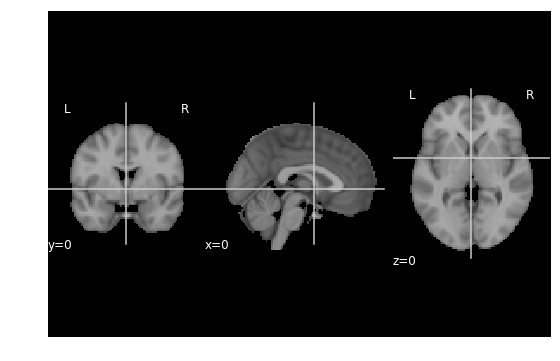

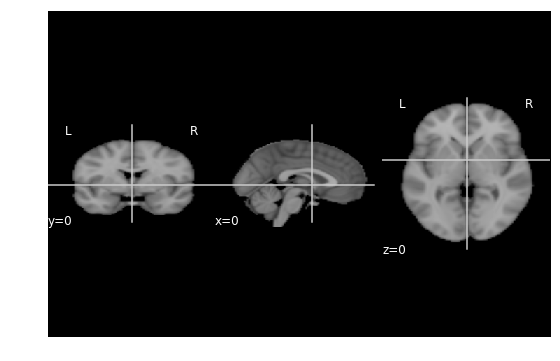

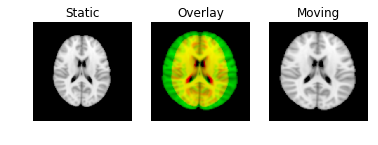

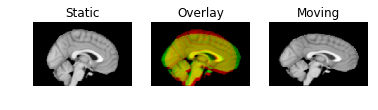

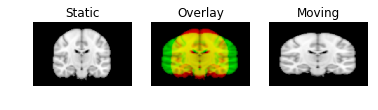

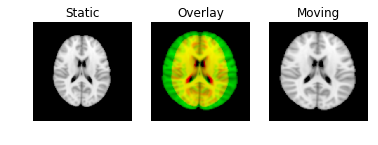

In [228]:
temp_aff = template_img.affine
temp_aff_shift = temp_aff.dot([0, 0, 0, 1])[0:3]
# mov_scale = np.diag(moving_img.affine)[0:3]
mov_scale = np.multiply(np.abs(np.diag(moving_img.affine)[0:3]),[-1,1,1])
scale_diff = np.divide(np.diag(template_img.affine)[0:3],np.diag(moving_img.affine)[0:3])
size_diff = np.divide(template_img.shape,moving_img.shape)
# size_diff = size_diff[[2,1,0]]
cent_idxs = vox_coords(np.linalg.inv(temp_aff),0,0,0)
cent_perc = np.divide(np.array(cent_idxs),template_img.shape)
cent_rs_vals = np.multiply(-np.multiply(cent_perc,moving_img.shape),mov_scale)
print(cent_idxs,cent_rs_vals)

print(size_diff,temp_aff_shift)
sz_sc_diff = np.abs(np.multiply(size_diff,scale_diff))
# sz_sc_diff = size_diff
out_aff_shift = np.multiply(temp_aff_shift,sz_sc_diff)

# out_aff_shift = [0,0,0]
# out_aff_shift = [120,-140,-60]
# M = template_img.affine[0:3,0:3]
M = np.diag(mov_scale)
output_aff = nib.affines.from_matvec(M ,cent_rs_vals)
print(output_aff,template_img.affine)
rs_affine = AffineMap(nib.affines.from_matvec(np.diag(sz_sc_diff),[0,0,0]),
                      moving_img.shape, output_aff,
                      template_img.shape, template_img.affine)

print(rs_affine)
rs_temp = rs_affine.transform(template_img.get_data())
print(rs_temp.shape)
c_of_mass = transform_centers_of_mass(rs_temp, output_aff,
                                      template_img.get_data(), template_img.affine)
print(c_of_mass)
rs_temp_nib = nib.nifti1.Nifti1Image(rs_temp,output_aff)

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax,cut_coords=(0,0,0))
plt.show()
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(rs_temp_nib,axes=ax,cut_coords=(0,0,0))
com_temp = c_of_mass.transform(template_img.get_data())
plt.show()
regtools.overlay_slices(com_temp, rs_temp, None, 0,
                        "Static", "Moving", "resampled_0.png")
regtools.overlay_slices(com_temp, rs_temp, None, 1,
                        "Static", "Moving", "resampled_1.png")
regtools.overlay_slices(com_temp, rs_temp, None, 2,
                        "Static", "Moving", "resampled_2.png")

[[0.75833333 0.         0.         0.        ]
 [0.         0.90833333 0.         0.        ]
 [0.         0.         1.17419355 0.        ]
 [0.         0.         0.         1.        ]]
(240, 240, 155)
[[ 1.          0.          0.         -0.19527412]
 [ 0.          1.          0.          2.1354884 ]
 [ 0.          0.          1.          1.5773351 ]
 [ 0.          0.          0.          1.        ]]


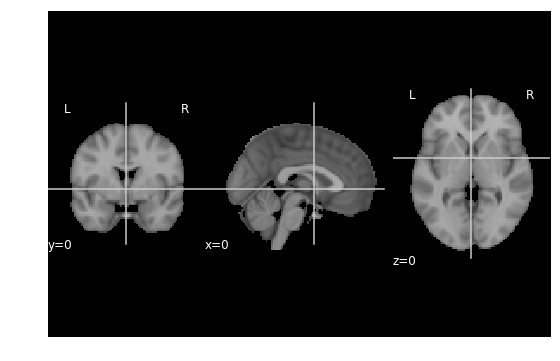

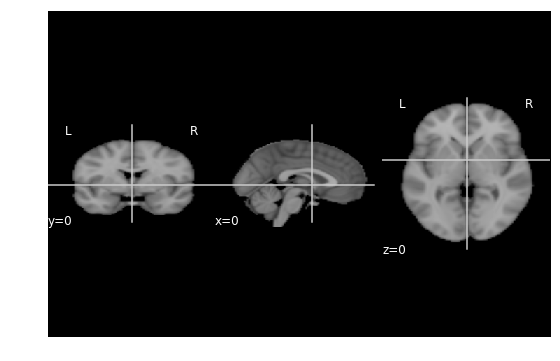

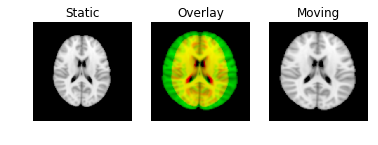

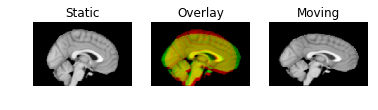

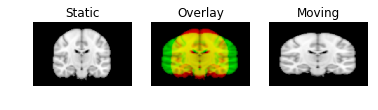

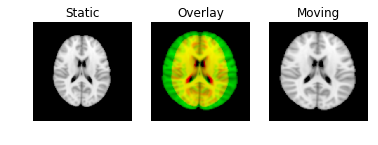

In [233]:
mov_scale = np.multiply(np.abs(np.diag(moving_img.affine)[0:3]),[-1,1,1]) # orientation of the MNI template but the scale of the scan
size_diff = np.divide(template_img.shape,moving_img.shape)
scale_diff = np.divide(np.diag(template_img.affine)[0:3],np.diag(moving_img.affine)[0:3])
sz_sc_diff = np.abs(np.multiply(size_diff,scale_diff))

cent_idxs = vox_coords(np.linalg.inv(template_img.affine),0,0,0)
cent_perc = np.divide(np.array(cent_idxs),template_img.shape)
# cent_rs_vals = np.multiply(-np.multiply(cent_perc,moving_img.shape),mov_scale)
cent_rs_vals = np.multiply(-np.divide(cent_idxs,size_diff),mov_scale)

# print(cent_idxs,cent_rs_vals)

M = np.diag(mov_scale)
output_aff = nib.affines.from_matvec(M ,cent_rs_vals)
# print(output_aff,template_img.affine)
rs_affine = AffineMap(nib.affines.from_matvec(np.diag(sz_sc_diff),[0,0,0]),
                      moving_img.shape, output_aff,
                      template_img.shape, template_img.affine)

print(rs_affine)
rs_temp = rs_affine.transform(template_img.get_data())
print(rs_temp.shape)

rs_temp_nib = nib.nifti1.Nifti1Image(rs_temp,output_aff)
c_of_mass = transform_centers_of_mass(rs_temp, output_aff,
                                      template_img.get_data(), template_img.affine)
print(c_of_mass)

f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(template_img,axes=ax,cut_coords=(0,0,0))
plt.show()
f, ax = plt.subplots(figsize=(9, 6))
pl_anat = plotting.plot_anat(rs_temp_nib,axes=ax,cut_coords=(0,0,0))
com_temp = c_of_mass.transform(template_img.get_data())
plt.show()
regtools.overlay_slices(com_temp, rs_temp, None, 0,
                        "Static", "Moving", "resampled_0.png")
regtools.overlay_slices(com_temp, rs_temp, None, 1,
                        "Static", "Moving", "resampled_1.png")
regtools.overlay_slices(com_temp, rs_temp, None, 2,
                        "Static", "Moving", "resampled_2.png")

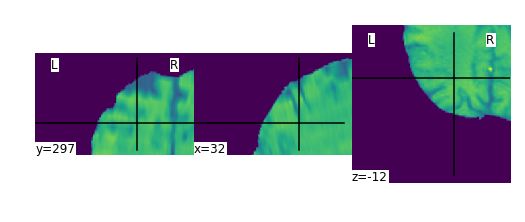

In [95]:
plotting.plot_img(out_tr_nib)

(240, 240, 155)


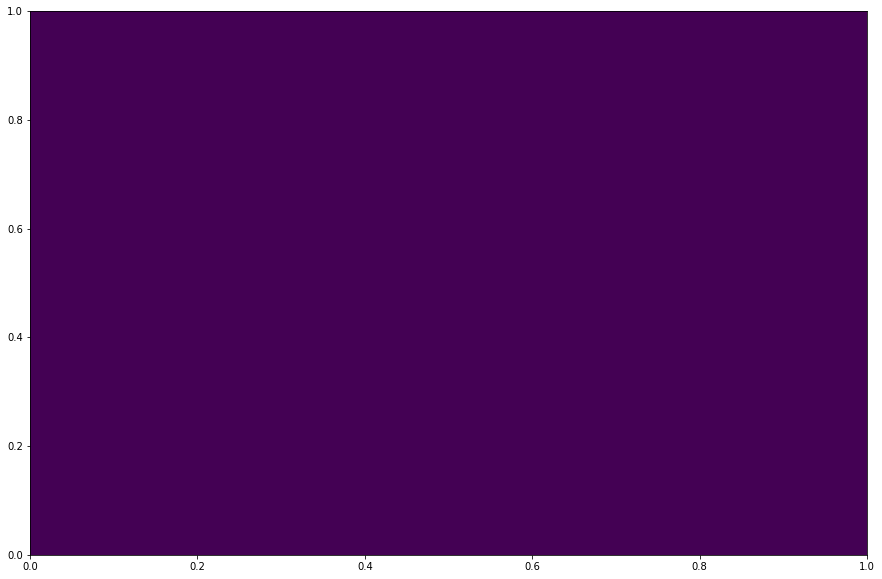

In [81]:
out_tr = out_affine.transform(moving_img.get_data())
print(out_tr.shape)
f, ax = plt.subplots(figsize=(15, 10))
plt.imshow(out_tr[:,:,60], aspect='auto', interpolation='none',
           extent=[0, 1, 0, 1], origin='lower')
plt.show()

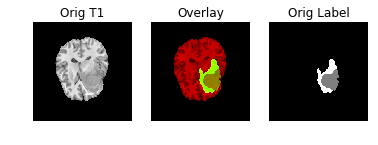

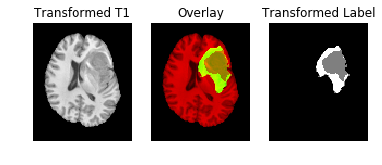

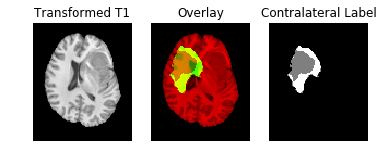

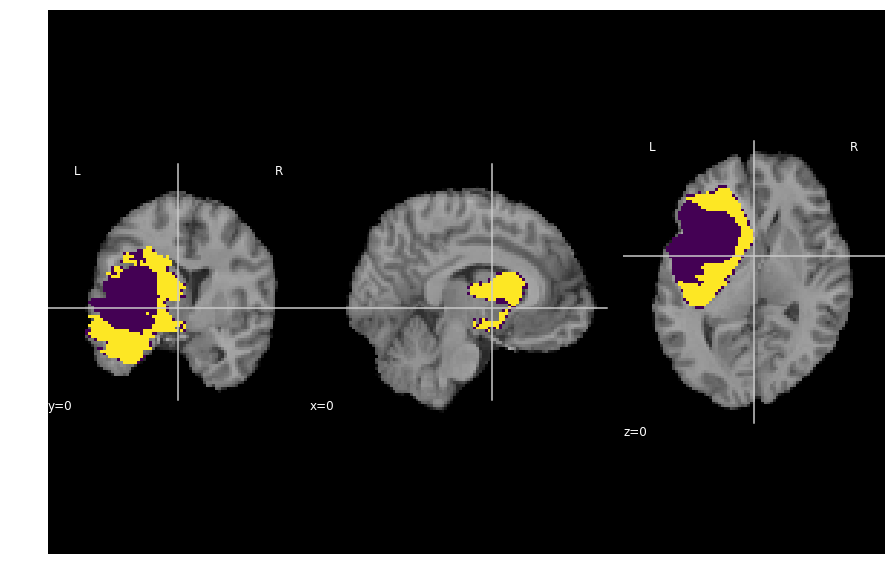

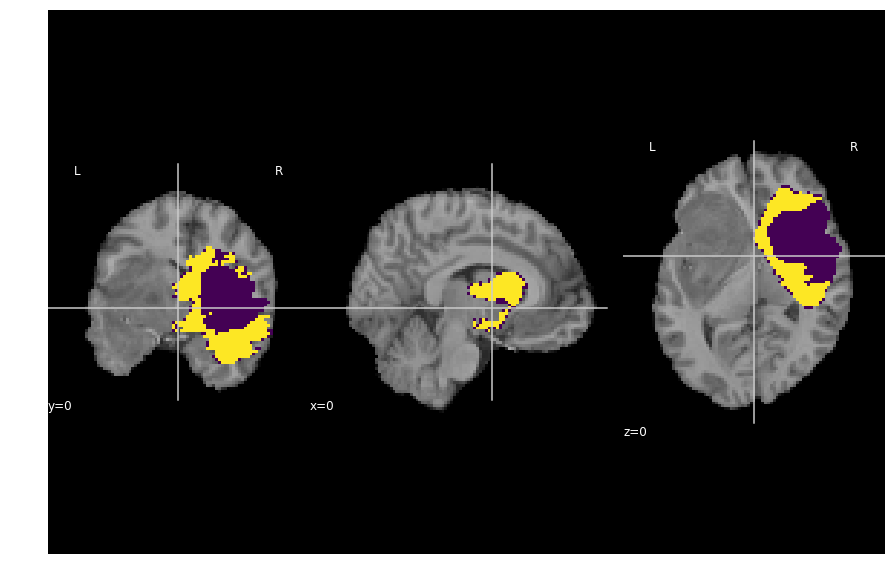

In [45]:
# from nilearn import plotting, image
cLblFile = os.path.join(cDir,'truth.nii.gz')
label_img = nib.load(cLblFile)
# print(label_img.affine)
# print(moving_img.affine)
# lbl_affine = affine
# print(lbl_affine)
# print(len(tr_label.shape))
# tr_label = np.round(lbl_affine.transform(label_img.get_data(),interp='nearest'),decimals=0)
# an issue with the dipy 

tr_label = np.round(affine.transform(label_img.get_data()),decimals=0)

regtools.overlay_slices(moving_img.get_data(), label_img.get_data(), None, 2,
                        "Orig T1", "Orig Label")
regtools.overlay_slices(transformed, tr_label, None, 2,
                        "Transformed T1", "Transformed Label")

refl_x_aff_arr = nib.affines.from_matvec(np.diag([-1, 1, 1]), [0,0,0])
refl_x_affine = AffineMap(refl_x_aff_arr,
                       tr_label.shape, template_img.affine,
                       tr_label.shape, template_img.affine)

refl_label = np.round(refl_x_affine.transform(tr_label),decimals=0)
# print(refl_label)
# refl_label = nib.affines.apply_affine(refl_x_affine,tr_label)
regtools.overlay_slices(transformed, refl_label, None, 2,
                        "Transformed T1", "Contralateral Label")
transf_label_nib = nib.nifti1.Nifti1Image(tr_label,template_img.affine,header=moving_img.header)
refl_label_nib = nib.nifti1.Nifti1Image(refl_label,template_img.affine,header=moving_img.header)

f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
pl_anat.add_overlay(transf_label_nib)
plt.show()
f, ax = plt.subplots(figsize=(15, 10))
pl_anat = plotting.plot_anat(transf_nib,axes=ax,cut_coords =(0,0,0))
pl_anat.add_overlay(refl_label_nib)
plt.show()

In [44]:
from dipy.align import vector_fields as vf

vf.transform_3d_affine_nn

<cyfunction transform_3d_affine_nn at 0x0000020CFE5A3388>